### !221216 ver.の変更点:  1ADU ~ 2.99e- (YJ-band detector)

In [1]:
### !220728 edition: telluric補正は、最初のnormal fluxのrv補正後のものを使うため、その後必要な一連なファイルを変更した。


In [2]:
import numpy as np
import matplotlib.pyplot as plt  ## as plt　というよりね..

#### 0.TOI654のデータについて(詳細はログを確認)、IRDA00040848~51は撮れていない(ACQUISITION)。なので全部で31個のスペクトルファイル。   


TOI654データの説明(rv補正まで):

1.IRDA00040824~58_ss_smmf2_wc.specを、*48~51を除いて、rawspec_0~30.specの名前を振った。(24-->0と、変更後でも偶数と奇数番号は対応している)

2.YJバンド使えてないので、YJバンド(偶数番目)のものだけを取り出す。できたファイルはHe_raw_{0}.dat(0~30)という。奇数i=1,3の時だけ何故かデータが入っている。

3.スペクトル規格化。上の順番と全く一緒だが、データが入っているファイルだけを保存した(詳細はフォルダを確認)。normal_{0}.datと名付けた。

4.rv補正のために観測データの中心時刻を作る。datetime色々いじって、rvcorでVHELOを出すための書式をようやく作って、rvcorを回した。
ファイルの指定は慎重に。

データtype,sizeでよく間違いするから、JUPYTER:VARIABLESを常に開いて!




連番書き出しと、図のプロットの関数作ると便利か?


#### 元データの確認: awkコマンドで一つのスペクトルのヘリウム領域を切ってみたもの:


In [3]:
#awkコマンドで一つのスペクトルのヘリウム領域を切ってみたもの:

wavelength, flux = np.loadtxt("./He24.dat", unpack=True)

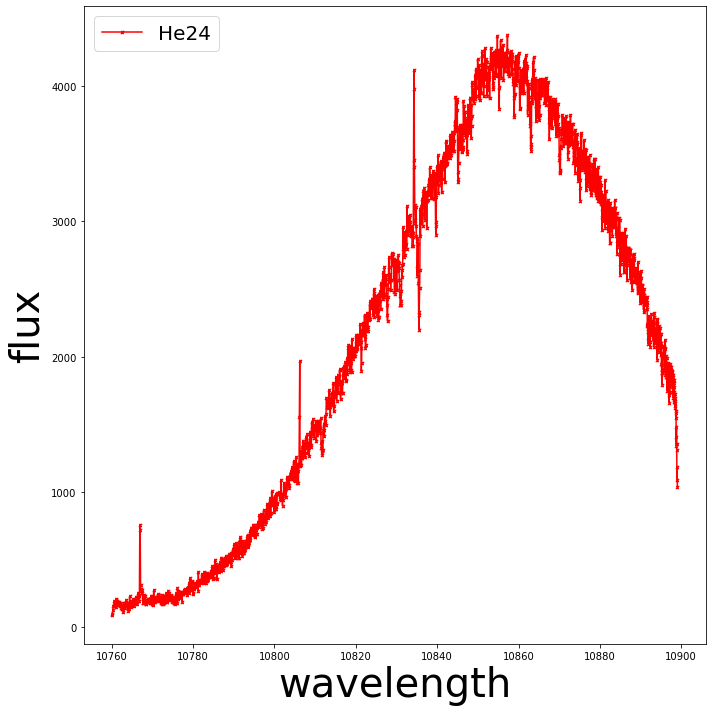

In [4]:

#IRDのADU --> electron

flux_e = 2.99 *  flux

fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(111)


ax.plot(wavelength, flux_e, marker='$x$', markersize=3, color="r", label="He24" )
ax.set_xlabel("wavelength", size=40 )
ax.set_ylabel("flux", size=40)
#ax1.set_ylabel("Relative Flux")
ax.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(0.9, 1.1)


plt.tight_layout()  # タイトルの被りを防ぐ

In [14]:
# awkコマンドで切ってみた一本のHe波長近くのスペクトル

wavelength, flux = np.loadtxt("./He24_flat.dat", unpack=True)

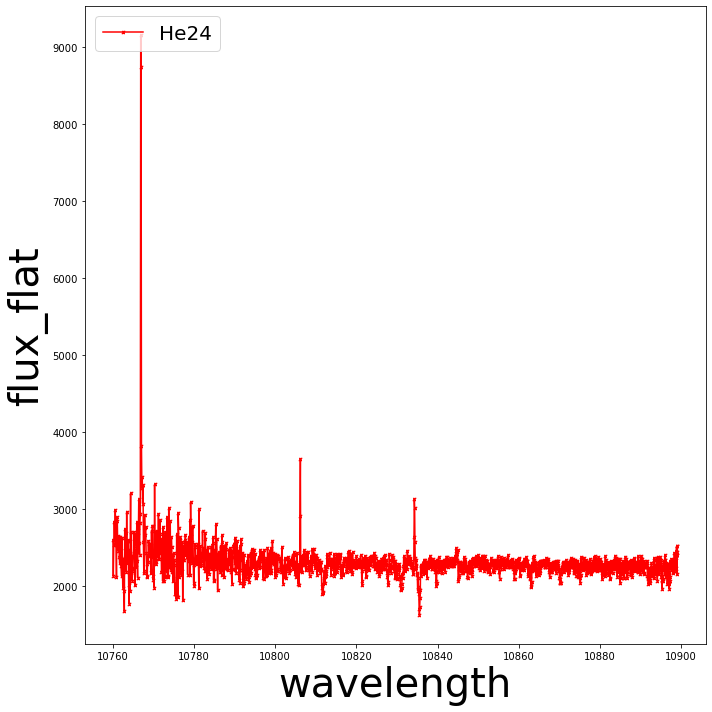

In [6]:
flux_e = 2.99 * flux

wavelength, flux = np.loadtxt("./He24_flat.dat", unpack=True)
fig = plt.figure(figsize = (10,10))
ax1 = fig.add_subplot(111)


ax1.plot(wavelength, flux_e, marker='$x$', markersize=3, color="r", label="He24" )
ax1.set_xlabel("wavelength", size=40 )
ax1.set_ylabel("flux_flat", size=40)
#ax1.set_ylabel("Relative Flux")
ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(500, 1500)
#ax1.set_xlim(10860, 10870)


plt.tight_layout()  # タイトルの被りを防ぐ

生データをプロットしてみる!

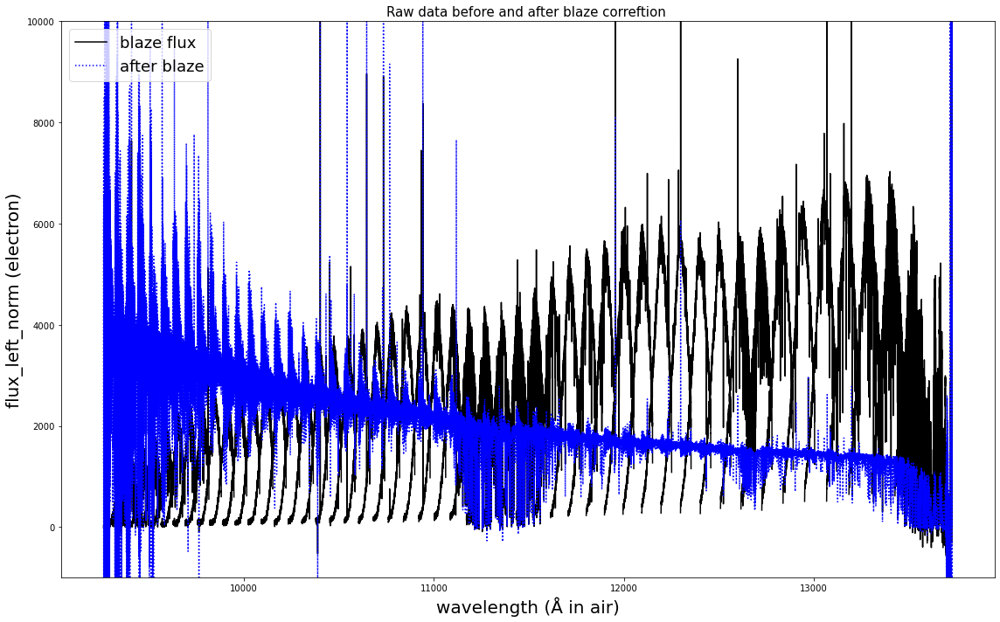

In [45]:

wavelength0 = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec", usecols=0, unpack=True)
blaze = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec", usecols=1, unpack=True)
after_blaze = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec", usecols=2, unpack=True)

fig = plt.figure(figsize = (16,10))
ax1 = fig.add_subplot(111)

blaze = blaze * 2.99
after_blaze = after_blaze * 2.99

ax1.plot( 10*wavelength0, blaze, color="black", label="blaze flux" )
ax1.set_xlabel("wavelength (Å in air)", size=20 )
ax1.set_ylabel("flux_left_norm (electron)", size=20 )
ax1.plot(10*wavelength0, after_blaze, ":", color="b", label="after blaze")
ax1.legend(loc="upper left", fontsize = 18)

ax1.set_ylim(-1000, 10000)
#ax1.set_xlim(10700, 10900)

plt.tick_params(labelsize=10)
plt.title('Raw data before and after blaze correftion ', size = 15)


plt.tight_layout()  # タイトルの被りを防ぐ


###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()

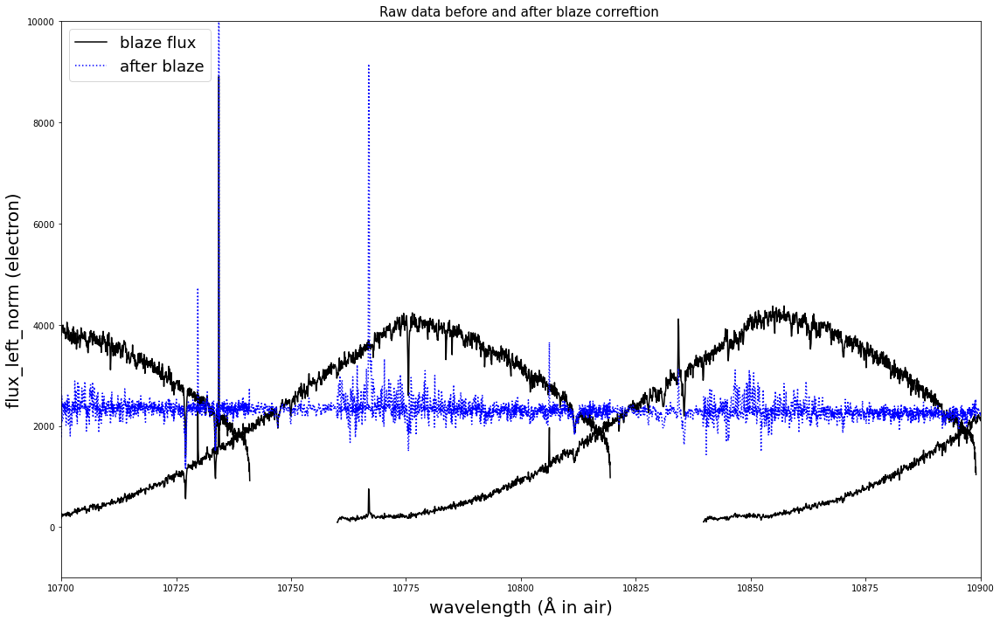

In [46]:
wavelength0 = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec", usecols=0, unpack=True)
blaze = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec", usecols=1, unpack=True)
after_blaze = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec", usecols=2, unpack=True)

fig = plt.figure(figsize = (16,10))
ax1 = fig.add_subplot(111)

blaze = blaze * 2.99
after_blaze = after_blaze * 2.99

ax1.plot( 10*wavelength0, blaze, color="black", label="blaze flux" )
ax1.set_xlabel("wavelength (Å in air)", size=20 )
ax1.set_ylabel("flux_left_norm (electron)", size=20 )
ax1.plot(10*wavelength0, after_blaze, ":", color="b", label="after blaze")
ax1.legend(loc="upper left", fontsize = 18)

ax1.set_ylim(-1000, 10000)
ax1.set_xlim(10700, 10900)

plt.tick_params(labelsize=10)
plt.title('Raw data before and after blaze correftion ', size = 15)


plt.tight_layout()  # タイトルの被りを防ぐ


###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()

### 1.ヘリウムのオーダーのデータを切り取り、規格化しておく(HDSみたいに)


##### pythonでawkコマンドと同じことをするために、まず一つの生スペクトルを切ってみる。

In [4]:
# ここは、awkコマンドと同じ機能をループ化することを目指したい。
# awkコマンドでループを回す方法は分からない(川内さんできると.)
# awk '{if(NR>45058 && NR <47107 && $2!="nan") printf "%.11f %e\n", $1*10.00,$2}'  [入力ファイル] > フィアル名.dat

#pythonで同じことをするために、まず一つの生スペクトルを切ってみる。

#rawspec = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf1_wc.spec", comments='#' , dtype='float', usecols = 2, unpack=True)
#rawspec = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf1_wc.spec", comments='#' , usecols = 2, unpack=True)
rawspec = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec",  usecols = 2, skiprows=45060, max_rows=2047 , unpack=True)

rawspec_1 = np.loadtxt("./TOI654/rawdata/IRDA00040824_ss_smmf2_wc.spec",  usecols = 1, skiprows=45060, max_rows=2047 , unpack=True)
#print("err^2 = ", rawspec_err_0)

rawspec_err = (rawspec_1 ** 0.5) * (rawspec_1) / rawspec
print("err = ", rawspec_err)


#0行目から始めることとは関係なく、skiprowsは気をつけて. skiprows:最初の何行目をスキップするか.#コメントの行も含んでいるっぽい。
#なんで、実際スキップすべきなのは:2+45058

#max_rows引数は、skiprowsの後、何行読み込むかを指定。何行までの意味ではない。

print(np.shape(rawspec))
print(rawspec)
print(rawspec.ndim)

print(np.shape(rawspec_err))
print(rawspec_err.ndim)


err =  [       nan        nan 0.20996715 ...        nan        nan        nan]
(2047,)
[        nan         nan 868.3885292 ...         nan         nan
         nan]
1
(2047,)
1


In [ ]:
rawspec
#ちゃんとeの何乗を書き出してくれたね.

In [ ]:
np.savetxt("./TOI654/rawspec/rawspectest1.dat", rawspec)


In [ ]:
print(len(rawspec))
print(np.shape(rawspec))

In [ ]:
rawspec[0:3]

In [ ]:
rawspec = np.loadtxt("./TOI654/rawdata*/rawspec_3.spec", usecols = 2, skiprows=45060, max_rows=2047 , unpack=True)
np.savetxt("./TOI654/rawspec/rawspect3.dat", rawspec)

In [ ]:
#では全部に対してやっちゃう!
#skiprows skipheaders おかしくなりそう...
""""
i = 0

#for rawspec in rawspeclist:
for i in range(0,31):
    wavelength0 = 10 * np.genfromtxt("./TOI654/rawdata*/rawspec_{0}.spec".format(i), usecols=0 )
    rawspec0 = np.genfromtxt("./TOI654/rawdata*/rawspec_{0}.spec".format(i), usecols=2 )
    
    wavelength = wavelength0[45059:47196]
    rawspec = rawspec0[45059:47196]
    
    print("i=", i)
    print('rawspec=', rawspec)
    
    outputfile = "./TOI654/rawspec/He_raw_{0}.dat".format(i)
    
    d = np.column_stack((wavelength,rawspec))     #np.savetxt 複数配列の保存方法
   
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    i+=1

"""


##### 「初歩的な確認テスト」一つの生スペクトルに対して、大丈夫そうであれば、

<font color="Magenta">ファイル名前の変更</font> 



He_rawに0から番号を振りたいので、index += を使った。

for i in range(24,59,2): 

    try:

    except:


ってfor文構造を作った。

In [31]:
#indexで走らせている　　要素のとは違う
rawspec = []
#rawspec_err = []

#for rawspec in rawspeclist:
#for i in range(0,31):
index = -1
for i in range(24,59,2):  # i, j使わなくて済む. なんというか、二重ループでなければいらないのか。?
    #奇数番号をスキップしました!!
    
    try:


        rawspec0 = np.loadtxt("./TOI654/rawdata/IRDA000408{}_ss_smmf2_wc.spec".format(i), comments='#', usecols=(0,1,2)) 
        #usecols=(0,2)を変更、blaze補正前の列も入れて、その後の誤算計算に使う。
        #rawspec_err0 = 
        
        if len(rawspec0) < 45055:
            print(i,"th file: No data")
            print(len(rawspec))
            continue
        
        #if 
        
        #rawspec = rawspec0[45059:47196]  #入力間違い..
        rawspec = rawspec0[45056:47104] #ヘッダーも含めて
        #この時取り出した波長:  1075.96~1084.78        #nanのやつを入れずに!!!
        ##10760Å ~ 10899Å
        
        print("i=", i)
        print(rawspec0.shape)
        print('rawspec=', rawspec)
        index += 1
        #ここでi+=1だとループが変になっちゃう。
        
        #np.savetxt 複数配列の保存方法
        #for j in range(0,16):
        #   print('j=', j)
    
    except OSError:
        print("OSError: ./TOI654/rawdata/IRDA000408*_ss_smmf2_wc.spec not found.")
        continue
    
    print("i_2nd=", index)
    
    np.savetxt("./TOI654/rawspec/He_raw_{0}.dat".format(index), rawspec)  ## 大発見!!
    
    

i= 24
(104448, 3)
rawspec= [[1075.96544638           nan           nan]
 [1075.97517627           nan           nan]
 [1075.98490369           nan           nan]
 ...
 [1090.12540149           nan           nan]
 [1090.12935927           nan           nan]
 [1090.13331411           nan           nan]]
i_2nd= 0
i= 26
(104448, 3)
rawspec= [[1075.96544638           nan           nan]
 [1075.97517627           nan           nan]
 [1075.98490369           nan           nan]
 ...
 [1090.12540149           nan           nan]
 [1090.12935927           nan           nan]
 [1090.13331411           nan           nan]]
i_2nd= 1
i= 28
(104448, 3)
rawspec= [[1075.96544638           nan           nan]
 [1075.97517627           nan           nan]
 [1075.98490369           nan           nan]
 ...
 [1090.12540149           nan           nan]
 [1090.12935927           nan           nan]
 [1090.13331411           nan           nan]]
i_2nd= 2
i= 30
(104448, 3)
rawspec= [[1075.96544638           nan        

In [ ]:
#indexで走らせている　　要素のとは違う
rawspec = []
#rawspec_err = []

#for rawspec in rawspeclist:
#for i in range(0,31):
for i in range(24,59):
    
    


    rawspec0 = np.loadtxt("./TOI654/rawdata/IRDA000408{}_ss_smmf2_wc.spec".format(i), comments='#', usecols=(0,1,2)) 
    #usecols=(0,2)を変更、blaze補正前の列も入れて、その後の誤算計算に使う。
    #rawspec_err0 = 
    
    if len(rawspec0) < 45055:
        print(i,"th file: No data")
        print(len(rawspec))
        continue
    
    #if 
    
    #rawspec = rawspec0[45059:47196]  #入力間違い..
    rawspec = rawspec0[45056:47104] #ヘッダーも含めて
    #この時取り出した波長:  1075.96~1084.78        #nanのやつを入れずに!!!
    ##10760Å ~ 10899Å
    
    print("i=", i)
    print(rawspec0.shape)
    print('rawspec=', rawspec)
    
    #ここでi+=1だとループが変になっちゃう。
    
    #np.savetxt 複数配列の保存方法
    for j in range(0,16):
        print('j=', j)
    
        np.savetxt("./TOI654/rawspec/He_raw_{0}.dat".format(j), rawspec)

そうです。偶数番目がYJ bandで、奇数番目がH bandです。



<img src="spectral_resolution_IRD.jpeg" width="400">


Markdown記法で画像サイズを変更する方法（widthを指定する）
https://k-koh.hatenablog.com/entry/2020/02/22/111440

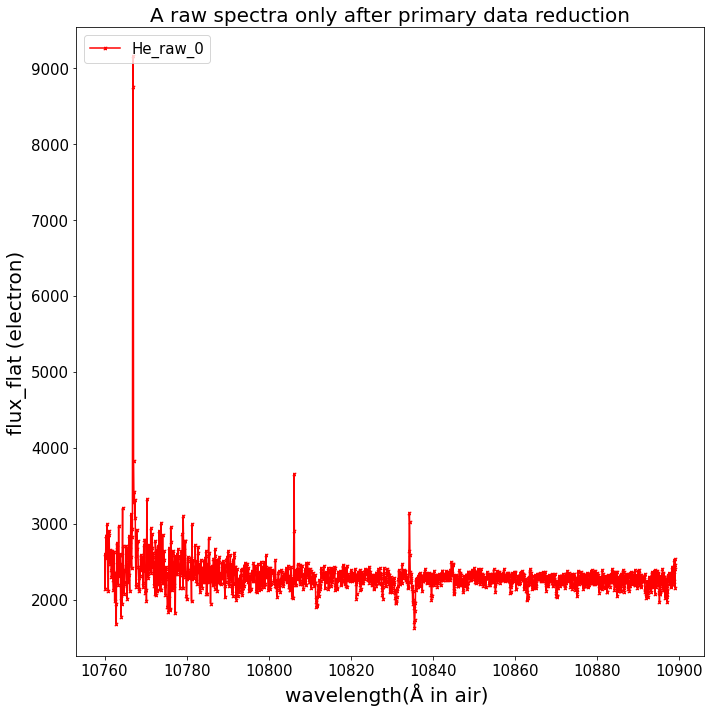

In [21]:
wavelength, flux_raw, flux = np.genfromtxt("./TOI654/rawspec/He_raw_1.dat", unpack=True)

fig = plt.figure(figsize = (10,10))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

ax1.plot( 10*wavelength, flux * 2.99,  marker='$x$', markersize=3, color="r", label="He_raw_0" )
ax1.set_xlabel("wavelength(Å in air) ", size=20 )
ax1.set_ylabel("flux_flat (electron)", size=20)
#ax1.set_ylabel("Relative Flux")
ax1.legend(loc="upper left", fontsize = 15)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(0.9, 1.1)
plt.tick_params(labelsize=15)   #目盛りラベルのフォントサイズを設定する方法
plt.title('A raw spectra only after primary data reduction', size = 20)


plt.tight_layout()  # タイトルの被りを防ぐ

ここで誤差データを保存しておく。

##### スペクトルを規格化 (誤差含めて)

まずnanを消しておきたい! データの中身を見ると、Wavelengthだけnanはついていないので、同じようには消せない.というかいうか消す必要がない.

221217: 見事にnanを切った配列を、wavelengthにも配属できた、、!!


!ここから、今後使うデータに対して、フラックスの単位をADUから、electronに変えた(* 2.99倍)

In [48]:
#pythonでnanを消したい.

import math

import numpy as np
import pandas as pd

#for i in [1, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]:  #telluriclistは配列が違う. telluricfluxとは違う.
for i in range(16):
    He_blaze = np.loadtxt("./TOI654/rawspec/He_raw_{0}.dat".format(i), usecols=2)
    He_raw = np.loadtxt("./TOI654/rawspec/He_raw_{0}.dat".format(i), usecols=1)
    wavelength = np.loadtxt("./TOI654/rawspec/He_raw_{0}.dat".format(i), usecols=0)
    #np.atleast_1d(He_blaze)
    He_blaze = He_blaze.reshape(-1,1)
    He_raw = He_raw.reshape(-1,1)
    wavelength = wavelength.reshape(-1,1)
    print(np.shape(He_blaze))
    print(type(He_blaze))
    print(np.shape(He_raw))
    print(type(He_raw))
    print(np.shape(wavelength))
    #data typeの問題か?
    
    print(~np.isnan(He_blaze))
    print(He_blaze[~np.isnan(He_blaze).any(axis=1), :])
    #print(He_blaze[~np.isnan(He_blaze).any(axis=0)])
    print(~np.isnan(He_raw))
    print(He_raw[~np.isnan(He_raw).any(axis=1), :])

    print("i=", i)
    
    He_blaze_nan = He_blaze[~np.isnan(He_blaze).any(axis=1), :]
    He_raw_nan = He_raw[~np.isnan(He_raw).any(axis=1), :]
    wavelength = wavelength[~np.isnan(He_blaze).any(axis=1), :]   *10  #221217: 見事にnanを切った配列を、wavelengthにも配属できた、、!!

    
    print('He_blaze_shape', np.shape(He_blaze_nan))
    print('He_raw_shape', np.shape(He_raw_nan))
    print('wavelength_shape', np.shape(wavelength))

    #
    
    He_blaze_nan_e = 2.99 * He_blaze_nan
    He_raw_nan_e = 2.99 *  He_raw_nan
    
    outputfile = './TOI654/rawspec/He_blaze_nan_latest_{0}.dat'.format(i) 
    
    # LSD_wrvしばらく変わらないから、このままでいいよ!
    #d = np.column_stack((wavelength , He_raw_nan))     #np.savetxt 複数配列の保存方法
    
    d = np.column_stack((He_raw_nan_e, He_blaze_nan_e))
    
    d = np.column_stack((wavelength,d))
    
    
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')

(2048, 1)
<class 'numpy.ndarray'>
(2048, 1)
<class 'numpy.ndarray'>
(2048, 1)
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[868.3885292 ]
 [714.95972704]
 [850.59005726]
 ...
 [720.99945627]
 [845.85406309]
 [804.37021414]]
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[ 32.15463799]
 [ 31.15142209]
 [ 42.08190155]
 ...
 [363.61404419]
 [397.5375824 ]
 [347.18213654]]
i= 0
He_blaze_shape (1987, 1)
He_raw_shape (1987, 1)
wavelength_shape (1987, 1)
(2048, 1)
<class 'numpy.ndarray'>
(2048, 1)
<class 'numpy.ndarray'>
(2048, 1)
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[1005.75667662]
 [ 722.33741998]
 [ 904.71242879]
 ...
 [ 721.99468853]
 [ 683.34901923]
 [ 677.9818081 ]]
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[ 37.24109745]
 [ 31.47287464]
 [ 44.7595396 ]
 ...
 [364.11595917]
 [321.16286827]
 [292.63039398]]
i= 1
He_blaze_shape (1987, 1)
He_raw_shape (1987, 1)
wavelength_shape (1987, 1)
(2048, 1)
<class 'numpy.ndarra

##### 三つのオーダーの足し合わせを試みる。

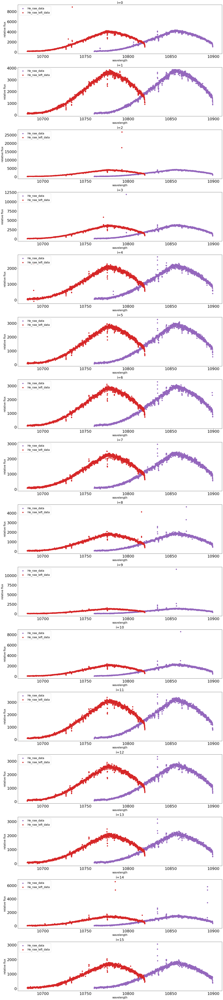

In [172]:
#規格化前のプロット
fig = plt.figure(figsize = (18,80))


for i in range(16):
    wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=0)
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1)     #raw[1] 
    He_raw_err = np.loadtxt("./TOI654/rawspec/He_raw&blaze_err_{0}.dat".format(i), usecols=0)
    He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=2)   
    #He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=2) #raw[2]
    wavelength_left = np.loadtxt("./TOI654/rawspec_left/left_blaze_nan_latest_{0}.dat".format(i), usecols=0)
    He_raw_left = np.loadtxt("./TOI654/rawspec_left/left_blaze_nan_latest_{0}.dat".format(i), usecols=1)
    He_blaze_left = np.loadtxt("./TOI654/rawspec_left/left_blaze_nan_latest_{0}.dat".format(i), usecols=2)
    wavelength_right = np.loadtxt("./TOI654/rawspec_right/right_blaze_nan_latest_{0}.dat".format(i), usecols=0)
    He_raw_right = np.loadtxt("./TOI654/rawspec_right/right_blaze_nan_latest_{0}.dat".format(i), usecols=1)
    He_blaze_right = np.loadtxt("./TOI654/rawspec_right/right_blaze_nan_latest_{0}.dat".format(i), usecols=2)
    ##error!!
    #<ipython-input-113-b127ea5505dd>:10: RuntimeWarning: invalid value encountered in sqrt
    #He_raw_err = He_raw ** 0.5
    
    
    ax = fig.add_subplot(16,1,i+1) 
    #ax2 = fig.add_subplot(111)

    
    ax.scatter( wavelength, He_raw,  color="tab:purple", label="He_raw_data" )
    ax.scatter( wavelength_left, He_raw_left,   color="tab:red", label="He_raw_left_data" )
    #ax.errorbar(x=wavelength, y=He_raw, yerr=He_raw_err, capsize=2,  ls='none',   ecolor='tab:purple')
    
    ax.set_xlabel("wavelength", size=15 )
    ax.set_ylabel("relative flux", size=15)
    ax.legend(loc="upper left", fontsize = 15)
    ax.set_title('i={0}'.format(i), size=20)
    
    
    #ax.set_ylim(0.7, 1.3)
    #ax1.set_xlim(10820, 10840)
    #ax.set_xlim(10790, 10792)

    
    #print("i = ", i)
    
    # plt.title('rv correct', size = 15)
    # plt.tick_params(labelsize=11)
    ax.tick_params(labelsize=22)
    
    # plt.errorbar(x=He_raw, y=He_blaze, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:purple')
    # #plt.errorbar(x=He_raw_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    #plt.tight_layout()  # タイトルの被りを防ぐ
    #plt.show()
    #plt.show()
  
plt.tight_layout()

プロットから分かるように、オーダーごとの波長の間隔が違うため、改めてbinを振り分けて、補間してもらう。

Scipy.interpolate を使った様々な補間法
https://qiita.com/maskot1977/items/913ef108ff1e2ba5b63f


In [185]:
from scipy import interpolate

#wavelength =
#He_raw = 

#binを振り分ける空間、刻み。
#wave = np.linspace(min(wavelength_left), max(wavelength_right), (max(wavelength_right) - min(wavelength_left))/(10830/70000) )
wavenew = np.linspace(min(wavelength_left), max(wavelength_right), 2000 )

#補間する関数を定義する.
f_left = interpolate.interp1d(w_left_0, He_raw_left_0, kind="nearest")
f_right = interpolate.interp1d(w_right_0, He_raw_right_0, kind="nearest")
f_He = interpolate.interp1d(w_He_0, He_raw_0, kind="nearest")

f_left_z = interpolate.interp1d(w_left_0, zl0, kind="nearest")
f_right_z = interpolate.interp1d(w_right_0, zr0, kind="nearest")
f_He_z = interpolate.interp1d(w_He_0, z0, kind="nearest")

print(len(wavenew))
print(wavenew)   #こいつがx_new.


2000
[10681.51495992 10681.66417612 10681.81339232 ... 10979.49970498
 10979.64892118 10979.79813737]


In [25]:
#binは波長分解能より小さいために:

print(max(wavelength_right) - min(wavelength_left))
print((max(wavelength_right) - min(wavelength_left))/(10830/70000))

298.28317744873493
1927.9614424202625


In [131]:
#左オーダーから、 wavenewのmaxまで足りていない数~~ 0.8で割ったのは元のデータwavelength_leftのおおよそな間隔(なるべく小さめにとる)

num_left = int( (wavenew[-1] - wavelength_left[-1]) / 0.08  ) + 1

num_right = int( (wavelength_right[0] - wavenew[0]) / 0.07  ) + 1


num_He_l = int( (wavelength[0] - wavenew[0]) / 0.07  ) + 1
num_He_r = int( (wavenew[-1] - wavelength[-1]) / 0.07  ) + 1

In [183]:

#左オーダーの補間配列を作る!!

print( np.concatenate( [ wavelength_left, np.zeros(len(wavenew)) ] ) )

w_left_0 = np.concatenate( [ wavelength_left, np.array([wavelength_left[-1]+(i+1)*0.08 for i in range(num_left)])] )


print(w_left_0)
He_raw_left_0 = np.concatenate( [ He_raw_left, np.zeros(num_left) ] )
zl0 = np.concatenate( [ He_raw_left/He_blaze_left, np.zeros(num_left) ] )

print(He_raw_left_0)
print(zl0)

[10681.51495992 10681.61138271 10681.707781   ...     0.
     0.             0.        ]
[10681.51495992 10681.61138271 10681.707781   ... 10979.6844406
 10979.7644406  10979.8444406 ]
[41.06031274 28.26046892 35.52327606 ...  0.          0.
  0.        ]
[0.04026321 0.04667101 0.05180628 ... 0.         0.         0.        ]


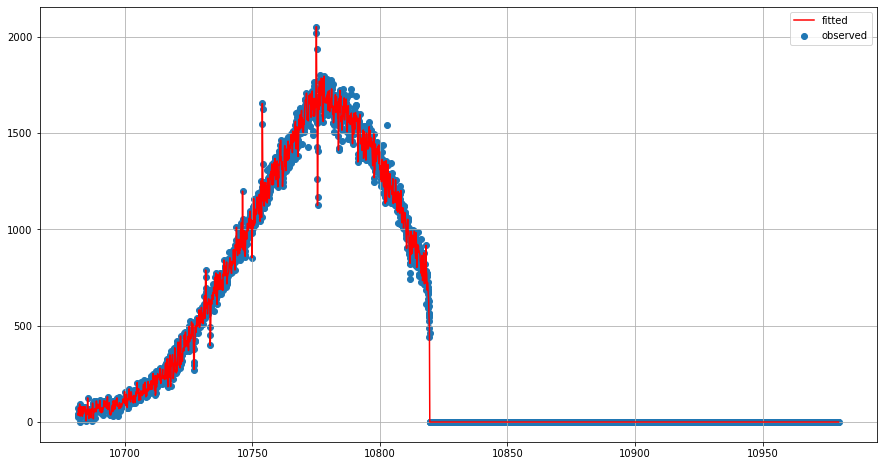

In [116]:
#He_raw_left_new = f(wavenew)
fig = plt.figure(figsize = (15,8))
plt.scatter(w_left_0, He_raw_left_0, label="observed")
plt.plot(wavenew, f_left(wavenew), c="red", label="fitted")
plt.grid()
plt.legend()
plt.show()

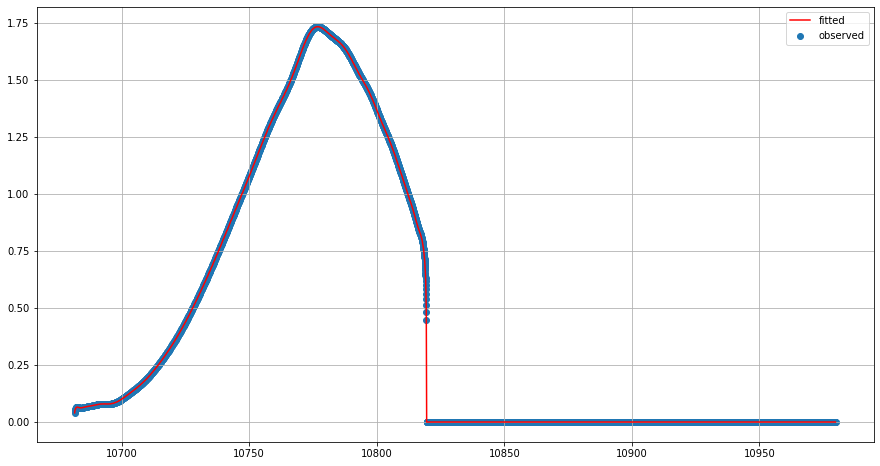

In [193]:
fig = plt.figure(figsize = (15,8))
plt.scatter(w_left_0, zl0, label="observed")
plt.plot(wavenew, f_left_z(wavenew), c="red", label="fitted")
plt.grid()
plt.legend()
plt.show()

In [142]:
array_r = np.array([wavelength_right[0]-(i+1)*0.07 for i in range(num_right)])
array_r_reverse = array_r[::-1]
print(array_r_reverse)

[10681.46713511 10681.53713511 10681.60713511 ... 10839.52713511
 10839.59713511 10839.66713511]


In [184]:

#右オーダーの補間配列を作る!!

print( np.concatenate( [ wavelength_right, np.zeros(len(wavenew)) ] ) )

w_right_0 = np.concatenate( [ np.array([wavelength_right[0]-(i+1)*0.07 for i in range(num_right)])[::-1], wavelength_right ] )


print(w_right_0)
He_raw_right_0 = np.concatenate( [  np.zeros(num_right), He_raw_right ] )
zr0 = np.concatenate( [np.zeros(num_right), He_raw_right/He_blaze_right ] )

print(He_raw_right_0)
print(zl0)

[10839.73713511 10839.83512043 10839.93308071 ...     0.
     0.             0.        ]
[10681.46713511 10681.53713511 10681.60713511 ... 10979.7150462
 10979.75660662 10979.79813737]
[  0.           0.           0.         ... 523.2148811  394.50479655
 360.5602069 ]
[0.04026321 0.04667101 0.05180628 ... 0.         0.         0.        ]


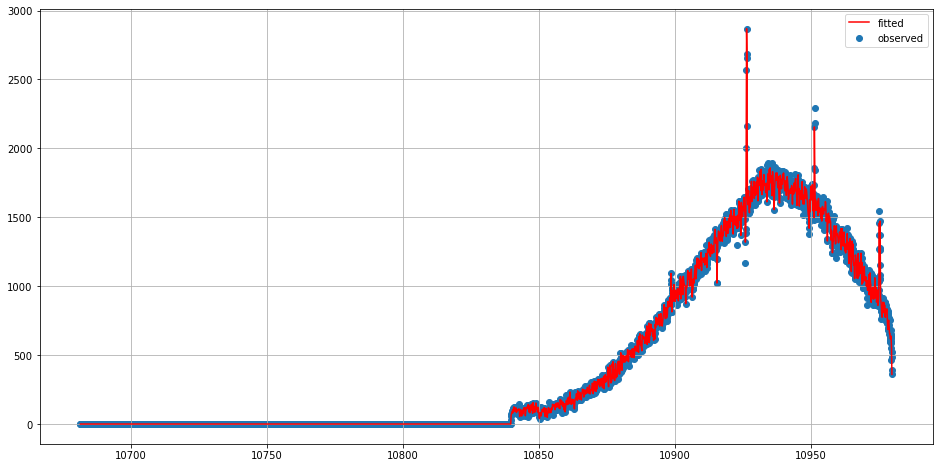

In [149]:
#He_raw_right_new = f(wavenew)
fig = plt.figure(figsize = (16,8))
plt.scatter(w_right_0, He_raw_right_0, label="observed")
plt.plot(wavenew, f_right(wavenew), c="red", label="fitted")
plt.grid()
plt.legend()
plt.show()

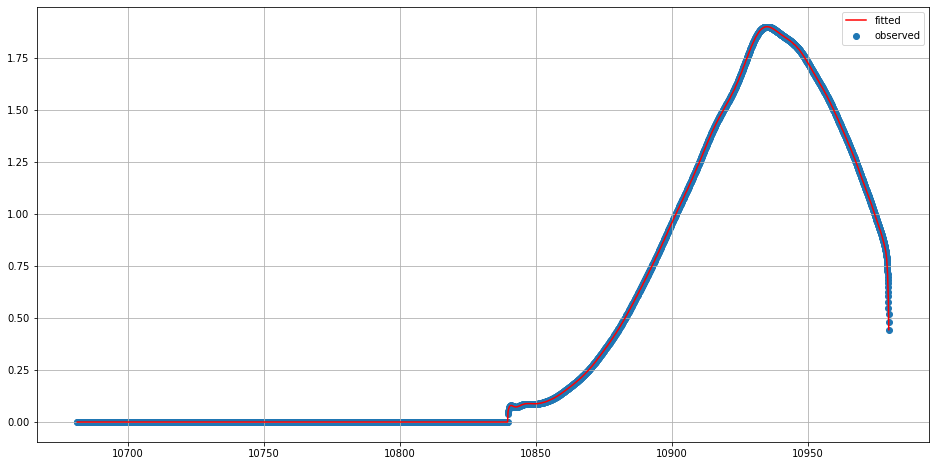

In [192]:
fig = plt.figure(figsize = (16,8))
plt.scatter(w_right_0, zr0, label="observed")
plt.plot(wavenew, f_right_z(wavenew), c="red", label="fitted")
plt.grid()
plt.legend()
plt.show()

In [181]:
#Heオーダーの補間配列を作る!!

#print( np.concatenate( [ wavelength_right, np.zeros(len(wavenew)) ] ) )

w_He_0 = np.concatenate( [ np.array([wavelength[0]-(i+1)*0.07 for i in range(num_He_l)])[::-1], wavelength,  np.array([wavelength[-1]+(i+1)*0.07 for i in range(num_He_r)]) ] )


print(w_He_0)
He_raw_0 = np.concatenate( [  np.zeros(num_He_l), He_raw, np.zeros(num_He_r) ] )
z0 = np.concatenate( [  np.zeros(num_He_l), He_raw/He_blaze, np.zeros(num_He_r) ] )

print(He_raw_0)
print(z0)

[10681.50351094 10681.57351094 10681.64351094 ... 10979.67196508
 10979.74196508 10979.81196508]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]


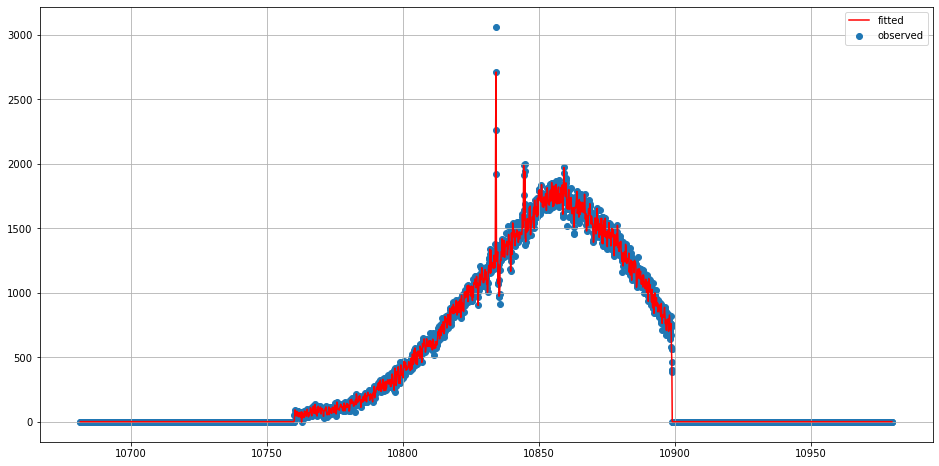

In [154]:
fig = plt.figure(figsize = (16,8))
plt.scatter(w_He_0, He_raw_0, label="observed")
plt.plot(wavenew, f_He(wavenew), c="red", label="fitted")
plt.grid()
plt.legend()
plt.show()

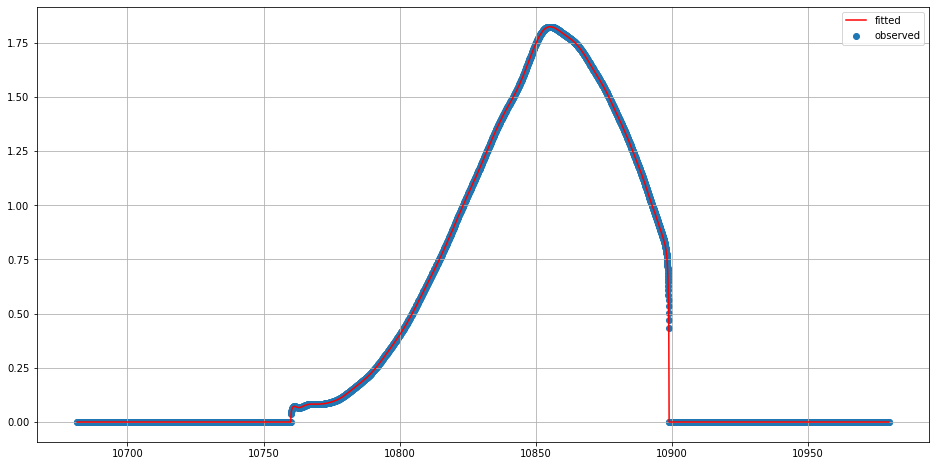

In [191]:
fig = plt.figure(figsize = (16,8))
plt.scatter(w_He_0, z0, label="observed")
plt.plot(wavenew, f_He_z(wavenew), c="red", label="fitted")
plt.grid()
plt.legend()
plt.show()

In [155]:
f_combined = f_He(wavenew) + f_left(wavenew) + f_right(wavenew)
print(f_combined)

[ 41.06031274  35.52327606  74.20765992 ... 637.88455879 549.51282078
 360.5602069 ]


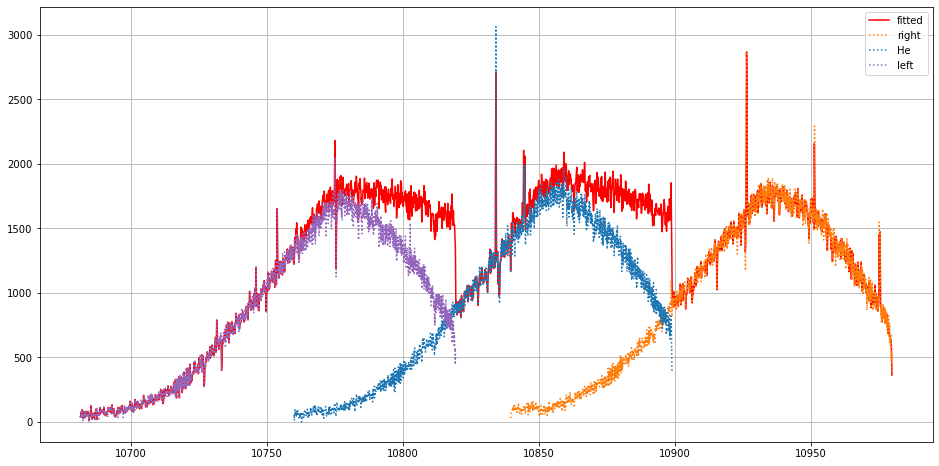

In [187]:
fig = plt.figure(figsize = (16,8))
#plt.scatter(w_He_0, He_raw_0, label="observed")
plt.plot(wavenew, f_combined, c="red", label="fitted")
plt.plot(wavelength_right, He_raw_right, ":", c="tab:orange", label="right")
plt.plot(wavelength, He_raw, ":", c="tab:blue", label="He")
plt.plot(wavelength_left, He_raw_left,":", c="tab:purple", label="left")
plt.grid()
plt.legend()
plt.show()

[0.04026321 0.05180628 0.05535928 ... 0.64728831 0.5773761  0.44355703]


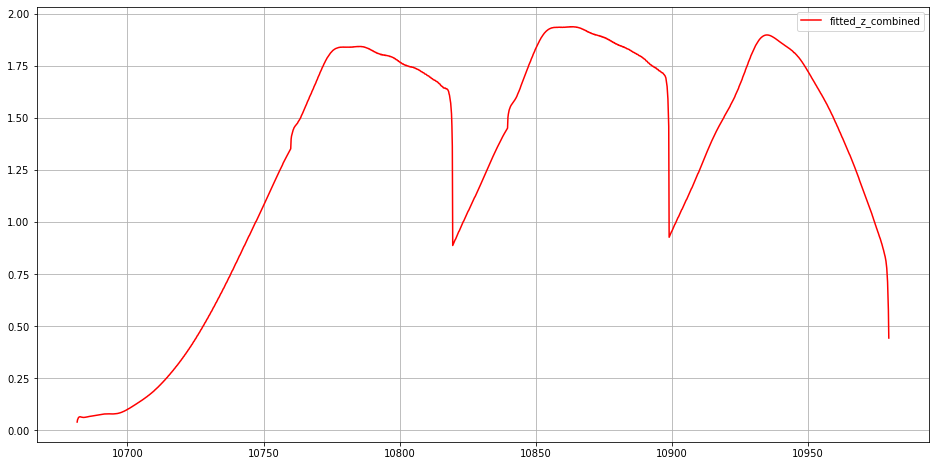

In [194]:
#f_combined = f_He(wavenew) + f_left(wavenew) + f_right(wavenew)

z_combined =f_He_z(wavenew) + f_left_z(wavenew) + f_right_z(wavenew)
print(z_combined)


fig = plt.figure(figsize = (16,8))
#plt.scatter(w_He_0, He_raw_0, label="observed")
plt.plot(wavenew, z_combined, c="red", label="fitted_z_combined")
#plt.plot(wavelength_right, He_raw_right, ":", c="tab:orange", label="right")
#plt.plot(wavelength, He_raw, ":", c="tab:blue", label="He")
#plt.plot(wavelength_left, He_raw_left,":", c="tab:purple", label="left")
plt.grid()
plt.legend()
plt.show()

z0 left center right の(2列目/3列目)を、同じように線形補完して足し合わせました= z_combined。割った結果が二つ目の図です。これに対して、median(z_combined)で割って規格化して、さらに-1すれば、LSDに使えるスペクトルになるですよね!

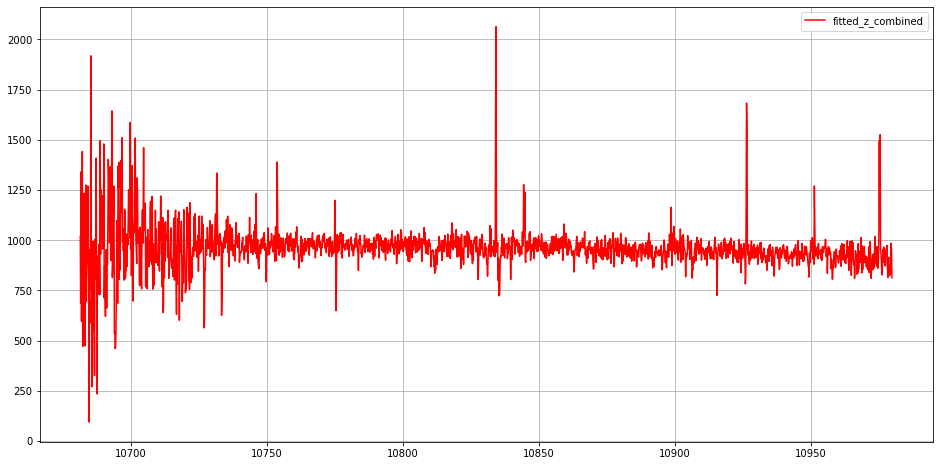

In [195]:
#

fig = plt.figure(figsize = (16,8))
#plt.scatter(w_He_0, He_raw_0, label="observed")
plt.plot(wavenew,  f_combined/z_combined, c="red", label="fitted_z_combined")
#plt.plot(wavelength_right, He_raw_right, ":", c="tab:orange", label="right")
#plt.plot(wavelength, He_raw, ":", c="tab:blue", label="He")
#plt.plot(wavelength_left, He_raw_left,":", c="tab:purple", label="left")
plt.grid()
plt.legend()
plt.show()

In [177]:
#Z_combined = He_raw/He_blaze + He_raw_left/He_blaze_left + He_raw_right/He_blaze_right
#に対して同じ作業を行う.
#print(Z_combined)
#print(Z_combined.shape)



[0.11749885 0.13842381 0.15631635 ... 1.53380937 1.43374699 1.32177966]
(1987,)


ValueError: operands could not be broadcast together with shapes (2000,) (1987,) 

In [176]:
fig = plt.figure(figsize = (16,8))
#plt.scatter(w_He_0, He_raw_0, label="observed")
plt.plot(wavenew, f_combined_flat, c="red", label="flat")
#plt.plot(wavelength_right, He_raw_right, ":", c="tab:orange", label="right")
#plt.plot(wavelength, He_raw, ":", c="tab:blue", label="He")
#plt.plot(wavelength_left, He_raw_left,":", c="tab:purple", label="left")
plt.grid()
plt.legend()
plt.show()

NameError: name 'f_combined_flat' is not defined

<Figure size 1152x576 with 0 Axes>

In [ ]:
fig, ax = plt.subplots()
ax.plot(wavelength, He_raw/He_blaze)       # Ratio. スペクトルの山なり情報を冷凍/解凍させる際使う. 紙の上でZとおいたりもしたな。
plt.show()

plt.plotの使い方
http://www2.yukawa.kyoto-u.ac.jp/~koudai.sugimoto/dokuwiki/doku.php?id=python:matplotlib:%E7%B7%9A%E7%A8%AE%E3%81%AE%E8%A8%AD%E5%AE%9A

In [37]:
from scipy import interpolate
ip1 = ["最近傍点補間", lambda x, y: interpolate.interp1d(x, y, kind="nearest")]
ip2 = ["線形補間", interpolate.interp1d]
ip3 = ["ラグランジュ補間", interpolate.lagrange]
ip4 = ["重心補間", interpolate.BarycentricInterpolator]
ip5 = ["Krogh補間", interpolate.KroghInterpolator]
ip6 = ["2次スプライン補間", lambda x, y: interpolate.interp1d(x, y, kind="quadratic")]
ip7 = ["3次スプライン補間", lambda x, y: interpolate.interp1d(x, y, kind="cubic")]
ip8 = ["秋間補間", interpolate.Akima1DInterpolator]
ip9 = ["区分的 3 次エルミート補間", interpolate.PchipInterpolator]

In [51]:


for method_name, method in [ip1, ip2, ip3, ip4, ip5, ip6, ip7, ip8, ip9]:
    
    print(method_name)
    
    #try:
    fig = plt.figure(figsize = (16,10))

    left_interpolate = method(wavelength_left_new, He_raw_left)
    #left_interpolate = lambda x, y: interpolate.interp1d(wavelength_left, He_raw_left, kind="nearest")
    plt.scatter(wavelength_left_new, He_raw_left, label="observed")
    plt.plot(wave, left_interpolate(wave), c="red", label="fitted")
    plt.grid()
    plt.legend()
    plt.show()
        
    #except:
        #print("ValueError: A value in x_new is above the interpolation range.")
        #continue

最近傍点補間


ValueError: x and y arrays must be equal in length along interpolation axis.

<Figure size 1152x720 with 0 Axes>

最近傍点補間


ValueError: A value in x_new is above the interpolation range.

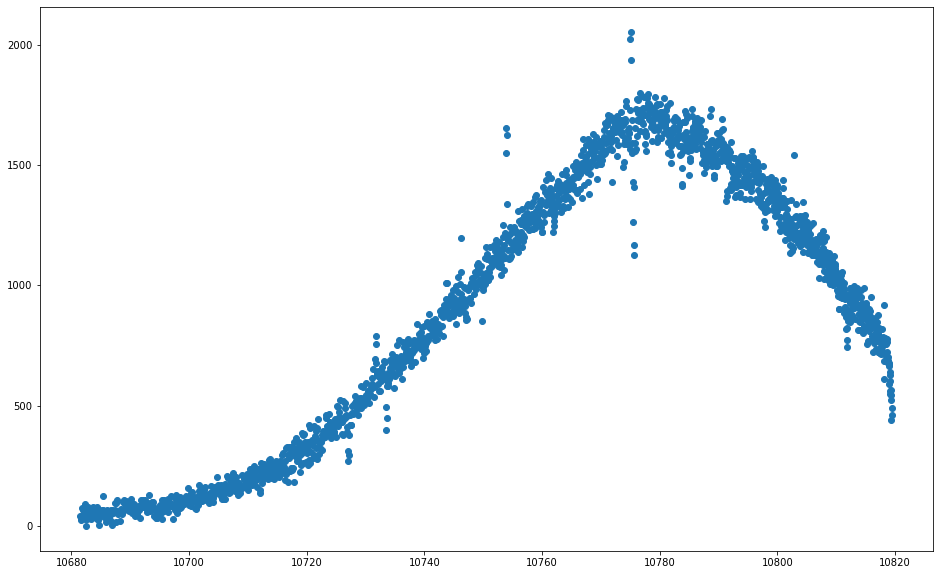

In [43]:


# for method_name, method in [ip1, ip2, ip3, ip4, ip5, ip6, ip7, ip8, ip9]:
    
#     print(method_name)
    
#     #try:
#     fig = plt.figure(figsize = (16,10))

#     left_interpolate = method(wavelength_left, He_raw_left)
#     #left_interpolate = lambda x, y: interpolate.interp1d(wavelength_left, He_raw_left, kind="nearest")
#     plt.scatter(wavelength_left, He_raw_left, label="observed")
#     plt.plot(wave, left_interpolate(wave), c="red", label="fitted")
#     plt.grid()
#     plt.legend()
#     plt.show()
        
#     #except:
#         #print("ValueError: A value in x_new is above the interpolation range.")
#         #continue

規格化前のraw plot

i= 0


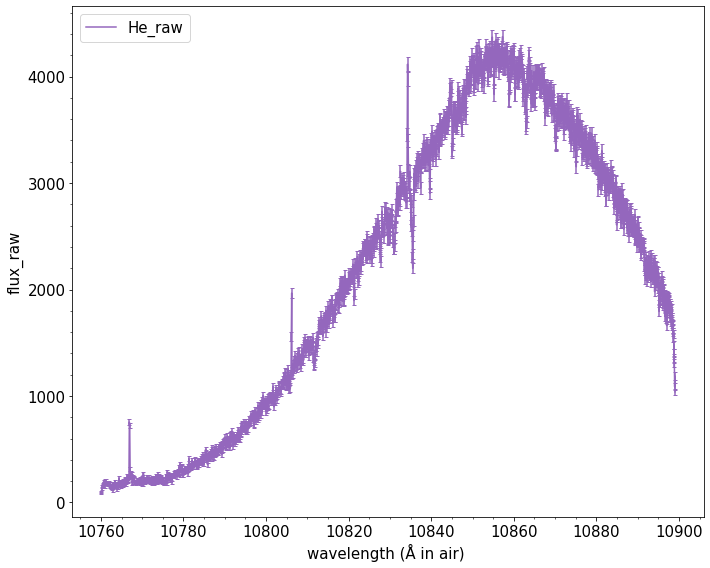

i= 1


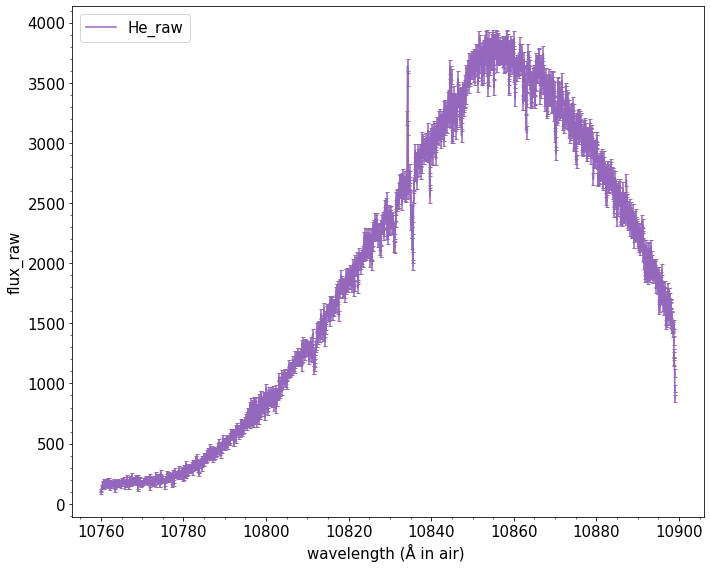

i= 2


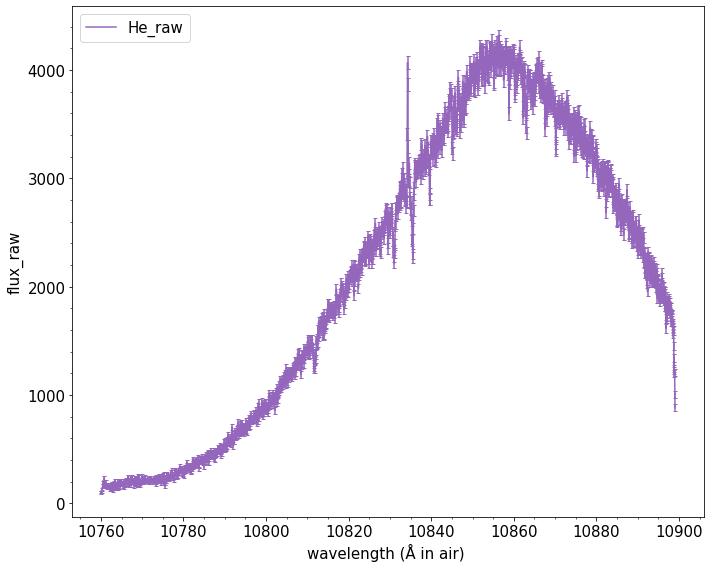

i= 3


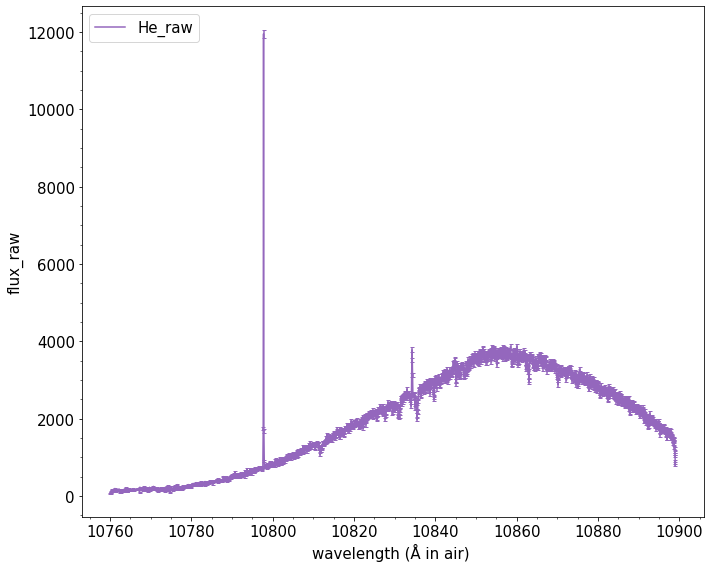

i= 4


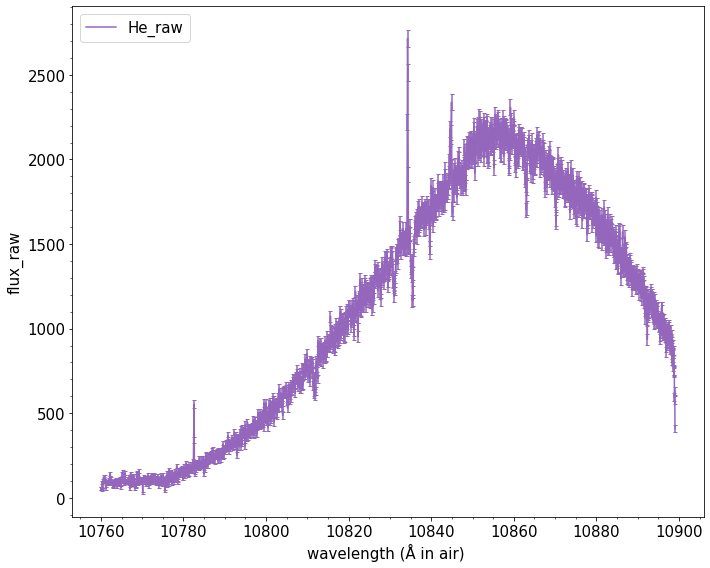

i= 5


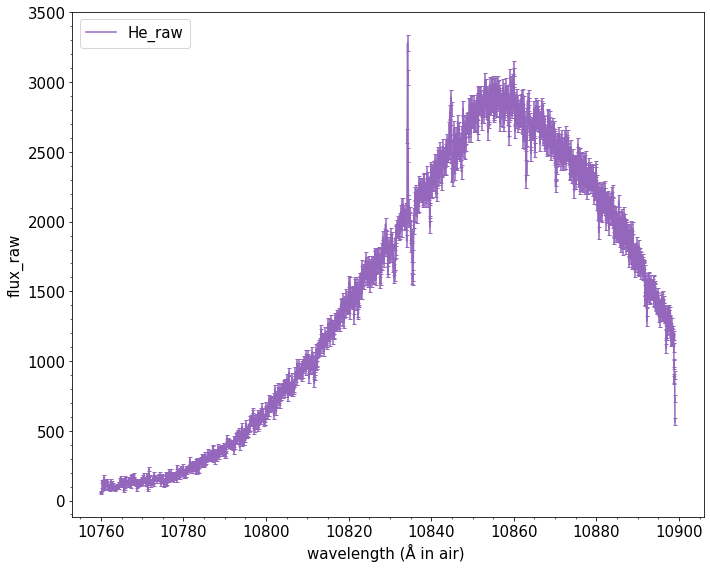

i= 6


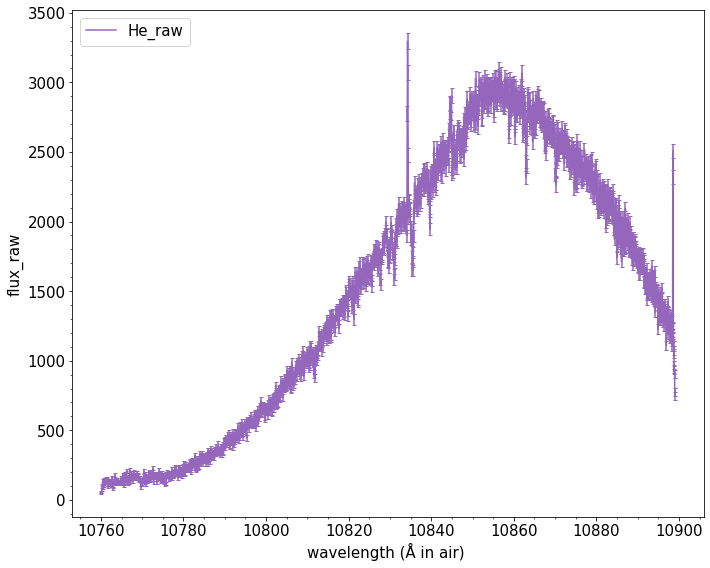

i= 7


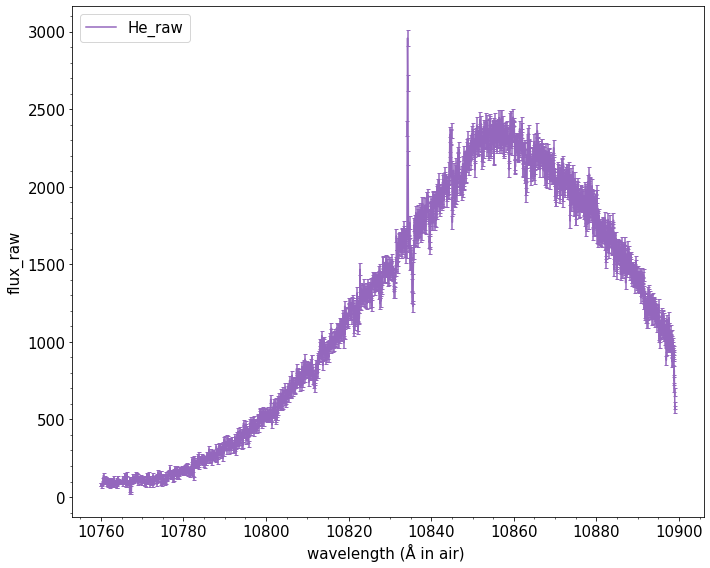

i= 8


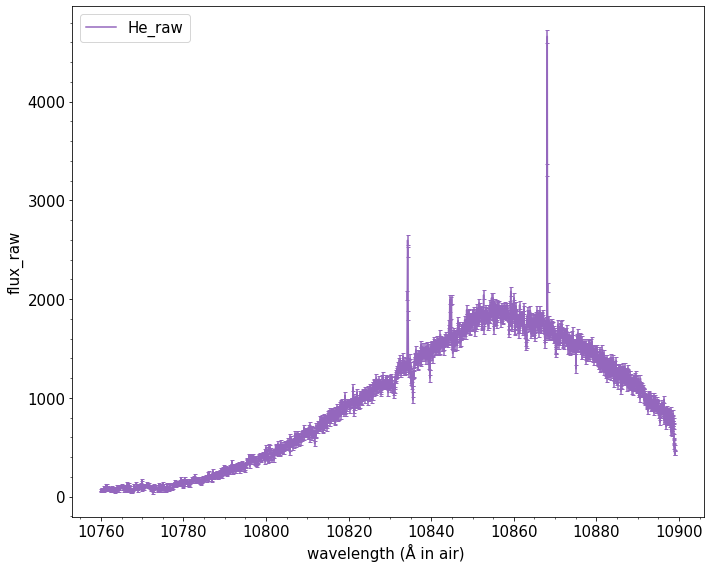

<ipython-input-115-6f6ca0cc8b1d>:6: RuntimeWarning: invalid value encountered in sqrt
  He_raw_err = He_raw ** 0.5


i= 9


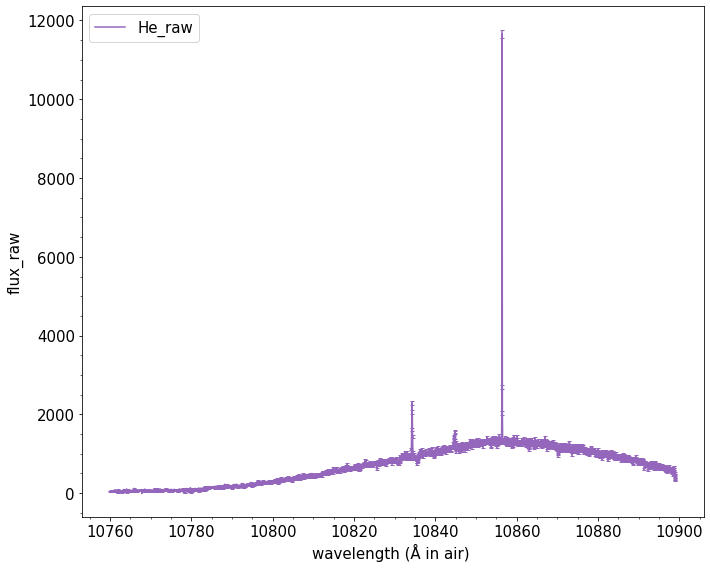

i= 10


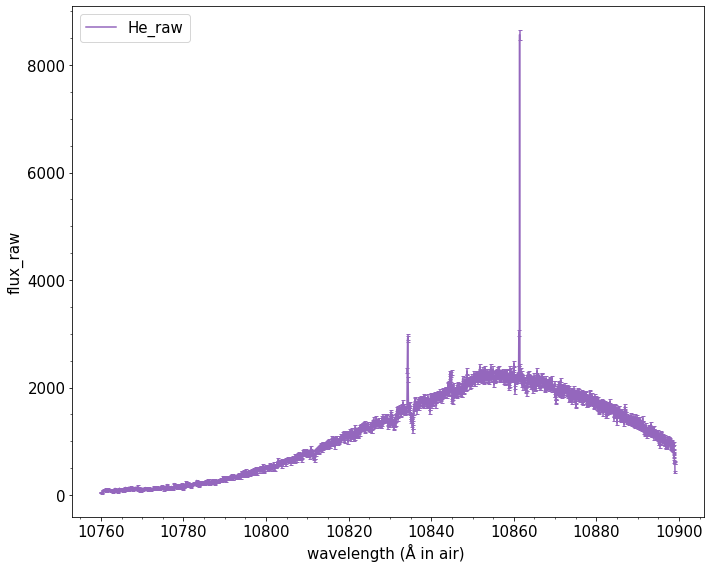

i= 11


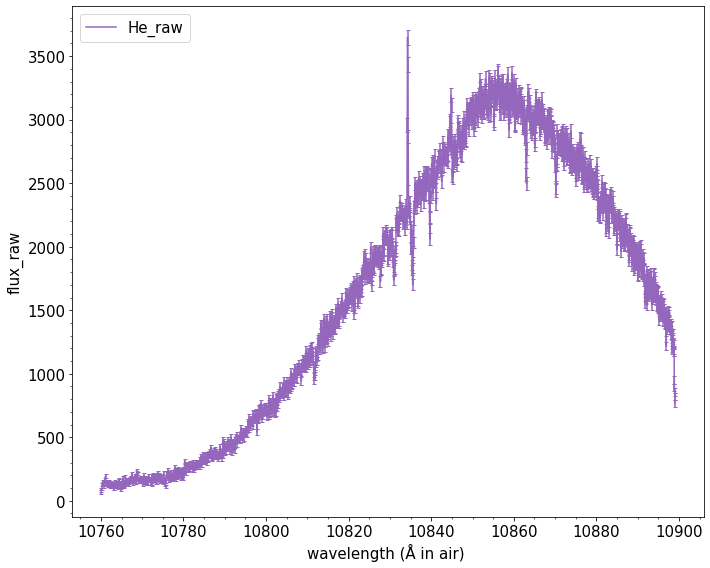

i= 12


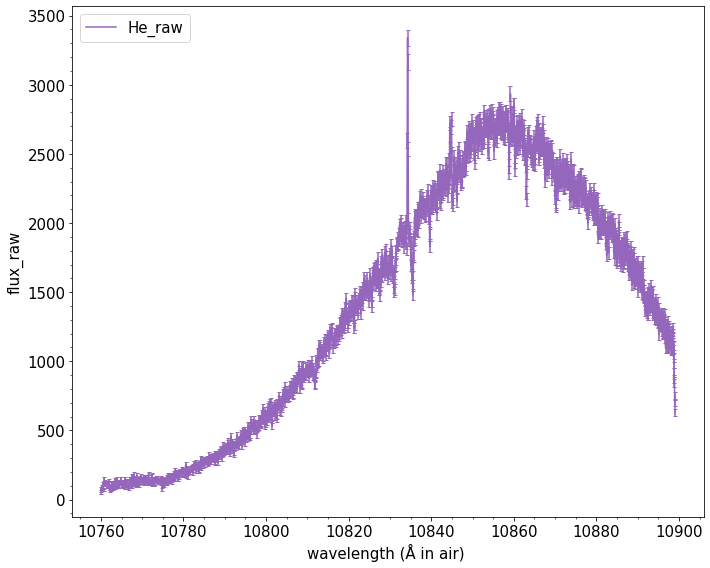

i= 13


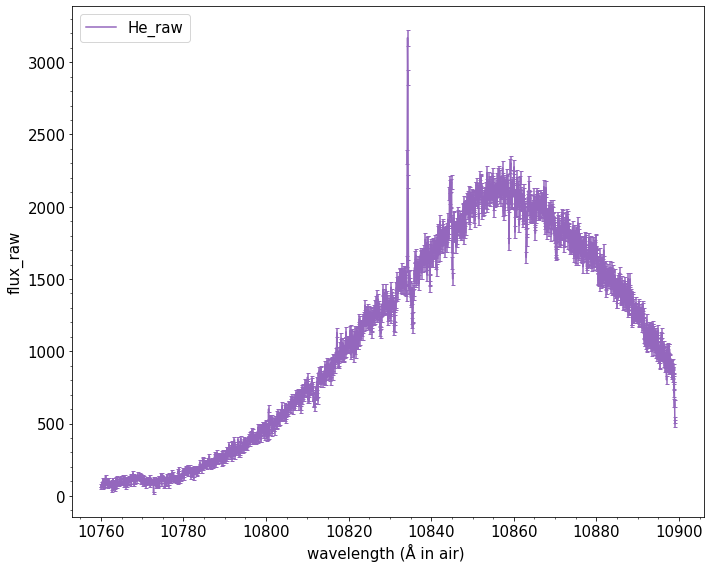

<ipython-input-115-6f6ca0cc8b1d>:6: RuntimeWarning: invalid value encountered in sqrt
  He_raw_err = He_raw ** 0.5


i= 14


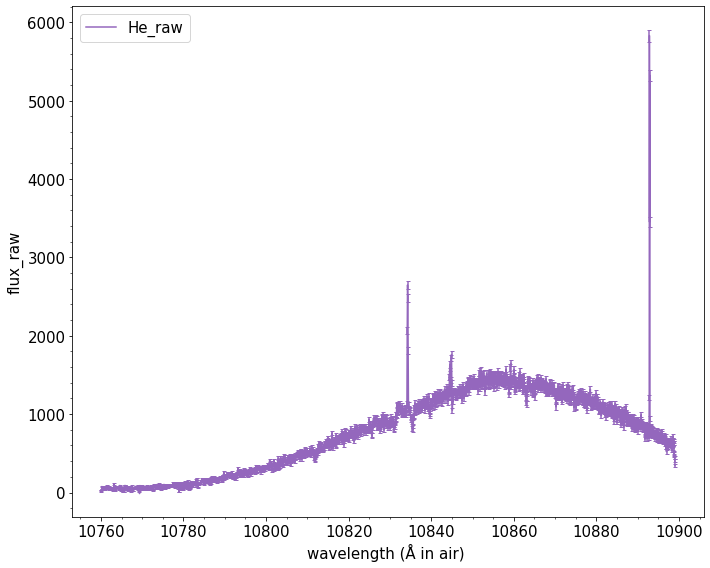

<ipython-input-115-6f6ca0cc8b1d>:6: RuntimeWarning: invalid value encountered in sqrt
  He_raw_err = He_raw ** 0.5


i= 15


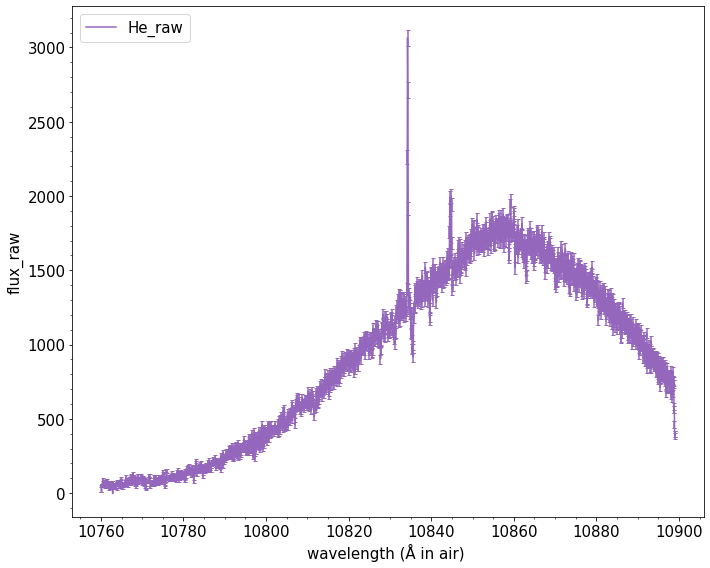

In [115]:
for i in range(16):
    wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=0)
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1)     #raw[1] 
    #He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=2) #raw[2]
    
    #He_raw_err = He_raw ** 0.5
    
    
    
    fig = plt.figure(figsize = (10, 8))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.plot( wavelength, He_raw,   markersize=1, color="tab:purple", label="He_raw" )
    #ax1.plot( wavelength_kawauchi, normal_kawauchi,   markersize=1, color="orange", label="normal_kiyoe" )
    
    #ax1.plot( wavelength, normal_err,  marker='$x$', markersize=3, color="g", label="normal_err" )
    ax1.set_xlabel("wavelength (Å in air) ", size=15 )
    ax1.set_ylabel("flux_raw", size=15)
    #ax1.set_ylabel("Relative Flux")
    ax1.legend(loc="upper left", fontsize = 15)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(0.6, 1.5)
    #ax1.set_ylim(0.6,1.9)
    #ax1.set_xlim(10820,10840)
    plt.tick_params(labelsize=15)   #目盛りラベルのフォントサイズを設定する方法

    plt.errorbar(x=wavelength, y=He_raw, yerr=He_raw_err, capsize=2,  ls='none',   ecolor='tab:purple')
    #plt.errorbar(x=wavelength_kawauchi, y=normal_kawauchi, yerr=normal_err_kawauchi,capsize=2,  ls='none',ecolor='orange')

    plt.minorticks_on()

    
    print("i=", i)
    #path = ""
    #plt.savefig( "./TOI654/Figures/He_blaze_plot_{0}.png".format(i))
    plt.tight_layout()  # タイトルの被りを防ぐ
    plt.show()

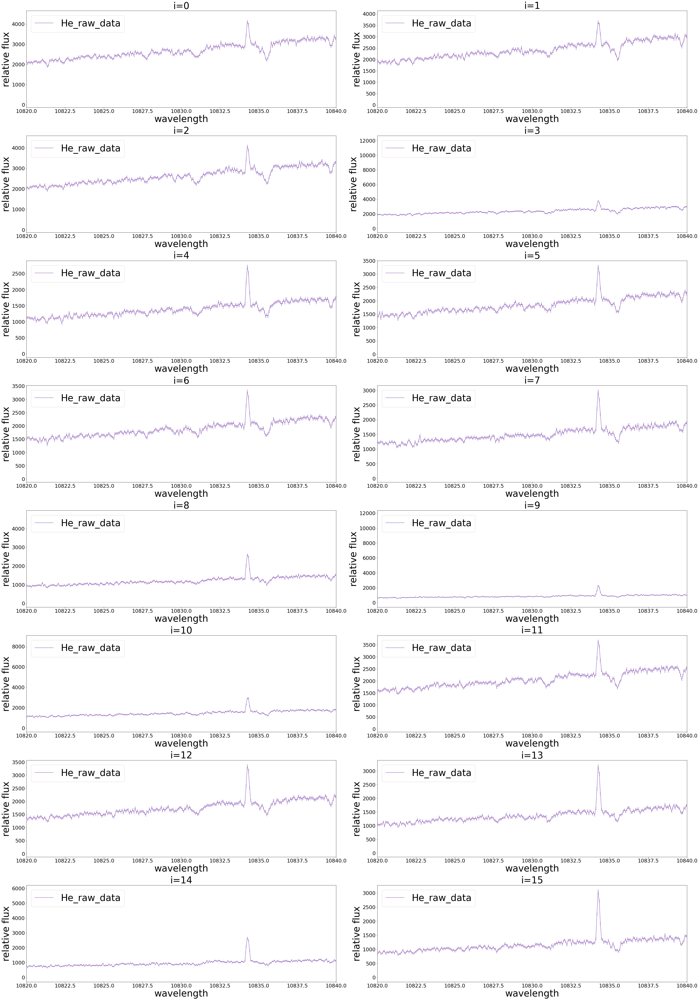

In [124]:
#規格化前のプロット
fig = plt.figure(figsize = (42,60))


for i in range(16):
    wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=0)
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1)     #raw[1] 
    He_raw_err = np.loadtxt("./TOI654/rawspec/He_raw&blaze_err_{0}.dat".format(i), usecols=0)   
    #He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=2) #raw[2]
    
    #He_raw_err = He_raw ** 0.5
    #He_raw_err = np.sqrt(He_raw)
    
    ##error!!
    #<ipython-input-113-b127ea5505dd>:10: RuntimeWarning: invalid value encountered in sqrt
    #He_raw_err = He_raw ** 0.5
    
    
    ax = fig.add_subplot(8,2,i+1) 
    #ax2 = fig.add_subplot(111)

    
    ax.plot( wavelength, He_raw,   markersize=1, color="tab:purple", label="He_raw_data" )
    ax.errorbar(x=wavelength, y=He_raw, yerr=He_raw_err, capsize=2,  ls='none',   ecolor='tab:purple')
    
    ax.set_xlabel("wavelength", size=40 )
    ax.set_ylabel("relative flux", size=40)
    ax.legend(loc="upper left", fontsize = 40)
    ax.set_title('i={0}'.format(i), size=40)
    
    
    #ax.set_ylim(0.7, 1.3)
    #ax1.set_xlim(10820, 10840)
    ax.set_xlim(10820, 10840)

    
    #print("i = ", i)
    
    # plt.title('rv correct', size = 15)
    # plt.tick_params(labelsize=11)
    ax.tick_params(labelsize=22)
    
    # plt.errorbar(x=He_raw, y=He_blaze, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:purple')
    # #plt.errorbar(x=He_raw_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    #plt.tight_layout()  # タイトルの被りを防ぐ
    #plt.show()
    #plt.show()
  
plt.tight_layout()

He_raw_err とHe_blaze_errをあらかじめ保存!

He_raw_err =  [ 9.80522144  9.65104927 11.21716923 ... 32.97280686 34.47662065
 32.21916492]
i= 0
(1987,)
He_raw [  96.14236758   93.14275206  125.82488562 ... 1087.20599213 1188.63737137
 1038.07458824]
He_blaze [2596.48170232 2137.72958385 2543.26427122 ... 2155.78837425 2529.10364864
 2405.06694027]
median_blaze= 2281.4136571957292
i= 0
wavelength= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
He_blaze_err= [264.8060237  221.50229716 226.72959801 ...  65.38079647  73.35706345
  74.64709114]
He_raw_err =  [10.55229271  9.70071622 11.56853592 ... 32.99555603 30.98833613
 29.57980524]
i= 1
(1987,)
He_raw [ 111.35088138   94.10389518  133.83102342 ... 1088.70671791  960.27697612
  874.96487801]
He_blaze [3007.21246311 2159.78888575 2705.09016207 ... 2158.7641187  2043.21356749
 2027.16560623]
median_blaze= 2054.4298424273743
i= 1
wavelength= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
H

<ipython-input-116-925616a90596>:19: RuntimeWarning: invalid value encountered in sqrt
  He_raw_err = np.sqrt(He_raw)


He_raw_err =  [ 8.3875174   7.29882516  9.4009457  ... 25.23218148 22.92095696
 22.35442156]
i= 13
(1987,)
He_raw [ 70.35044821  53.27284868  88.3777801  ... 636.6629821  525.37026815
 499.72016315]
He_blaze [1899.92878403 1222.67103045 1786.35608846 ... 1262.42006121 1117.84796109
 1157.77850397]
median_blaze= 1150.884128977309
i= 13
wavelength= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
He_blaze_err= [226.51861002 167.51614186 190.0187646  ...  50.03214099  48.7696898
  51.79192407]
He_raw_err =  [ 5.68271586  3.80372512  8.73669333 ... 21.23793012 20.09890889
 18.63664571]
i= 14
(1987,)
He_raw [ 32.29325959  14.46832476  76.3298104  ... 451.0496759  403.96613857
 347.32456321]
He_blaze [ 872.13223193  332.06411859 1542.83374597 ...  894.37296571  859.53231793
  804.7001959 ]
median_blaze= 791.4944492838254
i= 14
wavelength= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
He_blaze_err

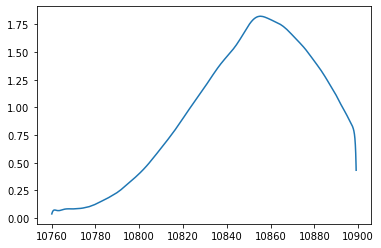

In [116]:
#( He_raw_err とHe_blaze_errをあらかじめ保存! )

#スペクトルを規格化
#規格化規格化する際、誤差に対しても
import statistics


#for i in range(0,31):
#これだと OSError: ./TOI654/rawspec/He_raw_0.dat not found. になる。
#for i in [1, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]:
for i in range(16):
    #wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=0) 
    #He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=1) #raw[1]
    #He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=2) #raw[2]
    wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=0) 
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1) #raw[1]
    He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=2) #raw[2]
    
    He_raw_err = np.sqrt(He_raw)

    print("He_raw_err = ", He_raw_err)
    
    #すでに、nanを切ったから.
    #if len(He_blaze) < 2048:
    if len(He_blaze) < 1987:
    
        print(i,"th file: No data")
        print(len(He_blaze))
        continue
    
    median = statistics.median(He_blaze) #ここのmedianはHe_blazeのmedian 
    # normal = He_blaze / median # raw[1] / median
    
    print("i=", i)
    print(normal.shape)
    print('He_raw', He_raw)
    print('He_blaze', He_blaze)
    print('median_blaze=', median)
    # print('normal=', normal)
    

    #if len(He_raw) < 2048:
    if len(He_raw) < 1987:
        print(i,"th file: No data")
        print(len(He_raw))
        continue
    
    #median = statistics.median(He_raw)
    #median_err = median ** 0.5
    
    He_blaze_err = He_raw_err / (He_raw/He_blaze)   # blaze補正前のfluxのphoton noiseは(He_raw ** 0.5)で、それをblaze補正後のnoiseに直す.
    
    # #median_err = statistics.median(He_blaze_err)
    
    # #normal_err = ( ((1/median) * He_blaze_err) ** 2 + ( ( (He_blaze/ (median ** 2) ) ) * median_err ) ** 2 ) ** 0.5  #規格化する際の誤差伝播.
    # #normal = He_raw / median
    
    # #規格化のエラー実は、、!!
    # normal_err = He_blaze_err / median
    
    print("i=", i)
    #print(normal_err.shape)
    print('wavelength=', wavelength)
    print('He_blaze_err=', He_blaze_err)
    #print('median_err=', median_err)
    #print('normal_err=', normal_err)
    
    
    #ここでi+=1だとループが変になっちゃう。
    
    #np.savetxt 複数配列の保存方法
   
   
    outputfile = './TOI654/rawspec/He_raw&blaze_err_{0}.dat'.format(i) 
    
    d = np.column_stack((He_raw_err , He_blaze_err))     #np.savetxt 複数配列の保存方法
    
    #d = np.column_stack((d , normal_err)) 
    
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    #np.savetxt("./TOI654/normal/normal_err_{0}.dat".format(i), normal_err) #フォルダーを先に作っとかないといけないの?!
    
fig, ax = plt.subplots()
ax.plot(wavelength, He_raw/He_blaze)       # Ratio. スペクトルの山なり情報を冷凍/解凍させる際使う. 紙の上でZとおいたりもしたな。
plt.show()

規格化前のblazeプロット:

i= 0


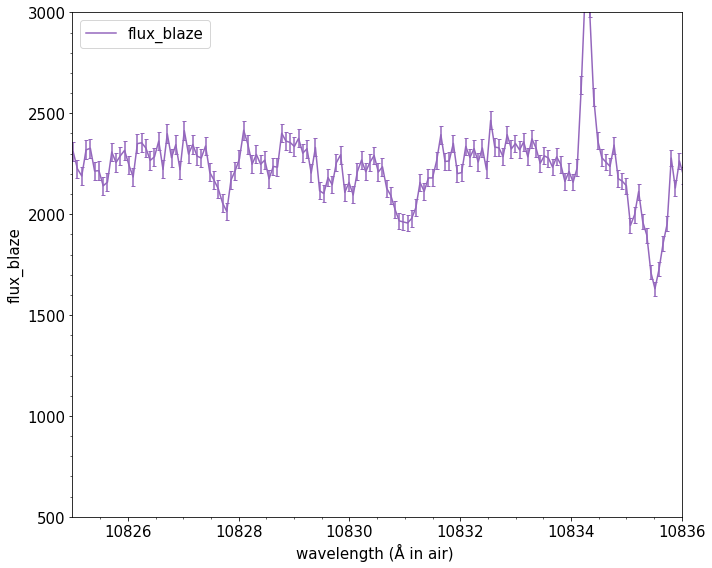

i= 1


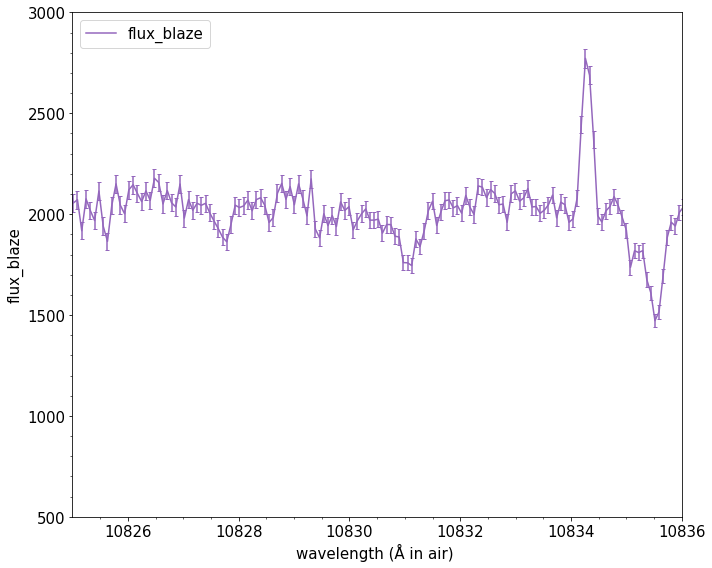

i= 2


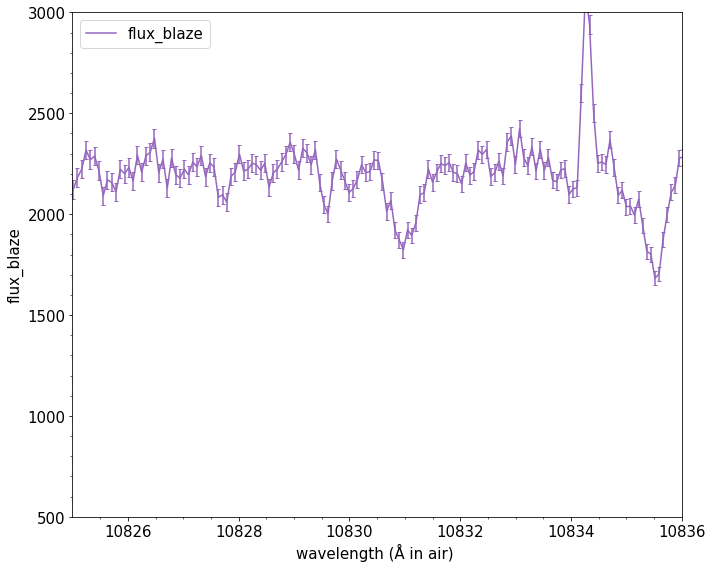

i= 3


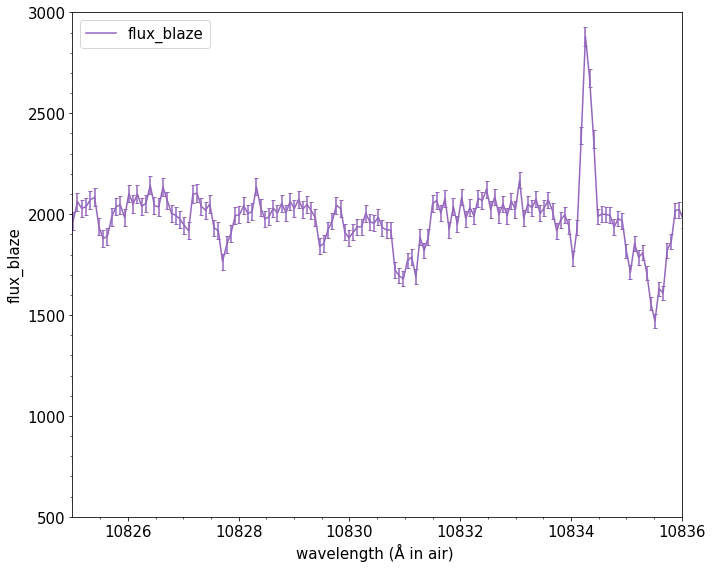

i= 4


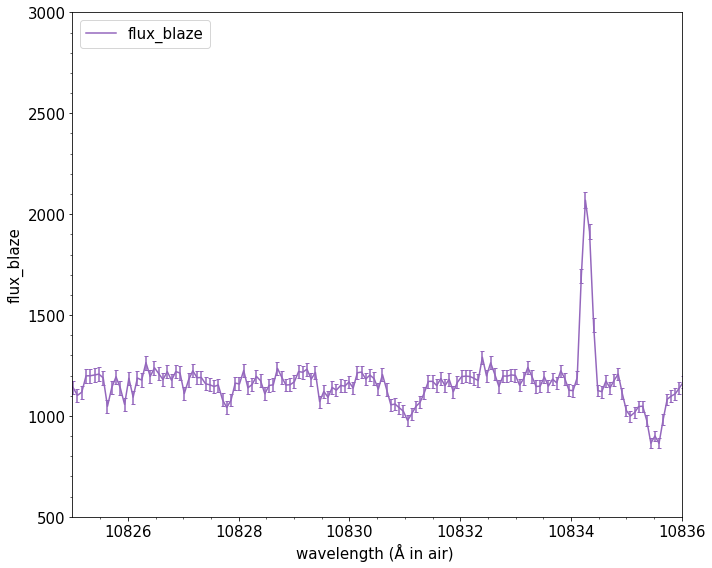

i= 5


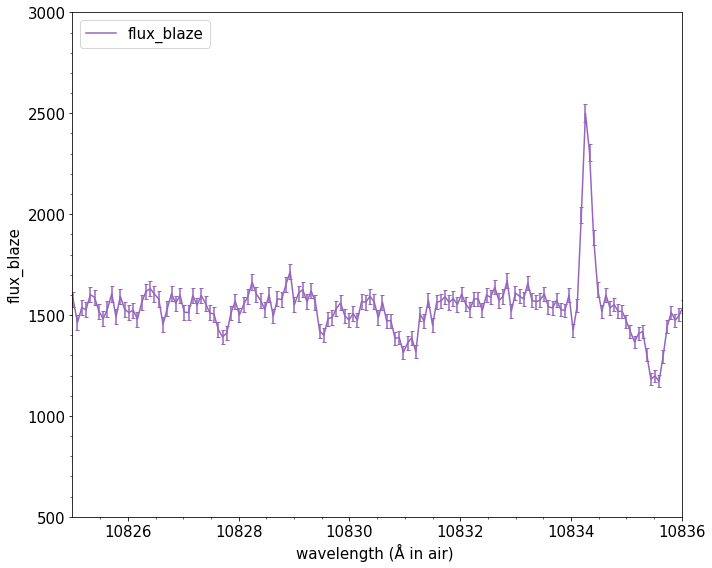

i= 6


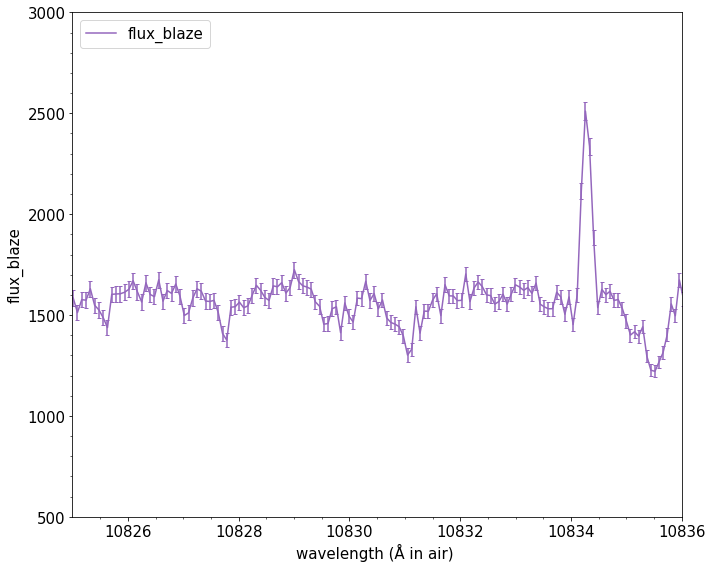

i= 7


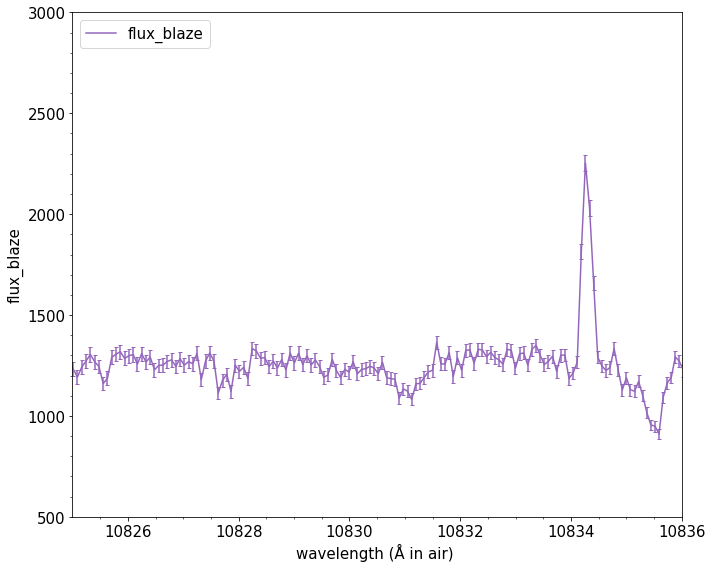

i= 8


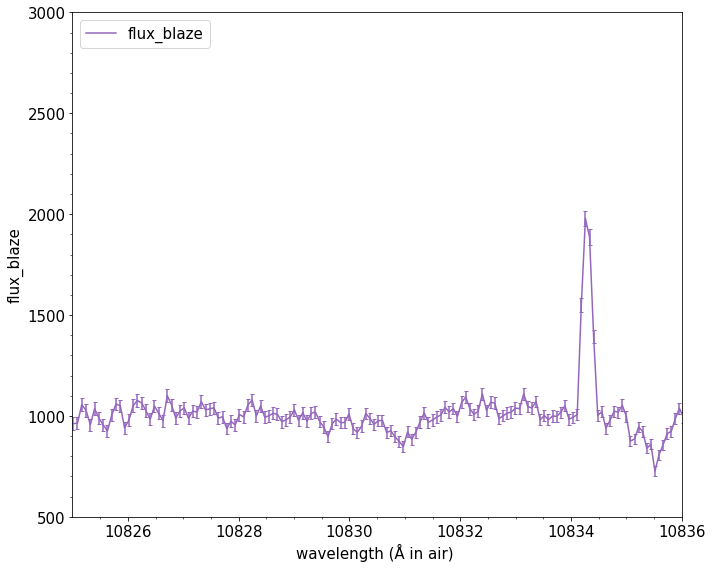

<ipython-input-112-610cd1ff1f40>:4: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)


i= 9


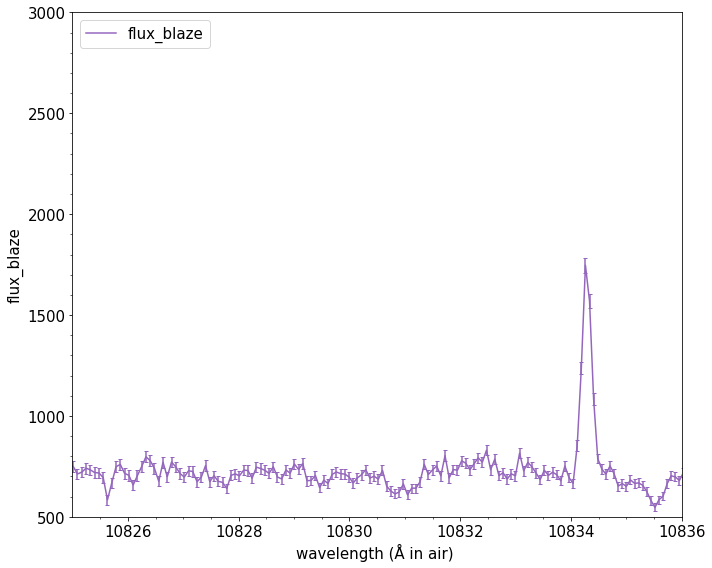

i= 10


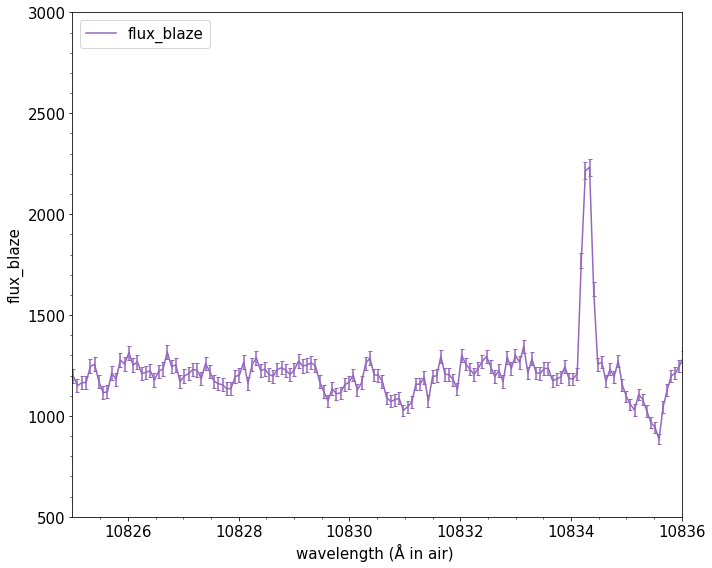

i= 11


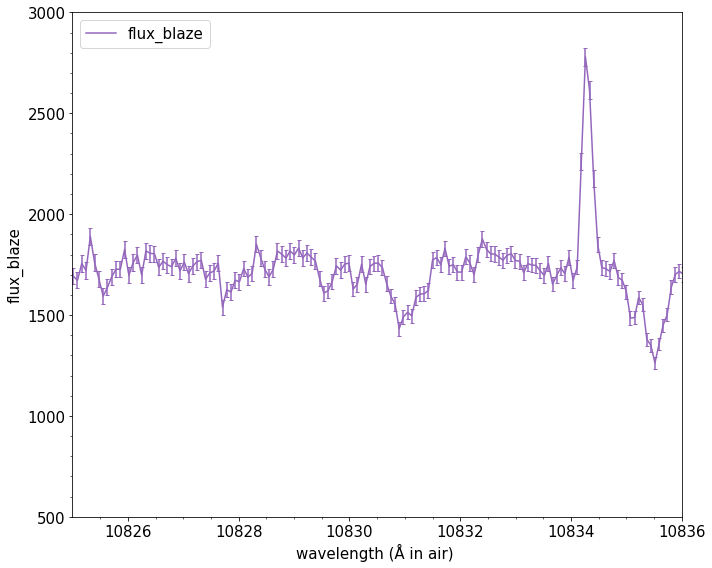

i= 12


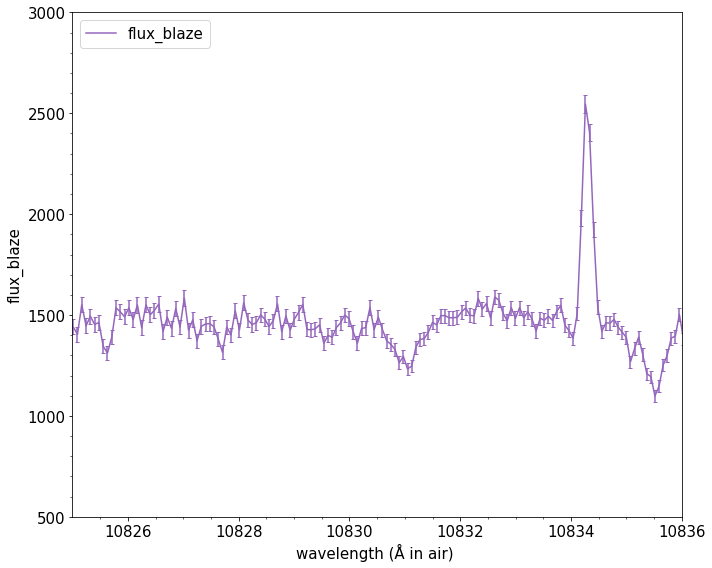

i= 13


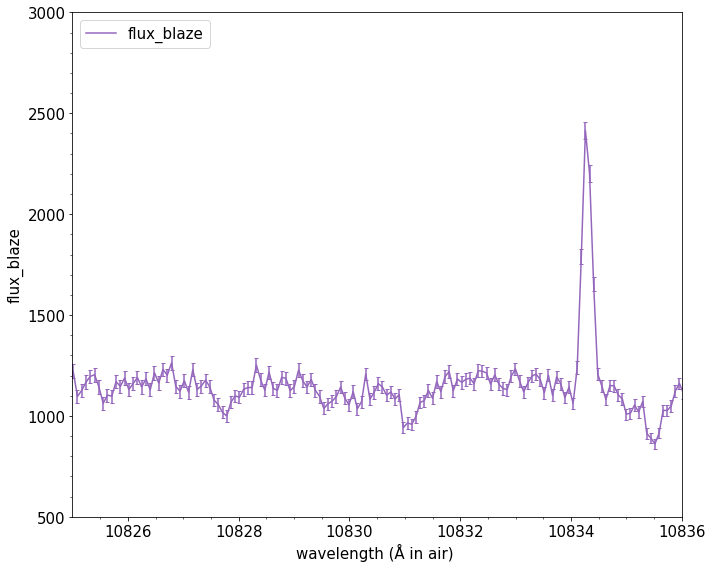

<ipython-input-112-610cd1ff1f40>:4: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)


i= 14


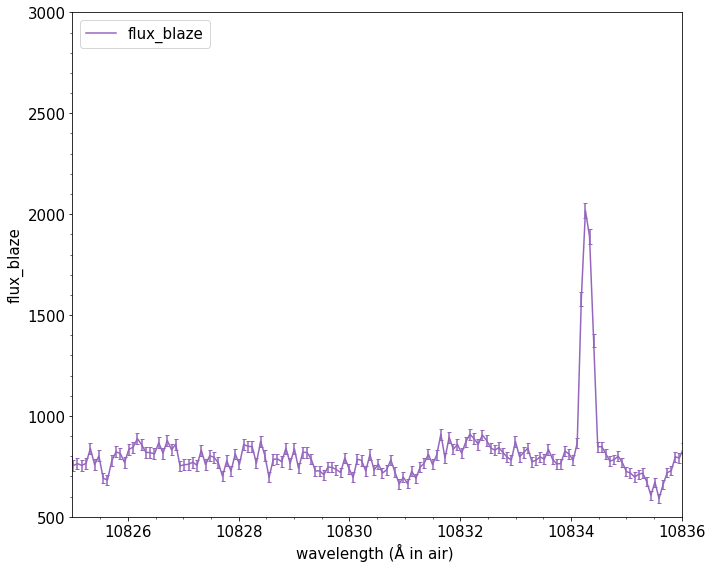

<ipython-input-112-610cd1ff1f40>:4: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)


i= 15


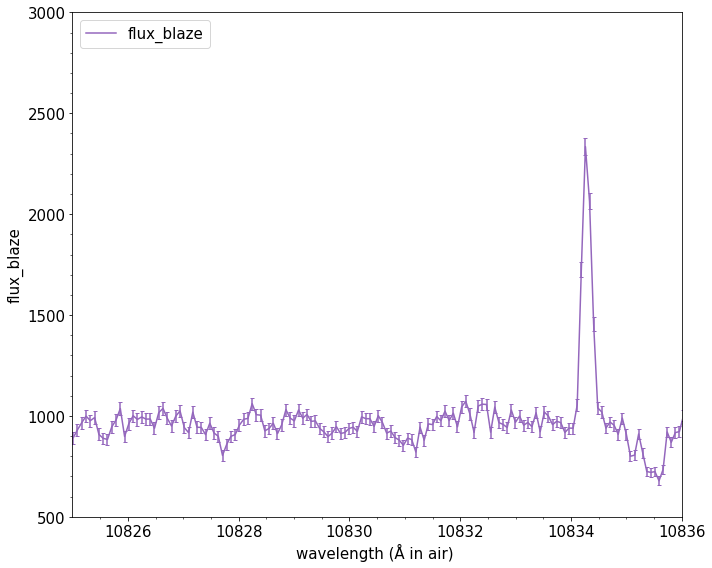

In [112]:
for i in range(16):
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1) #raw[1]
    He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=2)  #raw[2]
    He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)
    
    fig = plt.figure(figsize = (10, 8))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.plot( wavelength, He_blaze,   markersize=1, color="tab:purple", label="flux_blaze" )
    #ax1.plot( wavelength_kawauchi, normal_kawauchi,   markersize=1, color="orange", label="normal_kiyoe" )
    
    #ax1.plot( wavelength, normal_err,  marker='$x$', markersize=3, color="g", label="normal_err" )
    ax1.set_xlabel("wavelength (Å in air) ", size=15 )
    ax1.set_ylabel("flux_blaze", size=15)
    #ax1.set_ylabel("Relative Flux")
    ax1.legend(loc="upper left", fontsize = 15)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(0.6, 1.5)
    #ax1.set_ylim(0.6,1.9)
    ax1.set_ylim(500, 3000)
    ax1.set_xlim(10825,10836)
    plt.tick_params(labelsize=15)   #目盛りラベルのフォントサイズを設定する方法

    plt.errorbar(x=wavelength, y=He_blaze, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:purple')
    #plt.errorbar(x=wavelength_kawauchi, y=normal_kawauchi, yerr=normal_err_kawauchi,capsize=2,  ls='none',ecolor='orange')

    plt.minorticks_on()

    
    print("i=", i)
    #path = ""
    plt.savefig( "./TOI654/Figures/He_blaze_plot_{0}.png".format(i))
    plt.tight_layout()  # タイトルの被りを防ぐ
    plt.show()

<ipython-input-127-081380bf302d>:9: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)
<ipython-input-127-081380bf302d>:9: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)
<ipython-input-127-081380bf302d>:9: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)


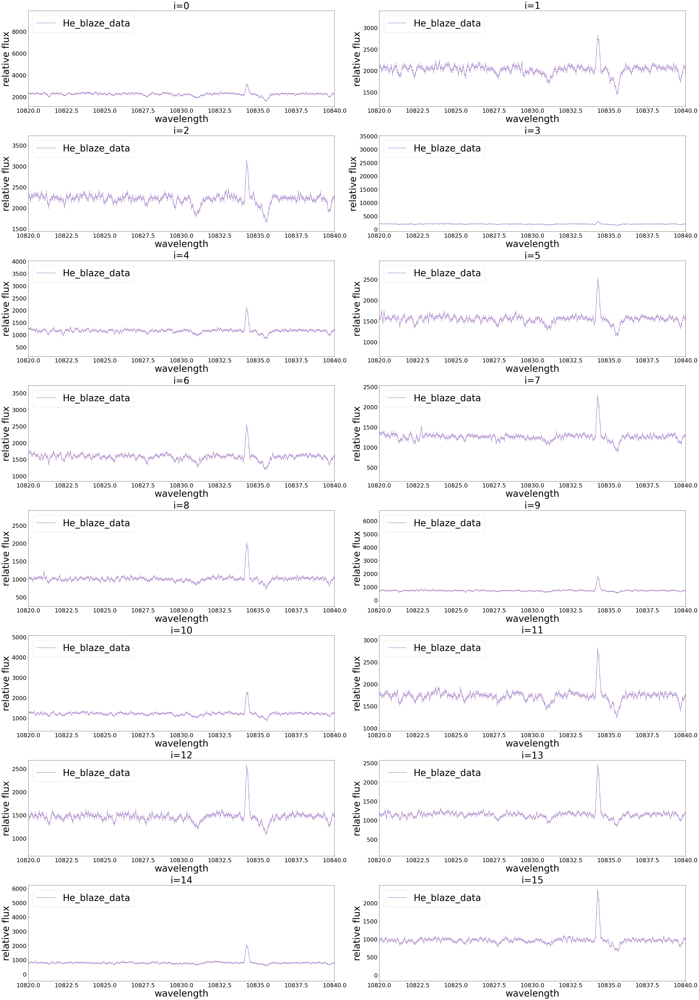

In [127]:
#規格化前のプロット
fig = plt.figure(figsize = (42,60))


for i in range(16):
    wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=0) 
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1) #raw[1]
    He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=2)  #raw[2]
    He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)
    
    

    
    
    ax = fig.add_subplot(8,2,i+1) 
    #ax2 = fig.add_subplot(111)

    
    ax.plot( wavelength, He_blaze,   markersize=1, color="tab:purple", label="He_blaze_data" )
    ax.errorbar(x=wavelength, y=He_blaze, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:purple')
    
    ax.set_xlabel("wavelength", size=40 )
    ax.set_ylabel("relative flux", size=40)
    ax.legend(loc="upper left", fontsize = 40)
    ax.set_title('i={0}'.format(i), size=40)
    
    
    #ax.set_ylim(0.7, 1.3)
    #ax1.set_xlim(10820, 10840)
    ax.set_xlim(10820, 10840)

    
    #print("i = ", i)
    
    # plt.title('rv correct', size = 15)
    # plt.tick_params(labelsize=11)
    
    ax.tick_params(labelsize=25)
    
    # plt.errorbar(x=He_raw, y=He_blaze, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:purple')
    # #plt.errorbar(x=He_raw_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    #plt.tight_layout()  # タイトルの被りを防ぐ
    #plt.show()
    #plt.show()
    
plt.tight_layout()


##### 正規化と誤差伝播をここで行う

i= 0
(1987,)
He_raw [  96.14236758   93.14275206  125.82488562 ... 1087.20599213 1188.63737137
 1038.07458824]
He_blaze [2596.48170232 2137.72958385 2543.26427122 ... 2155.78837425 2529.10364864
 2405.06694027]
median_blaze= 2281.4136571957292
normal= [1.13810211 0.93701972 1.1147756  ... 0.94493533 1.10856865 1.05420029]
err =  [264.8060237  221.50229716 226.72959801 ...  65.38079647  73.35706345
  74.64709114]
i= 0
wavelength= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
He_blaze_err= [264.8060237  221.50229716 226.72959801 ...  65.38079647  73.35706345
  74.64709114]
i= 1
(1987,)
He_raw [ 111.35088138   94.10389518  133.83102342 ... 1088.70671791  960.27697612
  874.96487801]
He_blaze [3007.21246311 2159.78888575 2705.09016207 ... 2158.7641187  2043.21356749
 2027.16560623]
median_blaze= 2054.4298424273743
normal= [1.46376985 1.05128384 1.3167109  ... 1.05078503 0.99454044 0.98672905]
err =  [284.98190361 222.64220876 233.83167757 .

<ipython-input-72-b0c25e2c07b2>:48: RuntimeWarning: invalid value encountered in sqrt
  He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)   # blaze補正前のfluxのphoton noiseは(He_raw ** 0.5)で、それをblaze補正後のnoiseに直す.


i= 11
(1987,)
He_raw [ 64.40179688  90.90021621  90.60988644 ... 855.83266022 818.21980064
 766.04855278]
He_blaze [1739.27573644 2086.26089606 1831.47304809 ... 1697.00508695 1740.95374506
 1774.82241623]
median_blaze= 1746.0401209638696
normal= [0.99612587 1.19485278 1.04892953 ... 0.97191643 0.99708691 1.01648433]
err =  [216.73020712 218.81956977 192.40339852 ...  58.00811007  60.8628437
  64.1249083 ]
i= 11
wavelength= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
He_blaze_err= [216.73020712 218.81956977 192.40339852 ...  58.00811007  60.8628437
  64.1249083 ]
i= 12
(1987,)
He_raw [ 80.85592007  50.3148245   94.81394857 ... 704.37651787 748.17479851
 626.41459817]
He_blaze [2183.64621407 1154.78109092 1916.44861523 ... 1396.68721412 1591.91664195
 1451.31097324]
median_blaze= 1475.1167016712632
normal= [1.48032099 0.7828405  1.29918441 ... 0.94683167 1.07918014 0.9838618 ]
err =  [242.8434339  162.79898122 196.81629974 ...  52.6255

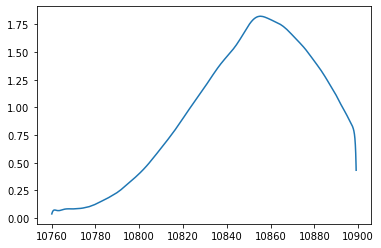

In [ ]:
#( 保存データに _e をつけた. )

#スペクトルを規格化
#規格化規格化する際、誤差に対しても
import statistics


#for i in range(0,31):
#これだと OSError: ./TOI654/rawspec/He_raw_0.dat not found. になる。
#for i in [1, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]:
for i in range(16):
    #wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=0) 
    #He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=1) #raw[1]
    #He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=2) #raw[2]
    wavelength = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=0) 
    He_raw = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=1) #raw[1]
    He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_latest_{0}.dat".format(i), usecols=2) #raw[2]
    

    #すでに、nanを切ったから.
    #if len(He_blaze) < 2048:
    if len(He_blaze) < 1987:
    
        print(i,"th file: No data")
        print(len(He_blaze))
        continue
    
    median = statistics.median(He_blaze) #ここのmedianはHe_blazeのmedian 
    normal = He_blaze / median # raw[1] / median
    
    print("i=", i)
    print(normal.shape)
    print('He_raw', He_raw)
    print('He_blaze', He_blaze)
    print('median_blaze=', median)
    print('normal=', normal)
    

    #if len(He_raw) < 2048:
    if len(He_raw) < 1987:
        print(i,"th file: No data")
        print(len(He_raw))
        continue
    
    #median = statistics.median(He_raw)
    #median_err = median ** 0.5
    
    He_blaze_err = (He_raw ** 0.5) / (He_raw/He_blaze)   # blaze補正前のfluxのphoton noiseは(He_raw ** 0.5)で、それをblaze補正後のnoiseに直す.
    print("err = ", He_blaze_err)
    #median_err = statistics.median(He_blaze_err)
    
    #normal_err = ( ((1/median) * He_blaze_err) ** 2 + ( ( (He_blaze/ (median ** 2) ) ) * median_err ) ** 2 ) ** 0.5  #規格化する際の誤差伝播.
    #normal = He_raw / median
    
    #規格化のエラー実は、、!!
    normal_err = He_blaze_err / median
    
    print("i=", i)
    #print(normal_err.shape)
    print('wavelength=', wavelength)
    print('He_blaze_err=', He_blaze_err)
    #print('median_err=', median_err)
    #print('normal_err=', normal_err)
    
    
    #ここでi+=1だとループが変になっちゃう。
    
    #np.savetxt 複数配列の保存方法
   
   
    outputfile = './TOI654/normal/normal_err_latest_{0}.dat'.format(i) 
    
    d = np.column_stack((wavelength , normal))     #np.savetxt 複数配列の保存方法
    
    d = np.column_stack((d , normal_err)) 
    
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    #np.savetxt("./TOI654/normal/normal_err_{0}.dat".format(i), normal_err) #フォルダーを先に作っとかないといけないの?!
    
fig, ax = plt.subplots()
ax.plot(wavelength, He_raw/He_blaze)       # Ratio. スペクトルの山なり情報を冷凍/解凍させる際使う. 紙の上でZとおいたりもしたな。
plt.show()

Pythonでファイル名の前後に文字列や連番を加えて一括変更
(重大エラー!! -->macでファイルのフォーマット連番変更では、前のファイルの順番を無視して番号をつけることになる...)

https://note.nkmk.me/python-os-rename-glob-format-basename-splitext/


In [34]:
import os
import glob

path = './TOI654/rawspec/He_blaze_nan_e_ordering2/'
files = sorted(glob.glob(path+'He_blaze_nan_e*.dat'))
#files = glob.glob(path+'He_blaze_nan_e*.dat')  これバラバラな順番で読み込んでいた...
print(files)
 
for i, f in enumerate(files):
    fname = 'He_blaze_nan_o_' + str(i) + '.dat'
    print(f,fname)
    os.rename(f, os.path.join(path,fname))
    print(f,fname)

print(files)
# for i, f in enumerate(files):
#     ftitle, fext = os.path.splitext(f)
#     os.rename(f, ftitle + '_' + '{0}'.format(i) + fext)
    
 
#for i, f in enumerate(files):
#    os.rename(f, os.path.join(path, '{0:00d}'.format(i) +
#                              '_' + os.path.basename(f)))

['./TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_1.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_10.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_12.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_14.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_16.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_18.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_20.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_22.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_24.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_26.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_28.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_3.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_30.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_4.dat', './TOI654/rawspec/He_blaze_nan_e_ordering2/He_blaze_nan_e_6.dat'

規格化後、16本出力して!!

In [60]:
#~~川内さんのファイル名を変更するコードブロック_normal~~

kawauchi = []

index = -1
for i in range(24, 59, 2):  # i, j使わなくて済む. なんというか、二重ループでなければいらないのか。?
    #奇数番号をスキップしました!!
    
    try:


        kawauchi = np.loadtxt("./TOI654/normal_data/408{}_ss_smmf2_wc_Ccutne.dat".format(i),  usecols=(0,1,2), unpack=True) 
        
        kawauchi = kawauchi.T
        
        print("i=", i)
        print(kawauchi.shape)
        print('kawauchi=', kawauchi)
        index += 1
        #ここでi+=1だとループが変になっちゃう。
        
        #np.savetxt 複数配列の保存方法
        #for j in range(0,16):
        #   print('j=', j)
    
    except OSError:
        print("OSError: .spec not found.")
        continue
    
    print("i_2nd=", index)
    
    np.savetxt("./TOI654/normal_data/normal_data_latest/ss_smmf2_wc_Ccutne_{0}.dat".format(index), kawauchi)  ## 大発見!!

i= 24
(1987, 3)
kawauchi= [[1.07600435e+04 1.12862540e+00 1.15104500e-01]
 [1.07601407e+04 9.29217300e-01 9.62815000e-02]
 [1.07602379e+04 1.10549310e+00 9.85537000e-02]
 ...
 [1.08989495e+04 9.37067200e-01 2.84194000e-02]
 [1.08989907e+04 1.09933740e+00 3.18865000e-02]
 [1.08990320e+04 1.04542270e+00 3.24472000e-02]]
i_2nd= 0
i= 26
(1987, 3)
kawauchi= [[1.07600435e+04 1.45132960e+00 1.37536900e-01]
 [1.07601407e+04 1.04234900e+00 1.07450700e-01]
 [1.07602379e+04 1.30551990e+00 1.12850900e-01]
 ...
 [1.08989495e+04 1.04185480e+00 3.15756000e-02]
 [1.08989907e+04 9.86087800e-01 3.18213000e-02]
 [1.08990320e+04 9.78343000e-01 3.30747000e-02]]
i_2nd= 1
i= 28
(1987, 3)
kawauchi= [[1.07600435e+04 1.25107670e+00 1.22244900e-01]
 [1.07601407e+04 1.02251690e+00 1.01880400e-01]
 [1.07602379e+04 9.67337800e-01 9.29940000e-02]
 ...
 [1.08989495e+04 1.06119470e+00 3.05069000e-02]
 [1.08989907e+04 9.46314200e-01 2.98421000e-02]
 [1.08990320e+04 9.07072400e-01 3.04876000e-02]]
i_2nd= 2
i= 30
(1987, 

i= 0


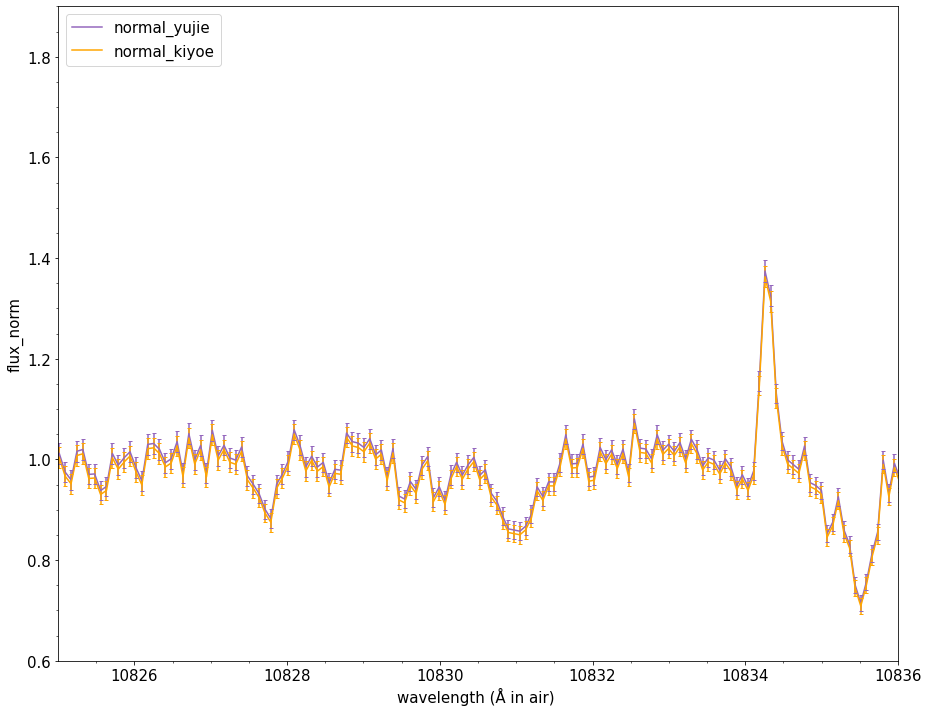

i= 1


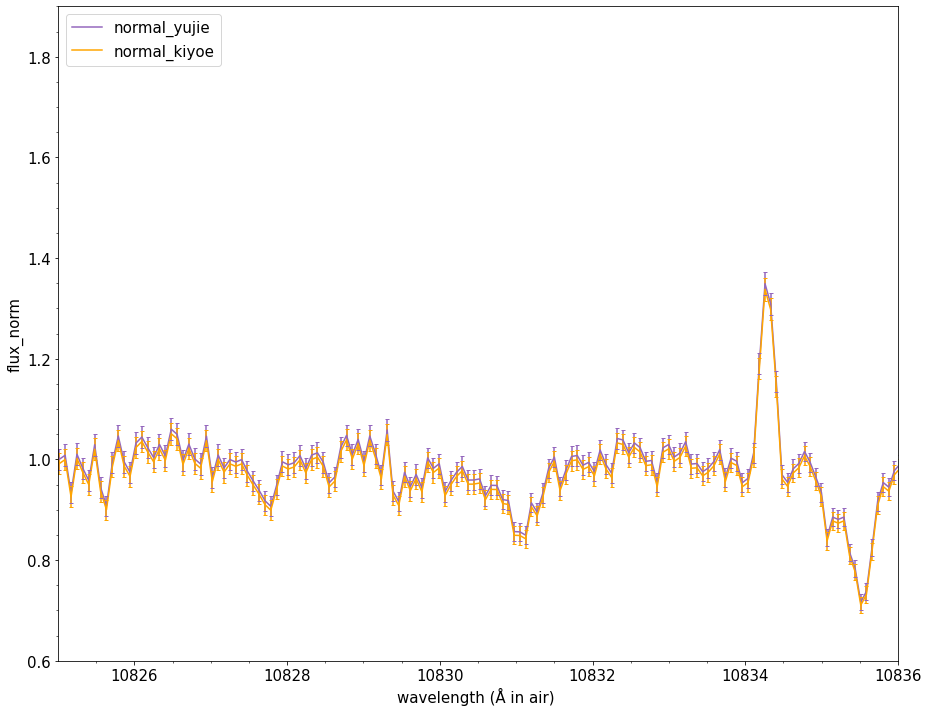

i= 2


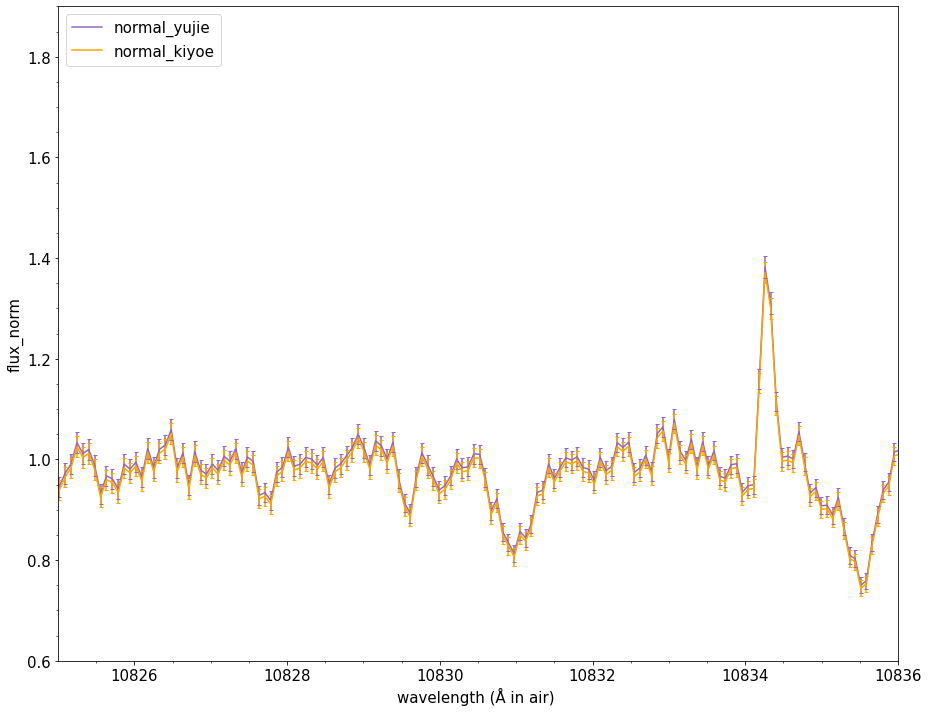

i= 3


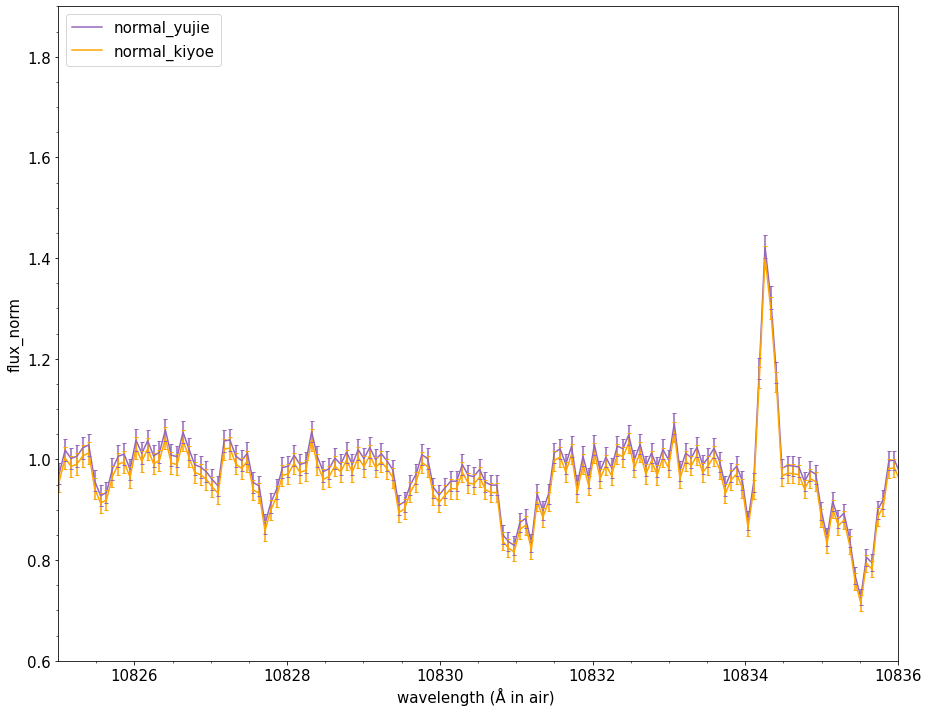

i= 4


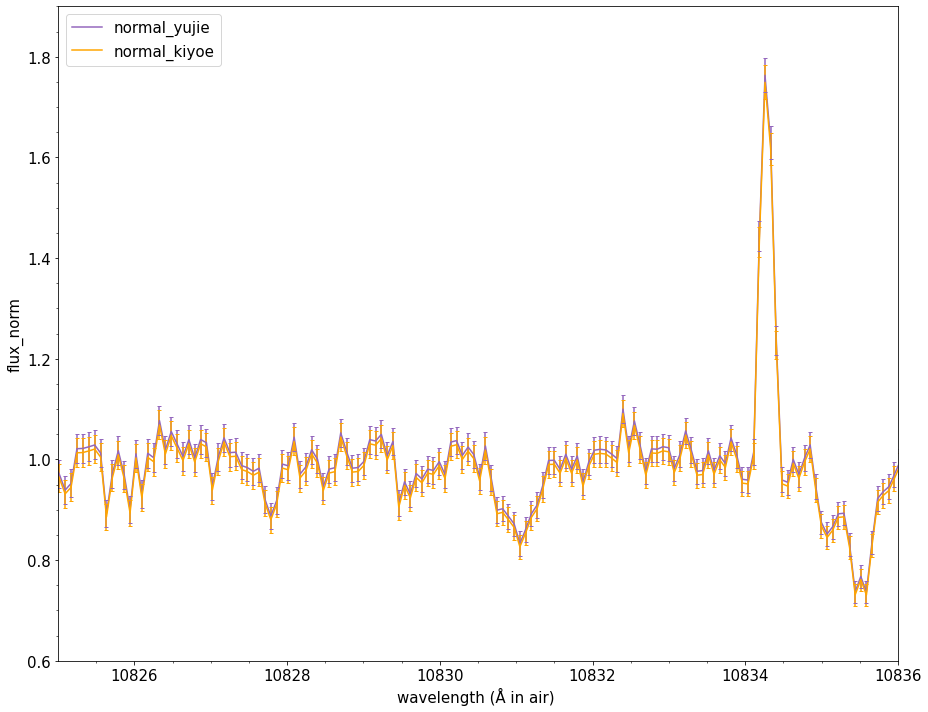

i= 5


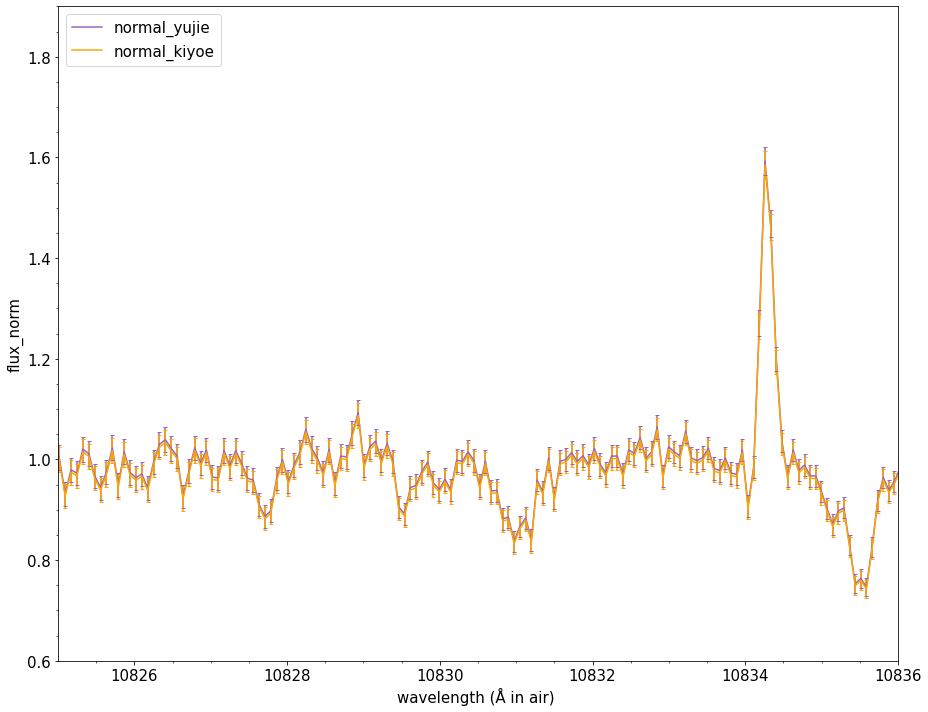

i= 6


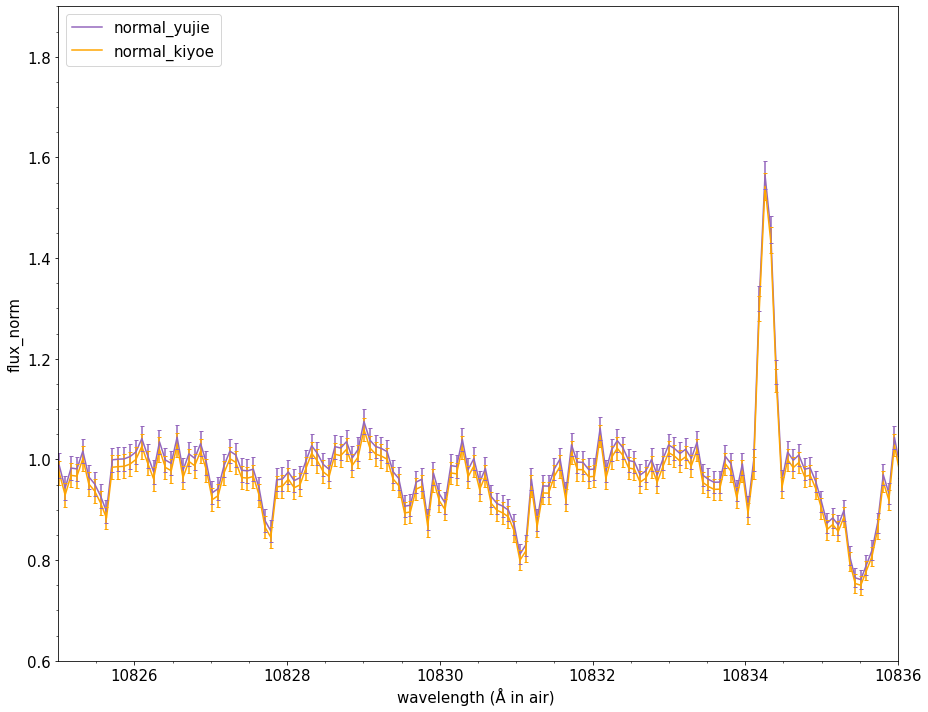

i= 7


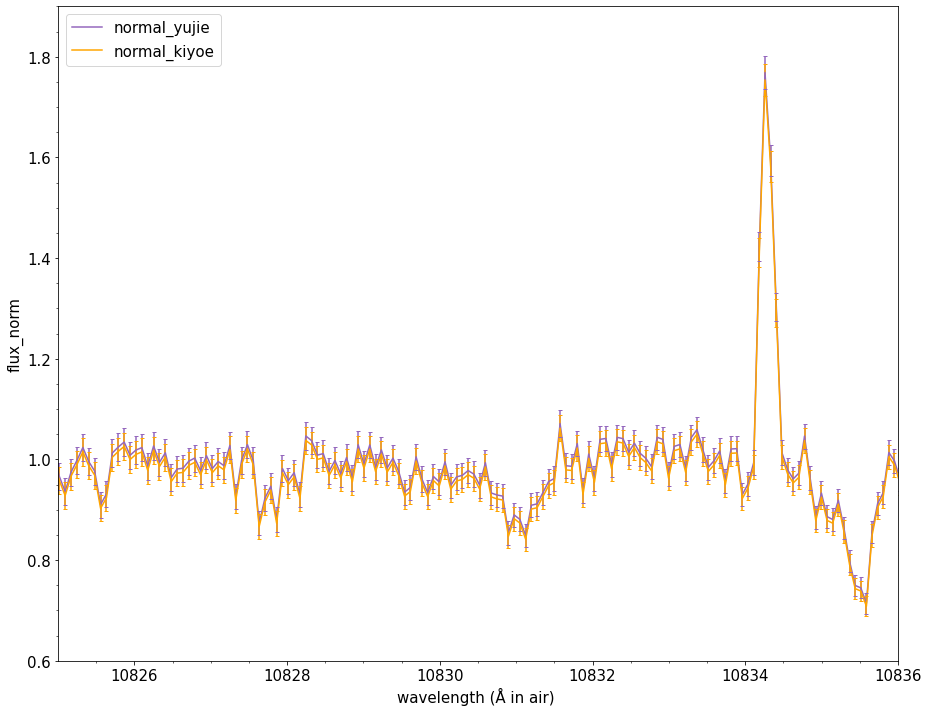

i= 8


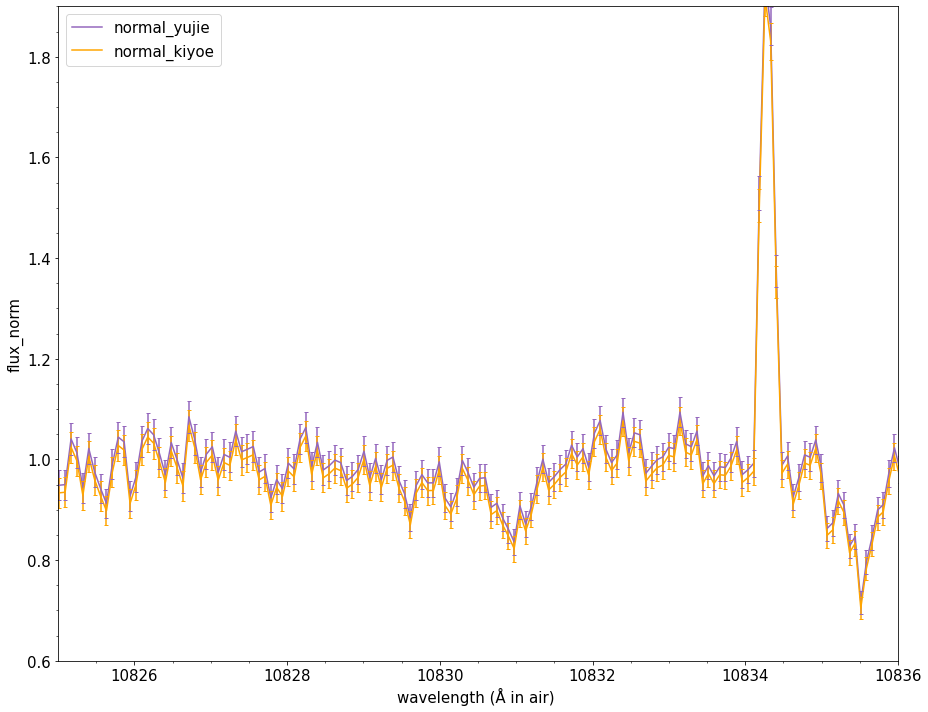

i= 9


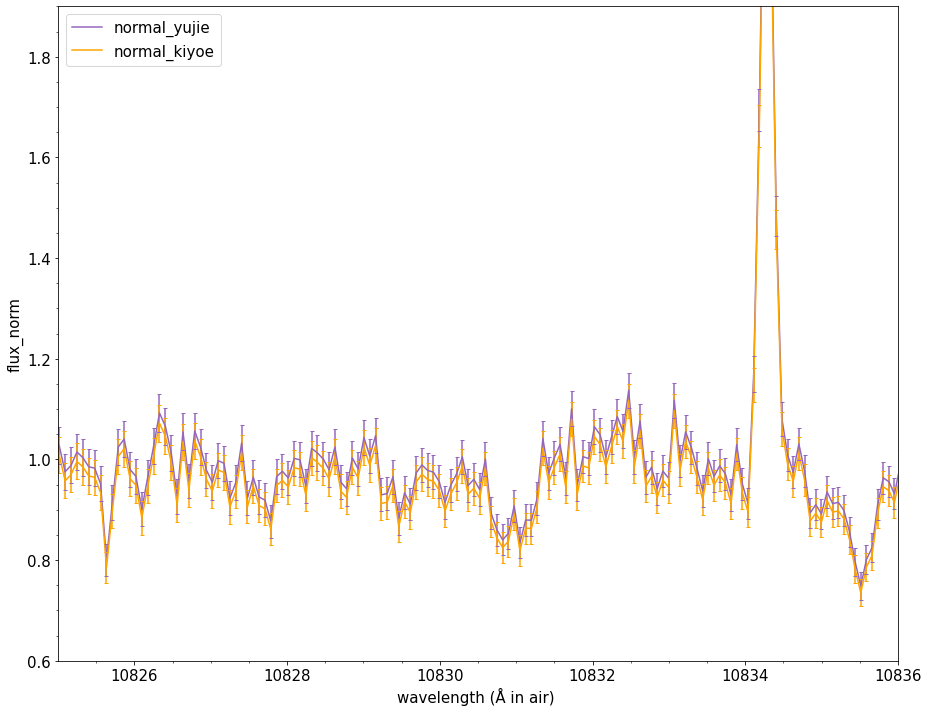

i= 10


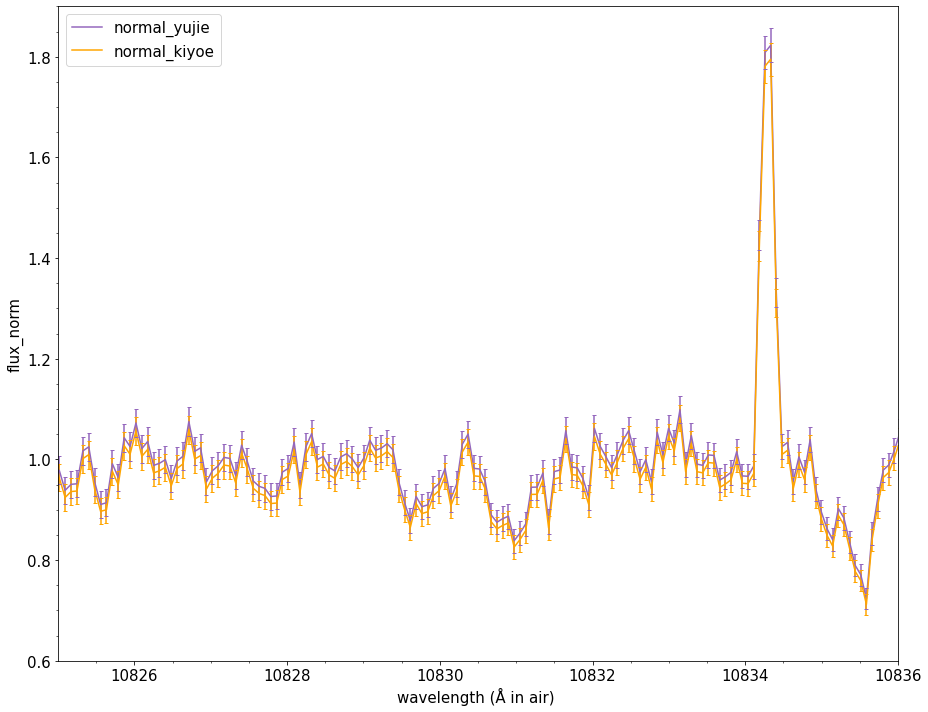

i= 11


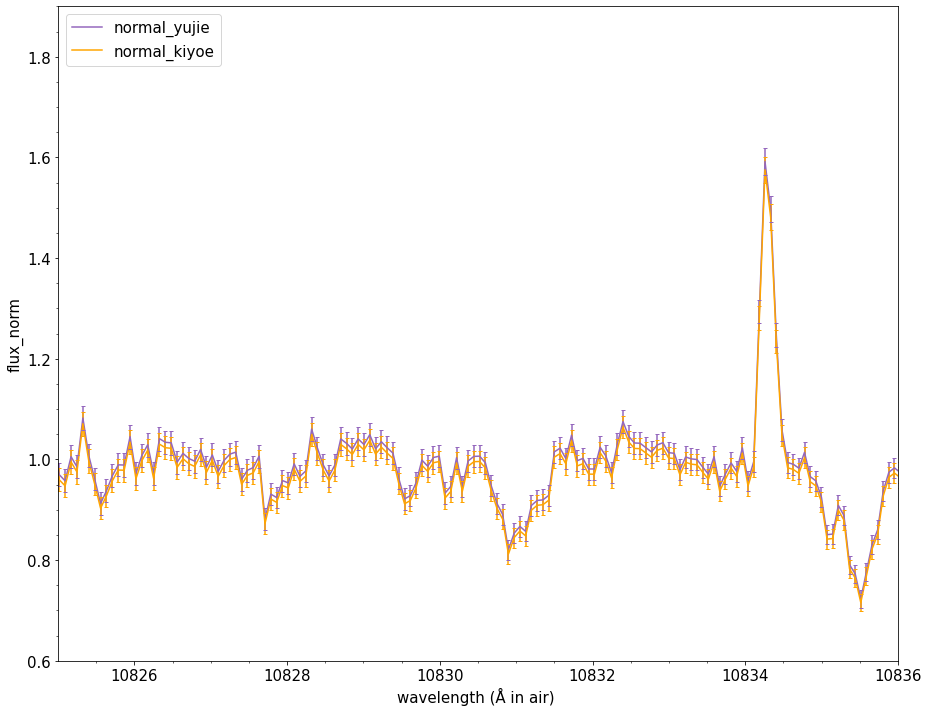

i= 12


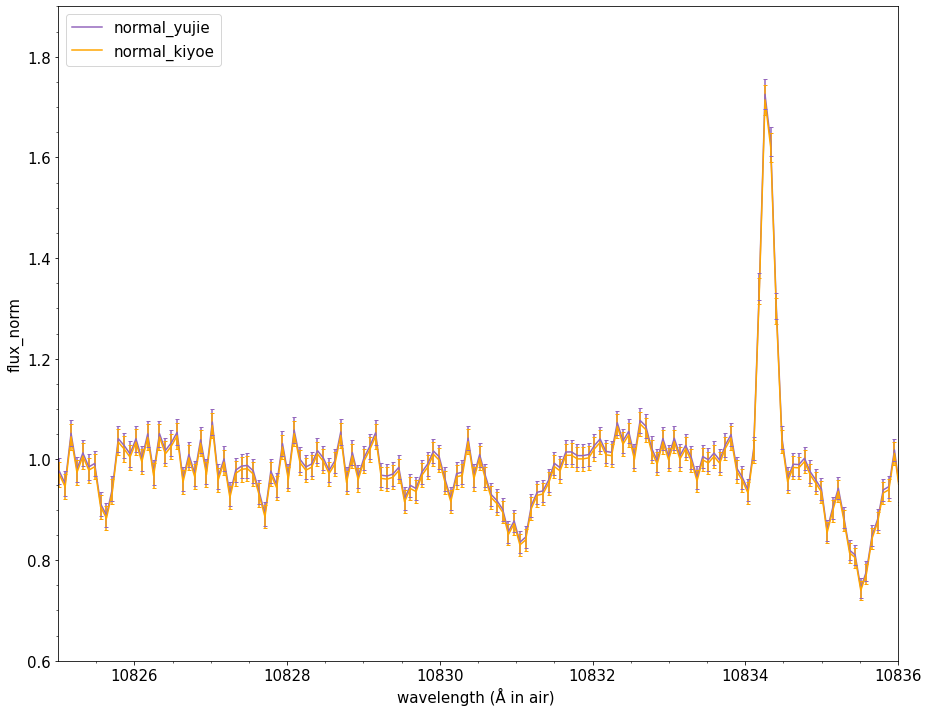

i= 13


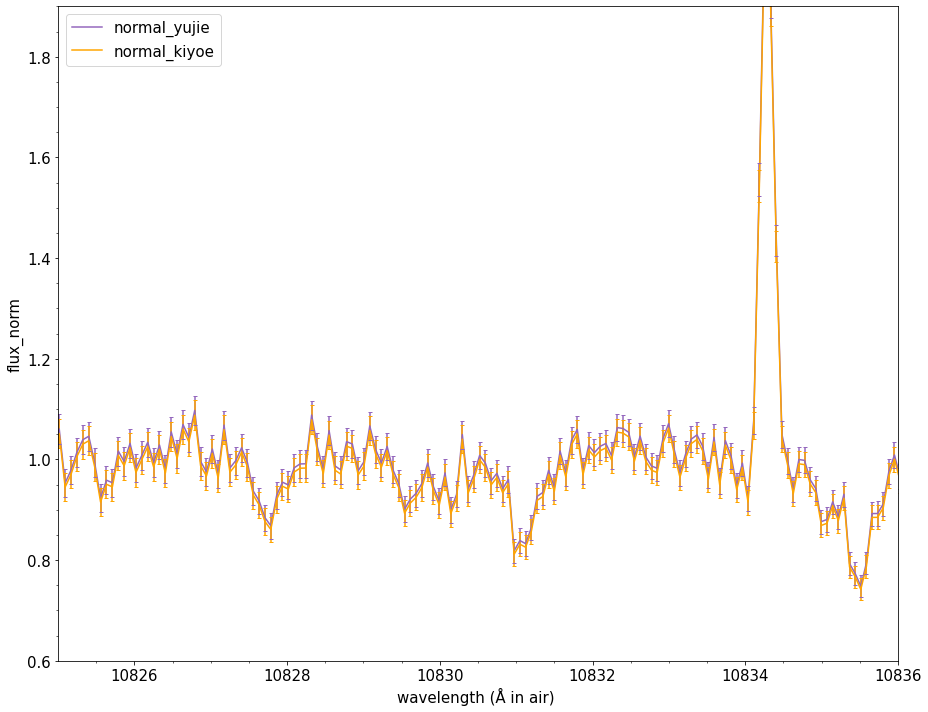

i= 14


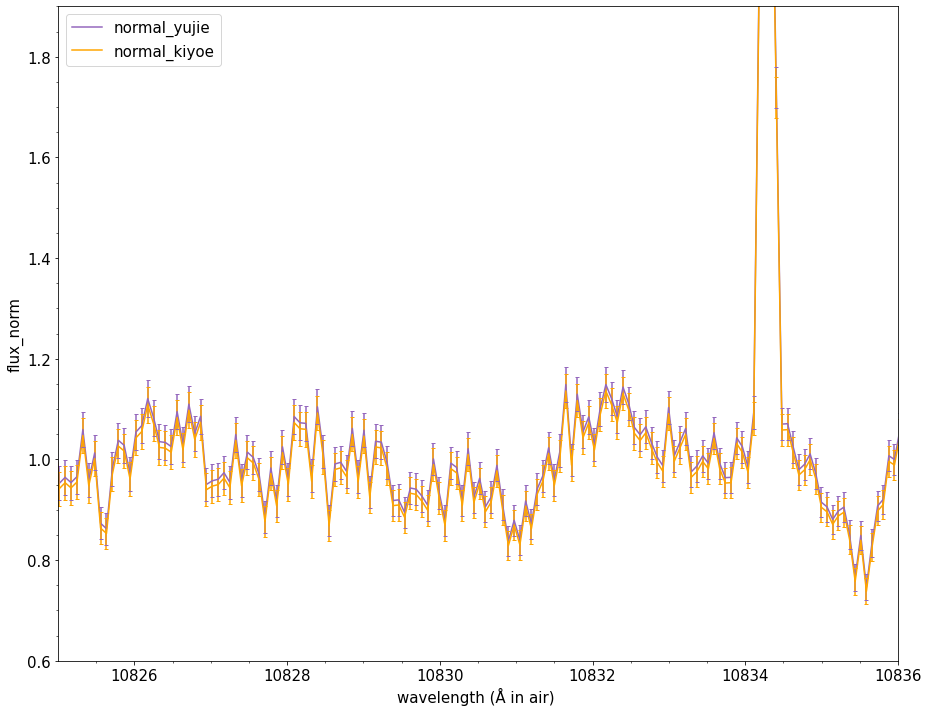

i= 15


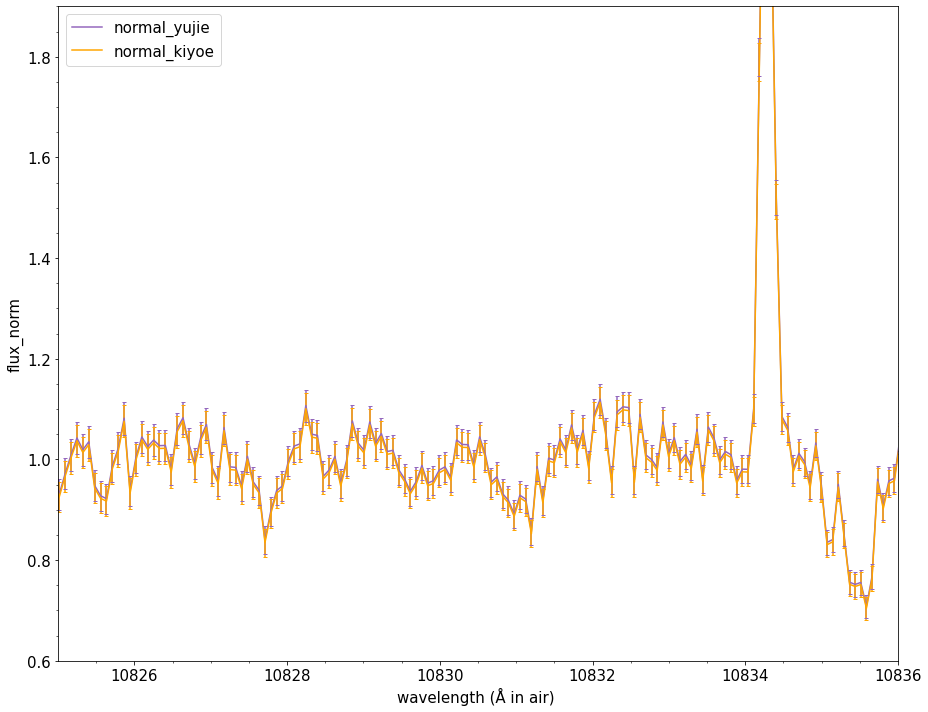

In [71]:

for i in range(16):
    #wavelength = np.genfromtxt("./TOI654/rawspec/He_raw_3.dat", usecols=0, unpack=True)
    #normal = np.loadtxt("./TOI654/normal/normal_err_e_ordering/normal_err_e_{0}.dat".format(i), usecols=0, unpack=True)
    #normal_err = np.loadtxt("./TOI654/normal/normal_err_e_ordering/normal_err_e_{0}.dat".format(i), usecols=1, unpack=True)

    #normal = np.loadtxt("./TOI654/normal/normal_err_e_o_{0}.dat".format(i), usecols=0, unpack=True)
    #normal_err = np.loadtxt("./TOI654/normal/normal_err_e_o_{0}.dat".format(i), usecols=1, unpack=True)
    
    normal = np.loadtxt("./TOI654/normal/normal_err_latest_{0}.dat".format(i), usecols=1, unpack=True)
    normal_err = np.loadtxt("./TOI654/normal/normal_err_latest_{0}.dat".format(i), usecols=2, unpack=True)

    #wavelength_kawauchi = np.loadtxt("./TOI654/normal_data/normal_data_rename/ss_smmf2_wc_Ccutne_{0}.dat".format(i), usecols=0, unpack=True)
    #normal_kawauchi = np.loadtxt("./TOI654/normal_data/normal_data_rename/ss_smmf2_wc_Ccutne_{0}.dat".format(i), usecols=1, unpack=True)
    #normal_err_kawauchi = np.loadtxt("./TOI654/normal_data/normal_data_rename/ss_smmf2_wc_Ccutne_{0}.dat".format(i), usecols=2, unpack=True)
    
    wavelength_kawauchi = np.loadtxt("./TOI654/normal_data/normal_data_latest/ss_smmf2_wc_Ccutne_{0}.dat".format(i), usecols=0, unpack=True)
    normal_kawauchi = np.loadtxt("./TOI654/normal_data/normal_data_latest/ss_smmf2_wc_Ccutne_{0}.dat".format(i), usecols=1, unpack=True)
    normal_err_kawauchi = np.loadtxt("./TOI654/normal_data/normal_data_latest/ss_smmf2_wc_Ccutne_{0}.dat".format(i), usecols=2, unpack=True)
    
    fig = plt.figure(figsize = (13, 10))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.plot( wavelength, normal,   markersize=1, color="tab:purple", label="normal_yujie" )
    ax1.plot( wavelength_kawauchi, normal_kawauchi,   markersize=1, color="orange", label="normal_kiyoe" )
    
    #ax1.plot( wavelength, normal_err,  marker='$x$', markersize=3, color="g", label="normal_err" )
    ax1.set_xlabel("wavelength (Å in air) ", size=15 )
    ax1.set_ylabel("flux_norm", size=15)
    #ax1.set_ylabel("Relative Flux")
    ax1.legend(loc="upper left", fontsize = 15)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(0.6, 1.5)
    ax1.set_ylim(0.6,1.9)
    ax1.set_xlim(10825,10836)
    plt.tick_params(labelsize=15)   #目盛りラベルのフォントサイズを設定する方法

    plt.errorbar(x=wavelength, y=normal, yerr=normal_err, capsize=2,  ls='none',   ecolor='tab:purple')
    plt.errorbar(x=wavelength_kawauchi, y=normal_kawauchi, yerr=normal_err_kawauchi,capsize=2,  ls='none',ecolor='orange')

    plt.minorticks_on()

    
    print("i=", i)
    #path = ""
    plt.savefig( "./TOI654/Figures/normal_compare_latest_{0}.png".format(i))
    plt.tight_layout()  # タイトルの被りを防ぐ
    plt.show()

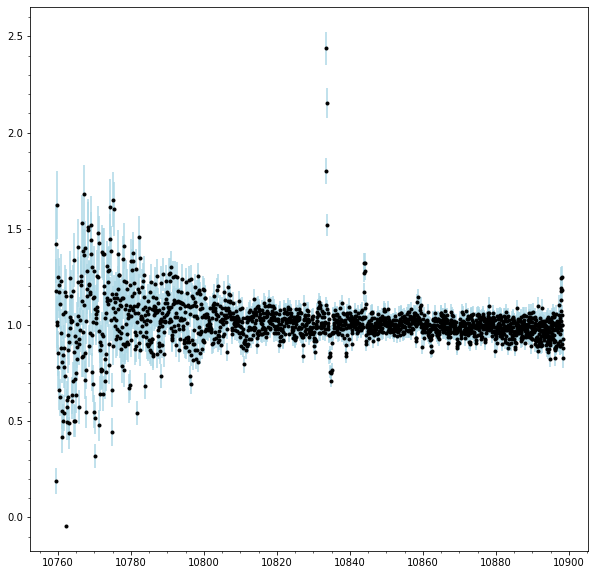

In [23]:
fig = plt.figure(figsize = (10,10))
#ax1 = fig.add_subplot(111)
plt.errorbar(x=LSD_wrv, y=normal, yerr=normal_err, marker='.', ls='none', color='k', ecolor='lightblue')
plt.minorticks_on()


一回中央値を掛け合わせて確認する

i= 0


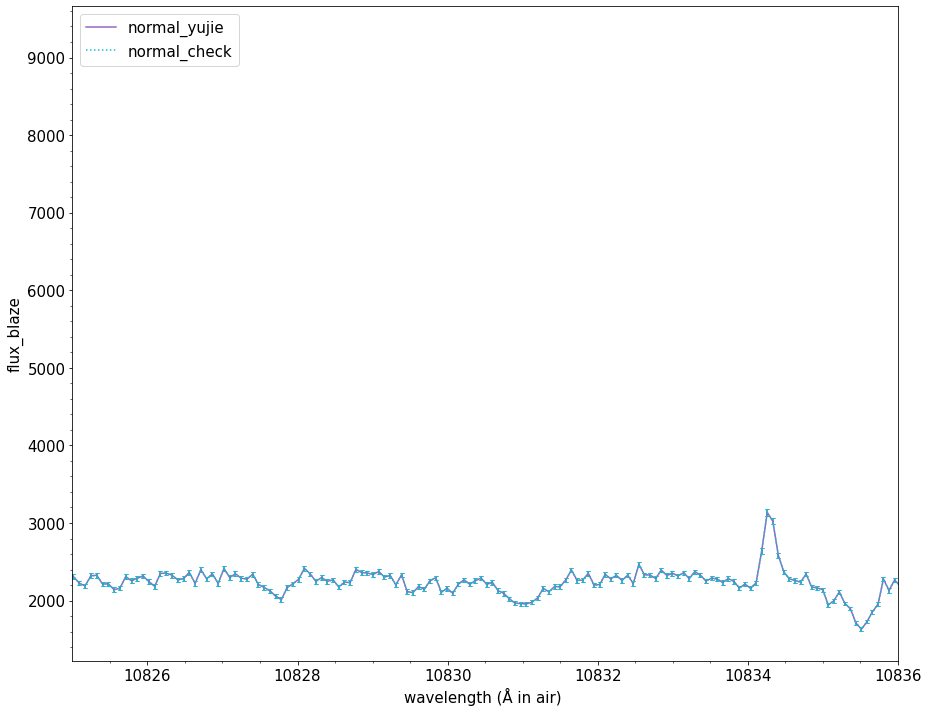

i= 1


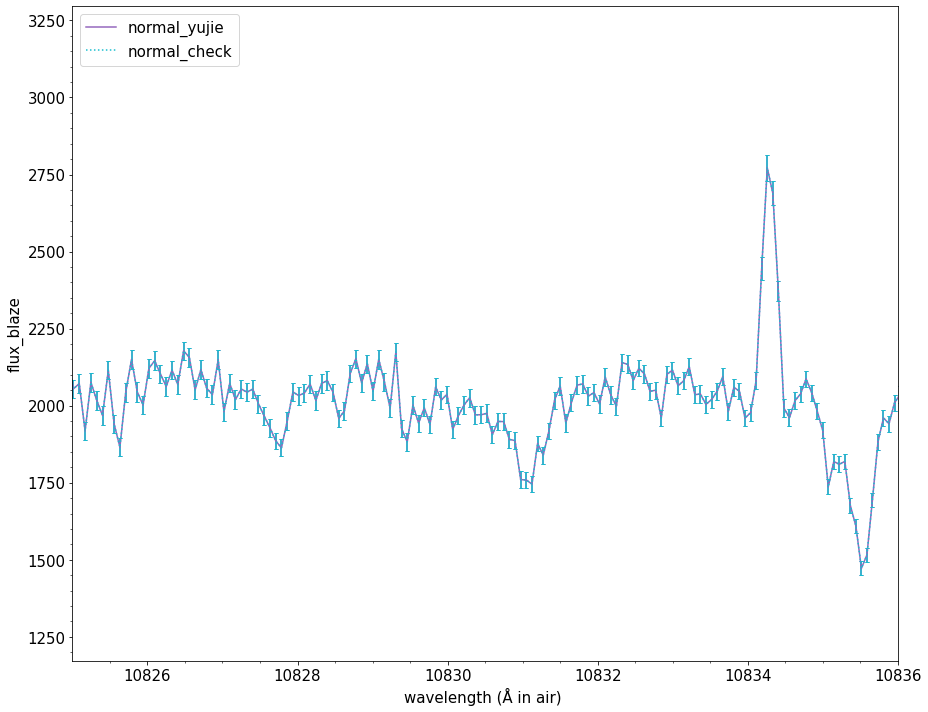

i= 2


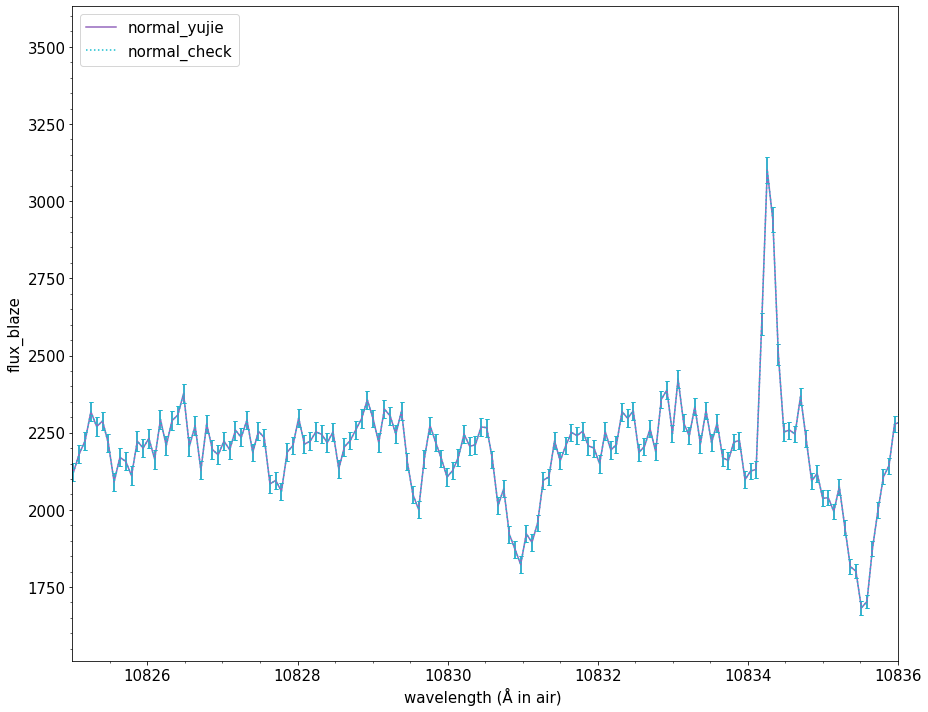

i= 3


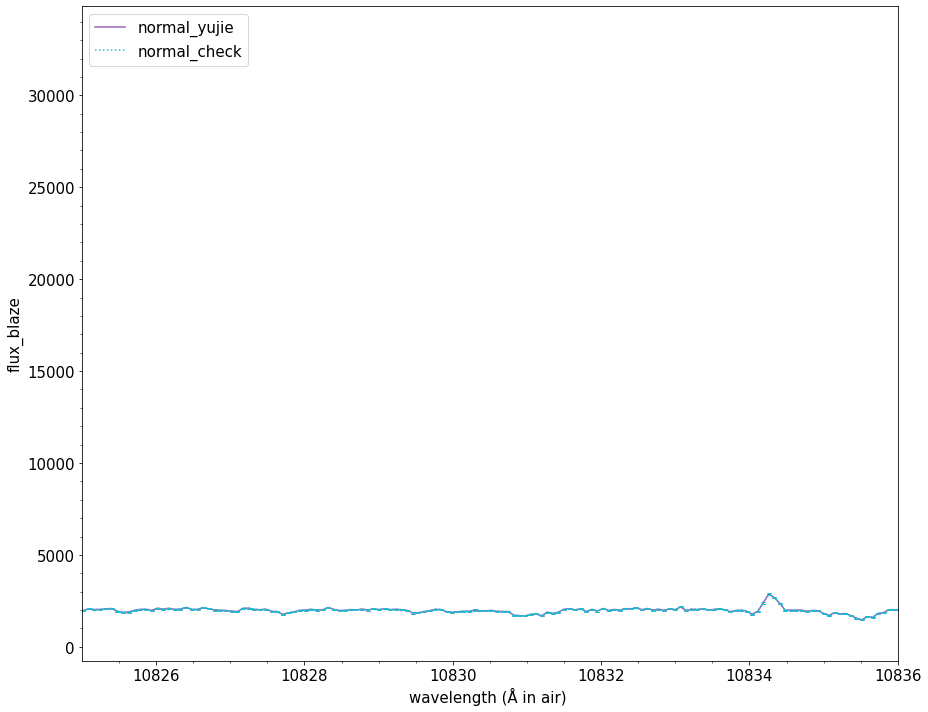

i= 4


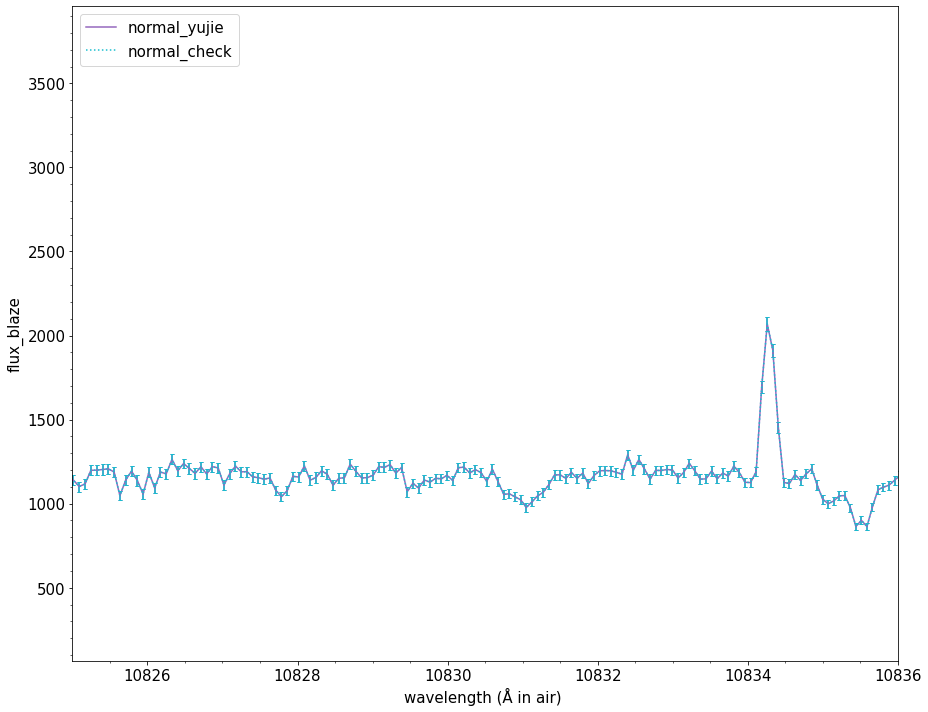

i= 5


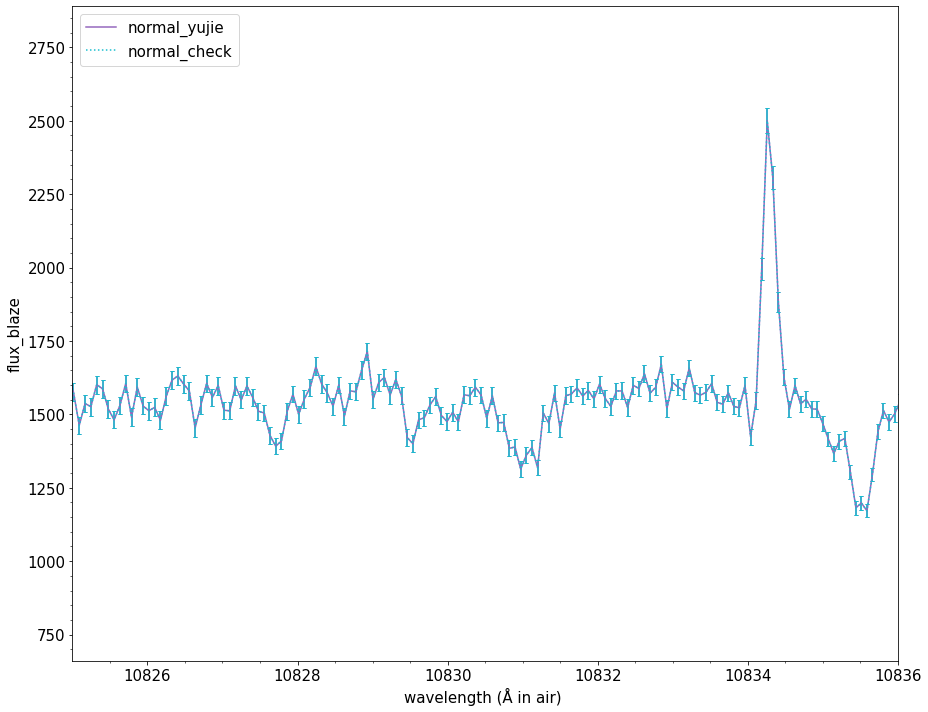

i= 6


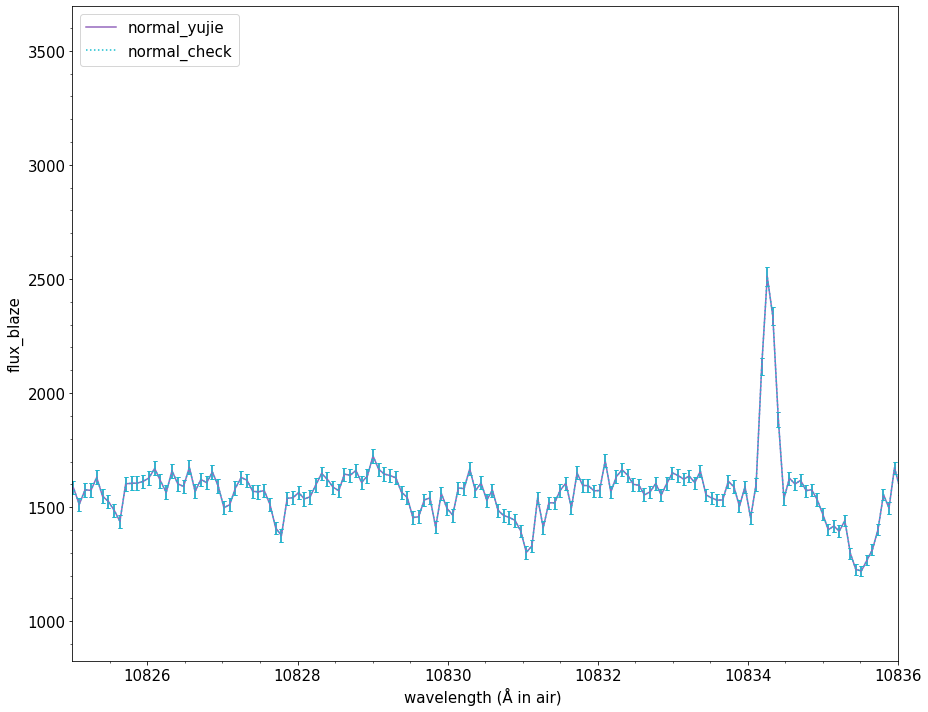

i= 7


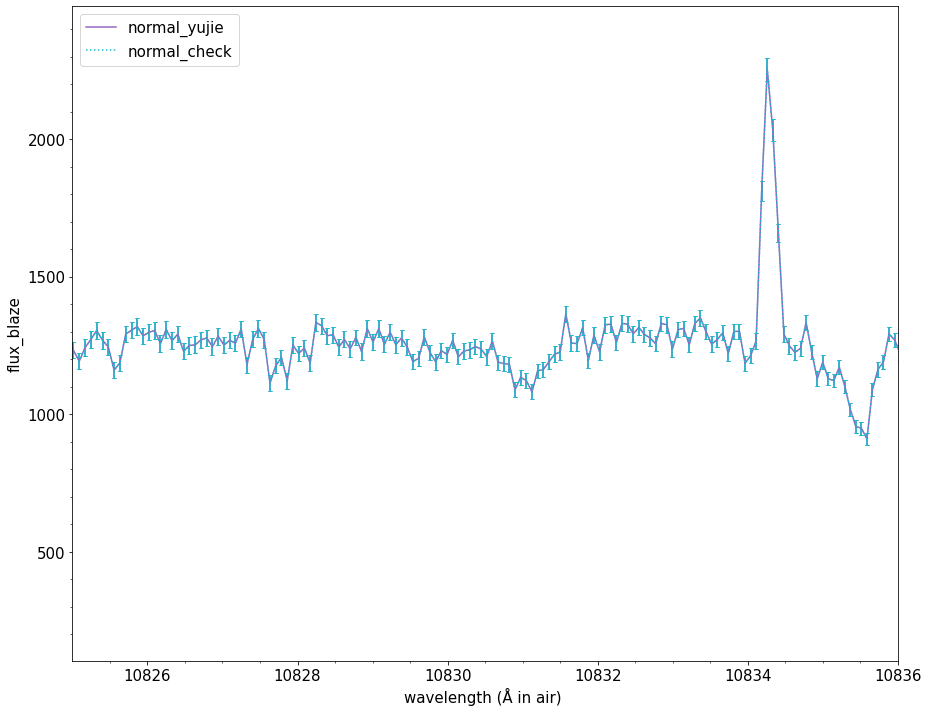

i= 8


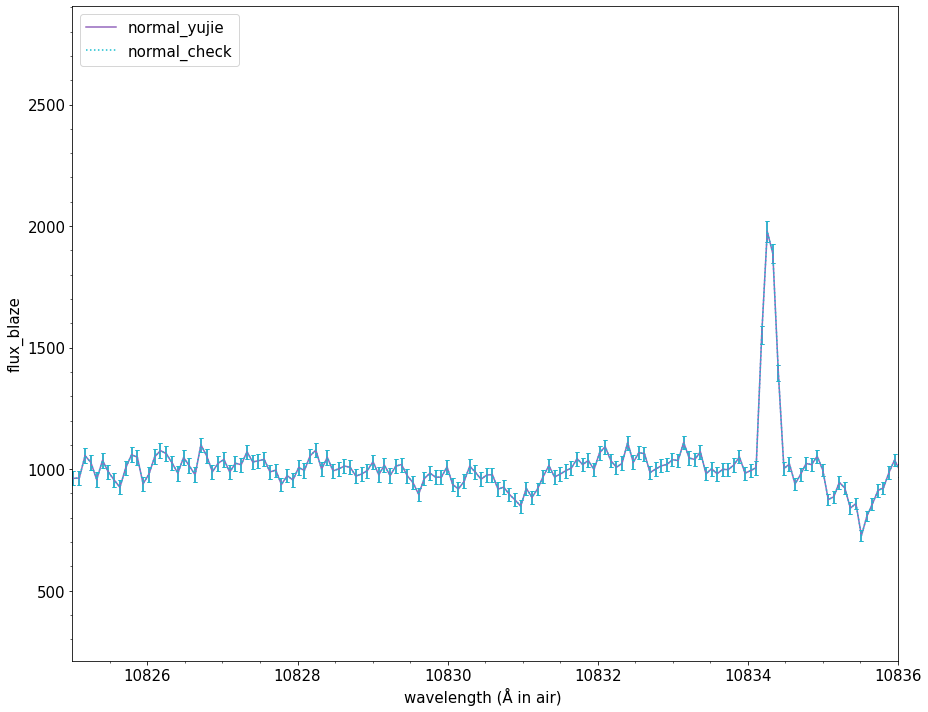

i= 9


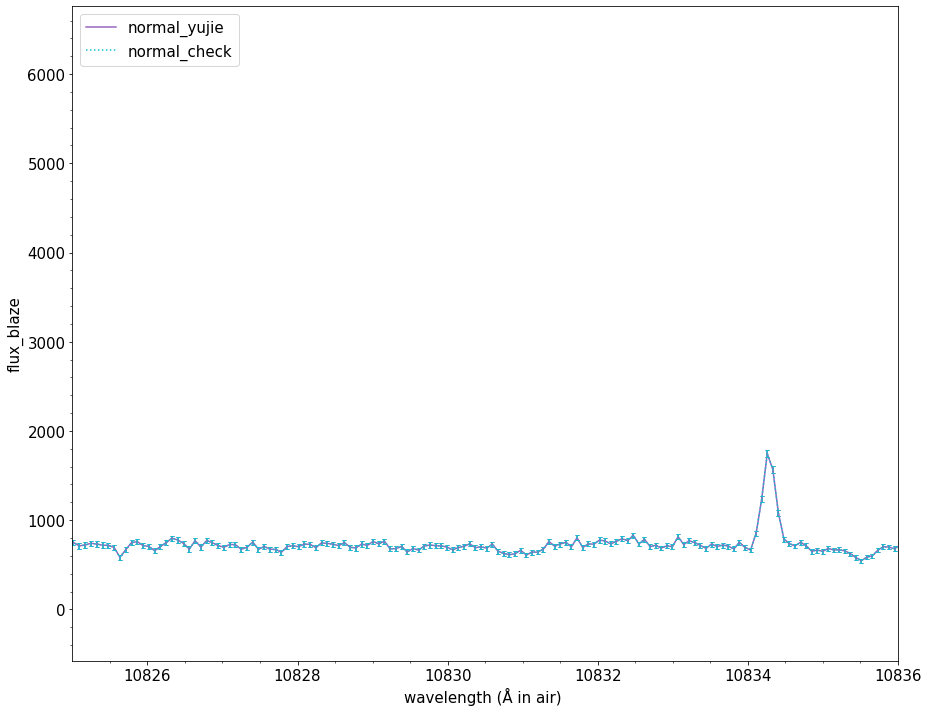

i= 10


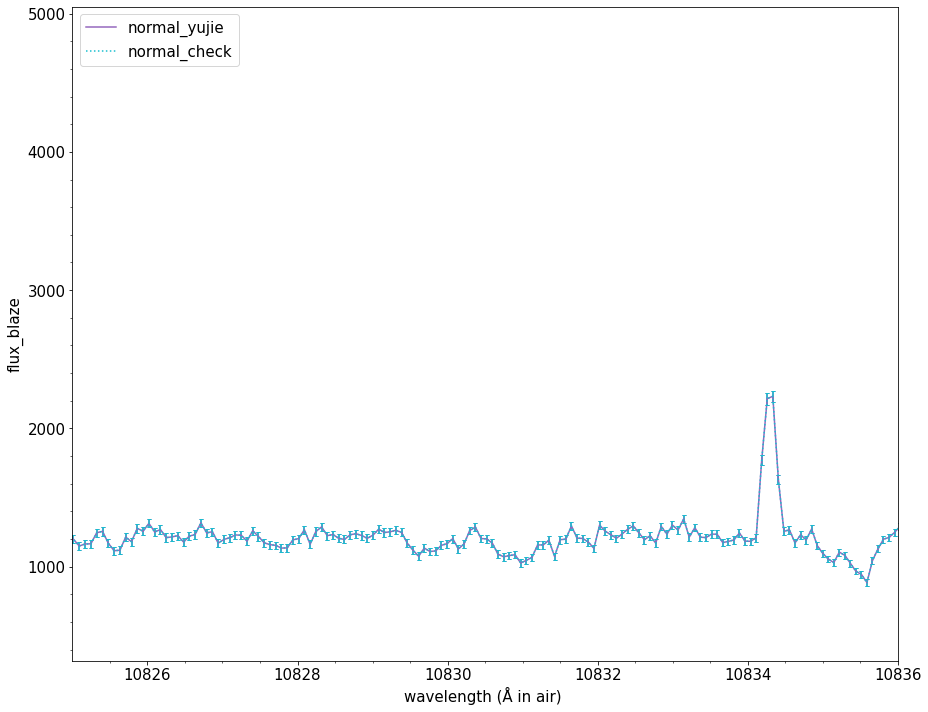

i= 11


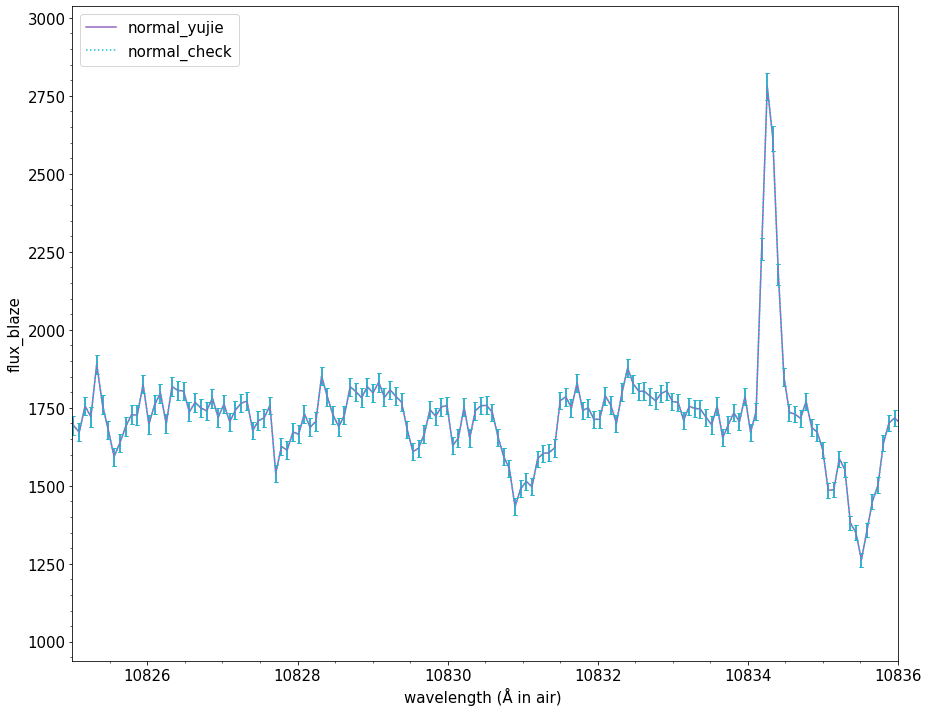

i= 12


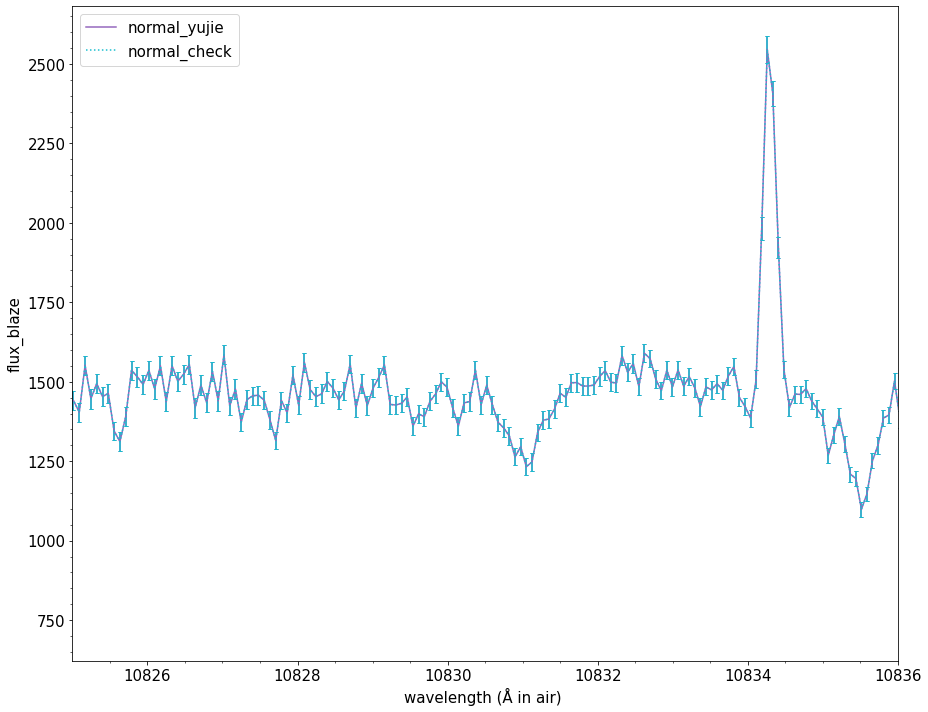

i= 13


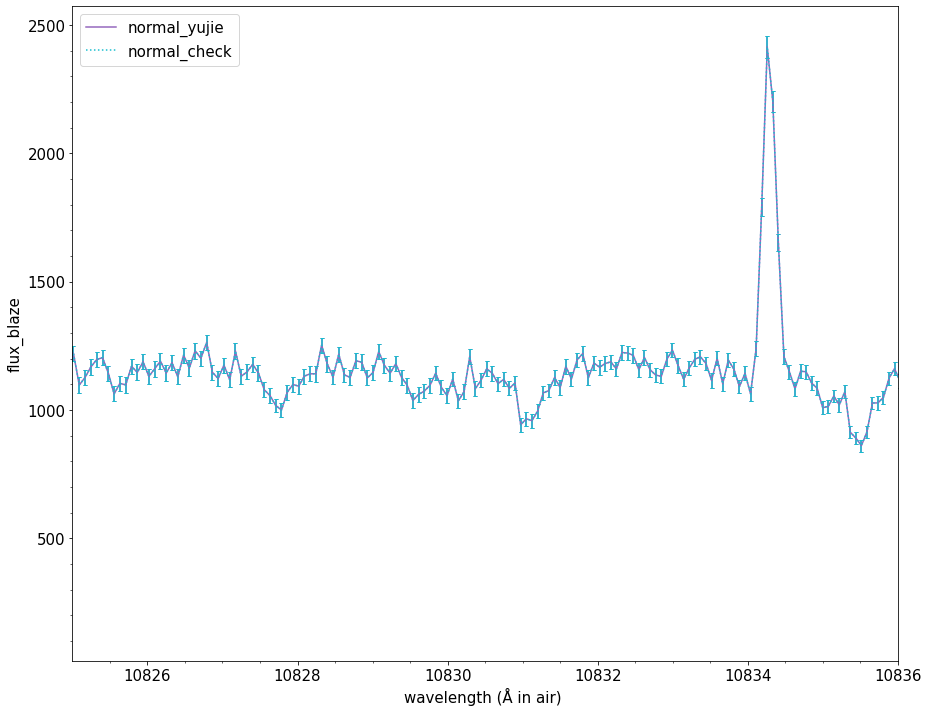

i= 14


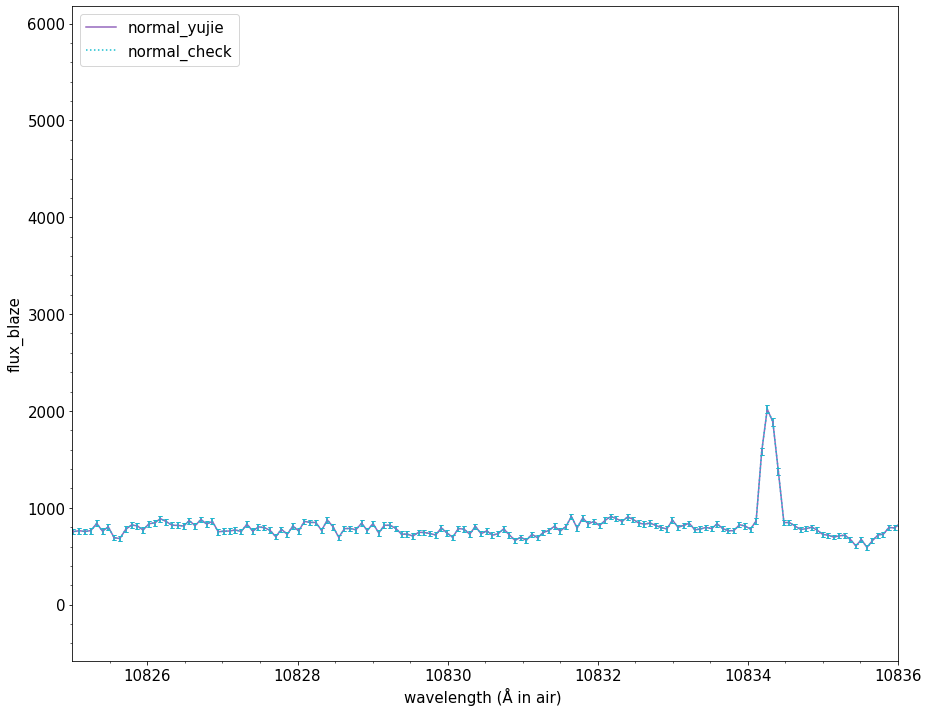

i= 15


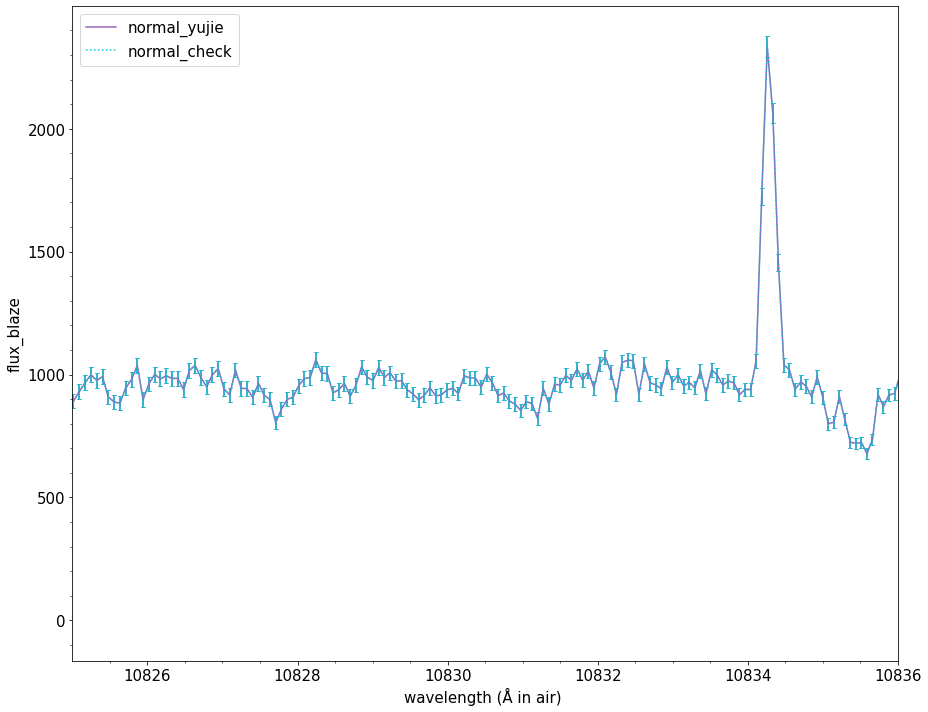

In [19]:
for i in range(16):
    #wavelength = np.genfromtxt("./TOI654/rawspec/He_raw_3.dat", usecols=0, unpack=True)
    normal = np.loadtxt("./TOI654/normal/normal_err_e_o_{0}.dat".format(i), usecols=0, unpack=True)
    #normal_err = np.loadtxt("./TOI654/normal/normal_err_e_ordering/normal_err_e_{0}.dat".format(i), usecols=1, unpack=True)
    He_blaze = np.loadtxt("./TOI654/rawspec/He_blaze_nan_e_ordering_manual/He_blaze_nan_e_{0}.dat".format(i), usecols=2) #raw[2]
    
    
    median = statistics.median(He_blaze)
    
    He_blaze_check = normal * median
    
    
    
    
    #outputfile = './TOI654/rawspec/He_blaze_check_{0}.dat'.format(i) 
    
    #d = np.column_stack((normal , normal_err))     #np.savetxt 複数配列の保存方法
    
    #np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    #np.savetxt("./TOI654/normal/normal_err_{0}.dat".format(i), normal_err) #フォルダーを先に作っとかないといけないの?!


    fig = plt.figure(figsize = (13, 10))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.plot( wavelength, He_blaze,   markersize=1, color="tab:purple", label="normal_yujie" )
    ax1.plot( wavelength, He_blaze_check, ls= 'dotted', markersize=1, color="tab:cyan", label="normal_check" )
    #ax1.plot( wavelength_kawauchi, normal_kawauchi,   markersize=1, color="orange", label="normal_kiyoe" )
    
    #ax1.plot( wavelength, normal_err,  marker='$x$', markersize=3, color="g", label="normal_err" )
    ax1.set_xlabel("wavelength (Å in air) ", size=15 )
    ax1.set_ylabel("flux_blaze", size=15)
    #ax1.set_ylabel("Relative Flux")
    ax1.legend(loc="upper left", fontsize = 15)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(0.6, 1.5)
    #ax1.set_ylim(0.6,1.9)
    ax1.set_xlim(10825,10836)
    plt.tick_params(labelsize=15)   #目盛りラベルのフォントサイズを設定する方法

    plt.errorbar(x=wavelength, y=He_blaze, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:purple')
    plt.errorbar(x=wavelength, y=He_blaze_check, yerr=He_blaze_err, capsize=2,  ls='none',   ecolor='tab:cyan')
    #plt.errorbar(x=wavelength_kawauchi, y=normal_kawauchi, yerr=normal_err_kawauchi,capsize=2,  ls='none',ecolor='orange')

    plt.minorticks_on()

    
    print("i=", i)
    #path = ""
    #plt.savefig( "./TOI654/Figures/He_blaze_plot_{0}.png".format(i))
    plt.tight_layout()  # タイトルの被りを防ぐ
    plt.show()
    
    
    

## 2.Heliocentric velocity 補正

### obsinfo_all.txt から 時刻情報を読み取り新しいファイルに整理＿

NumPyのデータ型dtypeの重要性。連番はいらないよ。

In [ ]:
obs = np.genfromtxt('./TOI654/obsinfo_all.txt', delimiter=',' ,usecols=4, dtype='unicode')

In [ ]:
obs

In [ ]:
obs = np.loadtxt("./TOI654/obsinfo_all.txt", dtype=np.unicode_, delimiter=',' ,usecols=3)

In [ ]:
obs

In [ ]:
print(type(obs))
print(obs.ndim)
print(np.shape(obs))
#行になっている..

In [ ]:
#obs_T = np.transpose(obs)
obs_T = obs.T

In [ ]:
np.shape(obs_T)
#一次元配列に対してTやtranspose()を適用しても、元の配列と等価な配列が返されるのみ。!!!

In [ ]:
#obs_T = obs.T
#np.shape(obs_T)
obs_row = obs.reshape(-1,1)
print(obs_row.shape)
print(obs.ndim)

In [ ]:
obs_row

In [ ]:
print(obs_row.shape)

print(len(obs_row))

len(obs_row[0])

In [ ]:
#ちゃんと中心時刻を求めようと。

obs = np.genfromtxt('./TOI654/obsinfo_all.txt', delimiter=',' ,usecols=(1,3), dtype='unicode')

print(len(obs))
print(obs)


In [ ]:
obs[0]

datetimeの書式弄りと、文字列の理解訓練!

In [ ]:
import numpy as np
import datetime

daystr = '2021-1-28'
tdatetime = datetime.datetime.strptime(daystr, '%Y-%m-%d')
tdate = datetime.date(tdatetime.year, tdatetime.month, tdatetime.day)

'''
print("[オブジェクトの型] ",type(daystr))
print("[配列の形状] ",daystr.shape)
print("[配列の次元] ",daystr.ndim)
print("[全要素数] ",daystr.size)
print("[要素の型] ",daystr.dtype)

'''

In [ ]:
timestr = '01:59:10.201'
tdatetime = datetime.datetime.strptime(timestr, '%H:%M:%S.%f')

In [ ]:
tdatetime

In [ ]:
obs_mid0 = tdatetime + datetime.timedelta(seconds=300)
print(obs_mid0)

文字列の理解

In [ ]:
tstr = np.genfromtxt('./TOI654/obsinfo_all.txt', delimiter=',' , usecols=3, dtype='str')
timestr = tstr[0]

print(timestr)
type(timestr)
print("[tstrオブジェクトの型] ",type(tstr))
print("[tstr配列の次元] ",tstr.ndim)
print("[tstr配列の形状] ",tstr.shape)
print("[timestrオブジェクトの型] ",type(timestr))
print("[timestr配列の形状] ",timestr.shape)
print("[timestr配列の次元] ",timestr.ndim)
print("[timestr全要素数] ",timestr.size)
print("[timestr要素の型] ",timestr.dtype)

In [ ]:
#timestrが数値(unicode)になっていて、本当の文字列になっていない。
#変更しちゃう!
#初心者によくある誤解 --- **変数**と**文字列**の混乱も

timestr_str = str(timestr)


参考:https://colab.research.google.com/drive/1rAhmC78GGKA8SA9W6T-uTHx_Vn5ZUMlE#scrollTo=DvK76OW6vSXM

In [ ]:
timestr_str

In [ ]:
#obsinfo_all.txtから読み込んだもの、さらにstr化にしてから、前後にスペースが出てきたので、' %H:%M:%S.%f 'にする.

tdatetime = datetime.datetime.strptime(timestr_str, ' %H:%M:%S.%f ')

In [ ]:
#空白スペースがなければこのままに。

timestr_test = '01:59:10.201'
tdatetime = datetime.datetime.strptime(timestr_test, '%H:%M:%S.%f')
print(tdatetime)

In [ ]:
timestr_test


In [ ]:
timestr = np.atleast_1d(timestr)
timestr.ndim

In [ ]:
tstr = np.genfromtxt('./TOI654/obsinfo_all.txt', delimiter=',' , usecols=3, dtype='str')
np.savetxt('./timelist.dat', tstr, fmt ='% s')

In [ ]:
len(tstr)

In [ ]:
#withブロックを使うとブロックの終了時に自動的にクローズされる。閉じ忘れがなくなるので便利。

#一行ずつ読めているけどうまく操作できていない
with open('./timelist.dat') as f: 
    for timestr in f:
        
        timestr = str(timestr)
        #print(type(timestr))
        daystr = '2021-1-28'
        tdatetime = datetime.datetime.strptime(daystr, '%Y-%m-%d')
        tdatetime = datetime.datetime.strptime(timestr, ' %H:%M:%S.%f ')
        
        obs_mid = tdatetime + datetime.timedelta(seconds=300)

        #print('tdatetime=',len(tdatetime))
        #print('obs_mid type: ', type(obs_mid))
        print('obs_mid=', obs_mid)
        obs_mid = str(obs_mid)
        obs_mid = np.atleast_1d(obs_mid)
        #print(obs_mid.ndim)
        
        #np.savetxt('./obs_rv654_tmid0.dat', obs_mid,  fmt ='% s')
        ########ここまでは作動しているんじゃん!#########
        
        #obs_mid = np.atleast_1d(obs_mid)
        #print(obs_mid.ndim)
        #f.write(obs_mid) 
        #f.write("\n")
        #f.write(obs_mid[1][0]) 
        #f.write("\n")
    
    

In [136]:
timelist = np.loadtxt("./timelist.dat",  unpack=True) 
timelist

ValueError: could not convert string to float: '01:59:10.201'

In [ ]:
timelist_new_selected = timelist[1, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]

In [ ]:
"""
f=open("./timelist.dat",'w')
for k in range(len(tstr)):
    #f.write('2021 1 28')#year
    f.write(str(obs_row[k][0])) #上の日付の次の列に
    f.write("\t")
    f.write("\n")
f.close()
"""

In [ ]:
#typeの問題?
#ValueError: time data ' 01:59:10.201 ' does not match format '%H:%M:%S.%f'
'''

#このループは一行ずつ読み込んでいるわけではない:
for i in range(len(tstr)):   
    
    tstr = np.genfromtxt('./TOI654/obsinfo_all.txt', delimiter=',' , usecols=3, dtype='str')
    
    timestr = tstr[0].format(i)
    tdatetime = datetime.datetime.strptime(timestr, ' %H:%M:%S.%f ')
    
    obs_mid = tdatetime + datetime.timedelta(seconds=300)

    #print('tdatetime=',len(tdatetime))
        
    print('obs_mid=', obs_mid)
    
    
    obs_mid = np.atleast_1d(obs_mid)
    print(obs_mid.ndim)
    
    np.savetxt('./obs_mid.dat', obs_mid, fmt ='% s')
    
    '''

### 中心時刻の作り方:
開始時刻に露光時間の半分を足せば良いと思うよ。



datetimeの説明分かりづらいので、とにかく時刻を取り出せたから、ここでYY MM DD などを書き出せばいいや。

In [ ]:
len(obs_mid)

#何で????

In [ ]:
#obs_midlist = np.genfromtxt('./obs_rv654_tmid**.dat', usecols=0, dtype='str')    #dtypeに注意!

#この過程で時刻ファイルは毎回上書きされちゃうので工夫しておいて!

obs_midlist = np.genfromtxt('./obs_rv654_tmid***.dat', usecols=0, dtype=np.unicode_)
print(obs_midlist)
#np.savetxt('./timelist.dat', tstr, fmt ='% s')

In [ ]:
obs_midlist[2]

In [ ]:
import datetime
import pandas as pd


#文字列(numpy string) を日付datetime64[ns]型（Timestamp型）に変換: to_datetime()
obs_midlist = pd.to_datetime(obs_midlist)
print(obs_midlist)
obs_midlist = obs_midlist.to_numpy
print(obs_midlist)

In [ ]:
obs_midlist[2]

In [ ]:
np.shape(obs_midlist)

In [ ]:
obs_midlist_T = obs_midlist.T
print(np.shape(obs_midlist_T))
obs_midlist = obs_midlist.reshape(-1,1)  #31, 0 ではなく 31*1行列にしたのね!
print(obs_midlist.shape)
print(obs_midlist.ndim)

In [ ]:
print(obs_midlist)

In [ ]:
print(obs_mid)

いよいよ、irafのVHELIOを出すための書式を書き足すことに。

In [ ]:
#data:2021-01-28

#obs_midlistが一行の時


#f=open("obs_rv654.dat",'w')
f=open("obs_rv654_tmid***.dat",'w')
for k in range(len(obs_midlist)):
    f.write('2021 1 28')#year
    f.write(" ")
    #f.write(str(obs_midlist[k][0]))
    f.write(str(obs_midlist[k])) #obs_midlistは一行しかないので[0]はいらない。
    f.write(" ")
    f.write("10:58:53.89")###
    f.write(" ")
    #ここでf.write("\t")にすると変な空白になる。
    f.write("-05:32:51.16")###
    f.write("\n")
f.close()

In [ ]:
#data:2021-01-28

#obs_midlistが一列の時


#f=open("obs_rv654.dat",'w')
f=open("obs_rv654_tmid***.dat",'w')
for k in range(len(obs_midlist)):
    f.write('2021 1 28')#year  #スペース入れているぞ!
    f.write("\t")
    f.write(str(obs_midlist[k][0]))
    #f.write(str(obs_midlist[k])) #obs_midlistは一行しかないので[0]はいらない。
    f.write("\t")
    f.write("10:58:53.89")###
    f.write("\t")
    #ここでf.write("\t")にすると変な空白になる。
    f.write("-05:32:51.16")###
    f.write("\n")
f.close()


#rvcor_654 は、露光終了時間時刻でVHELIOを計算
#rvcor_654_newは中心時刻.


ファイル名に"***"   がついていると、ファイル形式が変になって、
rvcorやるときはこうなる:
ERROR: illegal operation on string 'Warning: Incomplete or reentrant printf
(Old format = "<>%0.20s")
(New format = "%s")
ERROR: segmentation violation


ndarrayの行と列を入れ替え参照: https://note.nkmk.me/python-numpy-transpose/

<img src="rvcor_new.png" width="500">


### RV補正を行う。書き出し


In [64]:
rvlist = np.loadtxt("./rvcor_654_new_selected", comments='#' , usecols = 2, unpack=True)  ##VHELIOの列を読み込む
#rvlist = np.loadtxt("./rvcor_654_new_16", comments='#' , usecols = 2, unpack=True)  ##VHELIOの列を読み込む
#使うデータだけが入っているtvlist
rvlist
#wavelength = np.genfromtxt("./TOI654/rawspec/He_raw_1.dat", usecols=0, unpack=True)

array([19.25, 19.27, 19.29, 19.3 , 19.32, 19.33, 19.34, 19.36, 19.37,
       19.38, 19.4 , 19.41, 19.43, 19.44, 19.44, 19.45])

<img src="rvcor_new_selected.png" width="500">


In [65]:
#そうです。偶数番目がYJ bandで、奇数番目がH bandです。YJband使えないので、
# 値が入っているやつをやろう!

i=0

for rv in rvlist:   #telluriclistは配列が違う. telluricfluxとは違う.
    #wavelength = np.genfromtxt("./TOI654/rawspec/He_raw_ordering/He_rawYJband_{0}.dat".format(i), usecols=0, unpack=True) * 10
    # * 10 でÅにする!
    #wavelength = np.genfromtxt("./TOI654/normal/normal_err_e_{0}.dat".format(i), usecols=0, unpack=True)
    wavelength0 = np.loadtxt("./TOI654/normal/normal_err_latest_{0}.dat".format(i), usecols=0, unpack=True)
    
    
    flux_norm = np.loadtxt("./TOI654/normal/normal_err_latest_{0}.dat".format(i), usecols=1, unpack=True)
    flux_norm_err = np.loadtxt("./TOI654/normal/normal_err_latest_{0}.dat".format(i), usecols=2, unpack=True)
    
    #flux_norm = np.loadtxt("./TOI654/normal/normal_err_e_ordering/normal_err_e_{0}.dat".format(i), usecols=0, unpack=True)
    #usecolsはなし!
    
    # 赤側にずらすべき!
    
    rv = - rv
    
    print("i=", i)
    wrv = wavelength0 / ( (1 + ( (rv * 10**3) / (3 * 10**8))) / (1 - ((rv * 10**3) / (3 * 10**8))) ) ** 0.5
    print('wavelength0=', wavelength0)
    print('wrv654=', wrv)
    print('flux_norm=', flux_norm)
    
    print('Δλ = ', wrv - wavelength0)

    outputfile = './TOI654/wrv654/wrv654_latest_red_{0}.dat'.format(i)
    d = np.column_stack((wrv,flux_norm))     #np.savetxt 複数配列の保存方法
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    
    d =  np.column_stack((d,flux_norm_err)) 
    
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
    i+=1
    #j+=1

i= 0
wavelength0= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
wrv654= [10760.73396922 10760.83117535 10760.92835671 ... 10899.6488582
 10899.69011485 10899.73134207]
flux_norm= [1.13810211 0.93701972 1.1147756  ... 0.94493533 1.10856865 1.05420029]
Δλ =  [0.69045828 0.69046452 0.69047075 ... 0.6993717  0.69937434 0.69937699]
i= 1
wavelength0= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
wrv654= [10760.7346866  10760.83189274 10760.9290741  ... 10899.64958484
 10899.6908415  10899.73206871]
flux_norm= [1.46376985 1.05128384 1.3167109  ... 1.05078503 0.99454044 0.98672905]
Δλ =  [0.69117566 0.6911819  0.69118815 ... 0.70009834 0.70010099 0.70010364]
i= 2
wavelength0= [10760.04351094 10760.14071083 10760.23788595 ... 10898.9494865
 10898.99074051 10899.03196508]
wrv654= [10760.73540399 10760.83261013 10760.9297915  ... 10899.65031149
 10899.69156814 10899.73279536]
flux_norm= [1.2608329 

RV補正した前後のプロット

In [79]:
#~~川内さんのファイル名を変更するコードブロック_normal~~

kawauchi = []

index = -1
for i in range(24, 59, 2):  # i, j使わなくて済む. なんというか、二重ループでなければいらないのか。?
    #奇数番号をスキップしました!!
    
    try:


        kawauchi = np.loadtxt("./TOI654/SRV_data/408{}_ss_smmf2_wc_CcutSRVne.dat".format(i),  usecols=(0,1,2), unpack=True) 
        
        kawauchi = kawauchi.T
        
        print("i=", i)
        print(kawauchi.shape)
        print('kawauchi=', kawauchi)
        index += 1
        #ここでi+=1だとループが変になっちゃう。
        
        #np.savetxt 複数配列の保存方法
        #for j in range(0,16):
        #   print('j=', j)
    
    except OSError:
        print("OSError: .spec not found.")
        continue
    
    print("i_2nd=", index)
    
    np.savetxt("./TOI654/SRV_data/ss_smmf2_wc_CcutSRVne_{0}.dat".format(index), kawauchi)  ## 大発見!!

i= 24
(264, 3)
kawauchi= [[1.08200757e+04 1.02852000e+00 2.26908000e-02]
 [1.08201550e+04 1.00249000e+00 2.23726000e-02]
 [1.08202342e+04 1.00426000e+00 2.23620000e-02]
 [1.08203134e+04 1.00225000e+00 2.23104000e-02]
 [1.08203925e+04 1.02489000e+00 2.25315000e-02]
 [1.08204717e+04 1.00303000e+00 2.22606000e-02]
 [1.08205508e+04 9.89541000e-01 2.20825000e-02]
 [1.08206299e+04 1.02298000e+00 2.24242000e-02]
 [1.08207089e+04 1.04973000e+00 2.26848000e-02]
 [1.08207880e+04 1.00178000e+00 2.21327000e-02]
 [1.08208670e+04 1.03253000e+00 2.24418000e-02]
 [1.08209459e+04 1.01280000e+00 2.21971000e-02]
 [1.08210249e+04 1.02711000e+00 2.23254000e-02]
 [1.08211038e+04 9.96366000e-01 2.19604000e-02]
 [1.08211827e+04 1.03465000e+00 2.23507000e-02]
 [1.08212615e+04 1.04094000e+00 2.23899000e-02]
 [1.08213404e+04 1.03157000e+00 2.22602000e-02]
 [1.08214192e+04 1.00238000e+00 2.19156000e-02]
 [1.08214980e+04 1.01214000e+00 2.19952000e-02]
 [1.08215767e+04 1.00092000e+00 2.18453000e-02]
 [1.08216554e+0

i =  0


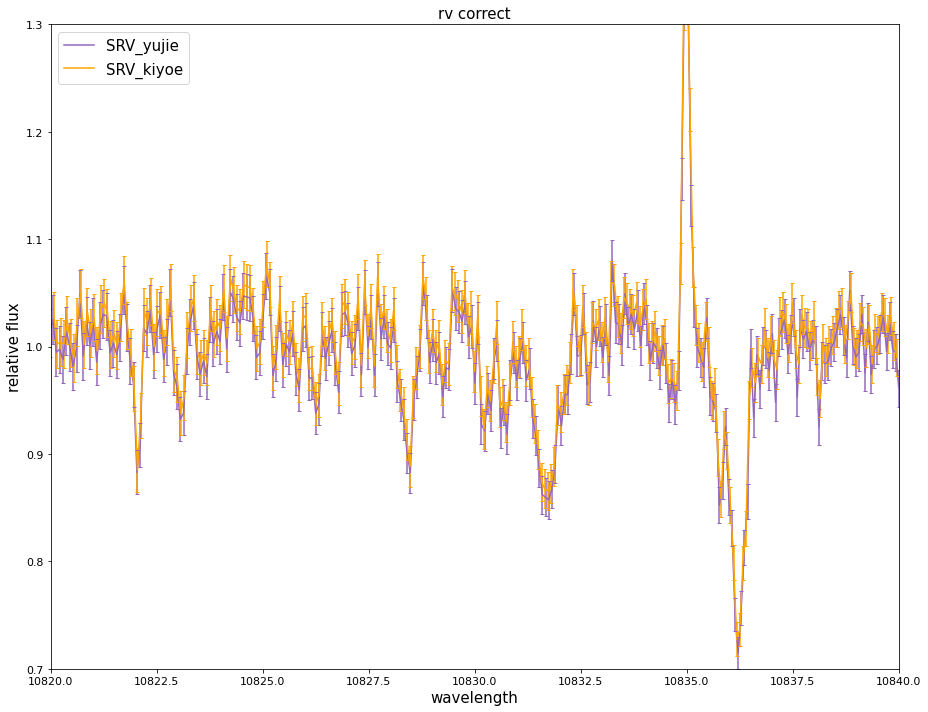

i =  1


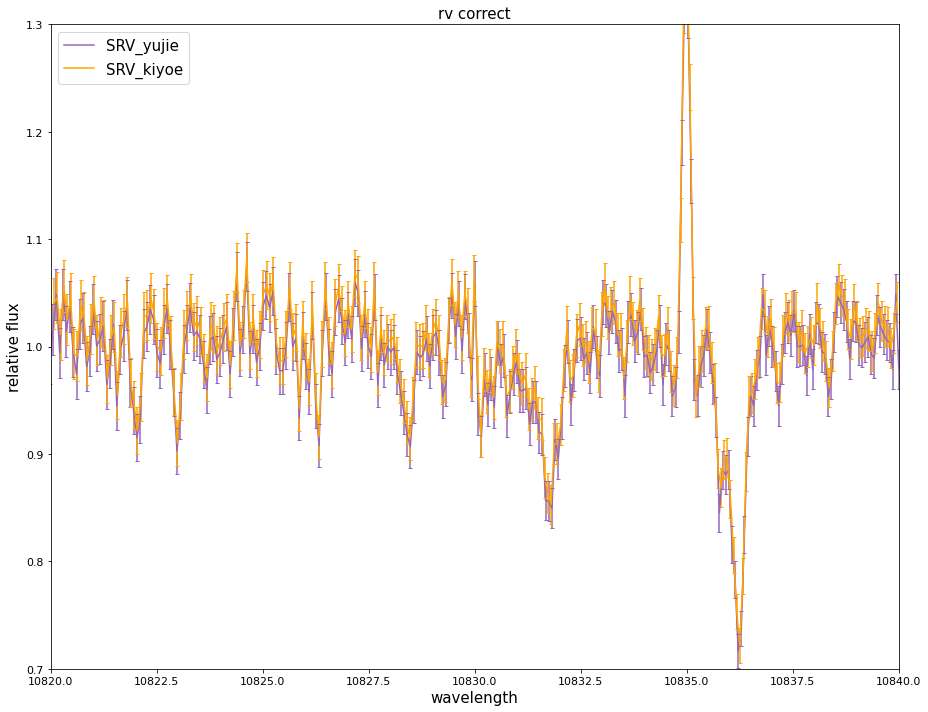

i =  2


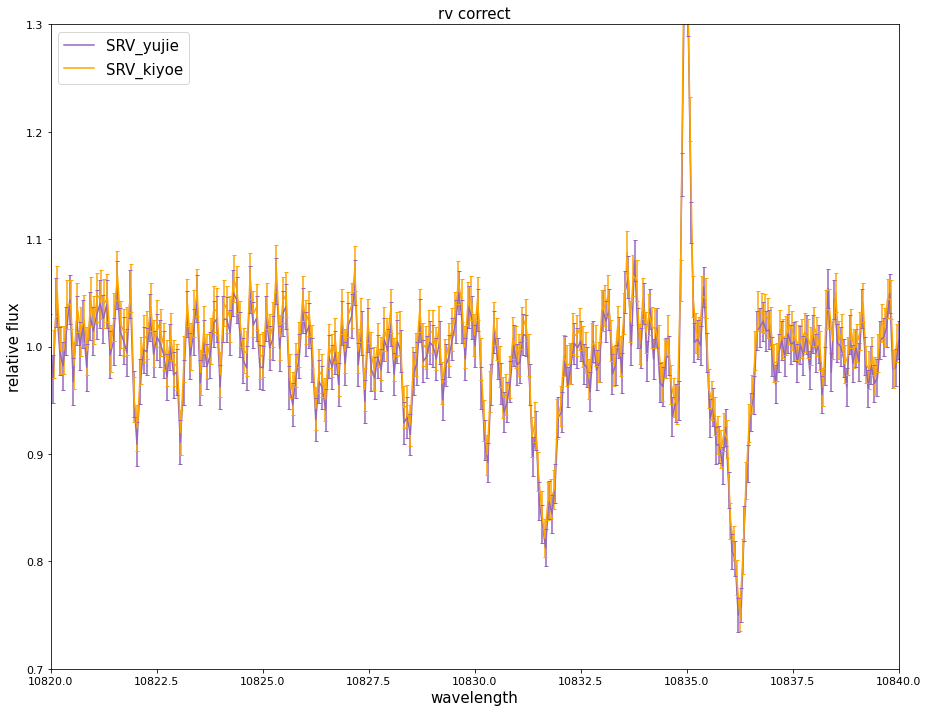

i =  3


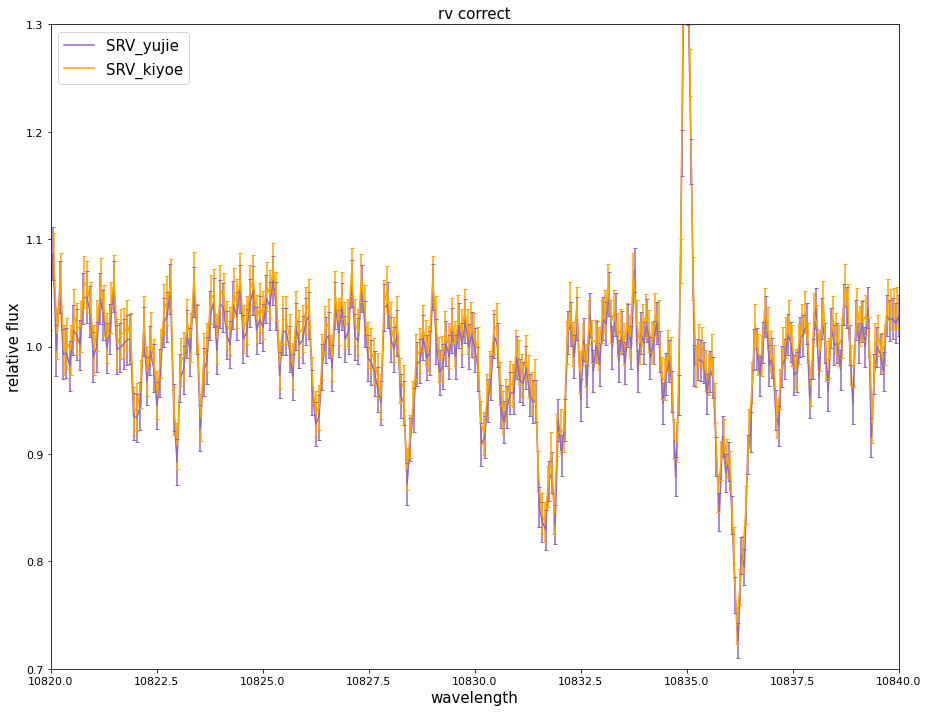

i =  4


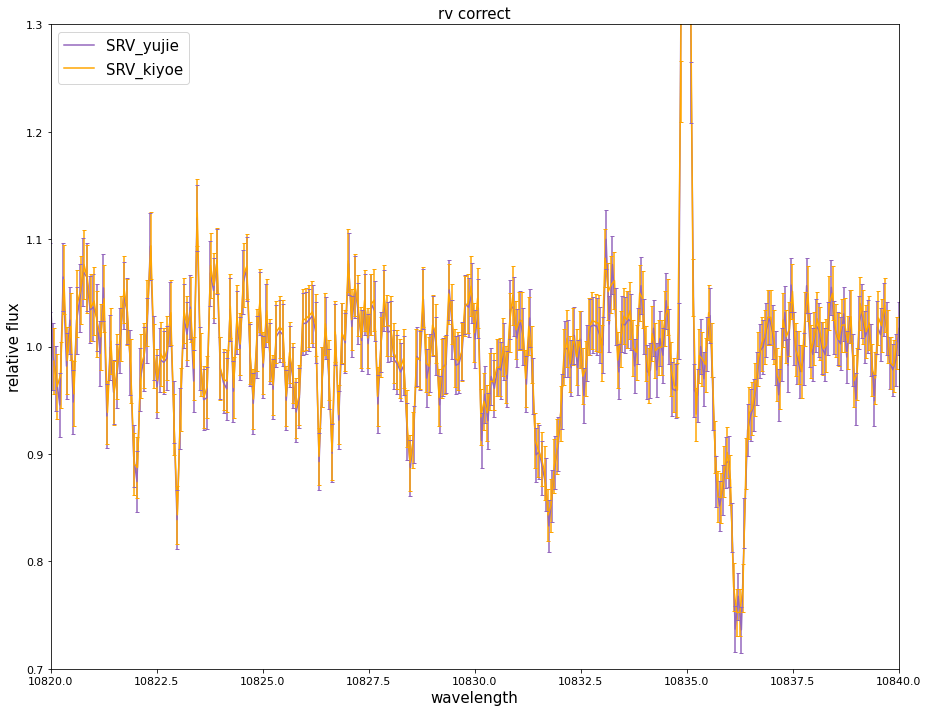

i =  5


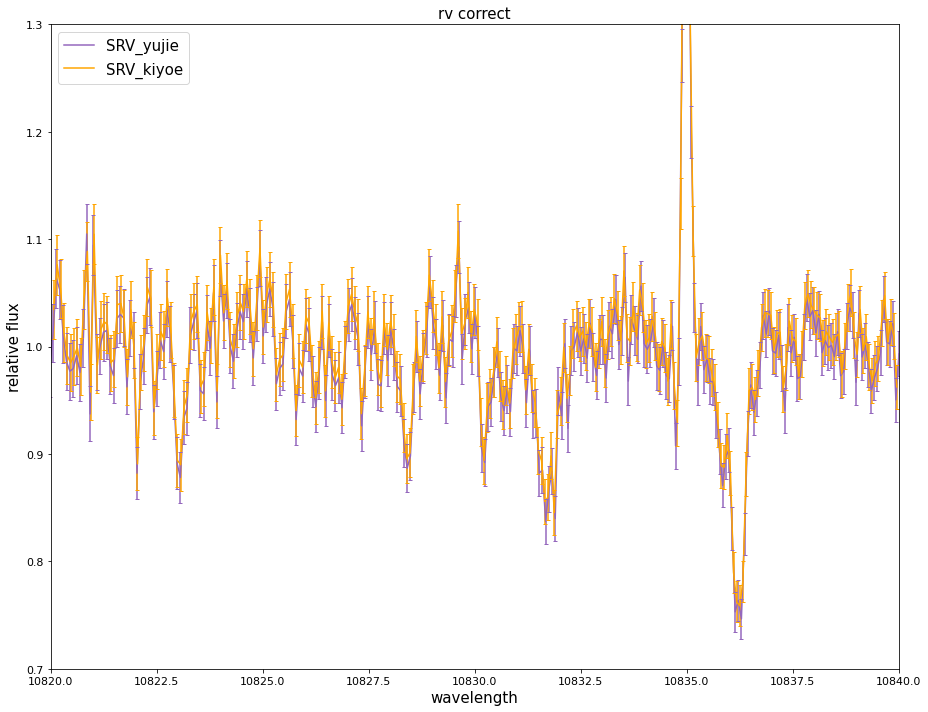

i =  6


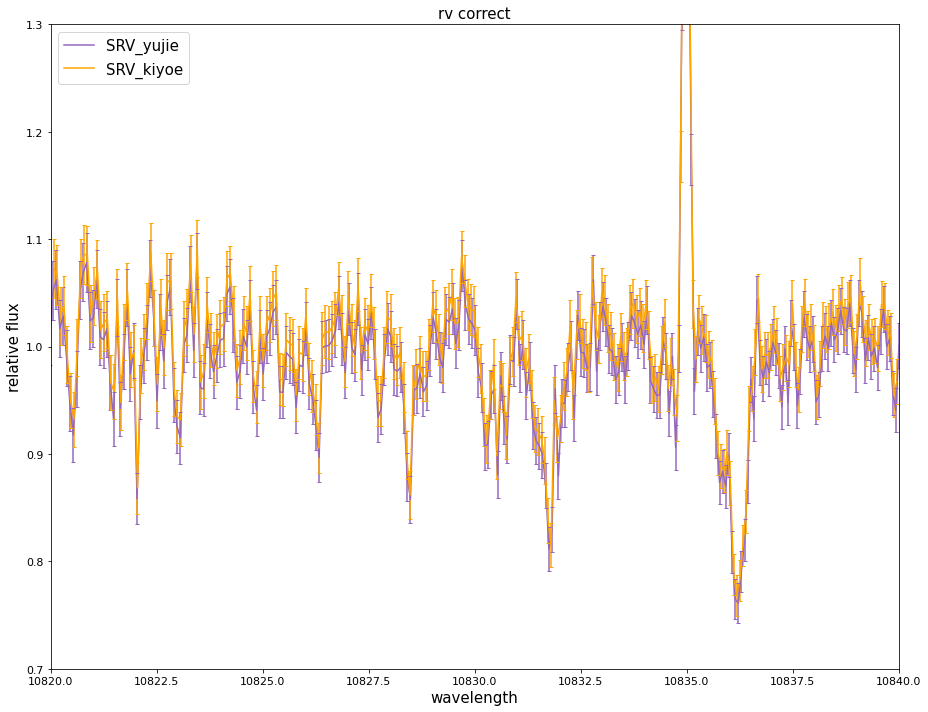

i =  7


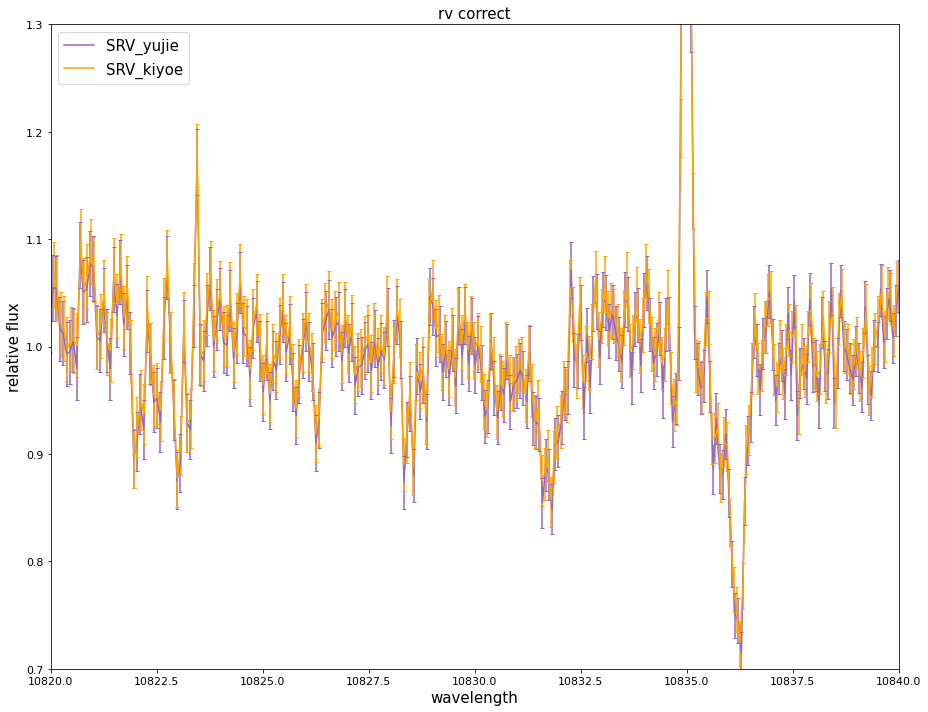

i =  8


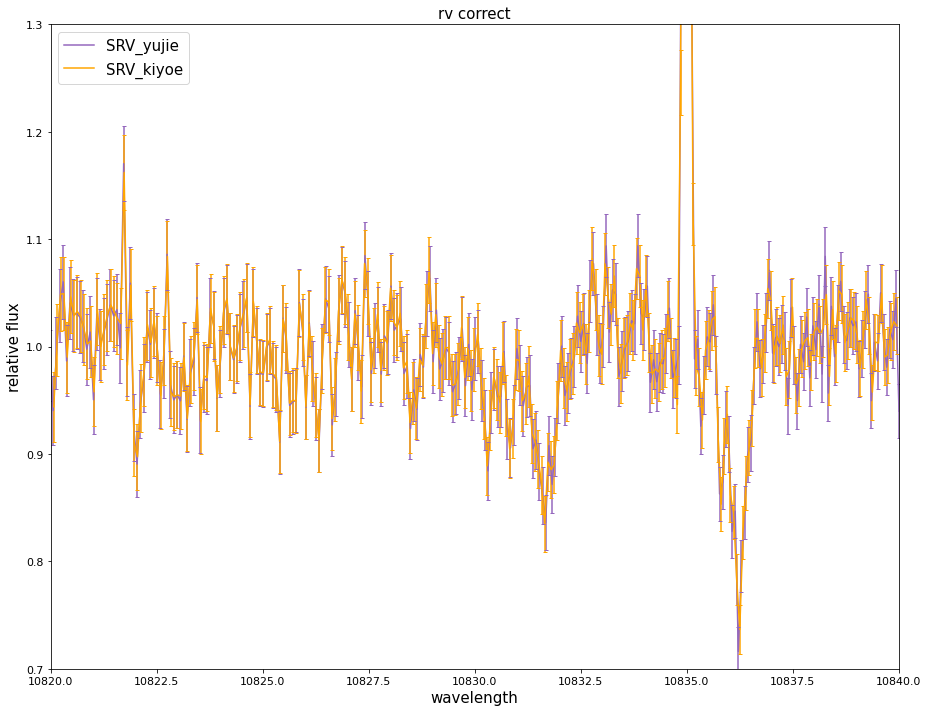

i =  9


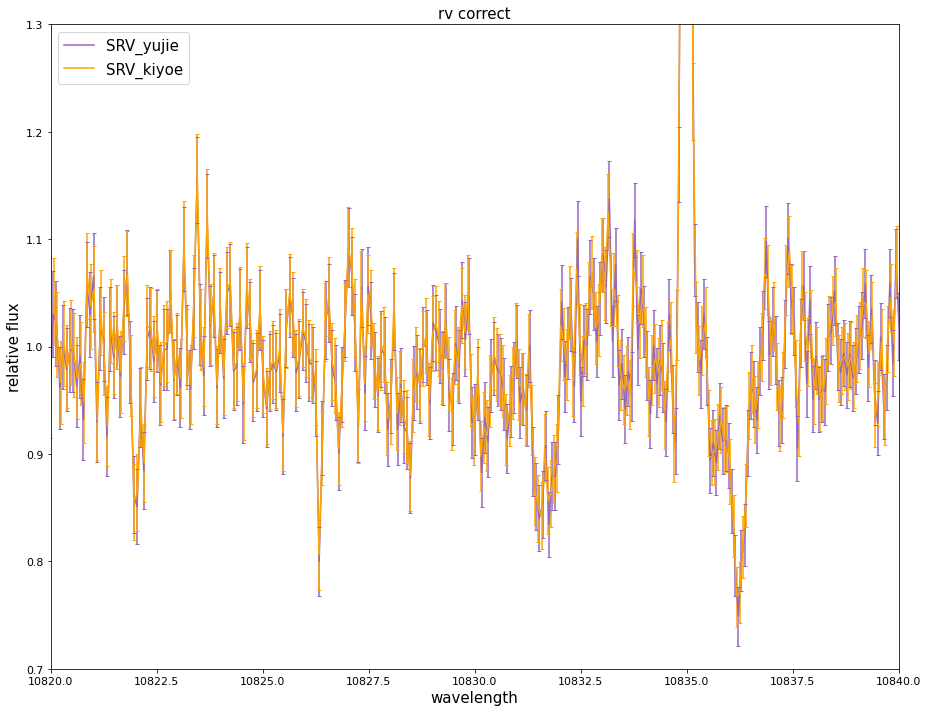

i =  10


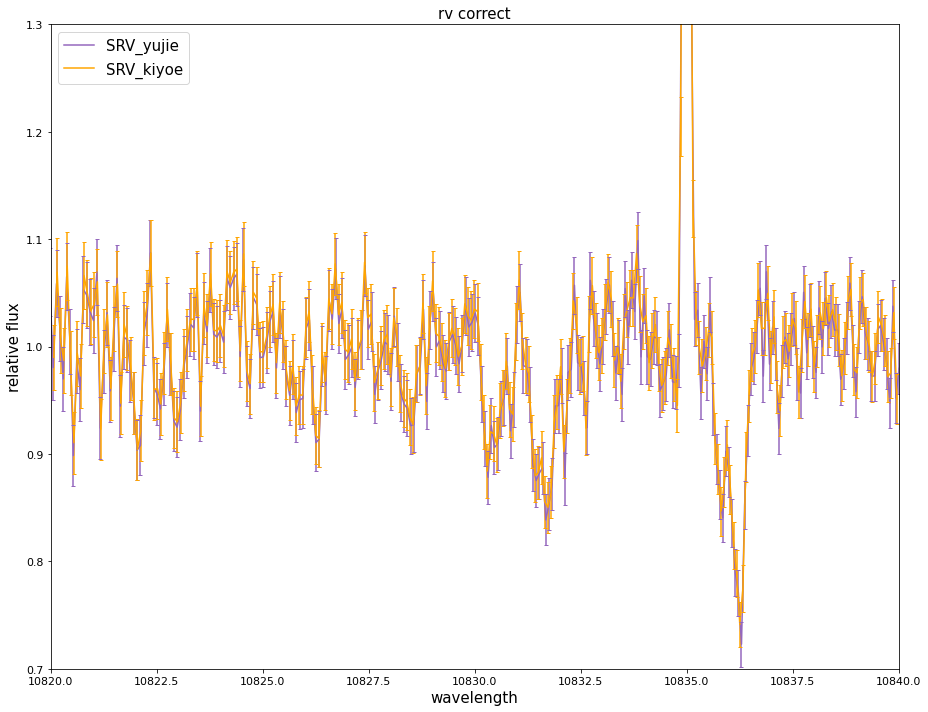

i =  11


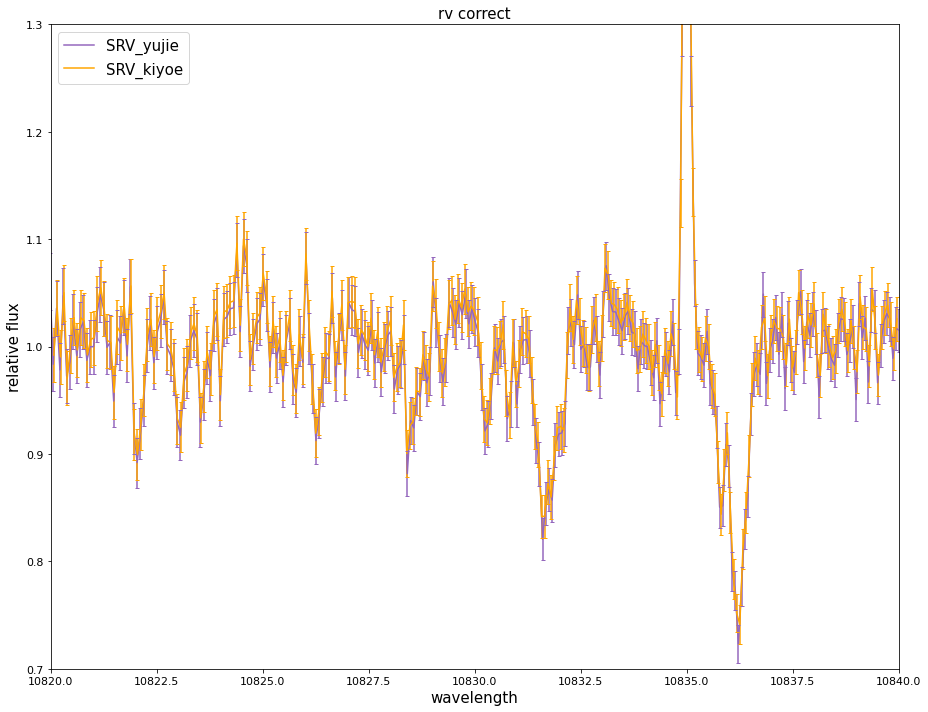

i =  12


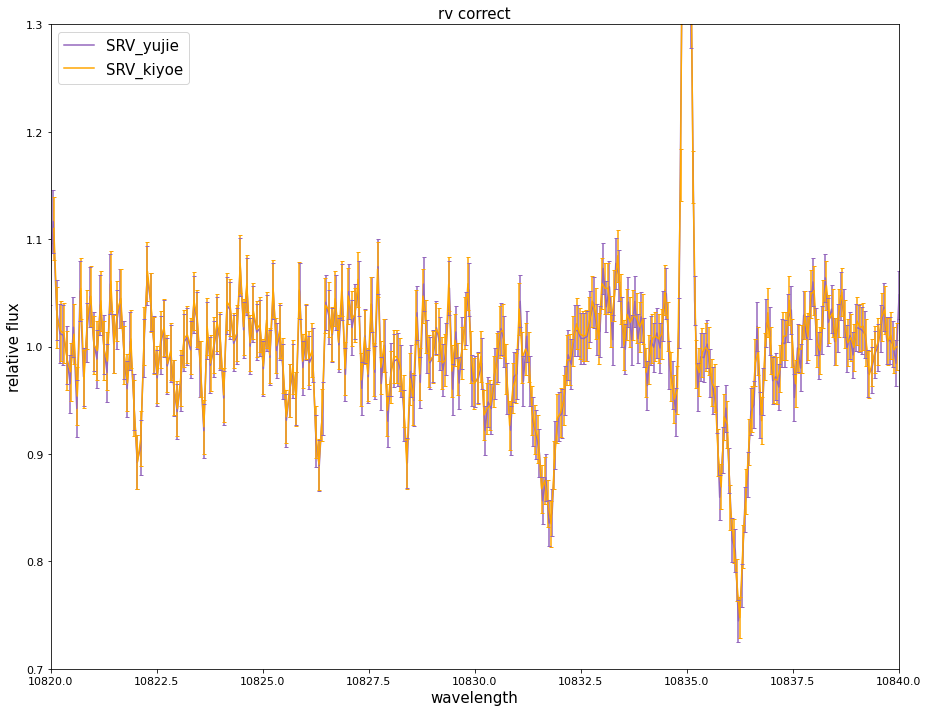

i =  13


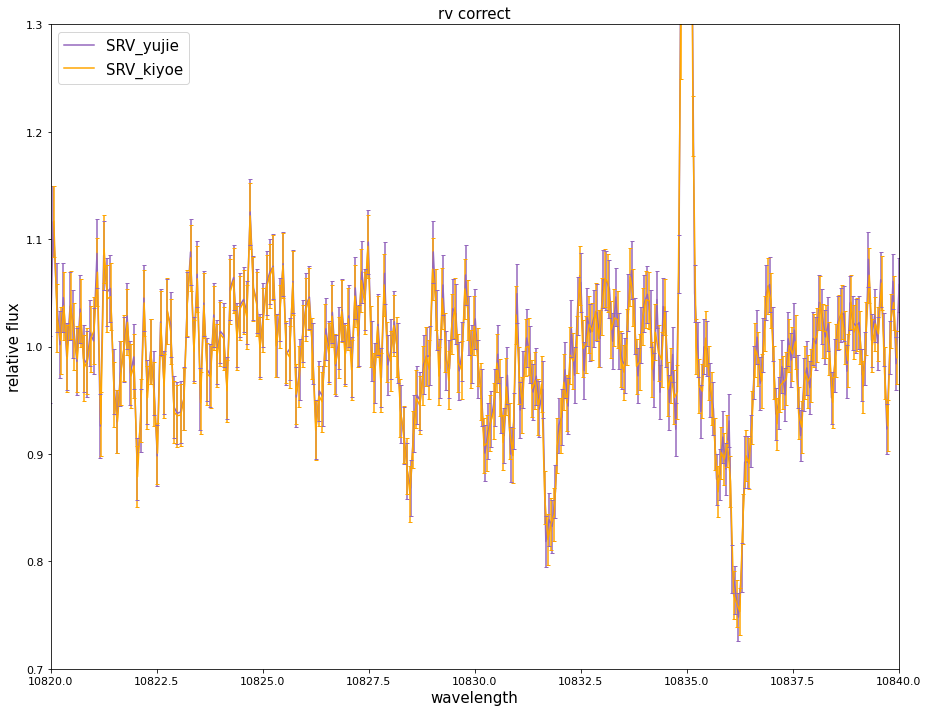

i =  14


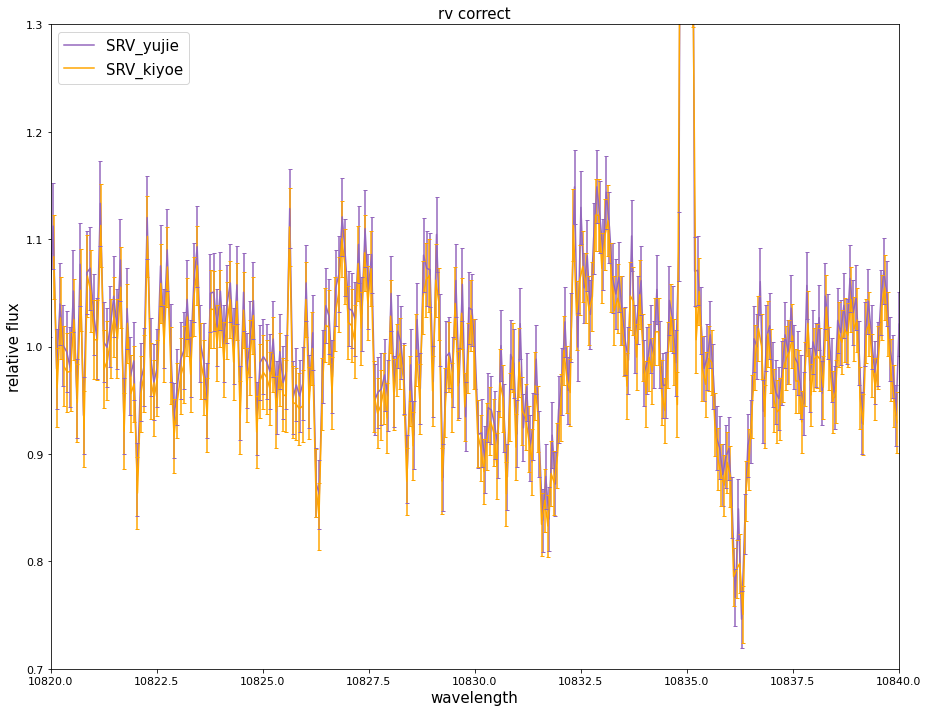

i =  15


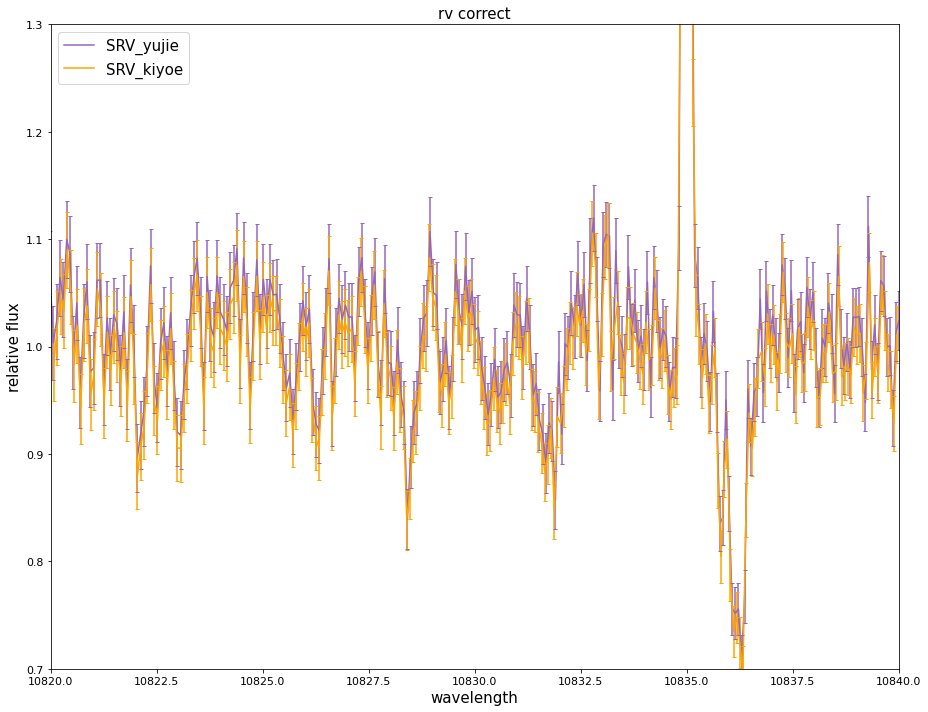

In [105]:
#RV補正した前後のプロット

for i in range(16):

    wrv = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=0, unpack=True)
    flux_norm = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=1, unpack=True)
    flux_norm_err = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=2, unpack=True)
    
    
    wrv_kawauchi = np.loadtxt("./TOI654/SRV_data/ss_smmf2_wc_CcutSRVne_{0}.dat".format(i), usecols=0, unpack=True)
    SRV_kawauchi = np.loadtxt("./TOI654/SRV_data/ss_smmf2_wc_CcutSRVne_{0}.dat".format(i), usecols=1, unpack=True)
    SRV_err_kawauchi = np.loadtxt("./TOI654/SRV_data/ss_smmf2_wc_CcutSRVne_{0}.dat".format(i), usecols=2, unpack=True)
    
    fig = plt.figure(figsize = (13,10))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    
    ax1.plot( wrv, flux_norm,   markersize=1, color="tab:purple", label="SRV_yujie" )
    ax1.plot( wrv_kawauchi, SRV_kawauchi,   markersize=1, color="orange", label="SRV_kiyoe" )

    #marker='o', markersize=1
    #ax1.plot(wavelength0, flux_norm,  "--", color="r", label="Before rv correct" )
    #ax1.plot(wrv, flux_norm, marker='o', markersize=1, color="g", label="After rv correct")

    ax1.set_xlabel("wavelength", size=15 )
    ax1.set_ylabel("relative flux", size=15)
    ax1.legend(loc="upper left", fontsize = 15)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(0.5, 1.5)
    ax1.set_ylim(0.7, 1.3)
    ax1.set_xlim(10820, 10840)
    #ax1.set_xlim(10827, 10834)

    
    print("i = ", i)
    
    plt.title('rv correct', size = 15)
    plt.tick_params(labelsize=11)
    
    plt.errorbar(x=wrv, y=flux_norm, yerr=flux_norm_err, capsize=2,  ls='none',   ecolor='tab:purple')
    plt.errorbar(x=wrv_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    plt.tight_layout()  # タイトルの被りを防ぐ
    
    plt.savefig( "./TOI654/Figures/SRV_compare_latest_{0}.png".format(i))
    #plt.showではない!!
    plt.show()
    
    #  plt.show()の後で保存すると、 <Figure size  with 0 Axes>という警告が出て、図がうまく保存されない。
    #plt.savefig( "./TOI654/Figures/SRV_compare_latest_{0}.png".format(i))
    


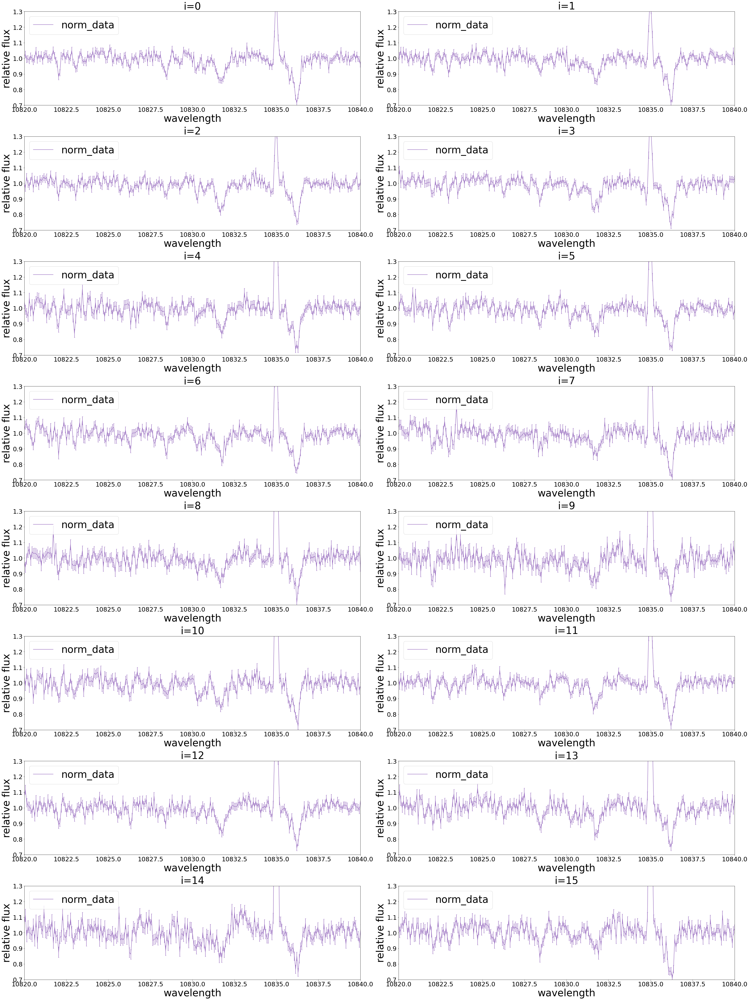

In [130]:
#RV補正した前後のプロット
fig = plt.figure(figsize = (42,56))


for i in range(16):

    wrv = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=0, unpack=True)
    flux_norm = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=1, unpack=True)
    flux_norm_err = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=2, unpack=True)
    
    

    
    
    ax = fig.add_subplot(8,2,i+1) 
    #ax2 = fig.add_subplot(111)

    
    ax.plot( wrv, flux_norm,   markersize=1, color="tab:purple", label="norm_data" )
    ax.errorbar(x=wrv, y=flux_norm, yerr=flux_norm_err, capsize=2,  ls='none',   ecolor='tab:purple')
    
    ax.set_xlabel("wavelength", size=40 )
    ax.set_ylabel("relative flux", size=40)
    ax.legend(loc="upper left", fontsize = 40)
    ax.set_title('i={0}'.format(i), size=40)
    
    
    ax.set_ylim(0.7, 1.3)
    #ax1.set_xlim(10820, 10840)
    ax.set_xlim(10820, 10840)

    
    #print("i = ", i)
    
    # plt.title('rv correct', size = 15)
    # plt.tick_params(labelsize=11)
    ax.tick_params(labelsize=25)
    
    # plt.errorbar(x=wrv, y=flux_norm, yerr=flux_norm_err, capsize=2,  ls='none',   ecolor='tab:purple')
    # #plt.errorbar(x=wrv_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    #plt.tight_layout()  # タイトルの被りを防ぐ
    #plt.show()
    #plt.show()
    
plt.tight_layout()


### !! ここからは変更点:

##### I. 直接telluric向けにrv補正後のスペクトルをつくる。その後は必要な番号だけ残して、それらに対してnanを切る。その後は同じようにtelluric補正手順を。


In [3]:


for i in range(0,16):   #telluriclistは配列が違う. telluricfluxとは違う.

    wrv = np.loadtxt("./TOI654/wrv654/wrv654_{0}.dat".format(i), usecols=0, unpack=True)
    flux_norm = np.loadtxt("./TOI654/normal_ordering/normal_rawYJband_{0}.dat".format(i), unpack=True)
    #usecolsはなし!
    
    #LSDの観測スペクトルY:
    #F = 1 - flux_norm
    
    
    print("i=", i)
    print('wrv=', wrv)
    print('Y_rv=', flux_norm)
    

    outputfile = './TOI654/Y_rv/Y_rv_{0}.dat'.format(i)
    
    d = np.column_stack((wrv, flux_norm))     #np.savetxt 複数配列の保存方法
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
   

i= 0
wrv= [10758.96407479 10759.06136746 10759.15863538 ... 10900.55454017
 10900.59411543 10900.63366133]
Y_rv= [nan nan nan ... nan nan nan]
i= 1
wrv= [10758.96335752 10759.06065019 10759.1579181  ... 10900.55381346
 10900.59338873 10900.63293462]
Y_rv= [nan nan nan ... nan nan nan]
i= 2
wrv= [10758.96264026 10759.05993291 10759.15720082 ... 10900.55308676
 10900.59266202 10900.63220791]
Y_rv= [nan nan nan ... nan nan nan]
i= 3
wrv= [10758.96228163 10759.05957428 10759.15684219 ... 10900.55272341
 10900.59229867 10900.63184455]
Y_rv= [nan nan nan ... nan nan nan]
i= 4
wrv= [10758.96156436 10759.05885701 10759.15612491 ... 10900.5519967
 10900.59157196 10900.63111784]
Y_rv= [nan nan nan ... nan nan nan]
i= 5
wrv= [10758.96120573 10759.05849837 10759.15576627 ... 10900.55163335
 10900.59120861 10900.63075449]
Y_rv= [nan nan nan ... nan nan nan]
i= 6
wrv= [10758.9608471  10759.05813974 10759.15540763 ... 10900.55127
 10900.59084526 10900.63039114]
Y_rv= [nan nan nan ... nan nan nan]
i= 

##### II. 上とは別で、LSD用のデータをつくるのは以下のコード。

LSD前にもう一回nan消し

In [3]:


for i in range(16):   #telluriclistは配列が違う. telluricfluxとは違う.

    wrv = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=0, unpack=True)
    flux_norm = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=1, unpack=True)
    flux_norm_err = np.loadtxt("./TOI654/wrv654/wrv654_latest_red_{0}.dat".format(i), usecols=2, unpack=True)
    #usecolsはなし!
    
    #LSDの観測スペクトルY:
    
    
    
    print("i=", i)
    print('wrv=', wrv)
    
    
    flux_norm = flux_norm.reshape(-1,1)
    flux_norm_err = flux_norm_err.reshape(-1,1)
    wrv = wrv.reshape(-1,1)
    
    
    #errorのnan消し!!
    wrv_nan = wrv[~np.isnan(flux_norm_err).any(axis=1), :]
    flux_norm_nan = flux_norm[~np.isnan(flux_norm_err).any(axis=1), :]
    flux_norm_err_nan = flux_norm_err[~np.isnan(flux_norm_err).any(axis=1), :]
    
    print('flux_norm_nan_shape', np.shape(flux_norm_nan))
    print('lux_norm_err_nan_shape', np.shape(flux_norm_err_nan))
    print('wrv_nan_shape', np.shape(wrv_nan))

    
    F = 1 - flux_norm_nan
    print('Y_obs=', F)
    
    
    
    if F[j] < -0.25:
        del F[j]
    
    
    
    
    outputfile = './TOI654/Y_obs/Y_obs_latest_{0}.dat'.format(i)
    
    d = np.column_stack((wrv_nan, F))     #np.savetxt 複数配列の保存方法
    d = np.column_stack((d, flux_norm_err_nan))
    
    
    ##LSD入力データの形式(桁数とか)は要注意!!
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    #np.savetxt(outputfile, d, delimiter =" ", fmt ='% s ')
    np.savetxt(outputfile, d, delimiter=" ", fmt=["%.11f", "%.6f", "%.7f"])  #カラムごとに異なる桁数!!




i= 0
wrv= [10760.73396922 10760.83117535 10760.92835671 ... 10899.6488582
 10899.69011485 10899.73134207]
flux_norm_nan_shape (1987, 1)
lux_norm_err_nan_shape (1987, 1)
wrv_nan_shape (1987, 1)
Y_obs= [[-0.13810211]
 [ 0.06298028]
 [-0.1147756 ]
 ...
 [ 0.05506467]
 [-0.10856865]
 [-0.05420029]]
i= 1
wrv= [10760.7346866  10760.83189274 10760.9290741  ... 10899.64958484
 10899.6908415  10899.73206871]
flux_norm_nan_shape (1987, 1)
lux_norm_err_nan_shape (1987, 1)
wrv_nan_shape (1987, 1)
Y_obs= [[-0.46376985]
 [-0.05128384]
 [-0.3167109 ]
 ...
 [-0.05078503]
 [ 0.00545956]
 [ 0.01327095]]
i= 2
wrv= [10760.73540399 10760.83261013 10760.9297915  ... 10899.65031149
 10899.69156814 10899.73279536]
flux_norm_nan_shape (1987, 1)
lux_norm_err_nan_shape (1987, 1)
wrv_nan_shape (1987, 1)
Y_obs= [[-0.2608329 ]
 [-0.03049022]
 [ 0.025119  ]
 ...
 [-0.06946994]
 [ 0.04630589]
 [ 0.08585418]]
i= 3
wrv= [10760.73576268 10760.83296882 10760.93015019 ... 10899.65067481
 10899.69193147 10899.73315869]
flu

In [4]:
print(F[F>-0.25])

[ 8.13246849e-01 -1.78693216e-01 -3.18132953e-04 ...  1.74406917e-01
  1.17834442e-01  7.45885823e-02]


#### baseline0、上向きにした後のプロット

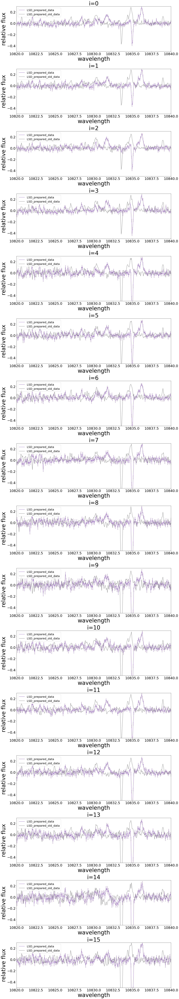

In [81]:
#baseline0、上向きにした後のプロット
fig = plt.figure(figsize = (18,100))


for i in range(16):

    wrv = np.loadtxt("./TOI654/Y_obs/Y_obs_latest_{0}.dat".format(i), usecols=0, unpack=True)
    F = np.loadtxt("./TOI654/Y_obs/Y_obs_latest_{0}.dat".format(i), usecols=1, unpack=True)
    F_err = np.loadtxt("./TOI654/Y_obs/Y_obs_latest_{0}.dat".format(i), usecols=2, unpack=True)
    
    #wrv_old = np.loadtxt("./TOI654/Y_obs/Y_obs_{0}.dat".format(i), usecols=0, unpack=True)  #補正後波長
    #F_old = np.loadtxt("./TOI654/Y_obs/Y_obs_{0}.dat".format(i), usecols=1, unpack=True)  #規格化フラックス

    wrv_old = np.loadtxt("./TOI654/Y_LSD_photon_awk/Y_LSD_photon_{0}.dat".format(i), usecols=0, unpack=True)  #補正後波長
    F_old = np.loadtxt("./TOI654/Y_LSD_photon_awk/Y_LSD_photon_{0}.dat".format(i), usecols=1, unpack=True)  #規格化フラックス
    
    
    ax = fig.add_subplot(16,1,i+1) 
    #ax2 = fig.add_subplot(111)

    
    ax.plot( wrv, F,   markersize=1, color="tab:purple", label="LSD_prepared_data" )
    ax.errorbar(x=wrv, y=F, yerr=F_err, capsize=2,  ls='none',   ecolor='tab:purple')
    
    #ax.plot( wrv_old, F_old,  markersize=1, color="tab:grey", label="LSD_prepared_old_data" )
    ax.plot( wrv_old, F_old,  markersize=1, color="tab:grey", label="LSD_prepared_old_data" )
    
    ax.set_xlabel("wavelength", size=40 )
    ax.set_ylabel("relative flux", size=40)
    ax.legend(loc="upper left", fontsize = 20)
    ax.set_title('i={0}'.format(i), size=40)
    
    
    #ax.set_ylim(0.7, 1.3)
    ax.set_ylim(-0.5, 0.3)
    #ax1.set_xlim(10820, 10840)
    ax.set_xlim(10820, 10840)

    
    #print("i = ", i)
    
    # plt.title('rv correct', size = 15)
    # plt.tick_params(labelsize=11)
    ax.tick_params(labelsize=25)
    
    # plt.errorbar(x=wrv, y=F, yerr=F_err, capsize=2,  ls='none',   ecolor='tab:purple')
    # #plt.errorbar(x=wrv_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    #plt.tight_layout()  # タイトルの被りを防ぐ
    #plt.show()
    #plt.show()
    
plt.tight_layout()


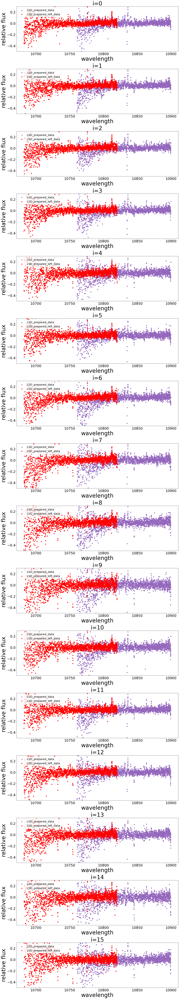

In [10]:
#baseline0、上向きにした後のプロット
fig = plt.figure(figsize = (18,100))


for i in range(16):

    wrv = np.loadtxt("./TOI654/Y_obs/Y_obs_latest_{0}.dat".format(i), usecols=0, unpack=True)
    F = np.loadtxt("./TOI654/Y_obs/Y_obs_latest_{0}.dat".format(i), usecols=1, unpack=True)
    F_err = np.loadtxt("./TOI654/Y_obs/Y_obs_latest_{0}.dat".format(i), usecols=2, unpack=True)
    
    #wrv_left = np.loadtxt("./TOI654/Y_obs/Y_obs_{0}.dat".format(i), usecols=0, unpack=True)  #補正後波長
    #F_left = np.loadtxt("./TOI654/Y_obs/Y_obs_{0}.dat".format(i), usecols=1, unpack=True)  #規格化フラックス

    wrv_left = np.loadtxt("./TOI654/Y_obs_left/Y_obs_left_latest_{0}.dat".format(i), usecols=0, unpack=True)  #補正後波長
    F_left = np.loadtxt("./TOI654/Y_obs_left/Y_obs_left_latest_{0}.dat".format(i), usecols=1, unpack=True)  #規格化フラックス
    
    
    
    
    ax = fig.add_subplot(16,1,i+1) 
    #ax2 = fig.add_subplot(111)

    
    ax.scatter( wrv, F,   color="tab:purple", label="LSD_prepared_data" )
    #ax.errorbar(x=wrv, y=F, yerr=F_err, capsize=2,  ls='none',   ecolor='tab:purple')
    
    #ax.plot( wrv_left, F_left,  markersize=1, color="tab:grey", label="LSD_prepared_left_data" )
    ax.scatter( wrv_left, F_left  ,color="red", label="LSD_prepared_left_data" )
    
    ax.set_xlabel("wavelength", size=40 )
    ax.set_ylabel("relative flux", size=40)
    ax.legend(loc="upper left", fontsize = 20)
    ax.set_title('i={0}'.format(i), size=40)
    
    
    #ax.set_ylim(0.7, 1.3)
    ax.set_ylim(-0.5, 0.3)
    #ax1.set_xlim(10820, 10840)
    #ax.set_xlim(10760, 10830)

    
    #print("i = ", i)
    
    # plt.title('rv correct', size = 15)
    # plt.tick_params(labelsize=11)
    ax.tick_params(labelsize=25)
    
    # plt.errorbar(x=wrv, y=F, yerr=F_err, capsize=2,  ls='none',   ecolor='tab:purple')
    # #plt.errorbar(x=wrv_kawauchi, y=SRV_kawauchi, yerr=SRV_err_kawauchi,capsize=2,  ls='none',ecolor='orange')
    
    #plt.tight_layout()  # タイトルの被りを防ぐ
    #plt.show()
    #plt.show()
    
plt.tight_layout()


## 4.LSDを行えるようなファイル形式にしていく。LSD変換は川内さんのパイプラインで行う(天文データセンター)。

### rawdataの二列目から、フォトンカウントを取り出して、規格化した上でLSD用データに書き込む。

In [ ]:
#フォトンノイズを切り取る



for i in range(0,31):
    
    
    photon0 = np.loadtxt("./TOI654/rawdata*/rawspec_{0}.spec".format(i), comments='#', usecols=1) 
    
    if len(photon0) < 45055:
        print(i,"th file: No data")
        print(len(photon0))
        continue
    
    
    photon = photon0[45056:47104]  #10760Å ~ 10899Å
    
    print("i=", i)
    print(photon0.shape)
    print('photon=', photon)
    
    #ここでi+=1だとループが変になっちゃう。
    
    #np.savetxt 複数配列の保存方法
   
   #ディレクトリは事前に作っておかないと!!!
    #np.savetxt("./TOI654/photon_left/left_raw_{0}.dat".format(i), photon)
    np.savetxt("./TOI654/photoncount/He_photon/He_photon_{0}.dat".format(i), photon)
    

In [ ]:
#photon countを規格化
import statistics

#データが入っているのは:

#He: [1, 3, 4, 6,...]
#left:[1, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]

#for i in range(0,31):
for i in [1, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]:
       
    #He_raw = np.loadtxt("./TOI654/rawspec/He_raw_{0}.dat".format(i), usecols=1) 
    He_photon = np.loadtxt("./TOI654/photoncount/He_photon/He_photon_{0}.dat".format(i))

    '''
    #if len(left_raw) < 2137:
    if len(left_raw) < 2047:
        print(i,"th file: No data")
        print(len(left_raw))
        continue
    
    '''
    
    #median = statistics.median(He_raw)
    median = statistics.median(He_photon)
    
    #normal = He_raw / median
    normal = He_photon / median
    
    
    print("i=", i)
    print(normal.shape)
    #print('He_raw', He_raw)
    print()
    print('median=', median)
    print('normal=', normal)
    
    
    
    #ここでi+=1だとループが変になっちゃう。
    
    #np.savetxt 複数配列の保存方法
   
    np.savetxt("./TOI654/normal_photon/normal_photon_{0}.dat".format(i), normal) #フォルダーを先に作っとかないといけないの?!


ここはphotonノイズをもう一回求めてしまった。

In [27]:
#データの形式: 波長 |  規格化baseline0上向きflux  |  規格化後のfluxエラーバー 
#ここではwrv654のスペクトルを使って、エラーを求めていく。


for i in range(16):   #telluriclistは配列が違う. telluricfluxとは違う.

    wrv = np.loadtxt("./TOI654/wrv654/wrv654_{0}.dat".format(i), usecols=0, unpack=True)
    #flux_norm = np.loadtxt("./TOI654/normal_He_ordering/normal_He_ordering_{0}.dat".format(i), unpack=True)
    #usecolsはなし! 
    F = np.loadtxt("./TOI654/Y_obs/Y_obs_{0}.dat".format(i), usecols=1, unpack=True)
    photon_norm = np.loadtxt("./TOI654/normal_photon_ordering/normal_photon_ordering_{0}.dat".format(i), unpack=True)
    
    #LSDの観測スペクトルY:
    
    #photon_norm = photon / flux
    
    #もう規格化されたので、もう一回規格化ように描かなくてもいいぞ。
    #er = 1 / ( (photon_norm) ** 0.5 )  #フォトンノイズ 
    er = photon_norm ** 0.5
    print("ershape=", er.shape)
    Y_LSD = np.vstack((wrv, F))  #一回2列を合併 vertical
    print("Y_LSD.shape=",Y_LSD.shape)
    
    print("i=", i)
    print('wrv=', wrv)
    print('Y_LSD_er=', er)

    outputfile = './TOI654/Y_LSD_photon/Y_LSD_photon_{0}.dat'.format(i)
    print("dshape=", d.shape)
    d = Y_LSD
    d = np.vstack((d,er))   #もう一回合併すると3列以上できる! !!!
    d = d.T
    #print("d=",d)
    #d = np.vstack((Y_LSD, er),axis=1)     #np.savetxt 複数配列の保存方法
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')

ershape= (2048,)
Y_LSD.shape= (2, 2048)
i= 0
wrv= [10758.96407479 10759.06136746 10759.15863538 ... 10900.55454017
 10900.59411543 10900.63366133]
Y_LSD_er= [nan nan nan ... nan nan nan]
dshape= (2048, 3)
ershape= (2048,)
Y_LSD.shape= (2, 2048)
i= 1
wrv= [10758.96335752 10759.06065019 10759.1579181  ... 10900.55381346
 10900.59338873 10900.63293462]
Y_LSD_er= [nan nan nan ... nan nan nan]
dshape= (2048, 3)
ershape= (2048,)
Y_LSD.shape= (2, 2048)
i= 2
wrv= [10758.96264026 10759.05993291 10759.15720082 ... 10900.55308676
 10900.59266202 10900.63220791]
Y_LSD_er= [nan nan nan ... nan nan nan]
dshape= (2048, 3)
ershape= (2048,)
Y_LSD.shape= (2, 2048)
i= 3
wrv= [10758.96228163 10759.05957428 10759.15684219 ... 10900.55272341
 10900.59229867 10900.63184455]
Y_LSD_er= [nan nan nan ... nan nan nan]
dshape= (2048, 3)
ershape= (2048,)
Y_LSD.shape= (2, 2048)
i= 4
wrv= [10758.96156436 10759.05885701 10759.15612491 ... 10900.5519967
 10900.59157196 10900.63111784]
Y_LSD_er= [nan nan nan ... nan nan

<ipython-input-27-ddeb170647aa>:19: RuntimeWarning: invalid value encountered in sqrt
  er = photon_norm ** 0.5


### VALDデータのWL_airとdepthの読み込み!

In [55]:
#VALDデータのWL_airとdepthの読み込み!

WL_air = np.loadtxt("./TOI654/VALD_data_YujieZou_edited.txt", skiprows=3, usecols=1, delimiter=",",  unpack=True)
depth = np.loadtxt('./TOI654/VALD_data_YujieZou_edited.txt', skiprows=3, usecols=9, delimiter=",", unpack=True)

#delimiterが", "だとうまくいかない。 ","があるとスペースは無視されるのか?

d = np.vstack((WL_air,depth))

print('WL_aif = ' , WL_air)
print('depth = ', depth)

d = d.T

d = d[128:307]     # 対応しているVALD波長を切る。(オーダーに対応しているVALDを使おう!)
print('d = ', d)
#


#np.savetxt('./TOI654/VALD_TOI654_depth_He_latest.dat', d,  delimiter=" ", fmt =["%.7e", "%.3e"] )
np.savetxt('./TOI654/VALD_TOI654_depth_He_latest.dat', d,  delimiter=" ", fmt =["%.3f", "%.3f"] )


#結果: 川内さんの　VALD_TOI654_lcrkai.dat　と同じく426行で、データも一緒のようでok! 



WL_aif =  [10681.859 10682.291 10682.937 10683.525 10683.678 10683.835 10684.239
 10684.35  10684.668 10685.626 10685.834 10686.176 10686.384 10687.64
 10687.786 10687.976 10688.16  10689.116 10689.393 10689.704 10689.754
 10689.801 10690.352 10690.54  10691.006 10691.144 10692.065 10692.253
 10692.897 10692.954 10693.512 10694.251 10696.462 10696.617 10697.017
 10697.211 10697.214 10700.279 10700.31  10700.341 10700.494 10702.287
 10702.963 10703.205 10703.401 10703.551 10703.607 10704.162 10704.971
 10705.386 10705.547 10707.577 10709.691 10710.085 10710.655 10710.836
 10713.135 10713.542 10713.732 10713.81  10714.388 10714.41  10714.413
 10714.578 10715.485 10715.609 10715.713 10715.869 10715.995 10717.806
 10720.367 10720.459 10722.668 10723.413 10723.526 10723.544 10723.71
 10724.122 10724.729 10724.908 10725.185 10726.39  10726.715 10726.922
 10727.406 10728.265 10728.7   10728.848 10730.927 10732.778 10732.865
 10732.943 10733.798 10734.543 10736.205 10736.244 10736.387 10736.66

## 5.LSDで求めた結果をガウシアンフィットして、中央値を求めて、その値だけ吸収線をシフトさせる。 

scipy.optimizeを使ってフィット。

・scipy.optimize.curve_fit — SciPy v1.1.0 Reference Guide

・scipy.optimize.least_squares — SciPy v1.1.0 Reference Guide

In [24]:
#~~川内さんのファイル名を変更するコードブロック_LSD~~

kawauchi = []

index = -1
for i in range(24, 59, 2):  # i, j使わなくて済む. なんというか、二重ループでなければいらないのか。?
    #奇数番号をスキップしました!!
    
    try:


        kawauchi = np.loadtxt("./Suu_LSD/LSDdata_kawauchi/408{}_ss_smmf2_wc_lcrcombne_LSDSRV2kai.dat".format(i),  usecols=(0,1), unpack=True) 
        
        kawauchi = kawauchi.T
        
        print("i=", i)
        print(kawauchi.shape)
        print('kawauchi=', kawauchi)
        index += 1
        #ここでi+=1だとループが変になっちゃう。
        
        #np.savetxt 複数配列の保存方法
        #for j in range(0,16):
        #   print('j=', j)
    
    except OSError:
        print("OSError: .spec not found.")
        continue
    
    print("i_2nd=", index)
    
    np.savetxt("./Suu_LSD/LSDdata_kawauchi/ss_smmf2_wc_lcrcombne_LSDSRV2kai_{0}.dat".format(index), kawauchi)  ## 大発見!!

i= 24
(201, 2)
kawauchi= [[-1.00000e+02  2.46840e-02]
 [-9.90000e+01  5.65100e-03]
 [-9.80000e+01 -1.39598e-01]
 [-9.70000e+01  5.41260e-02]
 [-9.60000e+01  9.01340e-02]
 [-9.50000e+01 -5.36860e-02]
 [-9.40000e+01  8.80100e-03]
 [-9.30000e+01  2.63690e-02]
 [-9.20000e+01  2.16376e-01]
 [-9.10000e+01 -4.41980e-02]
 [-9.00000e+01 -8.45540e-02]
 [-8.90000e+01  8.15530e-02]
 [-8.80000e+01  1.14208e-01]
 [-8.70000e+01  2.15164e-01]
 [-8.60000e+01 -2.99330e-01]
 [-8.50000e+01 -1.26561e-01]
 [-8.40000e+01  5.28840e-02]
 [-8.30000e+01  8.13060e-02]
 [-8.20000e+01 -1.43437e-01]
 [-8.10000e+01 -1.04264e-01]
 [-8.00000e+01  1.54138e-01]
 [-7.90000e+01  1.59023e-01]
 [-7.80000e+01 -2.41979e-01]
 [-7.70000e+01 -3.78580e-02]
 [-7.60000e+01  6.44500e-03]
 [-7.50000e+01  5.26010e-02]
 [-7.40000e+01 -1.74665e-01]
 [-7.30000e+01 -3.92892e-01]
 [-7.20000e+01  4.60705e-01]
 [-7.10000e+01 -6.78460e-02]
 [-7.00000e+01 -2.50840e-01]
 [-6.90000e+01  1.88574e-01]
 [-6.80000e+01 -2.42629e-01]
 [-6.70000e+01  1.

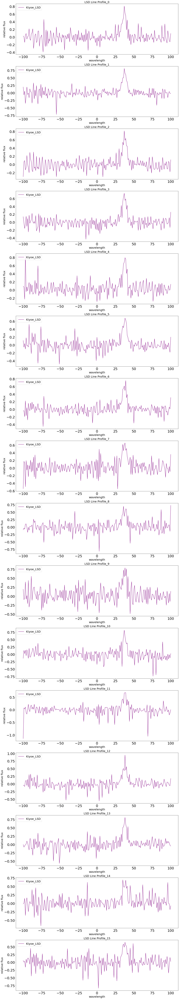

In [83]:
#RV補正した前後のプロット
fig = plt.figure(figsize = (18,100))


for i in range(16):

    
    x = np.loadtxt("./Suu_LSD/Y_LSD_latest_{0}.dat".format(i), usecols=0, unpack=True)
    y = np.loadtxt("./Suu_LSD/Y_LSD_latest_{0}.dat".format(i), usecols=1, unpack=True)
    yr = np.loadtxt("./Suu_LSD/Y_LSD_right_latest_{0}.dat".format(i), usecols=1, unpack=True)
    yl = np.loadtxt("./Suu_LSD/Y_LSD_left_latest_{0}.dat".format(i), usecols=1, unpack=True)
    y_k = np.loadtxt("./Suu_LSD/LSDdata_kawauchi/ss_smmf2_wc_lcrcombne_LSDSRV2kai_{0}.dat".format(i), usecols=1, unpack=True)
    
    y_com = y + yr + yl
    
    
    
    x_old = np.loadtxt("./Suu_LSD/Y_LSD_photon2/Y_LSD_photon2_{0}.dat".format(i), usecols=0, unpack=True)
    y_old = np.loadtxt("./Suu_LSD/Y_LSD_photon2/Y_LSD_photon2_{0}.dat".format(i), usecols=1, unpack=True)
    #yr = np.loadtxt("./Suu_LSD/Y_LSD_right_photon2/Y_LSD_right_photon2_{0}.dat".format(i), usecols=1, unpack=True)
    #yl = np.loadtxt("./Suu_LSD/Y_LSD_left_photon2/Y_LSD_left_photon2_{0}.dat".format(i), usecols=1, unpack=True)

    
    
    ax = fig.add_subplot(16,1,i+1) 
    #ax2 = fig.add_subplot(111)

    
    #ax.plot( x, y , markersize=1, color="tab:green", label="He order " )
    #ax.plot( x, yr , markersize=1, color="tab:orange", label="Right order " )
    #ax.plot( x, yl , markersize=1, color="tab:blue", label="Left order" )
    #ax.plot( x, y_com , ls=':',  markersize=1, color="red", label="Order combined" )
    ax.plot( x, y_k , markersize=1, color="purple", label="Kiyoe_LSD" )
    #ax.plot( x_old, y_old ,ls=':', markersize=1, color="tab:grey", label="He order " )

    
    ax.set_xlabel("wavelength", size=20 )
    ax.set_ylabel("relative flux", size=20)
    ax.legend(loc="upper left", fontsize = 20)
    ax.set_title('LSD Line Profile_{0}'.format(i), size=20)
    
    
    #ax.set_ylim(0.7, 1.3)
    #ax.set_ylim(0.5, 1.5)
    #ax1.set_xlim(10820, 10840)
    #ax.set_xlim(10770, 10780)

    #ax.title('LSD Line Profile', labelsize=20)
    #print("i = ", i)
    
    #plt.title('', size = 25)
    # plt.tick_params(labelsize=11)
    ax.tick_params(labelsize=25)

    #plt.show()
    
    
    
plt.tight_layout()

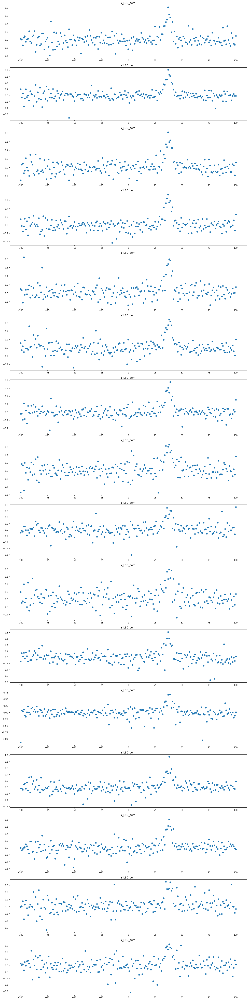

In [84]:
#RV補正した前後のプロット
fig = plt.figure(figsize = (16,64))


for i in range(16):

    
    x = np.loadtxt("./Suu_LSD/Y_LSD_latest_{0}.dat".format(i), usecols=0, unpack=True)
    y = np.loadtxt("./Suu_LSD/Y_LSD_latest_{0}.dat".format(i), usecols=1, unpack=True)
    yr = np.loadtxt("./Suu_LSD/Y_LSD_right_latest_{0}.dat".format(i), usecols=1, unpack=True)
    yl = np.loadtxt("./Suu_LSD/Y_LSD_left_latest_{0}.dat".format(i), usecols=1, unpack=True)
    y_k = np.loadtxt("./Suu_LSD/LSDdata_kawauchi/ss_smmf2_wc_lcrcombne_LSDSRV2kai_{0}.dat".format(i), usecols=1, unpack=True)
    
    y_com = y + yr + yl
    
    # ax = fig.add_subplot(16,1,i+1) 
    #ax2 = fig.add_subplot(111)

    
    # ax.plot( x, y , markersize=1, color="tab:green", label="He order " )
    # ax.plot( x, yr , markersize=1, color="tab:orange", label="Right order " )
    # ax.plot( x, yl , markersize=1, color="tab:blue", label="Left order" )
    # #ax.plot( x, y_com , ls=':',  markersize=1, color="red", label="Order combined" )
    # #ax.plot( x, y_k , markersize=1, color="purple", label="Kiyoe_LSD" )

    
    # ax.set_xlabel("wavelength", size=20 )
    # ax.set_ylabel("relative flux", size=20)
    # ax.legend(loc="upper left", fontsize = 20)
    # ax.set_title('LSD Line Profile_{0}'.format(i), size=20)
    
    
    ax = plt.subplot2grid((16, 1), (i, 0))
    ax.scatter(x,y_k) # ax.hist(d) でも可
    ax.set_title("Y_LSD_com")



    #ax.set_ylim(0.7, 1.3)
    #ax.set_ylim(0.5, 1.5)
    #ax1.set_xlim(10820, 10840)
    #ax.set_xlim(10770, 10780)

    #ax.title('LSD Line Profile', labelsize=20)
    #print("i = ", i)
    
    #plt.title('', size = 25)
    # plt.tick_params(labelsize=11)
    # ax.tick_params(labelsize=25)

    #plt.show()
    
    
    
plt.tight_layout()

結果としてHeオーダー3個、leftオーダー4個のスペクトルが欠落していた。

原因は、Y_obs_**データの中に、ほんの１か数個のデータのエラーの値がnanになったから。そうなったのはおそらくphotonエラーを求める際、ルートの中で1個くらいのピクセルの値が負のためその時エラーの値がnanになったかと。

In [1]:
import numpy as np

TIPS!: 省略。IRD_654_leftorderでCombineしたラインプロファイルを使ったので、固有運動の値はleftorderと同じのを使って大丈夫。

#### 恒星の固有運動の分を波長シフトさせる。

121219 改めてrv補正後のスペクトルに対して、LSD listの速度変化分をシフトさせる。

In [49]:
V_LSDlist = np.loadtxt("./TOI654/Y_obs_LSD/LSDrvlist_revised.dat", unpack=True)  #
print(V_LSDlist)

[-1.28318295 -1.3035382  -1.19839154 -1.00049181 -1.40555435 -1.35988075
 -1.37437305 -1.52917676 -1.36642121 -1.39629035 -1.23623129 -1.21536348
 -1.25173335]


In [50]:
V_LSD_mean = np.mean(V_LSDlist)
print(V_LSD_mean)

-1.301586853173257


In [25]:
"""
wrv654 = np.loadtxt("./TOI654/Y_obs/Y_obs_8.dat", usecols=0, unpack=True)  #補正後波長
F = np.loadtxt("./TOI654/Y_obs/Y_obs_8.dat", usecols=1, unpack=True)  #規格化フラックス

V_LSD = -1.23623129 #km/s

LSDrv = wrv654 / ( (1 + ( (V_LSD * 10**3) / (3 * 10**8))) / (1 - ((V_LSD * 10**3) / (3 * 10**8))) ) ** 0.5
print('wrv654=', wrv654)
print('LSDrv=', LSDrv)
print('Δλ = ', LSDrv - wrv654)
#print('flux_norm=', flux_norm)

outputfile = './TOI654/Y_obs_LSD/Y_obs_LSD_8.dat'
d = np.column_stack((LSDrv,F))     #np.savetxt 複数配列の保存方法
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')

#-1.3km/sだと変化が0.05オームストロングもないよ..
"""

'\nwrv654 = np.loadtxt("./TOI654/Y_obs/Y_obs_8.dat", usecols=0, unpack=True)  #補正後波長\nF = np.loadtxt("./TOI654/Y_obs/Y_obs_8.dat", usecols=1, unpack=True)  #規格化フラックス\n\nV_LSD = -1.23623129 #km/s\n\nLSDrv = wrv654 / ( (1 + ( (V_LSD * 10**3) / (3 * 10**8))) / (1 - ((V_LSD * 10**3) / (3 * 10**8))) ) ** 0.5\nprint(\'wrv654=\', wrv654)\nprint(\'LSDrv=\', LSDrv)\nprint(\'Δλ = \', LSDrv - wrv654)\n#print(\'flux_norm=\', flux_norm)\n\noutputfile = \'./TOI654/Y_obs_LSD/Y_obs_LSD_8.dat\'\nd = np.column_stack((LSDrv,F))     #np.savetxt 複数配列の保存方法\n    #np.savetxt(outputfile,target, delimiter =",",fmt =\'% s\')\nnp.savetxt(outputfile, d, delimiter =" ", fmt =\'% s\')\n\n#-1.3km/sだと変化が0.05オームストロングもないよ..\n'

IRD  の波長分解能 10830/x = 70000  x~0.1ちょっと気にせん..

In [82]:
i = 0

for V_LSD in V_LSDlist:

    wrv654 = np.loadtxt("./TOI654/Y_LSD_photon_awk_revised/Y_LSD_photon_awk_revised_{0}.dat".format(i), usecols=0, unpack=True)  #補正後波長
    F = np.loadtxt("./TOI654/Y_LSD_photon_awk_revised/Y_LSD_photon_awk_revised_{0}.dat".format(i), usecols=1, unpack=True)  #規格化フラックス

    #V_LSD[7] = -1.23623129 #km/s

    wrv654 = wrv654 
    
    LSDrv = wrv654 / ( (1 + ( (V_LSD * 10**3) / (3 * 10**8))) / (1 - ((V_LSD * 10**3) / (3 * 10**8))) ) ** 0.5
    
    print('V_LSD=', V_LSD)
    print('wrvwrv654=',wrv654)
    print('LSDrv=', LSDrv)
    print('Δλ = ', LSDrv - wrv654)

    print("F=", F)
    print("F_shape=", np.shape(F))

    outputfile = './TOI654/Y_obs_peculliar/Y_obs_peculliar_{0}.dat'.format(i)
    d = np.column_stack((LSDrv,F))     #np.savetxt 複数配列の保存方法
        #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
    i+=1

    #-1.3km/sだと変化が0.05オームストロングもないよ..

V_LSD= -1.2831829533269703
wrvwrv654= [10759.35309697 10759.45029062 10759.54745951 ... 10898.25015968
 10898.29141104 10898.33263296]
LSDrv= [10759.39911779 10759.49631186 10759.59348117 ... 10898.29677461
 10898.33802614 10898.37924824]
Δλ =  [0.04602083 0.04602124 0.04602166 ... 0.04661493 0.04661511 0.04661528]
F= [-0.136556  0.064253 -0.113261 ...  0.056349 -0.107062 -0.052768]
F_shape= (1987,)
V_LSD= -1.303538203810435
wrvwrv654= [10759.35237968 10759.44957332 10759.5467422  ... 10898.24943313
 10898.29068448 10898.3319064 ]
LSDrv= [10759.39913054 10759.49632461 10759.59349391 ... 10898.29678751
 10898.33803905 10898.37926115]
Δλ =  [0.04675086 0.04675128 0.0467517  ... 0.04735438 0.04735456 0.04735474]
F= [-0.462168 -0.050133 -0.31527  ... -0.049635  0.006548  0.014351]
F_shape= (1987,)
V_LSD= -1.1983915415697957
wrvwrv654= [10759.35166239 10759.44885603 10759.5460249  ... 10898.24870658
 10898.28995793 10898.33117985]
LSDrv= [10759.39464219 10759.49183622 10759.58900548 ... 108

解析するスペクトルを13本から16本に!

In [54]:


#解析するスペクトルを13本から16本に!


#i = 0

#for V_LSD in V_LSDlist:
for i in range(16):
    #wrv654 = np.loadtxt("./TOI654/Y_LSD_photon_awk_revised/Y_LSD_photon_awk_revised_{0}.dat".format(i), usecols=0, unpack=True)  #補正後波長
    #F = np.loadtxt("./TOI654/Y_LSD_photon_awk_revised/Y_LSD_photon_awk_revised_{0}.dat".format(i), usecols=1, unpack=True)  #規格化フラックス

    #V_LSD[7] = -1.23623129 #km/s
    
    #rv処理後のデータを処理する
    
    wrv654 = np.loadtxt("./TOI654/wrv654/wrv654_e_{0}.dat".format(i), usecols=0, unpack=True)  #rv補正後波長
    norm_rv = np.loadtxt("./TOI654/wrv654/wrv654_e_{0}.dat".format(i), usecols=1, unpack=True)
    
    
    wrv654 = wrv654 
    
    LSDrv = wrv654 / ( (1 + ( (V_LSD_mean * 10**3) / (3 * 10**8))) / (1 - ((V_LSD_mean * 10**3) / (3 * 10**8))) ) ** 0.5
    
    print('V_LSD=', V_LSD_mean)
    print('wrvwrv654=',wrv654)
    print('LSDrv=', LSDrv)
    print('Δλ = ', LSDrv - wrv654)

    print("norm_rv=", norm_rv)
    print("norm_rv_shape=", np.shape(norm_rv))

    #outputfile = './TOI654/Y_obs_peculliar/Y_obs_peculliar_{0}.dat'.format(i)
    outputfile = './TOI654/Y_obs_peculliar/LSD_norm_rv_{0}.dat'.format(i)
    d = np.column_stack((LSDrv,norm_rv))     #np.savetxt 複数配列の保存方法
        #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
    #i+=1

    #-1.3km/sだと変化が0.05オームストロングもないよ..


V_LSD= -1.301586853173257
wrvwrv654= [10759.35309697 10759.45029062 10759.54745951 ... 10898.25015968
 10898.29141104 10898.33263296]
LSDrv= [10759.39977784 10759.49697192 10759.59414123 ... 10898.29744318
 10898.33869472 10898.37991682]
Δλ =  [0.04668088 0.0466813  0.04668172 ... 0.0472835  0.04728368 0.04728386]
norm_rv= [1.13810211 0.93701972 1.1147756  ... 0.94493533 1.10856865 1.05420029]
norm_rv_shape= (1987,)
V_LSD= -1.301586853173257
wrvwrv654= [10759.35237968 10759.44957332 10759.5467422  ... 10898.24943313
 10898.29068448 10898.3319064 ]
LSDrv= [10759.39906055 10759.49625462 10759.59342392 ... 10898.29671663
 10898.33796816 10898.37919026]
Δλ =  [0.04668087 0.04668129 0.04668172 ... 0.0472835  0.04728368 0.04728385]
norm_rv= [1.46376985 1.05128384 1.3167109  ... 1.05078503 0.99454044 0.98672905]
norm_rv_shape= (1987,)
V_LSD= -1.301586853173257
wrvwrv654= [10759.35166239 10759.44885603 10759.5460249  ... 10898.24870658
 10898.28995793 10898.33117985]
LSDrv= [10759.39834326 107

i= 0


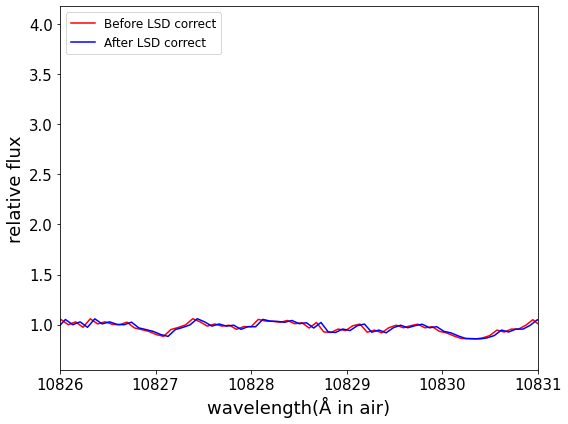

i= 1


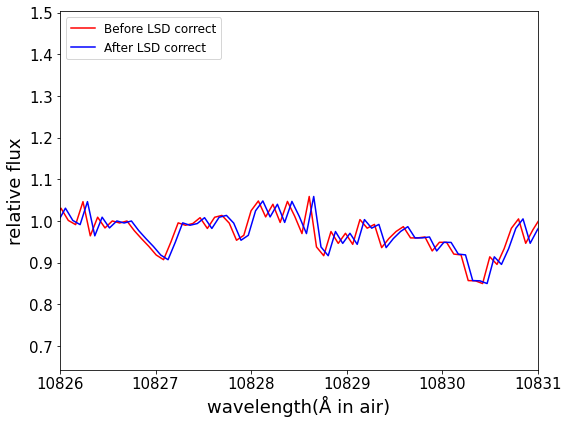

i= 2


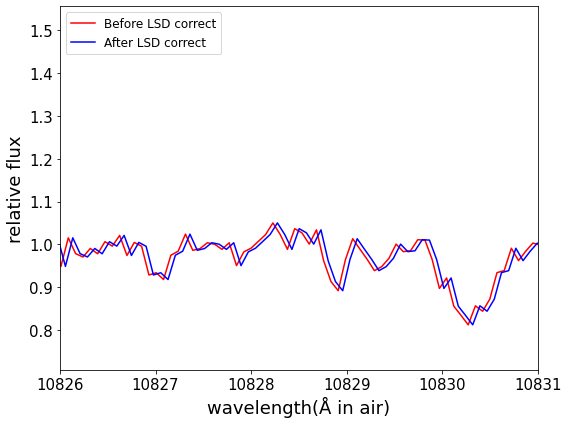

i= 3


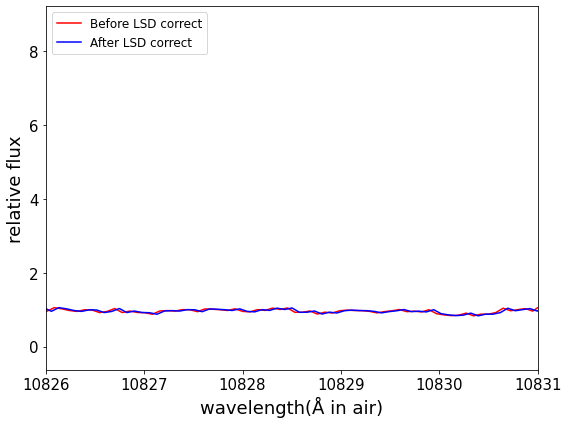

i= 4


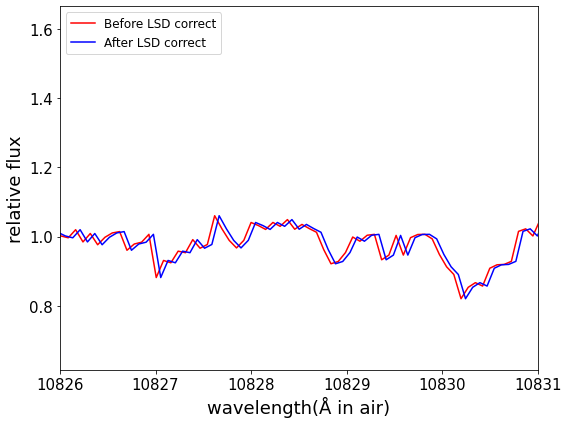

i= 5


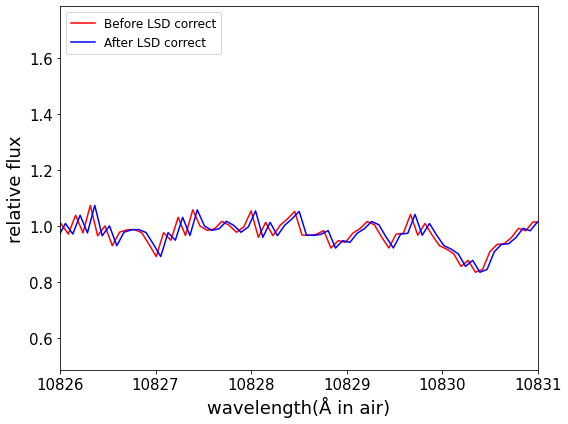

i= 6


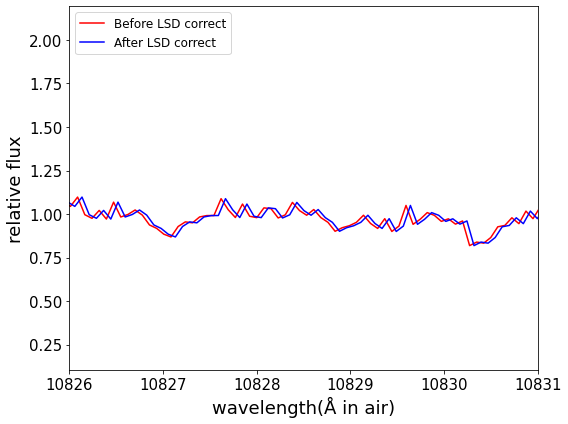

i= 7


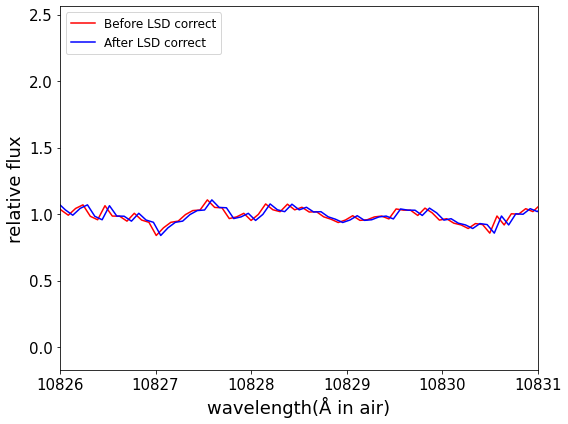

i= 8


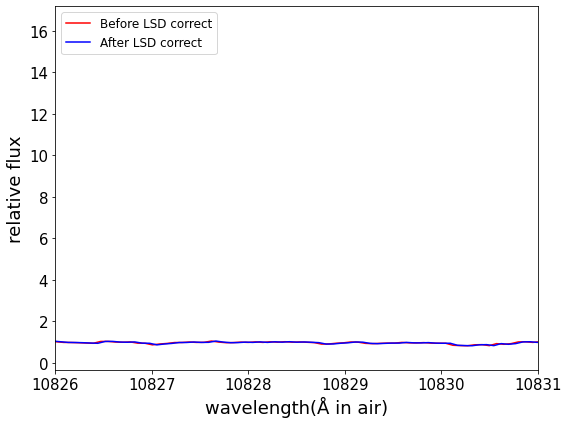

i= 9


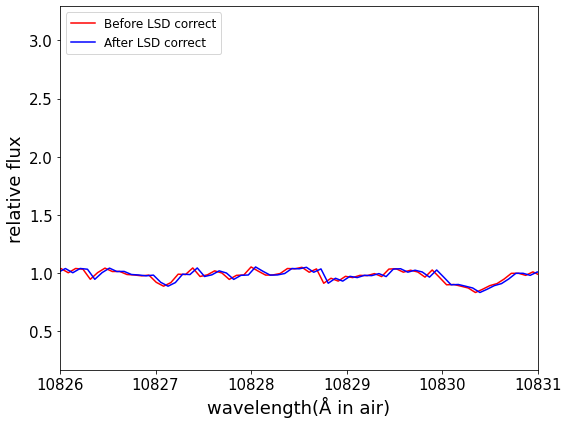

i= 10


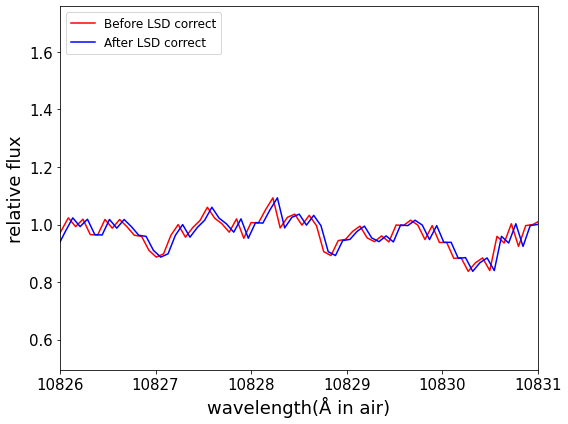

i= 11


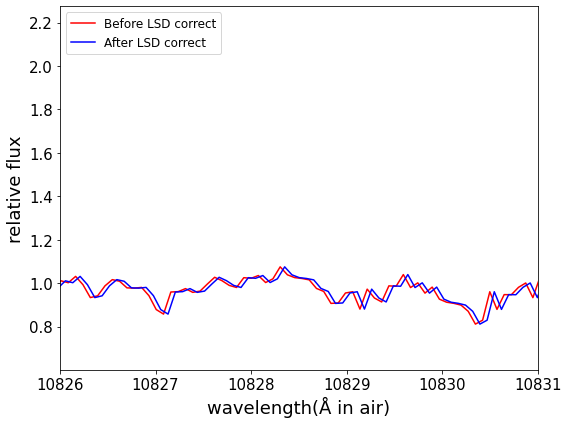

i= 12


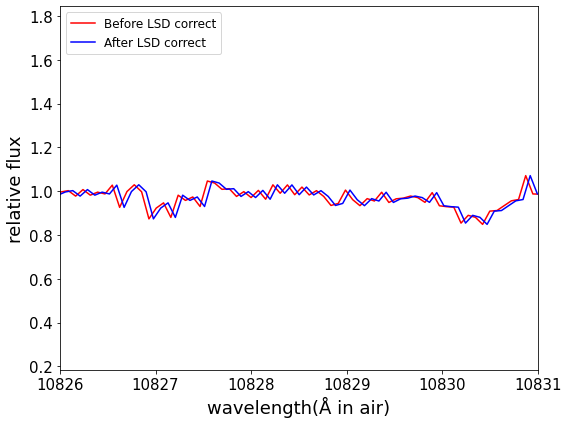

i= 13


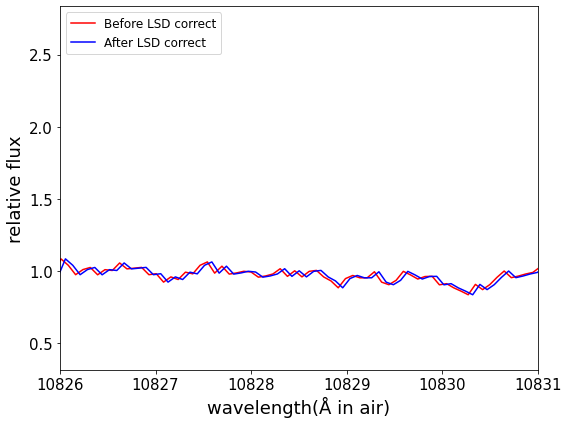

i= 14


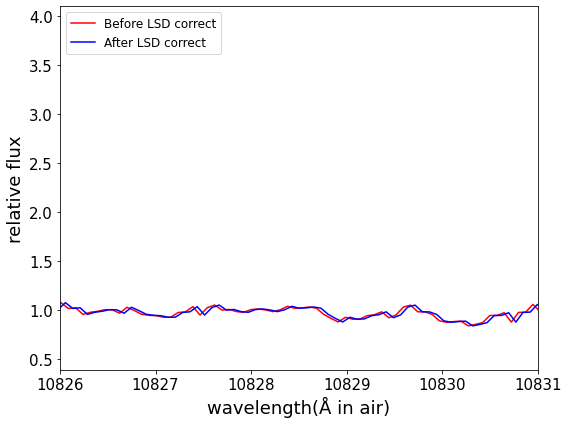

i= 15


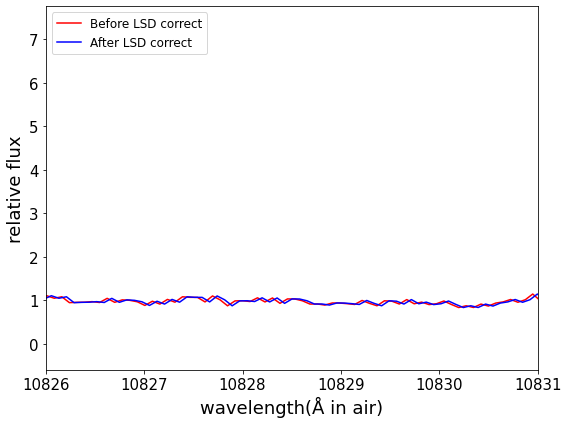

In [59]:
#RV補正した前後のプロット

#これはほんのちょっとだ//
for i in range(16):
    #wrv654 = 
    #LSDrv =
    norm_rv = np.loadtxt('./TOI654/Y_obs_peculliar/LSD_norm_rv_{0}.dat'.format(i), usecols=1 )
    
    fig = plt.figure(figsize = (8,6))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.plot(wrv654, norm_rv,  markersize=7, color="r", label="Before LSD correct" )
    ax1.set_xlabel("wavelength(Å in air)", size=18 )
    ax1.set_ylabel("relative flux", size=18)
    ax1.plot(LSDrv, norm_rv, color="b", label="After LSD correct")
    ax1.legend(loc="upper left", fontsize = 12)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(-0.2, 0.3)
    ax1.set_xlim(10826, 10831)


    plt.tick_params(labelsize=15)

    print('i=', i)

    plt.tight_layout()  # タイトルの被りを防ぐ
    plt.show()

## 6.地球大気補正をする


In [4]:
airmass = np.loadtxt("./TOI654/airmassdata.dat", unpack=True) 
airmass[7]

1.113

Baselineを直す.

In [17]:

for i in range(13):   #telluriclistは配列が違う. telluricfluxとは違う.

    LSD_wrv = np.loadtxt("./TOI654/Y_obs_peculliar/Y_obs_peculliar_{0}.dat".format(i), usecols=0, unpack=True)
    #F = np.loadtxt("./TOI654/Y_obs_peculliar/Y_obs_peculliar_{0}.dat".format(i),usecols=1, unpack=True)
    
    F = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_{0}.dat".format(i),usecols=1, unpack=True)
    
    #LSDの観測スペクトルY:
    ##T = 1 - F + 1    ##マイナスの値が出ないようにしておく. おそらくスペクトルエッジのノイズがあったため.
    
    print(np.isnan(F))
    print("i=", i)
    print('LSD_wrv =', LSD_wrv )
    print('LSD_wrv_shape =', np.shape(LSD_wrv) )
    
    print('T=', F)
    print('T_shape =', np.shape(F) )

    outputfile = './TOI654/T_peculliar_revised/T_peculliar_revised_{0}.dat'.format(i)
    
    d = np.column_stack((LSD_wrv , F))     #np.savetxt 複数配列の保存方法
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    

[False False False ... False False False]
i= 0
LSD_wrv = [10759.39911779 10759.49631186 10759.59348117 ... 10898.29677461
 10898.33802614 10898.37924824]
LSD_wrv_shape = (1987,)
T= [1.136556 0.935747 1.113261 ... 0.943651 1.107062 1.052768]
T_shape = (1987,)
[False False False ... False False False]
i= 1
LSD_wrv = [10759.39913054 10759.49632461 10759.59349391 ... 10898.29678751
 10898.33803905 10898.37926115]
LSD_wrv_shape = (1987,)
T= [1.462168 1.050133 1.31527  ... 1.049635 0.993452 0.985649]
T_shape = (1987,)
[False False False ... False False False]
i= 2
LSD_wrv = [10759.39464219 10759.49183622 10759.58900548 ... 10898.29224123
 10898.33349275 10898.37471483]
LSD_wrv_shape = (1987,)
T= [1.259784 1.029633 0.97407  ... 1.06858  0.952901 0.913385]
T_shape = (1987,)
[False False False ... False False False]
i= 3
LSD_wrv = [10759.38718595 10759.48437991 10759.5815491  ... 10898.28468873
 10898.32594021 10898.36716227]
LSD_wrv_shape = (1987,)
T= [0.985882 0.842501 0.878056 ... 1.019839 0

一旦今のTをプロット!

i= 0


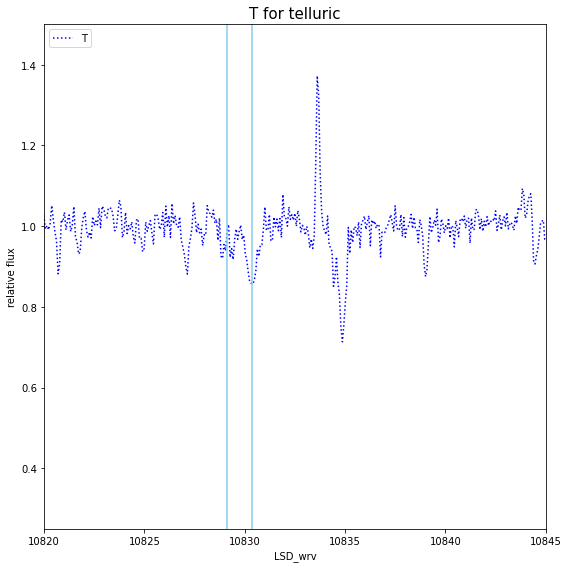

i= 1


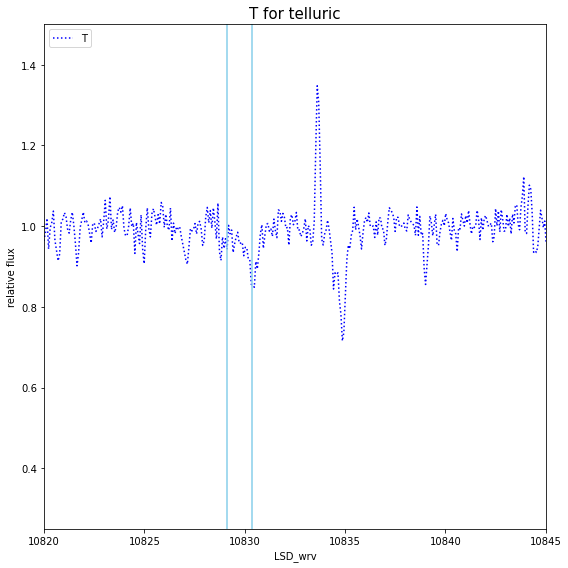

i= 2


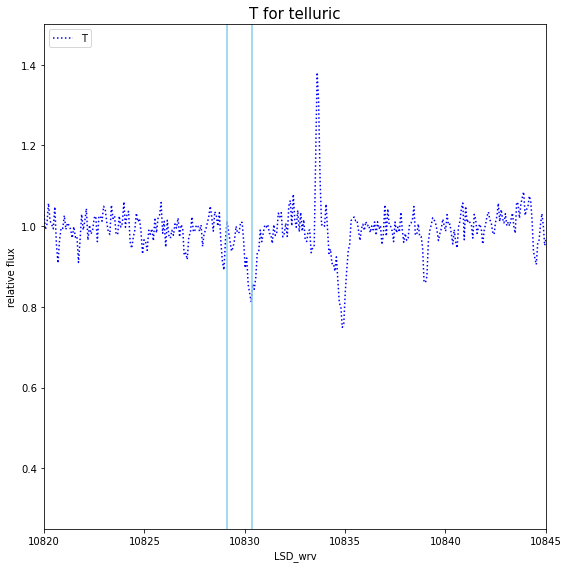

i= 3


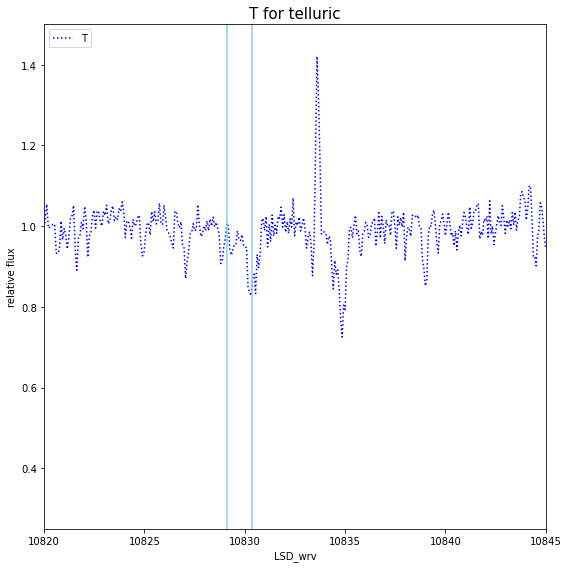

i= 4


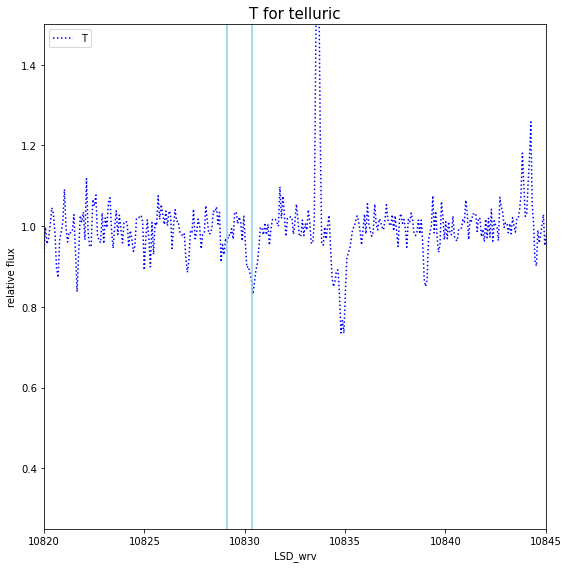

i= 5


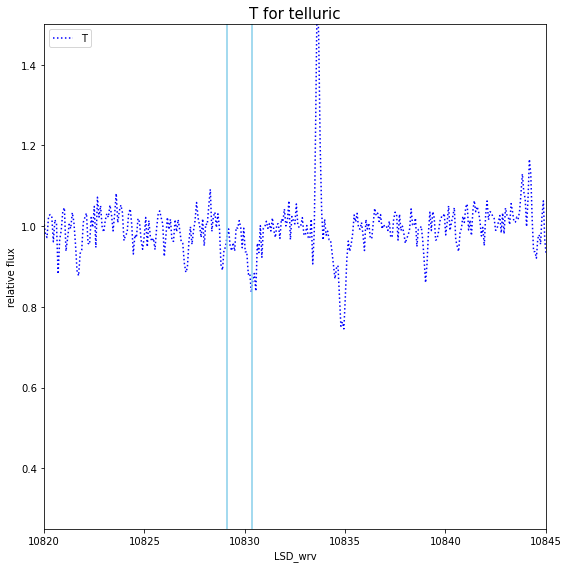

i= 6


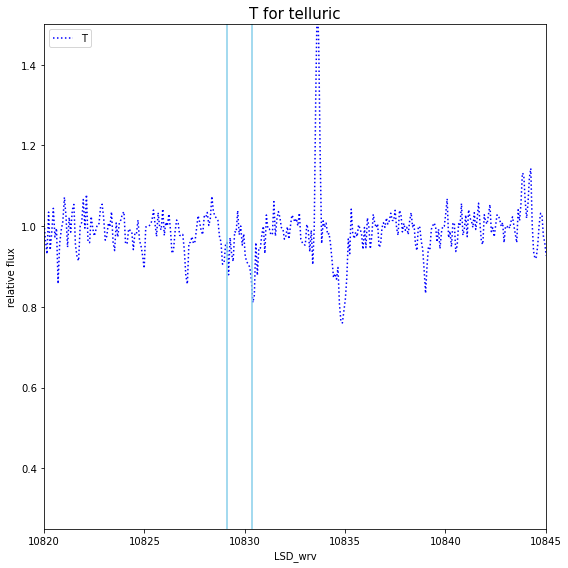

i= 7


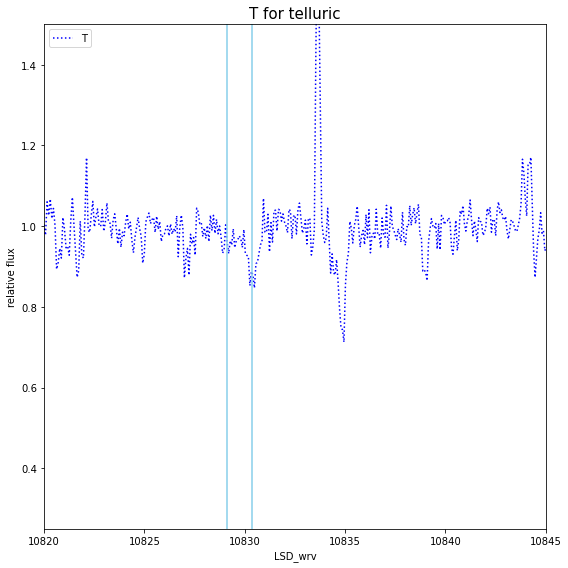

i= 8


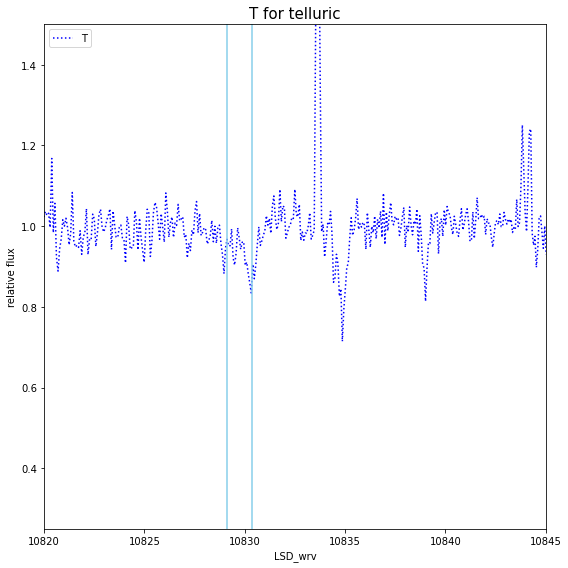

i= 9


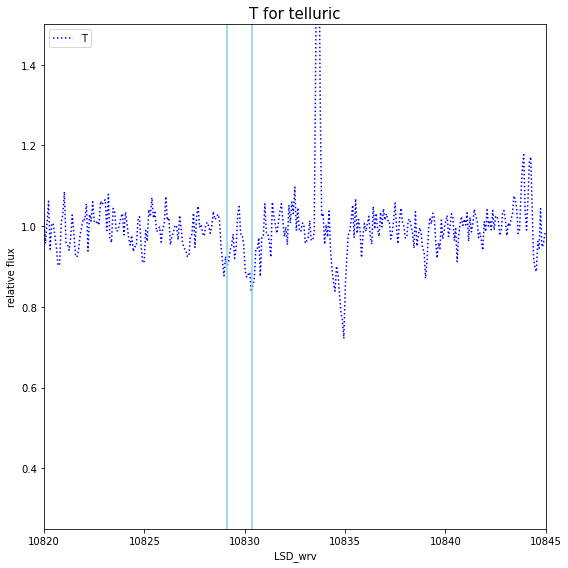

i= 10


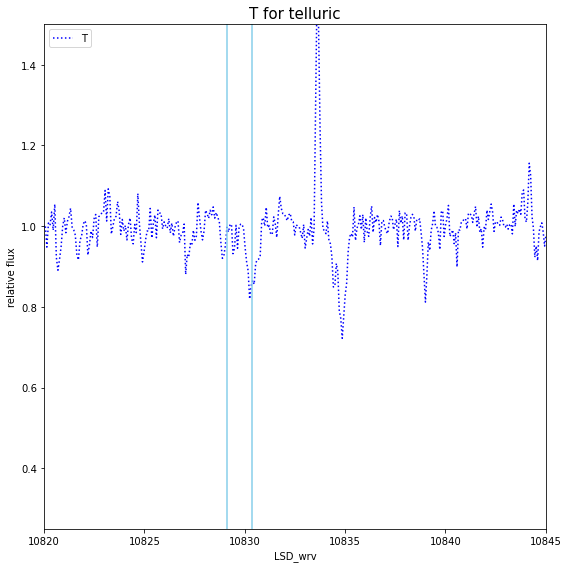

i= 11


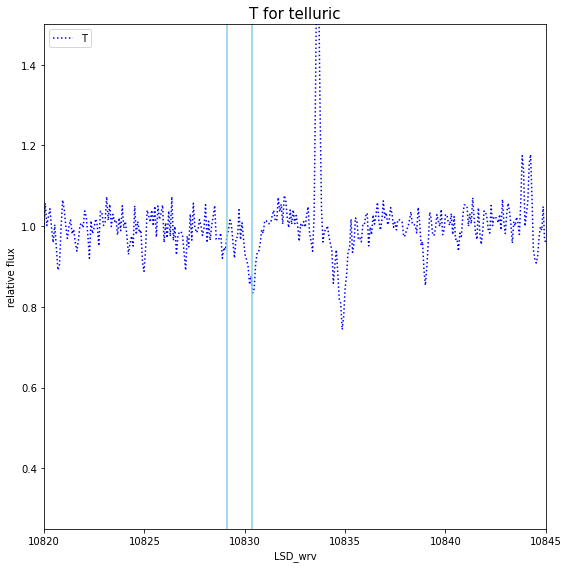

i= 12


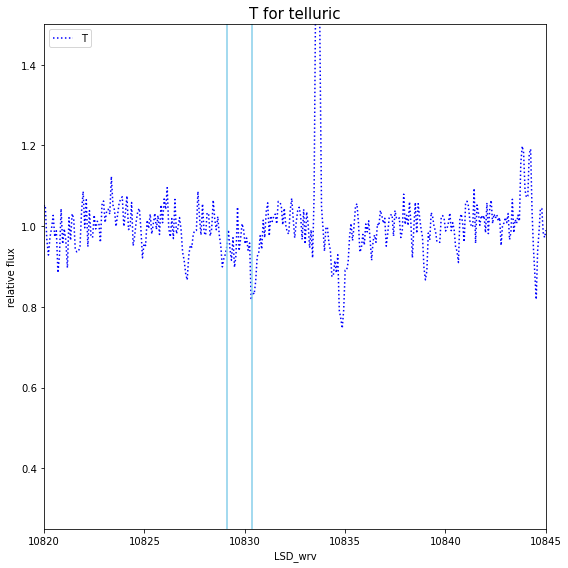

In [84]:
#fluxは、LSDの形式を行っていない時のやつを使ったかな!

for i in range(13):
    LSD_wrv = np.loadtxt("./TOI654/T_peculliar/T_peculliar_{0}.dat".format(i), usecols=0, unpack=True)
    T = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_{0}.dat".format(i), usecols=1, unpack=True)

    fig = plt.figure(figsize = (8,8))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.set_xlabel("LSD_wrv", size=10 )
    ax1.set_ylabel("relative flux", size=10)
    ax1.plot(LSD_wrv, T, ":", color="b", label="T")
    ax1.legend(loc="upper left", fontsize = 10)
    ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(-0.5, 0.5)
    ax1.set_xlim(10820, 10845)
    ax1.axvline(x = 10830.34, c='skyblue')
    ax1.axvline(x = 10829.09, c='skyblue')

    
    print("i=", i)
    plt.tick_params(labelsize=10)
    plt.title('T for telluric', size = 15)


    plt.tight_layout()  # タイトルの被りを防ぐ
    
    plt.show()

Tips:デカいピークはおそらくOH夜光


Tの対数logTをとる。

In [15]:
np.log(10)

2.302585092994046

In [29]:
import math

Xlist = []

for i in range(13):
   #T = np.loadtxt("./TOI654/Y_obs_peculliar/Y_obs_peculliar_{0}.dat".format(i), usecols=1, unpack=True)
   T = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_{0}.dat".format(i), usecols=1, unpack=True)
   #wavelength = np.loadtxt("./TOI654/Y_obs_peculliar/Y_obs_peculliar_{0}.dat".format(i), usecols=0, unpack=True)
   #flux = 
   #d = np.vstack((d,er))   #もう一回合併すると3列以上できる! 
   #d = d.T
   
   print(i, "th")
   print("T=", T)
   print("T_shape=", np.shape(T))
   
   X = np.log(T)    #absorptionとemissionの値どう処理するのか?
   
   print(np.isnan(X))
   
   Xlist.append(X)
   #print("X = ", X)
   print("Xlist", Xlist)
   print("Xlist_shape=", np.shape(Xlist))
   
Xlist = np.array(Xlist)
print(np.shape(Xlist))
   
outputfile = "./TOI654/linear_fitting/ln(T)_He_revised.dat"
np.savetxt(outputfile, Xlist, delimiter =" ", fmt ='% s')

   
   #print("Xlist shape =", np.shape(Xlist))
"""
   outputfile = "./TOI654/linear_fitting/ln(T).dat"
   
   d = np.vstack((wavelength,X))   
   #d = np.hstack(wavelength, Xlist)
   d = d.T
   np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')  
   #13本のスペクトルを合併する?
   
   """

0 th
T= [1.136556 0.935747 1.113261 ... 0.943651 1.107062 1.052768]
T_shape= (1987,)
[False False False ... False False False]
Xlist [array([ 0.12800264, -0.06641014,  0.10729355, ..., -0.05799888,
        0.10170966,  0.05142289])]
Xlist_shape= (1, 1987)
1 th
T= [1.462168 1.050133 1.31527  ... 1.049635 0.993452 0.985649]
T_shape= (1987,)
[False False False ... False False False]
Xlist [array([ 0.12800264, -0.06641014,  0.10729355, ..., -0.05799888,
        0.10170966,  0.05142289]), array([ 0.37992027,  0.04891682,  0.27404197, ...,  0.04844248,
       -0.00656953, -0.01445497])]
Xlist_shape= (2, 1987)
2 th
T= [1.259784 1.029633 0.97407  ... 1.06858  0.952901 0.913385]
T_shape= (1987,)
[False False False ... False False False]
Xlist [array([ 0.12800264, -0.06641014,  0.10729355, ..., -0.05799888,
        0.10170966,  0.05142289]), array([ 0.37992027,  0.04891682,  0.27404197, ...,  0.04844248,
       -0.00656953, -0.01445497]), array([ 0.23094028,  0.02920243, -0.02627211, ...,  0.066

'\n   outputfile = "./TOI654/linear_fitting/ln(T).dat"\n   \n   d = np.vstack((wavelength,X))   \n   #d = np.hstack(wavelength, Xlist)\n   d = d.T\n   np.savetxt(outputfile, d, delimiter =" ", fmt =\'% s\')  \n   #13本のスペクトルを合併する?\n   \n   '

各波長(例えば1987個)に対して、各時刻のlnTとairmassの線形関係から、Nk(λ)を求める

 Linear Models¶ の解説:
https://scikit-learn.org/stable/modules/linear_model.html

最小二乗法の誤差伝播。
Mean Square Error (MSE)
https://zenn.dev/deepblackinc/books/91a08a7956ddcb/viewer/6ab826


In [30]:
## YとZ逆だった!!

## except文法: 途中の何番目で問題が起きたの? を出力.

import numpy as np
#import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
lr = LinearRegression()

from sklearn.metrics import mean_squared_error


s = np.loadtxt("./TOI654/airmassdata_revised.dat",  unpack=True)  


s = s.reshape(-1, 1)
#s = s.T


#X = X.reshape(-1, 1)
print(np.shape(s))


#Nk = np.inf(len(V_wrv))

d = np.zeros([1987,2])
#d = []

mselist = []
#mselist = np.zeros([1987,1])

for j in range(1987):
    
    print('Xlistshape = ',np.shape(Xlist))
    print('sshape = ',np.shape(s))
    print('Xlist = ',Xlist)
    print('s = ',s)
    print(np.isnan(Xlist))
    Y = Xlist[:,j]
    #Y = Y.reshape(len(Y),1)
    print('Y = ', Y)
    print(np.isnan(Y))
    print('Yshape = ',Y.shape)
    Z = s[:,0] ### 要素を取り出す. 1行目、2行目...
    Z = Z.reshape(len(Z),1)
    print('Z = ', Z)
    print('Zshape = ', Z.shape)
    
    #ここではなく、傾き(Nk)の誤差を求めているよ!
    #mse = mean_squared_error(Y, lr.predict(Z))
    #print(mse)
    
    
    
    #Y, Zのshapeを合わせる!
    try:
        #print(j,"-th")
        #lr.fit(Y,Z)  
        lr.fit(Z,Y)
        print('coefficient = ', lr.coef_[0]) # 説明変数の係数を出力
        print('intercept = ', lr.intercept_) # 切片を出力
        print('coefficientsahpe=', lr.coef_[0].shape)
        
        
                    
    except:
        print(j,"-th")
        print("Y: ", Y)
        print("Z: ", Z)
        break
    
    #Nk, b を保存!
    
    mse = mean_squared_error(Y, lr.predict(Z))
    mselist.append(mse)
    print('mean_squared_error = ', mse)
    
    
    d[j,0] = lr.coef_[0]
    d[j,1] = lr.intercept_
    #mselist[j,0] = mse
    print('msesahpe=', np.shape(mselist))
    print("dshape=",d.shape)
    
    #d[j,2] = mselist
    
    
    #coef = np.vstack((lr.coef_[0], lr.intercept_))  #一回2列を合併 vertical
    #print(coef.shape)
    

    #outputfile = './TOI654/Y_LSD_photon/Y_LSD_photon_{0}.dat'.format(i)

outputfile = "./TOI654/linear_fitting/report_He_revised.dat"
d = d.T
c = d
print("dshape=",d.shape)
#print('msesahpe=', mse.shape)
c = np.vstack((d,mselist))   #もう一回合併すると3列以上できる! !!!
c = c.T

print("cshape=", c.shape)
#print("dshape=", np.shape(d))
#d = coef
#d = np.vstack((d,mselist))   #もう一回合併すると3列以上できる! !!!
#d = d.T
np.savetxt(outputfile, c, delimiter =" ", fmt ='% s')
 


(13, 1)
Xlistshape =  (13, 1987)
sshape =  (13, 1)
Xlist =  [[ 0.12800264 -0.06641014  0.10729355 ... -0.05799888  0.10170966
   0.05142289]
 [ 0.37992027  0.04891682  0.27404197 ...  0.04844248 -0.00656953
  -0.01445497]
 [ 0.23094028  0.02920243 -0.02627211 ...  0.06633066 -0.04824426
  -0.0905978 ]
 ...
 [-0.00510601  0.17679883  0.04654574 ... -0.02971    -0.00414156
   0.01512602]
 [ 0.39101386 -0.24607191  0.26049174 ... -0.05587958  0.07495626
  -0.0175155 ]
 [ 0.49950964  0.05873107  0.43787099 ...  0.09072423 -0.03090157
   0.00419618]]
s =  [[1.136]
 [1.126]
 [1.118]
 [1.112]
 [1.109]
 [1.108]
 [1.109]
 [1.113]
 [1.119]
 [1.142]
 [1.156]
 [1.195]
 [1.219]]
[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
Y =  [ 1.28002637e-01  3.79920266e-01  2.30940278e-01 -1.4218

Yを波長でプロットする: (Y, Zを逆にすると..)

ValueError: Expected 2D array, got 1D array instead:
array=[ 0.05142289 -0.01445497 -0.0905978   0.04190269 -0.2131301  -0.18328362
  0.11171578  0.02386984  0.00752065 -0.22241132  0.01512602 -0.0175155
  0.00419618].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

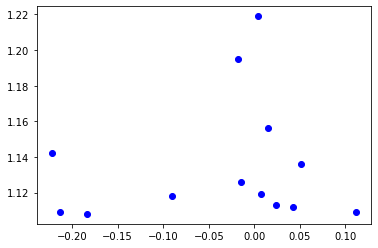

In [5]:
#一つの波長においた線形関係.

plt.scatter(Y, Z, color = 'blue')         # 説明変数と目的変数のデータ点の散布図をプロット
plt.plot(Y, lr.predict(Y), color = 'red') # 回帰直線をプロット

plt.title('Regression Line')               # 図のタイトル
plt.ylabel('lnT') # x軸のラベル
plt.xlabel('airmass')    # y軸のラベル
plt.grid()                                 # グリッド線を表示

plt.show()                                 # 図の表示

In [6]:
Y

array([ 0.05142289, -0.01445497, -0.0905978 ,  0.04190269, -0.2131301 ,
       -0.18328362,  0.11171578,  0.02386984,  0.00752065, -0.22241132,
        0.01512602, -0.0175155 ,  0.00419618])

In [7]:
lr.predict(Z)

array([-0.03716988, -0.04122128, -0.04446241, -0.04689325, -0.04810867,
       -0.04851381, -0.04810867, -0.04648811, -0.04405727, -0.03473904,
       -0.02906707, -0.01326659, -0.00354322])

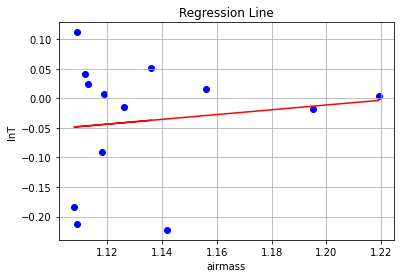

In [31]:
#一つの波長においた線形関係.

# Z:airmassの(13,1)配列
# Y: j番目の波長(pixel)が対応しているlnT (観測値)
# lr.predict(Z): (予測値)

plt.scatter(Z, Y, color = 'blue')         # 説明変数と目的変数のデータ点の散布図をプロット
plt.plot(Z, lr.predict(Z), color = 'red') # 回帰直線をプロット

plt.title('Regression Line')               # 図のタイトル
plt.xlabel('airmass') # x軸のラベル
plt.ylabel('lnT')    # y軸のラベル
plt.grid()                                 # グリッド線を表示

plt.show()                                 # 図の表示

Telluricmodelをつくる。

平方和
https://qiita.com/tiny/items/aefc87f7fec913864623

In [32]:

#for j in range(13) 
#p = np.sum(s[j] ** 2  for i in range(2) )


airmass = s[j]
p = np.sum(airmass ** 2  for i in range(13) ) * 13

print(p) 

q = (np.sum(airmass for i in range(13))) ** 2
print(q) 

IndexError: index 1986 is out of bounds for axis 0 with size 13

<平方和、和の平方のコード>

In [ ]:

#for j in range(13) 
#p = np.sum(s[j] ** 2  for i in range(2) )


airmass = s[j]
p =  sum(airmass ** 2  for j in range(1) ) 

print(p) 

q = (sum(airmass for j in range(1))) ** 2
print(q) 

[1.229881]
[1.229881]


In [27]:
for j in range(13):
    #airmass = s[j] 
    print("j =", j)
    print("airmass = ", s[j])
    
    p =  sum(s[j] ** 2  for j in range(13) ) *13
    print(p) 

    q = (sum(s[j] for j in range(13))) ** 2
    print(q) 
    
    
    


j = 0
airmass =  [1.136]
[218.109866]
[217.916644]
j = 1
airmass =  [1.126]
[218.109866]
[217.916644]
j = 2
airmass =  [1.118]
[218.109866]
[217.916644]
j = 3
airmass =  [1.112]
[218.109866]
[217.916644]
j = 4
airmass =  [1.109]
[218.109866]
[217.916644]
j = 5
airmass =  [1.108]
[218.109866]
[217.916644]
j = 6
airmass =  [1.109]
[218.109866]
[217.916644]
j = 7
airmass =  [1.113]
[218.109866]
[217.916644]
j = 8
airmass =  [1.119]
[218.109866]
[217.916644]
j = 9
airmass =  [1.142]
[218.109866]
[217.916644]
j = 10
airmass =  [1.156]
[218.109866]
[217.916644]
j = 11
airmass =  [1.195]
[218.109866]
[217.916644]
j = 12
airmass =  [1.219]
[218.109866]
[217.916644]


In [33]:
p =  sum(s[j] ** 2  for j in range(13) ) *13
print(p) 

q = (sum(s[j] for j in range(13))) ** 2
print(q)

[218.109866]
[217.916644]


Reference telluric spectraを作る計算は結構時間かかる ~ 4min?

In [36]:
from struct import unpack

Nk = np.loadtxt("./TOI654/linear_fitting/report_He_revised.dat", usecols=0, unpack=True)  #勾配
#b = np.loadtxt("./TOI654/linear_fitting/report_He_revised.dat", usecols=1, unpack=True)  
#bは使わなくてokっす!

#Nkの誤差はなんだろう?



#Nk_err = np.loadtxt("./TOI654/linear_fitting/report_He_revised.dat", usecols=2, unpack=True)



LSD_wrv = np.loadtxt("./TOI654/T_peculliar/T_peculliar_0.dat", usecols=0, unpack=True)

for j in range(13):
    airmass = s[j] 
    print("j =", j)
    print("airmass = ", airmass)
    
    telluric = []
    telluric_err = []
    
    
    #Obsのこと!
    T = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_{0}.dat".format(j), usecols=1, unpack=True)
    Obs = T
    
    normal_err_revised_nan = np.loadtxt("./TOI654/normal/normal_err_revised/normal_err_revised_nan_{0}.dat".format(j), usecols=1, unpack=True)
    Obs_err = normal_err_revised_nan
    
    #p = 13 * np.sum( airmass ** 2 )
    #q = (np.sum(airmass)) ** 2
    
    print("p =", p )
    print("q =", q)
    
    print("p-q =", p - q)
        
    sigma_y = (1/Obs) * Obs_err
    
    print("sigma_y = ", sigma_y)
        
    Nk_err = sigma_y * (  ( 13 / (p - q)  ) ** 0.5  )
    
    print("Nk_err_shape = ", np.shape(Nk_err))
    print("Nk_err =", Nk_err)
    
    for i in range(1987):

        #Nk = Nk.reshape(-1,1)
        #b = b.reshape(-1,1)
        #Nk = Nk[m,0]
        #b = b[m,0]
        e = Nk[i]
        #f = b[i]
        ##Nk_errも:Nk_err[i]に!!!
        
        #毎回のLinear Fittingは、13個のデータに対し、です。
        # Z:airmassの(13,1)配列
        # Y: j番目の波長(pixel)が対応しているlnT (観測値)
        
        #e_err = Nk_err[i] はいらない
        
        #今回 b の物理的意味ない.
        
        #さらに、 + 1 するとおかしいことになってしまう.
        #元々のやつのnanとかまた切っておくしかないな..
        
        
        
        print("i = ", i)
        
        print("Nkshape:", np.shape(e))
        print("Nk_err_shape", np.shape(Nk_err))
        print("Nk_err", Nk_err)
        #print("bshape:", np.shape(f))
        
        #求められた係数Nkとbで、telluricモデル波長の点を繋ぐ!のです!
        #ln(fluxmodel) = e * airmass + f   ,  f:切片はいらない情報.
        #なんよ!
        
        fluxmodel = np.exp(e * airmass)
        
        #試行錯誤? 結局元々の誤差伝播定義に戻らないと!
        #fluxmodel_err = np.exp(e_err * airmass)
        #fluxmodel_err = e_err * airmass
        #fluxmodel_err = np.exp(e * airmass) * (np.exp(e_err * airmass) - 1)
        
        fluxmodel_err = airmass * np.exp(e * airmass) * Nk_err[i]   ######!!!!!!
        
        print("fluxmodelshape:", np.shape(fluxmodel))
        print("fluxmodel=", fluxmodel)
        
        print("fluxmodel_errshape:", np.shape(fluxmodel_err))
        print("fluxmodel_err=", fluxmodel_err)
        
        telluric.append(fluxmodel)
        telluric_err.append(fluxmodel_err)
        
        print("telluricshape", np.shape(telluric))
        print("telluric_errshape", np.shape(telluric_err))
        
    outputfile = './TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat'.format(j)  # jだよ!!!
    
    
    
    telluricmodel = np.column_stack((LSD_wrv , telluric))     #np.savetxt 複数配列の保存方法
    d = telluricmodel 
    print(np.shape(d))
    d = np.column_stack((d , telluric_err))
    
    #column_stack は、 vstackよりもだいぶ楽!!
    
        #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
        
    
    
    


#<ipython-input-4-3b9105325853>:40: RuntimeWarning: divide by zero encountered in double_scalars
#  Nk_err = sigma_y * (  ( 13 / (p - q)  ) ** 0.5  )
    

j = 0
airmass =  [1.136]
p = [218.109866]
q = [217.916644]
p-q = [0.193222]
sigma_y =  [0.22976087 0.24068944 0.15110081 ... 0.08658832 0.08005752 0.07306198]
Nk_err_shape =  (1987,)
Nk_err = [1.88460117 1.9742422  1.23939625 ... 0.710236   0.6566675  0.59928696]
i =  0
Nkshape: ()
Nk_err_shape (1987,)
Nk_err [1.88460117 1.9742422  1.23939625 ... 0.710236   0.6566675  0.59928696]
fluxmodelshape: (1,)
fluxmodel= [11.98735276]
fluxmodel_errshape: (1,)
fluxmodel_err= [25.66380664]
telluricshape (1, 1)
telluric_errshape (1, 1)
i =  1
Nkshape: ()
Nk_err_shape (1987,)
Nk_err [1.88460117 1.9742422  1.23939625 ... 0.710236   0.6566675  0.59928696]
fluxmodelshape: (1,)
fluxmodel= [0.69160182]
fluxmodel_errshape: (1,)
fluxmodel_err= [1.55108246]
telluricshape (2, 1)
telluric_errshape (2, 1)
i =  2
Nkshape: ()
Nk_err_shape (1987,)
Nk_err [1.88460117 1.9742422  1.23939625 ... 0.710236   0.6566675  0.59928696]
fluxmodelshape: (1,)
fluxmodel= [43.03752694]
fluxmodel_errshape: (1,)
fluxmodel_err= [60

Nkと波長でプロットしてみる。


In [40]:
Nk = np.loadtxt("./TOI654/linear_fitting/report_He_revised.dat", usecols=0, unpack=True)
LSD_wrv_test = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_0.dat", usecols=0, unpack=True)

T = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_8.dat".format(j), usecols=1, unpack=True)
Obs = T

normal_err_revised_nan = np.loadtxt("./TOI654/normal/normal_err_revised/normal_err_revised_nan_8.dat".format(j), usecols=1, unpack=True)
Obs_err = normal_err_revised_nan

#p = 13 * np.sum( airmass ** 2 )
#q = (np.sum(airmass)) ** 2

print("p =", p )
print("q =", q)

print("p-q =", p - q)
    
sigma_y = (1/Obs) * Obs_err

print("sigma_y = ", sigma_y)
    
Nk_err = sigma_y * (  ( 13 / (p - q)  ) ** 0.5  )

print("Nk_err_shape = ", np.shape(Nk_err))
print("Nk_err =", Nk_err)

p = [218.109866]
q = [217.916644]
p-q = [0.193222]
sigma_y =  [0.18943326 0.24411312 0.14366316 ... 0.09917475 0.0795515  0.08743615]
Nk_err_shape =  (1987,)
Nk_err = [1.55381615 2.00232472 1.1783893  ... 0.81347553 0.65251691 0.71719028]


i =  1986


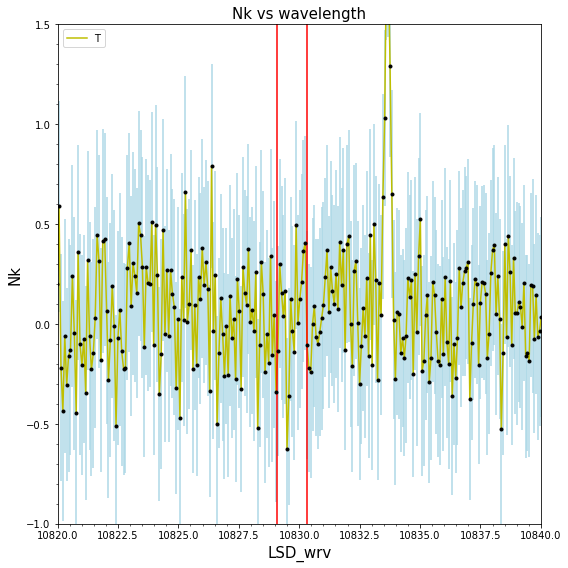

In [42]:



fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)

ax1.set_xlabel("LSD_wrv", size=15 )
ax1.set_ylabel("Nk", size=15)
#ax1.plot(LSD_wrv_test, Nk, color="y", label="T")
ax1.plot(LSD_wrv, Nk, color="y", label="T")
ax1.legend(loc="upper left", fontsize = 10)
#ax1.set_ylim(0.25, 1.5)
ax1.set_ylim(-1, 1.5)
#ax1.set_xlim(10820, 10845)
#ax1.set_ylim(0, 4)
ax1.set_xlim(10820, 10840)

ax1.axvline(x = 10830.34, c='r')
ax1.axvline(x = 10829.09, c='r')

print("i = ", i)

plt.tick_params(labelsize=10)
plt.title('Nk vs wavelength', size = 15)


plt.errorbar(x=LSD_wrv, y=Nk, yerr=Nk_err, marker='.', ls='none', color='k', ecolor='lightblue')
plt.minorticks_on()

plt.tight_layout()  # タイトルの被りを防ぐ


###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()

i =  1986


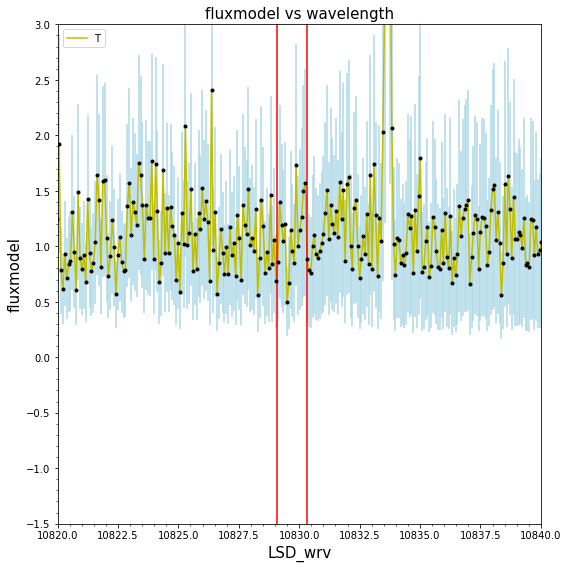

In [52]:


fluxmodel = np.loadtxt('./TOI654/telluricmodel_revised/telluricmodel_revised_7.dat', usecols=1, unpack=True)
fluxmodel_err = np.loadtxt('./TOI654/telluricmodel_revised/telluricmodel_revised_7.dat', usecols=2, unpack=True)

fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)

ax1.set_xlabel("LSD_wrv", size=15 )
ax1.set_ylabel("fluxmodel", size=15)
#ax1.plot(LSD_wrv_test, fluxmodel, color="y", label="T")
ax1.plot(LSD_wrv, fluxmodel, color="y", label="T")
ax1.legend(loc="upper left", fontsize = 10)
#ax1.set_ylim(0.25, 1.5)
ax1.set_ylim(-1.5, 3)
#ax1.set_xlim(10820, 10845)
#ax1.set_ylim(0, 4)
ax1.set_xlim(10820, 10840)

ax1.axvline(x = 10830.34, c='r')
ax1.axvline(x = 10829.09, c='r')

print("i = ", i)

plt.tick_params(labelsize=10)
plt.title('fluxmodel vs wavelength', size = 15)


pl.errorbar(x=LSD_wrv, y=fluxmodel, yerr=fluxmodel_err, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()

plt.tight_layout()  # タイトルの被りを防ぐ


###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()

Telluricmodelをプロットする。


LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  0


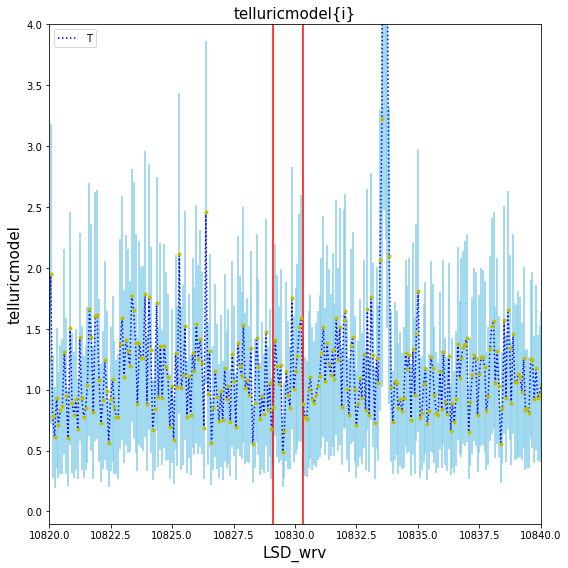

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  1


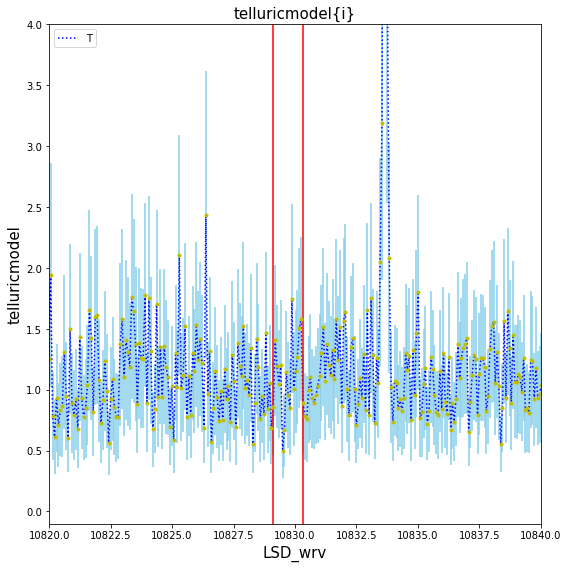

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  2


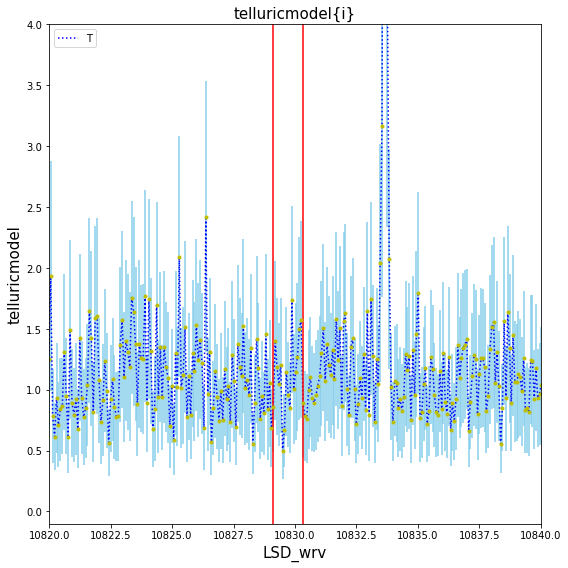

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  3


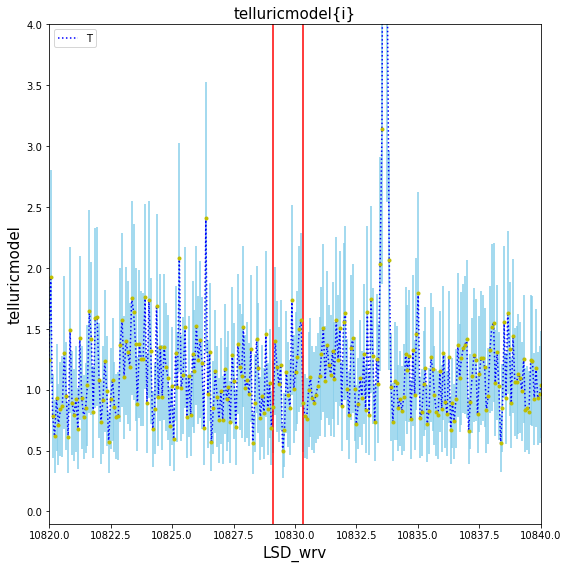

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  4


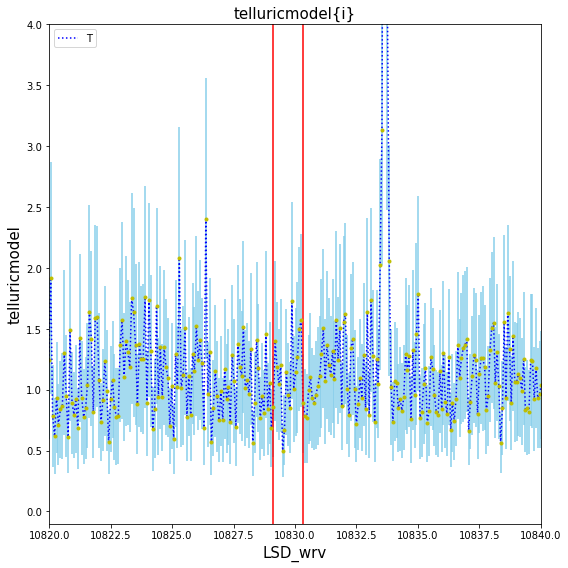

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  5


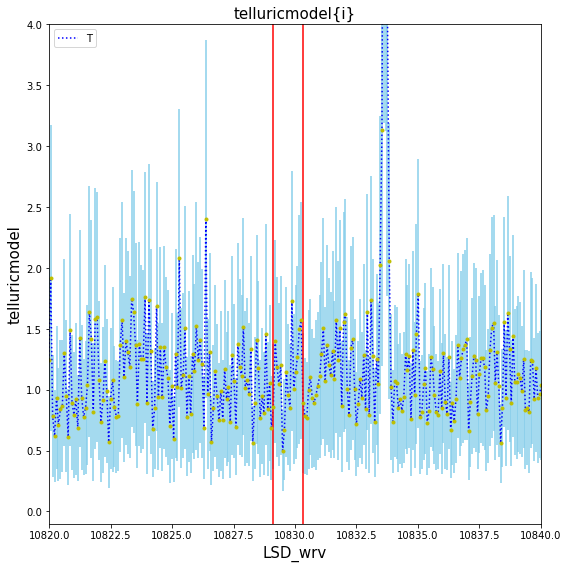

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  6


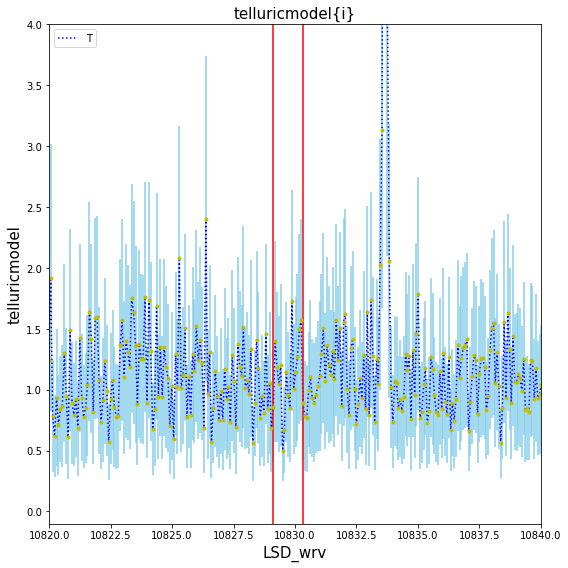

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  7


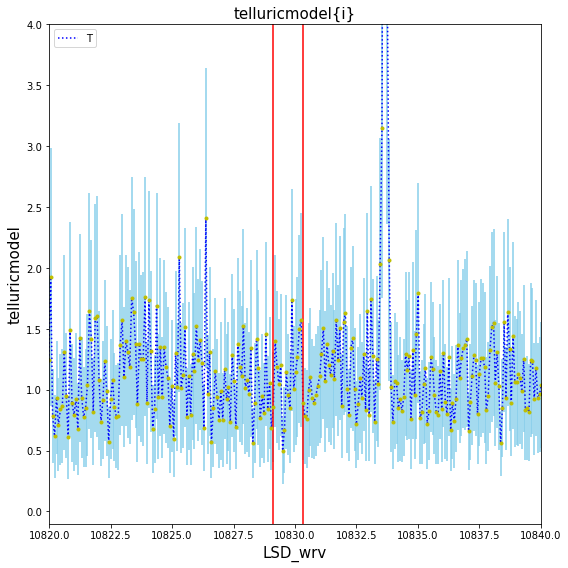

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  8


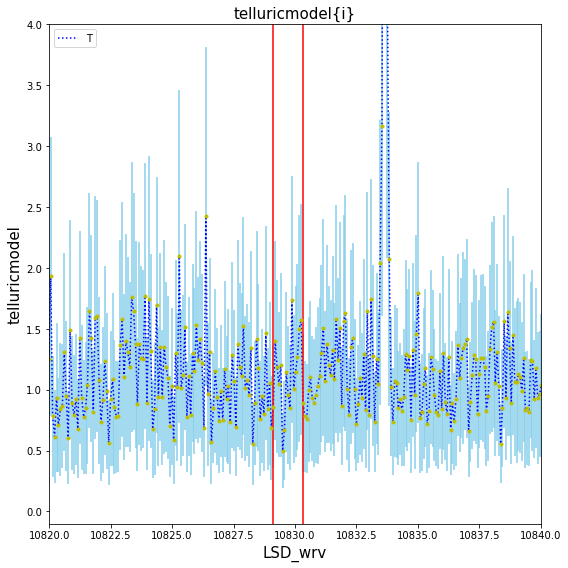

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  9


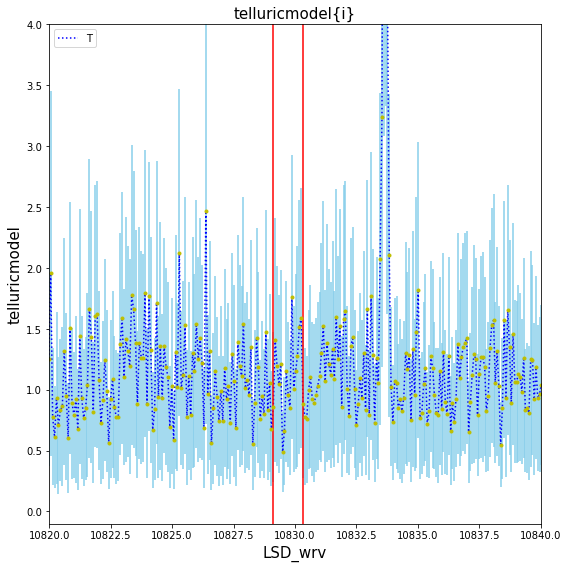

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  10


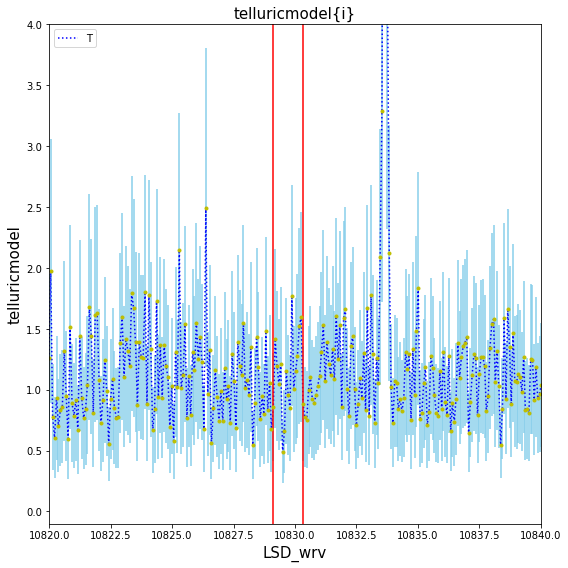

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  11


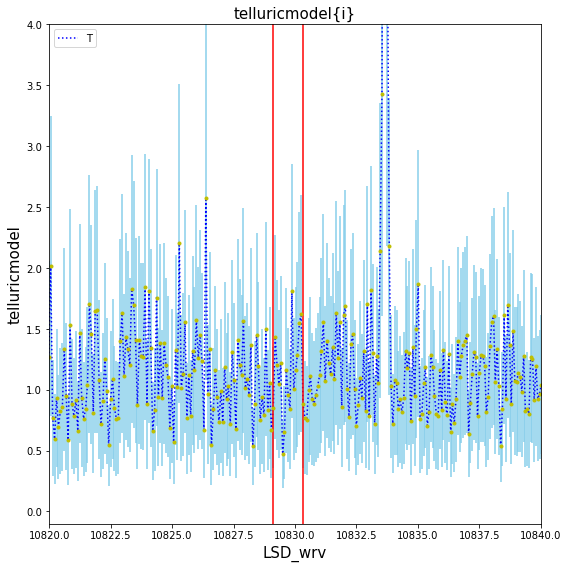

LSD_wrvshape= (1987,)
telluricshape= (1987,)
telluric_errshape= (1987,)
i =  12


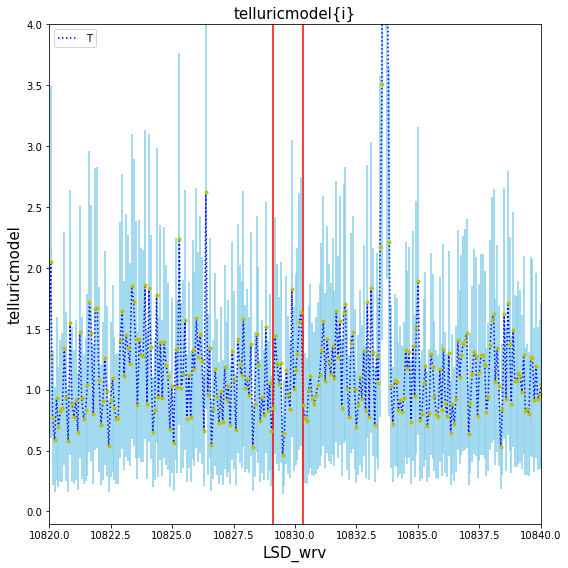

In [43]:
#baseline0、上向きにした後のプロット

#エラーバー入れたい!

import matplotlib.pyplot as pl


'''
ax1 = pl.subplot(211)
pl.errorbar(x=wave_mask, y=ts_mask, yerr=ts_err_mask, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()
xmin=10820
xmax=10840
#pl.hlines(stdp, xmin, xmax,colors='blue', linestyle='dashed', linewidth=3)
pl.hlines(stdm, xmin, xmax,colors='blue', linestyle='dashed', linewidth=3)
'''

for i in range(13):
    LSD_wrv = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=0, unpack=True)
    telluric = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=1, unpack=True)
    #改めて作ったtelluricmodel
    telluric_err = np.genfromtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=2, unpack=True)
    
    
    
    print("LSD_wrvshape=" ,np.shape(LSD_wrv))
    print("telluricshape=" ,np.shape(telluric))
    print("telluric_errshape=" ,np.shape(telluric_err))
    
    fig = plt.figure(figsize = (8,8))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    """ """
    ax1.set_xlabel("LSD_wrv", size=15 )
    ax1.set_ylabel("telluricmodel", size=15)
    ax1.plot(LSD_wrv, telluric, ":", color="b", label="T")
    #ax1.plot(LSD_wrv, telluric_err, ":", color="g", label="T_err")
    ax1.legend(loc="upper left", fontsize = 10)
    #ax1.set_ylim(0.25, 1.5)
    #ax1.set_ylim(-0.5, 0.5)
    #ax1.set_xlim(10820, 10845)
    ax1.set_ylim(-0.1, 4)
    #ax1.set_ylim(-0.02, 0.02)
    ax1.set_xlim(10820, 10840)
    
    
    
    ax1.axvline(x = 10830.34, c='r')
    ax1.axvline(x = 10829.09, c='r')
    

    
    pl.errorbar(x=LSD_wrv, y=telluric, yerr=telluric_err, marker='.', ls='none', color='y', ecolor='skyblue')
    
    print("i = ", i)

    plt.tick_params(labelsize=10)
    plt.title('telluricmodel{i}', size = 15)


    plt.tight_layout()  # タイトルの被りを防ぐ
    
    
    ###これ入れるとそれぞれの図の前にばんご振ってくれっる!
    plt.show()

inトランジットのtelluric平均をつくる。

In [45]:
s_in = np.loadtxt("./TOI654/airmassdata_intransit.dat",  unpack=True)  

print(s_in)
print(np.mean(s_in))

[1.108 1.109 1.113 1.119]
1.11225


In [24]:


#out of transitでtelluricをつくる
#

for i in range(7):
    tellu_in =  np.loadtxt("./TOI654/telluricmodel/telluricmodel_{0}.dat".format(i), usecols=1, unpack=True)
    
    print(np.shape(tellu_in))
    
    tellu_in_combine += tellu_in
    print(np.shape(tellu_in_combine))

"""
tellu_in_combine = np.zeros([1987])

#i = 5, 6, 7, 8
for i in range(5,9):
    tellu_in =  np.loadtxt("./TOI654/telluricmodel/telluricmodel_{0}.dat".format(i), usecols=1, unpack=True)
    
    print(np.shape(tellu_in))
    
    tellu_in_combine += tellu_in
    print(np.shape(tellu_in_combine))
    

tellu_in_mean = tellu_in_combine / 4
print(tellu_in_mean)

"""


(1987,)
(1987,)
(1987,)
(1987,)
(1987,)
(1987,)
(1987,)
(1987,)
[1.16029489 1.12514179 1.17870034 ... 1.08091828 1.22447263 1.17293696]


i =  8


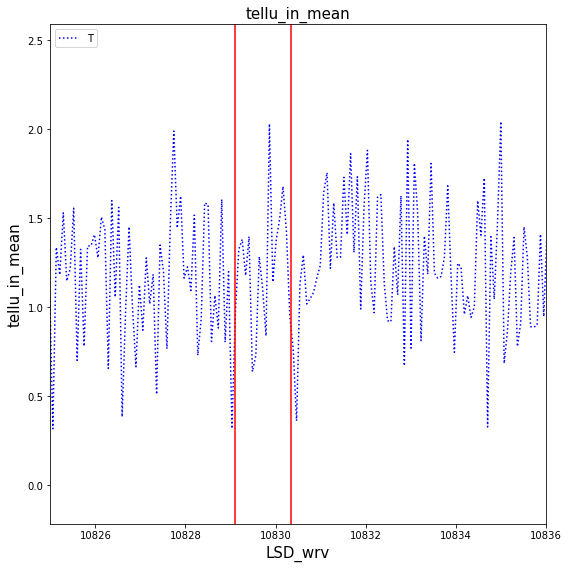

In [25]:
"""
fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

ax1.set_xlabel("LSD_wrv", size=15 )
ax1.set_ylabel("tellu_in_mean", size=15)
ax1.plot(LSD_wrv, tellu_in_mean, ":", color="b", label="T")
ax1.legend(loc="upper left", fontsize = 10)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(-0.5, 0.5)
ax1.set_xlim(10825, 10836)

ax1.axvline(x = 10830.34, c='r')
ax1.axvline(x = 10829.09, c='r')

print("i = ", i)

plt.tick_params(labelsize=10)
plt.title('tellu_in_mean', size = 15)


plt.tight_layout()  # タイトルの被りを防ぐ
"""

Telluric補正後スペクトルを求める:

In [30]:
#先までtelluric作っていたんだけど、今は観測スペクトルに戻ることに注意!

'''
print("secz_ref = " , np.mean(s_in))

for i in range(13):
    Obs = np.loadtxt("./TOI654/T_peculliar_revised/T_peculliar_revised_{0}.dat".format(i), usecols=1, unpack=True)
    secz = np.loadtxt("./TOI654/airmassdata_revised.dat",  unpack=True) #s と一緒
    secz_ref = np.mean(s_in)
    
    #各時刻の観測スペクトルを、基準エアマスにするの!
    tellu =  np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=1, unpack=True)
    
    print("i =", i)
    print("secz[i] = " ,secz[i])
    F_ref = Obs / ( tellu ** (secz[i] - secz_ref) )
    
    print("F_ref = ", F_ref)
    
    
    outputfile = './TOI654/F_ref/F_ref_{0}.dat'.format(i)  # jだよ!!!
    
    d = np.column_stack((LSD_wrv , F_ref))     #np.savetxt 複数配列の保存方法
    
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
''' 
    

secz_ref =  1.11225
i = 0
secz[i] =  1.136
F_ref =  [1.07144815 0.94397797 1.01810629 ... 0.95233594 1.09504134 1.04132318]
i = 1
secz[i] =  1.126
F_ref =  [1.41349865 1.05542384 1.24953168 ... 1.05516779 0.98724743 0.97948578]
i = 2
secz[i] =  1.118
F_ref =  [1.24220053 1.03178377 0.95355205 ... 1.07091514 0.95042543 0.91100923]
i = 3
secz[i] =  1.112
F_ref =  [0.98648144 0.84242498 0.87886475 ... 1.01974273 0.84001649 1.04291046]
i = 4
secz[i] =  1.109
F_ref =  [1.24797219 1.08981124 0.79065729 ... 1.05723029 1.05375976 0.8092318 ]
i = 5
secz[i] =  1.108
F_ref =  [1.08187907 0.80816674 1.02165686 ... 1.1322311  0.99484689 0.83412183]
i = 6
secz[i] =  1.109
F_ref =  [0.86100461 0.77043811 0.95515205 ... 1.11358827 0.99099428 1.11982901]
i = 7
secz[i] =  1.113
F_ref =  [1.70624896 1.45951742 1.0510614  ... 1.04930739 0.98051574 1.0238107 ]
i = 8
secz[i] =  1.119
F_ref =  [1.75776627 1.18415774 1.55387227 ... 0.85659219 1.04161947 1.00447048]
i = 9
secz[i] =  1.142
F_ref =  [0.92849629 

Telurric補正式の誤差伝播:

    #pythonでnanを消したい.

    # nanを含める行を除去するやつを使うのに、axis=1あるはdimension 0 を超えるので、(2048, )のような平坦なデータではなく、(2048, 1)にしておくべき!
    #.reshape(-1,1)で行う!

In [49]:
#pythonでnanを消したい.

import math

import numpy as np
import pandas as pd

for i in range(13):   #telluriclistは配列が違う. telluricfluxとは違う.

    normal_err_revised = np.loadtxt("./TOI654/normal/normal_err_revised/normal_err_revised_{0}.dat".format(i), unpack=True)

    #np.atleast_1d(normal_err_revised)
    normal_err_revised = normal_err_revised.reshape(-1,1)
    print(np.shape(normal_err_revised))
    print(type(normal_err_revised))
    #data typeの問題か?
    
    print(~np.isnan(normal_err_revised))
    print(normal_err_revised[~np.isnan(normal_err_revised).any(axis=1), :])
    #print(normal_err_revised[~np.isnan(normal_err_revised).any(axis=0)])


    print("i=", i)
    
    normal_err_revised_nan = normal_err_revised[~np.isnan(normal_err_revised).any(axis=1), :]
    # nanを含める行を除去するやつを使うのに、axis=1あるはdimension 0 を超えるので、(2048, )のような平坦なデータではなく、(2048, 1)にしておくべき!
    #.reshape(-1,1)で行う!
    
    np.savetxt('./TOI654/normal/normal_err_revised/normal_err_revised_nan_{0}.dat'.format(i), normal_err_revised_nan, delimiter =" ", fmt ='% s')
    
    

(2048, 1)
<class 'numpy.ndarray'>
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[0.00673662]
 [0.00662696]
 [0.00774958]
 ...
 [0.02654092]
 [0.02813426]
 [0.02575919]]
i= 0
(2048, 1)
<class 'numpy.ndarray'>
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[0.00810208]
 [0.00742162]
 [0.00892356]
 ...
 [0.03002209]
 [0.02765723]
 [0.02605304]]
i= 1
(2048, 1)
<class 'numpy.ndarray'>
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[0.00719209]
 [0.00704772]
 [0.00731497]
 ...
 [0.02915574]
 [0.0258382 ]
 [0.02382386]]
i= 2
(2048, 1)
<class 'numpy.ndarray'>
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[0.00664596]
 [0.00666503]
 [0.00727153]
 ...
 [0.0296482 ]
 [0.02500691]
 [0.02718516]]
i= 3
(2048, 1)
<class 'numpy.ndarray'>
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[0.00985022]
 [0.01003768]
 [0.00901642]
 ...
 [0.04004047]
 [0.03807705]
 [0.0304981 ]]
i= 4
(2048, 1)
<class 'numpy.ndarray'>
[[False]
 [False]
 [F

In [48]:
#Telluric補正後のFluxと誤差を共に作るコード#


# 誤差(error) = Obs_error / tellu_error ** (secz[i] - secz_ref)
#     a / ( b ** c ).  secz (つまりc) は誤差入っていないので、ここの誤差伝播は:
#     a / d 

for i in range(13): 
    
    #波長とフラックス
    LSD_wrv = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=0, unpack=True)
    T = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_{0}.dat".format(i), usecols=1, unpack=True)
    Obs = T
    tellu = np.loadtxt('./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat'.format(i), usecols=1, unpack=True)

    #誤差
    Obs_err = np.loadtxt("./TOI654/normal/normal_err_revised/normal_err_revised_nan_{0}.dat".format(i), usecols=1, unpack=True)
    tellu_err = np.loadtxt('./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat'.format(i), usecols=2, unpack=True)
    
    #Airmass
    secz = np.loadtxt("./TOI654/airmassdata_revised.dat",  unpack=True) #s と一緒
    secz_ref = np.mean(s_in)
    
    #f: M1/M2とすると.
    M2_err =   tellu_err * (secz[i] - secz_ref) * (tellu ** (secz[i] - secz_ref - 1))      
    
    #Telluric補正後のフラックス:
    F_ref = Obs / ( tellu ** (secz[i] - secz_ref) )
    #F_ref_err =( (  (   1 / (tellu ** (secz[i] - secz_ref))  )* Obs_err) ** 2 + ( (  (Obs/(tellu ** (secz[i] - secz_ref)) ** 2 )  ) * (tellu_err ** (secz[i] - secz_ref)) ) ** 2   )  ** 0.5    
    #F_ref_err =( (  (   1 / (tellu ** (secz[i] - secz_ref))  )* Obs_err) ** 2 + ( (  (Obs/(tellu ** (secz[i] - secz_ref)) ** 2 )  ) * (tellu_err ) ) ** 2   )  ** 0.5    
    #tellu_errではないんだ!
    
    F_ref_err =( (  (   1 / (tellu ** (secz[i] - secz_ref))  )* Obs_err) ** 2 + ( (  (Obs/(tellu ** (secz[i] - secz_ref)) ** 2 )  ) * (M2_err ) ) ** 2   )  ** 0.5
    
    #!!!!!!!!
    
    
    
    
    print("i =", i)
    print("secz[i] = " ,secz[i])
    print("secz_ref = " ,secz_ref)
    print("secz[i] - secz_ref", secz[i] - secz_ref)
        
    print("F_ref = ", F_ref)
    print("F_ref_err = ", F_ref_err)
    
    print("M2_err=", M2_err)
    
    outputfile = './TOI654/F_ref/F_ref_err_{0}.dat'.format(i)  # jだよ!!!
    
    d = np.column_stack((LSD_wrv, F_ref))
    
    d = np.column_stack((d , F_ref_err))     #np.savetxt 複数配列の保存方法
    
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')



i = 0
secz[i] =  1.136
secz_ref =  1.11225
secz[i] - secz_ref 0.023749999999999938
F_ref =  [1.07144815 0.94397797 1.01810629 ... 0.95233594 1.09504134 1.04132318]
F_ref_err =  [0.25213301 0.23270268 0.1575587  ... 0.08445628 0.08978734 0.07792189]
M2_err= [0.05393629 0.05280061 0.03656419 ... 0.01898742 0.01791137 0.01634647]
i = 1
secz[i] =  1.126
secz_ref =  1.11225
secz[i] - secz_ref 0.013749999999999929
F_ref =  [1.41349865 1.05542384 1.24953168 ... 1.05516779 0.98724743 0.97948578]
F_ref_err =  [0.19919212 0.17312652 0.16853136 ... 0.05986345 0.06730877 0.06711032]
M2_err= [0.01836492 0.02056196 0.01788593 ... 0.00710996 0.00864325 0.00868612]
i = 2
secz[i] =  1.118
secz_ref =  1.11225
secz[i] - secz_ref 0.005750000000000144
F_ref =  [1.24220053 1.03178377 0.95355205 ... 1.07091514 0.95042543 0.91100923]
F_ref_err =  [0.24243807 0.19180575 0.19839765 ... 0.06694573 0.06587097 0.06757174]
M2_err= [0.0104223  0.00976825 0.01119149 ... 0.0032845  0.00365895 0.00391583]
i = 3
secz[i]

In [4]:
LSD_wrv = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_9.dat", usecols=0, unpack=True)
T_revised = np.loadtxt("./TOI654/Y_rv/Y_rv_revised/Y_rv_revised_nan_9.dat",usecols=1, unpack=True)
F_ref = np.loadtxt("./TOI654/F_ref/F_ref_9.dat",usecols=1, unpack=True)
tellu = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_9.dat",usecols=1, unpack=True)

print(LSD_wrv)
print(T_revised)
print(F_ref)
print(tellu)

[10759.39779465 10759.49498871 10759.592158   ... 10898.29543439
 10898.33668592 10898.37790801]
[1.000096 0.874595 0.558948 ... 0.964021 1.051721 0.800586]
[0.92849629 0.8842935  0.49946806 ... 0.97520687 1.03736099 0.78964187]
[12.14565017  0.69025616 43.90123956 ...  0.67855948  1.58742646
  1.58830977]


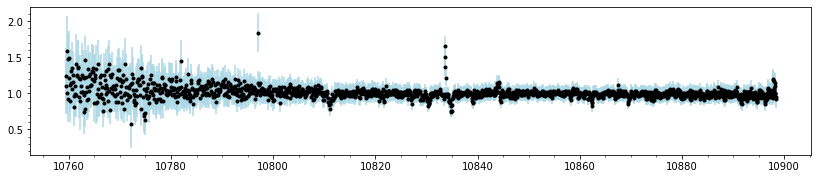

In [49]:
import matplotlib.pyplot as pl


fig = pl.figure(1,figsize=(14,6))

ax1 = pl.subplot(211)
#pl.errorbar(x=wave_mask, y=ts_mask, yerr=ts_err_mask, marker='.', ls='none', color='k', ecolor='lightblue')
pl.errorbar(x=LSD_wrv, y=F_ref, yerr=F_ref_err, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()
xmin=10820
xmax=10840

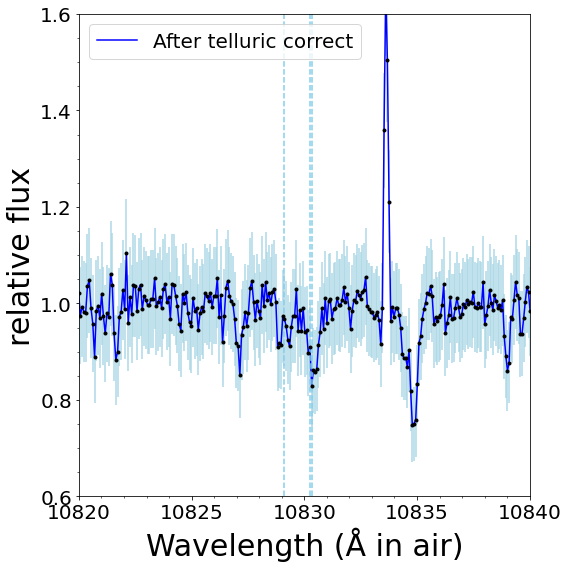

In [50]:
#RV補正した前後のプロット

#これはほんのちょっとだ//

fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

#ax1.plot(LSD_wrv , T_revised,  markersize=7, color="r", label="Before telluric correct" )
ax1.set_xlabel("Wavelength (Å in air)", size=30 )
ax1.set_ylabel("relative flux", size=30)
ax1.plot(LSD_wrv , F_ref, color="b", label="After telluric correct")
#ax1.plot(LSD_wrv , tellu, color="g", label="telluric spectra")


ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
ax1.set_ylim(0.6, 1.6)
ax1.set_xlim(10820, 10840)

ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')


plt.tick_params(labelsize=20)

pl.errorbar(x=LSD_wrv, y=F_ref, yerr=F_ref_err, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()


plt.tight_layout()  # タイトルの被りを防ぐ

## 7.トランジット外のスペクトルを足し合わせてテンプレートフレームを作成し、各スペクトルをこのマスターフレームで割って、恒星のスペクトルを除去する

<img src="Stellar Removal.png" width="200">


恒星マスターフレーム

In [2]:
#規格化されたtransit-out spectra(~1くらい)の重み付けを戻してあげる.

import math

import numpy as np
import pandas as pd

#スペクトルを規格化
import statistics

#トランジット外のスペクトルを足し合わせてテンプレートフレームを作成する。

#F_ref_err_0.datのファイルをファイルを、トランジットイン、アウトに整理したもの.

F_ste = 0
F_ste_err = 0
F_ste_0_err = 0
F1_err = 0

#He_blaze_nan のtransit-outのやつ

for i in range(7):
    
    LSD_wrv = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=0, unpack=True)
    He_raw =  np.loadtxt("./TOI654/rawspec/He_blaze_nan_err_transit-out/He_blaze_nan_err_transit-out_{0}.dat".format(i), usecols=0) #raw[2]
    He_blaze_nan = np.loadtxt("./TOI654/rawspec/He_blaze_nan_err_transit-out/He_blaze_nan_err_transit-out_{0}.dat".format(i), usecols=1) #raw[2]
    #He_blaze_nan_err = np.loadtxt("./TOI654/normal/normal_err_revised_transit-out/He_blaze_nan_transit-out_{0}.dat".format(i), usecols=1) 
    
    F0 = np.loadtxt("./TOI654/F_ref/F_ref_out_numrevised/F_ref_out_numrevised_{0}.dat".format(i), usecols=1, unpack=True) #raw[2]
    F0_err = np.loadtxt("./TOI654/F_ref/F_ref_out_numrevised/F_ref_out_numrevised_{0}.dat".format(i), usecols=2, unpack=True)
    
    print("i = ", i )
    print("F0_err =" ,F0_err)
    #F0_revised_err = F0_err * ( He_raw_err / F0  ) 
    
    #median_F0 = statistics.median(F0)
    #median_F0_err = statistics.median(F0_err)
    
    #Transit-outのスペクトルの重み付けを戻してあげる
    #Z_t = median_F0 * (F0 / He_blaze_nan) 
    
    
    median_nan = statistics.median(He_blaze_nan)
    
    
    Z_t = median_nan * (He_raw / He_blaze_nan) #前と同じ
    #He_blaze_nan エラーは、つまりまだ補正を行なっていない時のエラーだよね?    と、 F0 の値の違いは?
    
    #raw[1] / raw[2]なので、 ~1 / 数百
    #Z_t_err = median_F0_err * (F0 / He_blaze_nan) #(F0 / He_blaze_nan) は誤差と関係ない...
     
    #Z_t_err = ( ((1/median_F0) * He_blaze_nan_err) ** 2 + ( ( (He_blaze_nan/ (median_F0 ** 2) ) ) * median_F0_err ) ** 2 ) ** 0.5
    print("Z_t =" , Z_t)
    #print("Z_t_err =" , Z_t_err)
    

    
    
    #恒星スペクトルを作る:
    F_ste += F0 * Z_t
    
    #stellar flux error
    F1_err = (F0_err * Z_t) ** 2
    print( "F1_err = " ,F1_err)
    F_ste_0_err += F1_err
    print(F_ste_err)
    #F_ste_err = F_ste_err ** 0.5 こんな風にすると、
    F_ste_err = F_ste_0_err ** 0.5

    print(np.shape(F_ste))
    print("F_ste=", F_ste)
    
    print("F_ste_err=", F_ste_err)




i =  0
F0_err = [0.00650437 0.006847   0.00725866 ... 0.02743324 0.02850208 0.02609561]
Z_t = [ 18.26773649  21.49569494  24.40789049 ... 248.80603122 231.86646686
 212.93967313]
F1_err =  [1.41182052e-02 2.16622401e-02 3.13887300e-02 ... 4.65882251e+01
 4.36746089e+01 3.08779243e+01]
0
(1987,)
F_ste= [ 19.57293254  20.29146254  24.84982688 ... 236.94692685 253.90336556
 221.7390183 ]
F_ste_err= [0.11882005 0.14718098 0.17716865 ... 6.82555676 6.60867679 5.55679082]
i =  1
F0_err = [0.0078953  0.00751892 0.00854564 ... 0.03042274 0.02770524 0.02609807]
Z_t = [ 28.25285854  33.24521508  37.74921309 ... 384.80309861 358.60438943
 329.33223378]
F1_err =  [4.97579504e-02 6.24840252e-02 1.04065183e-01 ... 1.37048335e+02
 9.87086343e+01 7.38729126e+01]
[0.11882005 0.14718098 0.17716865 ... 6.82555676 6.60867679 5.55679082]
(1987,)
F_ste= [ 59.50830986  55.37925519  72.01866466 ... 642.97876265 607.93462893
 544.31525835]
F_ste_err= [ 0.25273733  0.29007976  0.36804064 ... 13.55125676 11.9324

要素(配列)の和を求めるNumPyのsum関数の使い方
https://deepage.net/features/numpy-sum.html

ピクセル毎の誤差を求める場合、sumを使うと全部足し合わせてしまうぞ。


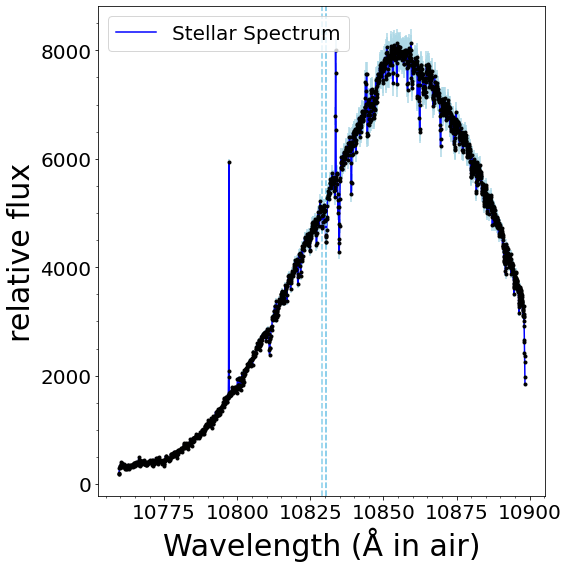

In [3]:
import matplotlib.pyplot as pl
#RV補正した前後のプロット

#これはほんのちょっとだ//

fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

#ax1.plot(LSD_wrv , T_revised,  markersize=7, color="r", label="Before telluric correct" )
ax1.set_xlabel("Wavelength (Å in air)", size=30 )
ax1.set_ylabel("relative flux", size=30)
ax1.plot(LSD_wrv , F_ste, color="b", label="Stellar Spectrum")
#ax1.plot(LSD_wrv , tellu, color="g", label="telluric spectra")


ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(5, 11)
#ax1.set_ylim(0.01, 0.015)
#ax1.set_xlim(10820, 10840)

ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')


plt.tick_params(labelsize=20)

pl.errorbar(x=LSD_wrv, y=F_ste, yerr=F_ste_err, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()


plt.tight_layout()  # タイトルの被りを防ぐ


Stellar Spectra を作るステップで、誤差がめっちゃ小さくなった!

前はTSを作る前に一回スペクトルにF_steを割るという理解だったが、余計なステップだと気づくはず...


T_planet.datのファイルを使う必要がない.

F_in / F_out の過程だけで恒星のスペクトルを取り除ける。

F_plをプロットする。

## 8.各時刻の惑星の速度変動を求めて、波長方向にシフトさせる


<img src="Δplanet RV.png" width="500">


こちらで波長補正する際も一緒か?   原理的にはokっぽい。

    wrv = wavelength / ( (1 + ( (rv * 10**3) / (3 * 10**8))) / (1 - ((rv * 10**3) / (3 * 10**8))) ) ** 0.5


トランジット前は、惑星運動を考えないより(惑星反時計回りの元)、スピードが観測者に近づけます。すると観測者にとってblueshiftのはず.

Both methods consider that the variation of telluric lines follows linearly the airmass variation.

その日観測されたスペクトルの質にもよる。

In [ ]:

#datetime?

a = 0.01915  #AU
P = 1.5275657 #days
tc =
t = 


V_prv = ( 2*pi*a/P ) * sin(2pi((t-tc)/P))

In [88]:
V_prvlist = np.loadtxt("./TOI654/V_prv_revised/V_prv_revised.dat", unpack=True)  ##VHELIOの列を読み込む
print(V_prvlist)


[-28.1816709  -24.23774854 -20.26635933 -16.28376172 -12.28055818
  -8.28609891  -4.21310577  -0.207767     3.8107314   12.75252634
  16.76068412  24.92747673  28.87372118]


F_in(λ)/ F_ste   (こちら削除する次第)

光の場合:遠ざかる光源からの光は赤っぽく見え(波長長く)（赤方偏移）、近付く光源からの光は青っぽく見える（青方偏移）。しかし、光の伝播は特殊相対性理論に従うため、通常の波のドップラー効果とは違った現象を見せる。

{\displaystyle \lambda '=\lambda {\sqrt {\frac {c-v}{c+v}}}}{\displaystyle \lambda '=\lambda {\sqrt {\frac {c-v}{c+v}}}}

使っているのは実質この式と同じ。 まあ、導出は...また暇な時に...

In [111]:
## 確認 :近づけると prvが小さくなる(青く)、逆も然り.  間違っていない??
#実際、式は違うんじゃないの??

i=0

for V_prv in V_prvlist:   #telluriclistは配列が違う. telluricfluxとは違う.
    #LSD_wrv = np.genfromtxt("./TOI654/.dat".format(i), usecols=0, unpack=True) * 10
    # * 10 でÅにする!
    
    F_pl = np.loadtxt("./TOI654/T_planet/T_planet_{0}.dat".format(i), usecols=1, unpack=True)
    #usecolsはなし!
    
    # 122218更新!!!! :
    # 上のV_prvを、観測者にとって逆なので逆転:
    
    V_prv = - V_prv
    
    print("i=", i)
    prv = LSD_wrv / ( (1 + ( (V_prv * 10**3) / (3 * 10**8))) / (1 - ((V_prv * 10**3) / (3 * 10**8))) ) ** 0.5
    print('LSD_wrv=', LSD_wrv)
    print('prv=', prv)
    print('F_pl=', F_pl)

    print('Δλ = ', prv - LSD_wrv)

    outputfile = './TOI654/T_planet_prv/T_planet_prv_new_{0}'.format(i)
    d = np.column_stack((prv, F_pl))     #np.savetxt 複数配列の保存方法
    #np.savetxt(outputfile,target, delimiter =",",fmt ='% s')
    np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
    i+=1

i= 0
LSD_wrv= [10759.39117558 10759.48836958 10759.58553881 ... 10898.28872987
 10898.32998137 10898.37120344]
prv= [10758.38049765 10758.47768251 10758.57484262 ... 10897.26500466
 10897.30625229 10897.34747049]
F_pl= [0.13334374 0.1348469  0.14694899 ... 0.13212054 0.16094506 0.15166237]
Δλ =  [-1.01067794 -1.01068707 -1.01069619 ... -1.02372521 -1.02372908
 -1.02373295]
i= 1
LSD_wrv= [10759.39117558 10759.48836958 10759.58553881 ... 10898.28872987
 10898.32998137 10898.37120344]
prv= [10758.52193264 10758.61911878 10758.71628016 ... 10897.40826549
 10897.44951366 10897.4907324 ]
F_pl= [0.17591256 0.1507669  0.18035192 ... 0.14638672 0.14510192 0.14265613]
Δλ =  [-0.86924295 -0.8692508  -0.86925865 ... -0.88046437 -0.88046771
 -0.88047104]
i= 2
LSD_wrv= [10759.39117558 10759.48836958 10759.58553881 ... 10898.28872987
 10898.32998137 10898.37120344]
prv= [10758.66435451 10758.76154194 10758.8587046  ... 10897.55252595
 10897.59377466 10897.63499395]
F_pl= [0.15459419 0.14738992 0.1376

F_in(λ)/ F_ste の足し合わせ ((こちら削除する次第))

i =  0
(1987,)
[0.13464188 0.11544631 0.14746147 ... 0.15707795 0.14621886 0.12148476]
i =  1
(1987,)
[0.24179553 0.2255031  0.28532392 ... 0.31156953 0.29187148 0.28458103]
i =  2
(1987,)
[0.45414141 0.43399461 0.43702951 ... 0.45714322 0.435984   0.43369282]
i =  3
(1987,)
[0.67289873 0.6031511  0.66130861 ... 0.57598093 0.58907731 0.57998782]


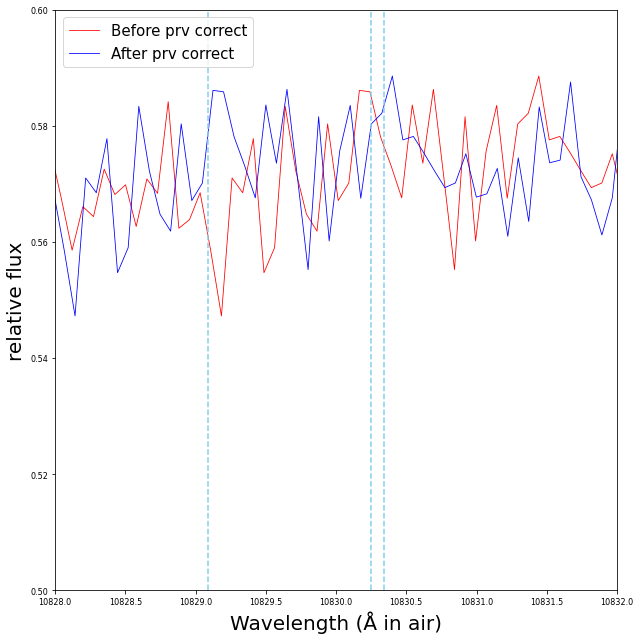

In [106]:
"""

これ、意味ある>?????

F_pl_prv = 0

for i in range(4):
    F_pl_prv_in = np.loadtxt("./TOI654/T_planet_prv/T_planet_prv_in/T_planet_prv_re_{0}".format(i), usecols=1, unpack=True)
    #データ名に.datがついていない!!
    
    print("i = ", i )
    
    
    F_pl_prv += F_pl_prv_in
    
    
    
    print(np.shape(F_pl_prv))
    
    print(F_pl_prv)
    



fig = plt.figure(figsize = (9,9))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

ax1.plot(LSD_wrv , F_pl_prv, "-",lw = 0.8,  color="r", label="Before prv correct" )
ax1.set_xlabel("Wavelength (Å in air)", size=20 )
ax1.set_ylabel("relative flux", size=20)
ax1.plot(prv , F_pl_prv, "-", lw = 0.8, color="b", label="After prv correct")
ax1.legend(loc="upper left", fontsize = 15)
ax1.set_ylim(0.5, 0.6)
#ax1.set_ylim(-1, 0.3)
ax1.set_xlim(10828, 10832)

ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')


#print("i=", i )
plt.tick_params(labelsize=8)



plt.tight_layout()  # タイトルの被りを防ぐ
plt.show()


"""

i= 0


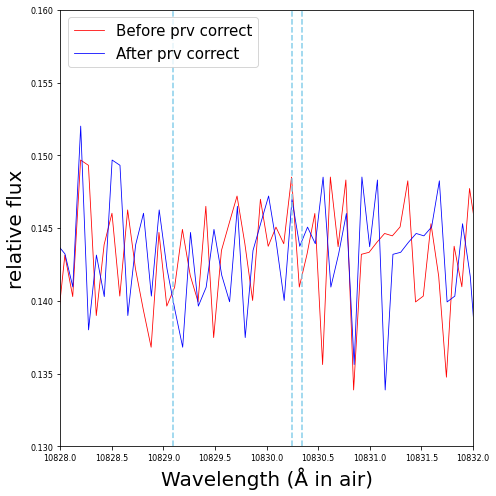

i= 1


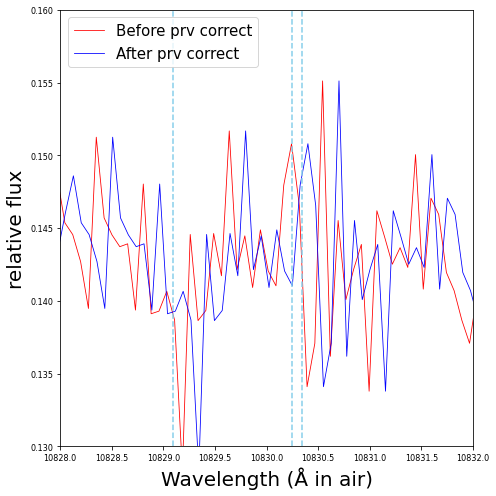

i= 2


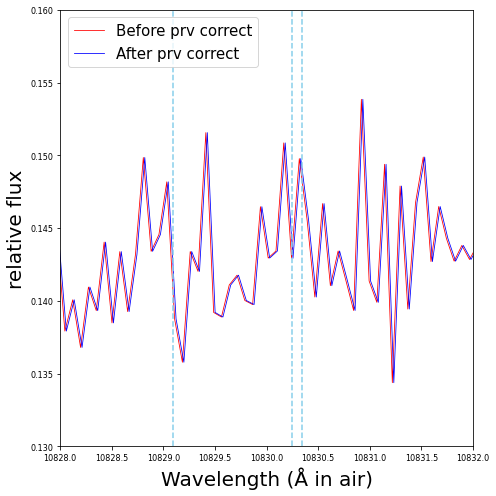

i= 3


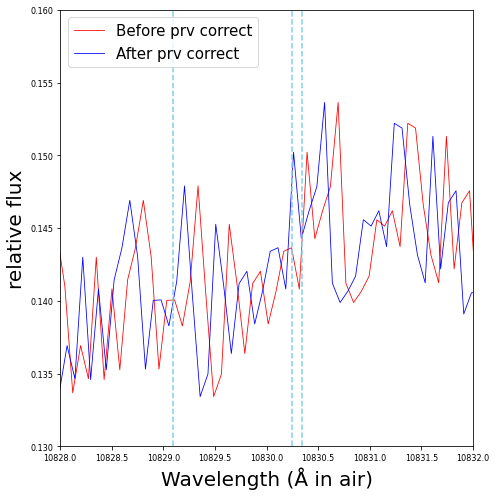

In [107]:
#planet radial velocity補正した前後のプロット

#これはほんのちょっとだ//

for i in range(4):
    prv_in = np.loadtxt("./TOI654/T_planet_prv/T_planet_prv_in_old/T_planet_prv_re_{0}".format(i), usecols=0, unpack=True)
    
    F_pl_prv_in = np.loadtxt("./TOI654/T_planet_prv/T_planet_prv_in_old/T_planet_prv_re_{0}".format(i), usecols=1, unpack=True)
    
    fig = plt.figure(figsize = (7,7))
    ax1 = fig.add_subplot(111)
    #ax2 = fig.add_subplot(111)

    ax1.plot(LSD_wrv , F_pl_prv_in, "-",lw = 0.8,  color="r", label="Before prv correct" )
    ax1.set_xlabel("Wavelength (Å in air)", size=20 )
    ax1.set_ylabel("relative flux", size=20)
    ax1.plot(prv_in , F_pl_prv_in, "-", lw = 0.8, color="b", label="After prv correct")
    ax1.legend(loc="upper left", fontsize = 15)
    ax1.set_ylim(0.13, 0.16)
    #ax1.set_ylim(-1, 0.3)
    ax1.set_xlim(10828, 10832)

    ax1.axvline(x = 10830.34, ls='--', c='skyblue')
    ax1.axvline(x = 10830.25, ls='--', c='skyblue')
    ax1.axvline(x = 10829.09, ls='--', c='skyblue')


    print("i=", i )
    plt.tick_params(labelsize=8)



    plt.tight_layout()  # タイトルの被りを防ぐ
    plt.show()
    

Transmission Spectra どう作る?

まず F_pl_prv_inのスペクトルをエラー付きでそれぞれプロットして確認する!

In [108]:
#まず F_pl_prv_inのスペクトルをエラー付きでそれぞれプロットして確認する!



tcは既にある。

Transit-inのスペクトルi=5~8を足し合わせてみる(ここ重み付けちゃんと変更)


In [87]:
print("F_ste_err_shape =" , np.shape(F_ste_err))

F_ste_err_shape = (1987,)


In [4]:
#規格化したTransit-outを求める:

Z = 0
#Z = []がダメな理由は?

for i in range(7):
    
    LSD_wrv = np.loadtxt("./TOI654/telluricmodel_revised/telluricmodel_revised_{0}.dat".format(i), usecols=0, unpack=True)
    
    #最初のフラックス
    He_raw_out =  np.loadtxt("./TOI654/rawspec/He_blaze_nan_err_transit-out/He_blaze_nan_err_transit-out_{0}.dat".format(i), usecols=0) #raw[1]
    He_blaze_out = np.loadtxt("./TOI654/rawspec/He_blaze_nan_err_transit-out/He_blaze_nan_err_transit-out_{0}.dat".format(i), usecols=1) #raw[2]
    
    
    #ここのフラックスは地球大気補正後の形式!
    F0 = np.loadtxt("./TOI654/F_ref/F_ref_out_numrevised/F_ref_out_numrevised_{0}.dat".format(i), usecols=1, unpack=True) #raw[2]
    F0_err = np.loadtxt("./TOI654/F_ref/F_ref_out_numrevised/F_ref_out_numrevised_{0}.dat".format(i), usecols=2, unpack=True)
    
    print("i = ", i )
    print("F0_err =" ,F0_err)

    median_out = statistics.median(He_blaze_out)
    
    Z_t = median_out * (He_raw_out / He_blaze_out) #前と同じ
    Z_t = Z_t.reshape(-1, 1)
    print("Z_t =" , Z_t)
    print("Z_t_shape =" , np.shape(Z_t))
    
    Z += Z_t
    print("Z =" , Z)
    print("Z_shape =" , np.shape(Z))
    
    #Z_err =  ????
    
    

F_ste = F_ste.reshape(-1, 1)   
print("F_ste_shape =" , np.shape(F_ste)) 
#F_ste = F_ste.reshape(-1, 1) 
F_ste_err = F_ste_err.reshape(-1, 1)  
print("F_ste_err_shape =" , np.shape(F_ste_err))

T_out = F_ste / Z          #ここ誤差ある？？？
T_out_err = F_ste_err / Z

T_out
print("T_out=", T_out)
print("T_out_shape=", np.shape(T_out))
print("T_out_err=", T_out_err)
print("T_out_err_shape=", np.shape(T_out_err))


i =  0
F0_err = [0.00650437 0.006847   0.00725866 ... 0.02743324 0.02850208 0.02609561]
Z_t = [[ 18.26773649]
 [ 21.49569494]
 [ 24.40789049]
 ...
 [248.80603122]
 [231.86646686]
 [212.93967313]]
Z_t_shape = (1987, 1)
Z = [[ 18.26773649]
 [ 21.49569494]
 [ 24.40789049]
 ...
 [248.80603122]
 [231.86646686]
 [212.93967313]]
Z_shape = (1987, 1)
i =  1
F0_err = [0.0078953  0.00751892 0.00854564 ... 0.03042274 0.02770524 0.02609807]
Z_t = [[ 28.25285854]
 [ 33.24521508]
 [ 37.74921309]
 ...
 [384.80309861]
 [358.60438943]
 [329.33223378]]
Z_t_shape = (1987, 1)
Z = [[ 46.52059503]
 [ 54.74091003]
 [ 62.15710357]
 ...
 [633.60912983]
 [590.47085629]
 [542.27190691]]
Z_shape = (1987, 1)
i =  2
F0_err = [0.00710156 0.00707225 0.00717083 ... 0.02926005 0.02580688 0.0237949 ]
Z_t = [[ 25.44190772]
 [ 29.93756164]
 [ 33.99344509]
 ...
 [346.51803138]
 [322.92590033]
 [296.56610804]]
Z_t_shape = (1987, 1)
Z = [[ 71.96250275]
 [ 84.67847166]
 [ 96.15054866]
 ...
 [980.12716121]
 [913.39675662]
 [838

あとは1次元のT_out_err_shape= (1987, 1)をスカラー化に!

NameError: name 'T_out' is not defined

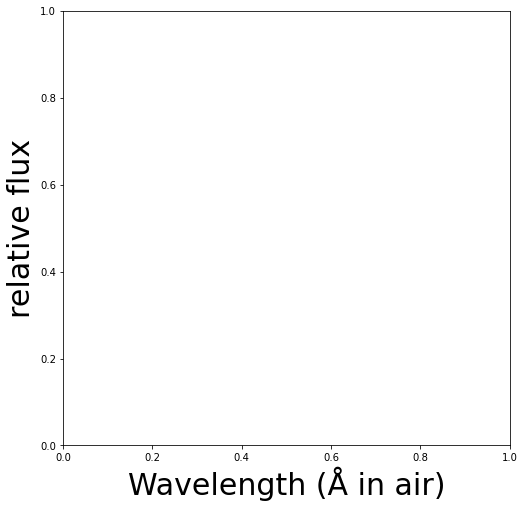

In [109]:
#ちゃんとT_outのエラーを表示させて!


import matplotlib.pyplot as pl

#これはほんのちょっとだ//

fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

#ax1.plot(LSD_wrv , T_revised,  markersize=7, color="r", label="Before telluric correct" )
ax1.set_xlabel("Wavelength (Å in air)", size=30 )
ax1.set_ylabel("relative flux", size=30)
ax1.plot(LSD_wrv , T_out, color="b", label="Stellar Spectrum")
#ax1.plot(LSD_wrv , tellu, color="g", label="telluric spectra")


ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(5, 11)
#ax1.set_ylim(0.01, 0.015)
ax1.set_xlim(10820, 10840)

ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')


plt.tick_params(labelsize=20)

pl.errorbar(x=LSD_wrv, y=T_out, yerr=T_out_err, ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()


plt.tight_layout()  # タイトルの被りを防ぐ



行列がんばろう。

変数たちを同じ次元に直すか、行列計算を考えるか、だ。


NumPy配列ndarrayの次元数、形状、サイズ（全要素数）を取得
https://note.nkmk.me/python-numpy-ndarray-ndim-shape-size/

https://utokyo-ipp.github.io/5/5-3.html



シン・Transmission Spectra

In [17]:

#トランジット内のスペクトルを足し合わせてテンプレートフレームを作成する。

import itertools

#F_pl_in = 0
A = 0
B = 0

#F_pl_err_0 = 0
A_err_2 = 0

for i in range(4):
    T_in = np.loadtxt("./TOI654/F_ref/F_ref_in_numrevised/F_ref_in_numrevised_{0}.dat".format(i), usecols=1, unpack=True)
    T_in_err = np.loadtxt("./TOI654/F_ref/F_ref_in_numrevised/F_ref_in_numrevised_{0}.dat".format(i), usecols=2, unpack=True)
    He_raw_in = np.loadtxt("./TOI654/rawspec/He_blaze_nan_err_transit-in/He_blaze_nan_err_transit-in_{0}.dat".format(i), usecols=0)
    He_blaze_in = np.loadtxt("./TOI654/rawspec/He_blaze_nan_err_transit-in/He_blaze_nan_err_transit-in_{0}.dat".format(i), usecols=1) #raw[2]
    
    print("i = ", i )
    #F_in = T_in / F_ste    
    #F_in_err = ( ((1/F_ste) * T_in_err) ** 2 + ( ( (T_in/ (F_ste ** 2) ) ) * F_ste_err ) ** 2 ) ** 0.5
    
    #median_T_in = statistics.median(T_in)
    #median_T_in_err = statistics.median(T_in)
    
    median_in = statistics.median(He_blaze_in)
    
    #Transit-outのスペクトルの重み付けを戻してあげる
    Z_in = median_in * (T_in / He_blaze_in) 
    #He_blaze_nan エラーは、つまりまだ補正を行なっていない時のエラーだよね?    と、 F0 の値の違いは?
    
    #raw[1] / raw[2]なので、 ~1 / 数百
    #Z_t_err = median_in_err * (T_in / He_blaze_in) #(F0 / He_blaze_nan) は誤差と関係ない...
     
    #Z_t_err = ( ((1/median_F0) * He_blaze_nan_err) ** 2 + ( ( (He_blaze_nan/ (median_F0 ** 2) ) ) * median_F0_err ) ** 2 ) ** 0.5
    print("Z_in =" , Z_in)
    #print("Z_t_err =" , Z_t_err)
    
    #F_pl_in += T_in
    
    #Planet template
        
    #F_pl_err_0 += (T_in_err) ** 2
    #print(F_pl_err_0)
    #F_ste_err = F_ste_err ** 0.5 こんな風にすると、
    #F_pl_in_err = F_pl_err_0 ** 0.5
    
    
    #A += (T_in / He_blaze_nan) * F_in 
    #B += (T_in / He_blaze_nan)
    
    print("Z_in_shape=", np.shape(Z_in))
    print("T_in_shape=", np.shape(T_in))
    print("T_out_shape=", np.shape(T_out))
    
    
    #T_out = list(itertools.chain.from_iterable(T_out))
    print(T_out.shape)
    
    A += Z_in * (T_in/T_out)  #真のTsの値を足し合わせた.
    B += Z_in #Bで割ってAを規格化
    Ts = A / B
    
    print("A_shape=", np.shape(A))
    print("B_shape=", np.shape(B))
    print("Ts_shape=", np.shape(Ts))
    
    #(1987, 1987) は2次元配列. 治すために:
    T_out = T_out.reshape( -1 , )
    T_out_err = T_out_err.reshape( -1 , )
    
    #A's error
    A_err_0 = Z_in * ( ((1/T_out) * T_in_err) ** 2 + ( ( (T_in/ (T_out ** 2) ) ) * T_out_err ) ** 2 ) ** 0.5
    A_err_1 = (A_err_0) ** 2
    A_err_2 += A_err_1
    A_err = A_err_2 ** 0.5
    print("A_err=", A_err)
    
    #Ts = A / B の誤差を考える.  B は誤差に参加しないから.
    Ts_err = A_err / B
    
    print(np.shape(Ts))
    
    print("Ts=", Ts)
    print("Ts_err=", Ts_err)
    print("Ts_err_shape=", np.shape(Ts_err))
    
    
    
    
    
outputfile = './TOI654/TS_He_1128.dat'
d = np.column_stack((prv, Ts))     #np.savetxt 複数配列の保存方法
d = np.column_stack((d, Ts_err))

np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')
    
    
    
    
    
    

i =  0
Z_in = [1.00914303 0.99728116 1.01450422 ... 0.99721047 1.00071148 1.00071322]
Z_in_shape= (1987,)
T_in_shape= (1987,)
T_out_shape= (1987,)
(1987,)
A_shape= (1987,)
B_shape= (1987,)
Ts_shape= (1987,)
A_err= [0.00744673 0.0078593  0.00980485 ... 0.03786089 0.03521457 0.02911452]
(1987,)
Ts= [0.94342195 0.80984768 1.0301486  ... 1.10265675 1.02886576 0.84953603]
Ts_err= [0.00737926 0.00788073 0.00966467 ... 0.0379668  0.03518953 0.02909377]
Ts_err_shape= (1987,)
i =  1
Z_in = [1.00664145 0.99757201 1.01073182 ... 0.99751723 1.00019734 1.00019854]
Z_in_shape= (1987,)
T_in_shape= (1987,)
T_out_shape= (1987,)
(1987,)
A_shape= (1987,)
B_shape= (1987,)
Ts_shape= (1987,)
A_err= [0.00987967 0.01094653 0.01354381 ... 0.0531541  0.04963424 0.04587951]
(1987,)
Ts= [0.84723781 0.79094137 0.99668226 ... 1.09357741 1.0268741  0.99499207]
Ts_err= [0.00490116 0.00548738 0.00668752 ... 0.0266473  0.02480585 0.0229293 ]
Ts_err_shape= (1987,)
i =  2
Z_in = [0.99629844 0.99838875 0.99536292 ... 0.99

In [10]:
print(T_in.shape)
print(T_out.shape)
print(A.shape)



(1987,)
(1987, 1)
(1987, 1987)


In [13]:
print(T_in.ndim)
print(T_out.ndim)
print(A.ndim)


1
2
2


In [17]:
import itertools

print(list(itertools.chain.from_iterable(T_out)))


TypeError: 'numpy.float64' object is not iterable

In [22]:
import collections

def flatten(l):
    for el in l:
        if isinstance(el, collections.abc.Iterable) and not isinstance(el, (str, bytes)):
            yield from flatten(el)
        else:
            yield el

T_out = list(flatten(T_out))
print(T_out)
#print(T_out.shape)

[1.146760544294964, 0.9979243817560827, 0.991756787209831, 1.2619190245366834, 1.338557187928549, 1.2255034467325139, 1.0838969425956002, 1.1572065148369521, 1.3616236866865692, 1.130565930125428, 1.18772084854678, 1.2361483847019505, 1.1710938921801424, 1.0316457088519029, 1.107233729551159, 1.0602214422472727, 1.0465691751143396, 1.0303165847500748, 1.1652659348286591, 1.0505550197553666, 1.2209980550330957, 1.1695816417942044, 0.9618943482183895, 1.2058353374964859, 1.0992930130408902, 1.0832880789173445, 0.9715632400622539, 1.1058934032967078, 1.1289184964669483, 0.9869417903017719, 1.0378145065467392, 1.0447198860620455, 1.2471908693510325, 1.1647796910141448, 1.1336271676024712, 1.1875290901845656, 0.9813506165698951, 1.1406766317089787, 1.0840157218348425, 1.0831189276661253, 1.16751084179221, 1.0694178567950223, 1.095766134714232, 1.0383585779306297, 1.1186763388691683, 1.0873724514887384, 1.1149713529071223, 1.1153820381436599, 1.024038262032174, 1.0726858777345576, 0.98141638

In [29]:
T_out = T_out.reshape( -1 , )
print(T_out)
print(T_out.shape)

#できた!!

[1.14676054 0.99792438 0.99175679 ... 1.026821   0.96693556 0.98185574]
(1987,)


Excess Absorptionをプロットする!

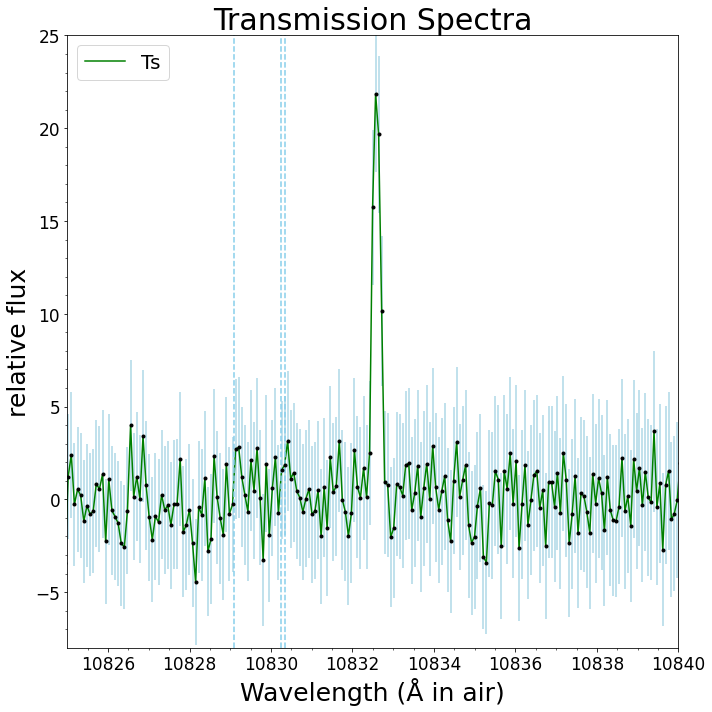

In [123]:
Ts_1 = Ts -1

# * 100% 
Ts_0 = Ts_1 * 100
Ts_0_err = Ts_err * 100

fig = plt.figure(figsize = (10,10))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

ax1.set_xlabel("Wavelength (Å in air)", size=25 )
ax1.set_ylabel("relative flux", size=25)
ax1.plot(prv, Ts_0, "-", color="g", label="Ts")
ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(-0.5, 0.5)
#ax1.set_xlim(10820, 10845)
#ax1.set_ylim(0.54, 0.7)
#ax1.set_ylim(-0.1, 0.3)
#ax1.set_ylim(-0.1, 0.3)
ax1.set_ylim(-8, 25)


ax1.set_xlim(10825, 10840)
#ax1.set_xlim(10820, 10840)


ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')

plt.tick_params(labelsize=17)
plt.title('Transmission Spectra', size = 30)


plt.tight_layout()  # タイトルの被りを防ぐ

pl.errorbar(x=prv, y=Ts_0, yerr=Ts_0_err, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()

###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()

#np.savetxt("./TOI654/TS_He.dat")
outputfile = './TOI654/TS_He.dat'
d = np.column_stack((prv, Ts_0))     #np.savetxt 複数配列の保存方法
d = np.column_stack((d, Ts_0_err))

np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')


z0 と　中心波長を固定する.



(1987,)
F_ts = [0.67289873 0.6031511  0.66130861 ... 0.57598093 0.58907731 0.57998782]
F_ts_err = [0.00311256 0.00344927 0.00376461 ... 0.01307977 0.01289831 0.01201337]


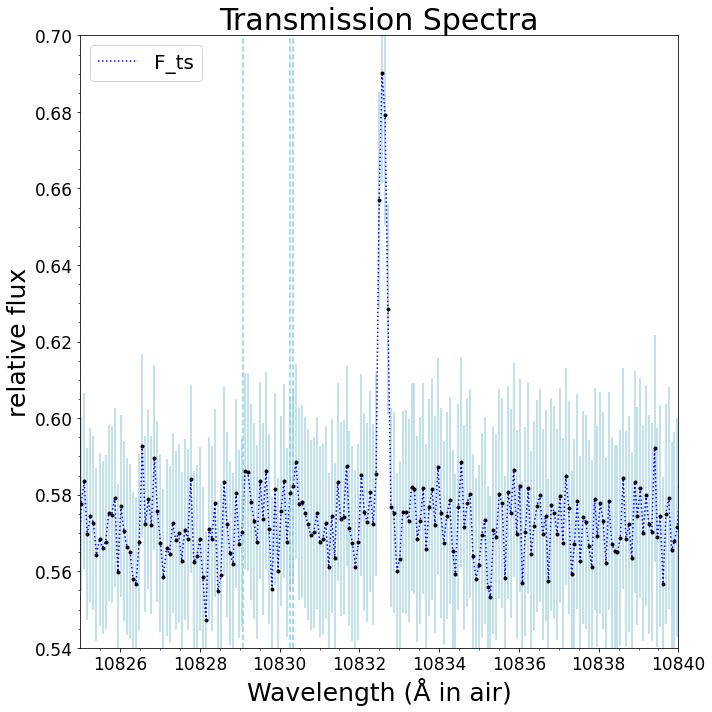

In [13]:
#古いプロット



#prv = np.loadtxt("./TOI654/T_planet/T_planet_{0}.dat".format(i), usecols=0, unpack=True)
#改めて作ったtelluricmodel

#transimission spectra
#F_ts = F_pl_in / F_ste    

#F_ts_err = ( ((1/F_ste) * F_pl_in_err) ** 2 + ( ( (F_pl_in/ (F_ste ** 2) ) ) * F_ste_err ) ** 2 ) ** 0.5

#./TOI654/F_ref フォルダ内のスペクトルのエラーを見つければよし!
# F_ste:
#F_pl_in:
    
print(np.shape(F_pl_in))
print("F_ts =", F_ts)
print("F_ts_err =",F_ts_err)

fig = plt.figure(figsize = (10,10))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

ax1.set_xlabel("Wavelength (Å in air)", size=25 )
ax1.set_ylabel("relative flux", size=25)
ax1.plot(prv, F_ts, ":", color="b", label="F_ts")
ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
#ax1.set_ylim(-0.5, 0.5)
#ax1.set_xlim(10820, 10845)
ax1.set_ylim(0.54, 0.7)
ax1.set_xlim(10825, 10840)
#ax1.set_xlim(10820, 10840)


ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')

plt.tick_params(labelsize=17)
plt.title('Transmission Spectra', size = 30)


plt.tight_layout()  # タイトルの被りを防ぐ

pl.errorbar(x=prv, y=F_ts, yerr=F_ts_err, marker='.', ls='none', color='k', ecolor='lightblue')
pl.minorticks_on()

###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()

#np.savetxt("./TOI654/TS_He.dat")
outputfile = './TOI654/TS_He.dat'
d = np.column_stack((prv, F_ts))     #np.savetxt 複数配列の保存方法
d = np.column_stack((d, F_ts_err))

np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')


(1987,)
F_pl = [ 9.28987295e-02  2.31510963e-02  8.13086064e-02 ... -4.01907365e-03
  9.07731256e-03 -1.21781697e-05]
i =  12


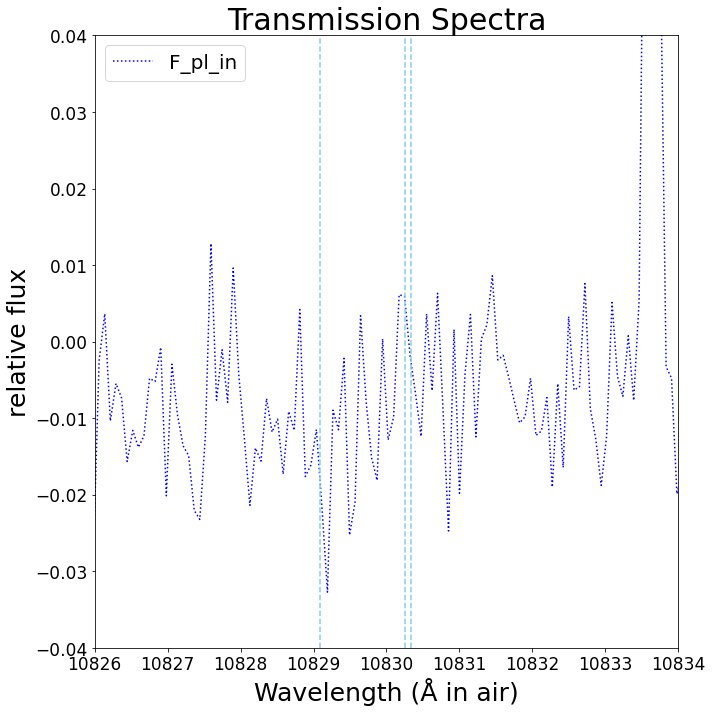

In [19]:
#拡大:


#LSD_wrv = np.loadtxt("./TOI654/T_planet/T_planet_{0}.dat".format(i), usecols=0, unpack=True)
#改めて作ったtelluricmodel

#F_pl = F_pl_in / F_ste    
F_pl = F_pl_in / F_ste  - 0.58

print(np.shape(F_pl))
print("F_pl =", F_pl)

fig = plt.figure(figsize = (10,10))
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(111)

ax1.set_xlabel("Wavelength (Å in air)", size=25 )
ax1.set_ylabel("relative flux", size=25)
ax1.plot(LSD_wrv, F_pl, ":", color="b", label="F_pl_in")
ax1.legend(loc="upper left", fontsize = 20)
#ax1.set_ylim(0.25, 1.5)
ax1.set_ylim(-0.04, 0.04)
#ax1.set_xlim(10820, 10845)
#ax1.set_ylim(0.54, 0.7)
ax1.set_xlim(10826, 10834)

ax1.axvline(x = 10830.34, ls='--', c='skyblue')
ax1.axvline(x = 10830.25, ls='--', c='skyblue')
ax1.axvline(x = 10829.09, ls='--', c='skyblue')

print("i = ", i)

plt.tick_params(labelsize=17)
plt.title('Transmission Spectra', size = 30)


plt.tight_layout()  # タイトルの被りを防ぐ


###これ入れるとそれぞれの図の前にばんご振ってくれっる!
plt.show()



# 9.Transmission Spectraをフィット. 詳しくは別のipynbで.

In [1]:
python -m pip install -U pip
pip install -U setuptools setuptools_scm pep517
pip install -U emcee

SyntaxError: invalid syntax (<ipython-input-1-14bf966452ba>, line 1)

In [4]:
conda update conda
conda install -c conda-forge emcee

SyntaxError: invalid syntax (<ipython-input-4-241bc0c5f2fc>, line 1)

In [5]:
pip -V

pip 22.1.2 from /Applications/anaconda3/lib/python3.8/site-packages/pip (python 3.8)
Note: you may need to restart the kernel to use updated packages.


In [21]:
pwd

'/Users/jam/Desktop/Research Room/Jupyter'

# SED のスケーリング

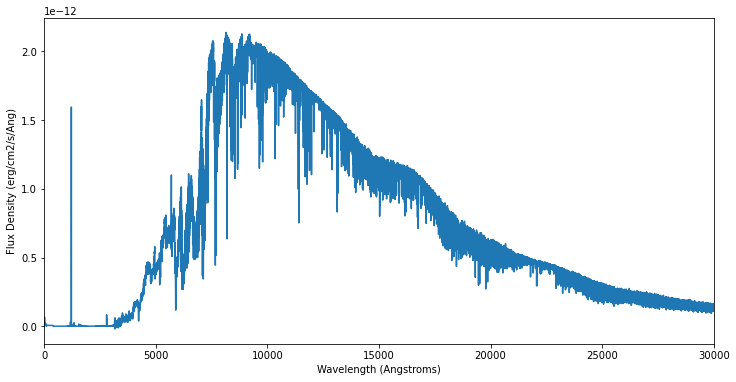

In [28]:
from astropy.io import fits
import matplotlib.pyplot as plt

fig = pl.figure(1,figsize=(12,6))

ax1 = pl.subplot(111)

spec = fits.getdata('TOI654/gj674/hlsp_muscles_multi_multi_gj674_broadband_v23_adapt-const-res-sed.fits',1)
plt.plot(spec['WAVELENGTH'],spec['FLUX'])
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


ax1.set_xlim(0, 30000)

plt.show()

In [84]:
1e+16 / 1e+15

10.0

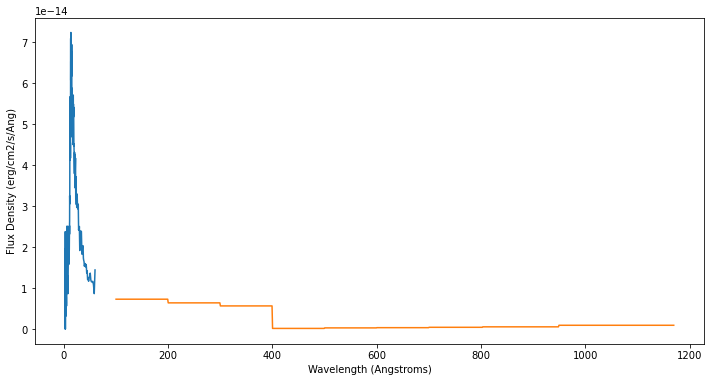

In [42]:
fig = pl.figure(1,figsize=(12,6))

#ax1 = pl.subplot(111)

spec1 = fits.getdata('TOI654/gj674/hlsp_muscles_xmm_epic_gj674_na_v23_component-spec.fits',1)
plt.plot(spec1['WAVELENGTH'],spec1['FLUX'])
spec2 = fits.getdata('TOI654/gj674/hlsp_muscles_model_euv-scaling_gj674_na_v23_component-spec.fits',1)
plt.plot(spec2['WAVELENGTH'],spec2['FLUX'])
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


#ax1.set_xlim(0, 950)

plt.show()

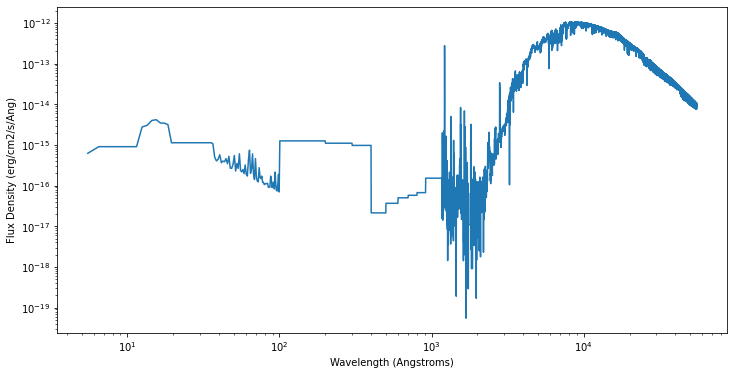

In [124]:
from astropy.io import fits
import matplotlib.pyplot as plt

fig = pl.figure(1,figsize=(12,6))

ax1 = pl.subplot(111)

#spec = fits.getdata('TOI654/hlsp_muscles_multi_multi_gj176_broadband_v22_const-res-sed.fits',1)
spec = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits',1)



plt.plot(spec['WAVELENGTH'],spec['FLUX'] )
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


#ax1.set_xlim(0, 900)
ax1.set_yscale('log')
ax1.set_xscale('log')

#ax1.set_ylim(0, 5e-15)


plt.show()

スケーリング: (  (d(pc) * 3.0857×10^16)^2  )   / (a(au) *  1.496e+11)^2
でスケーリングする.
ここのd(pc)はモデルスペクトル、GJ167が地球までの距離(=9.4). a(au)は、TOI654.01の軌道長半径.

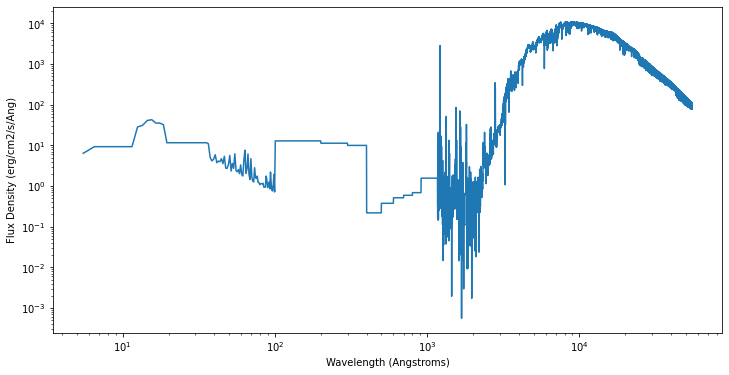

In [90]:
from astropy.io import fits
import matplotlib.pyplot as plt

fig = pl.figure(1,figsize=(12,6))

ax1 = pl.subplot(111)

#spec = fits.getdata('TOI654/hlsp_muscles_multi_multi_gj176_broadband_v22_const-res-sed.fits',1)
spec = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits',1)



plt.plot(spec['WAVELENGTH'],spec['FLUX'] * (  (9.4 * 3.0857 * 1e+16) ** 2  )   / (0.01915 *  1.496e+11) ** 2)
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


#ax1.set_xlim(0, 900)
ax1.set_yscale('log')
ax1.set_xscale('log')

#ax1.set_ylim(0, 5e-15)


plt.show()

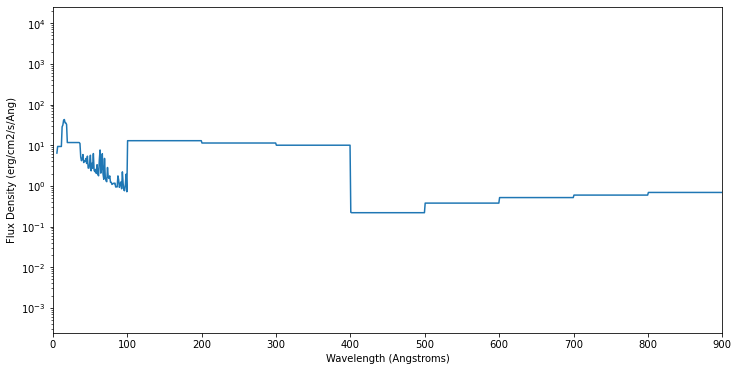

In [96]:
from astropy.io import fits
import matplotlib.pyplot as plt

fig = pl.figure(1,figsize=(12,6))

ax1 = pl.subplot(111)

#spec = fits.getdata('TOI654/hlsp_muscles_multi_multi_gj176_broadband_v22_const-res-sed.fits',1)
spec = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits',1)



#plt.plot(spec['WAVELENGTH'],( spec['FLUX'] * (  (9.4 * 3.0857 * 1e+16) ** 2  ) )  / (0.01915 *  1.496e+11) ** 2)

#今の単位は/cm2なので、(でも引き消されたのか..)
plt.plot(spec['WAVELENGTH'],( spec['FLUX'] * (  (9.4 * 3.0857 * 1e+18) ** 2  ) )  / (0.01915 *  1.496e+13) ** 2)
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


ax1.set_xlim(0, 900)
ax1.set_yscale('log')
#ax1.set_xscale('log')

#ax1.set_ylim(0, 5e-15)


plt.show()

In [99]:
spec_flux_erg =  ( spec['FLUX'] * (  (9.4 * 3.0857 * 1e+16) ** 2  ) )  / (0.01915 *  1.496e+11) ** 2
print("spec_flux_erg=", spec_flux_erg)
print("spec_flux_erg_shape=", np.shape(spec_flux_erg))

spec_flux_W_m2 = spec_flux_erg * 1e-7 * 1e+4
print("spec_flux_W_m2=", spec_flux_W_m2)



spec_flux_erg= [ 6.39249187  9.29600605  9.29600605 ... 82.91507778 89.04002893
 97.91674204]
spec_flux_erg_shape= (54994,)
spec_flux_W_m2= [0.00639249 0.00929601 0.00929601 ... 0.08291508 0.08904003 0.09791674]


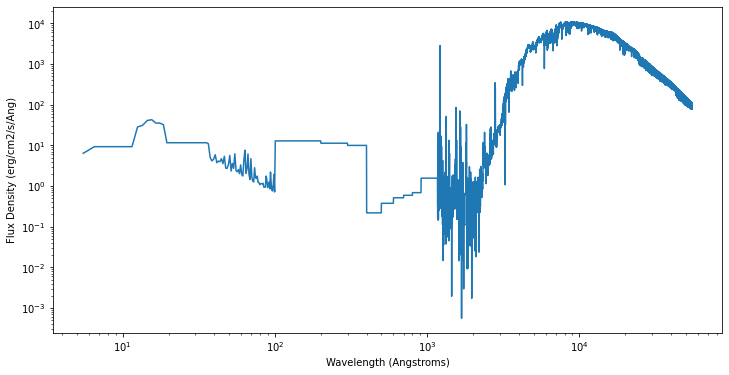

In [128]:
from astropy.io import fits
import matplotlib.pyplot as plt

fig = pl.figure(1,figsize=(12,6))

ax1 = pl.subplot(111)

#spec = fits.getdata('TOI654/hlsp_muscles_multi_multi_gj176_broadband_v22_const-res-sed.fits',1)
spec = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits',1)



#plt.plot(spec['WAVELENGTH'],( spec['FLUX'] * (  (9.4 * 3.0857 * 1e+16) ** 2  ) )  / (0.01915 *  1.496e+11) ** 2)

#今の単位は/cm2なので、(でも引き消されたのか..)
plt.plot( spec['WAVELENGTH'],( spec_flux_erg) )
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


#ax1.set_xlim(0, 9996)
ax1.set_yscale('log')
ax1.set_xscale('log')

#ax1.set_ylim(0, 5e-15)


plt.show()


outputfile = './TOI654/SED_gj176.dat'
d = np.column_stack((spec['WAVELENGTH'], spec_flux_W_m2))     #np.savetxt 複数配列の保存方法


np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')

### GJ1214b の場合  正しいかを検証

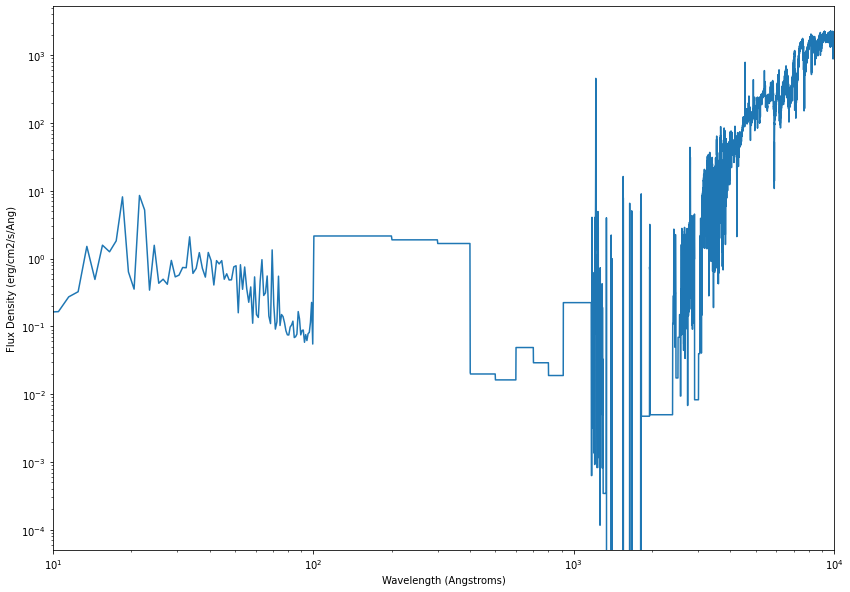

In [133]:


fig = pl.figure(1,figsize=(14,10))

ax1 = pl.subplot(111)

spec = fits.getdata('TOI654/hlsp_muscles_multi_multi_gj1214_broadband_v22_adapt-const-res-sed.fits',1)
#spec = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits',1)



plt.plot(spec['WAVELENGTH'],( spec['FLUX'] * (  (  (14.6 * 3.0857 * 1e+18) ** 2  ) )  / (0.01411 *  1.496e+13) ** 2) )

#今の単位は/cm2なので、(でも引き消されたのか..)
#plt.plot( spec['WAVELENGTH'],( spec_flux_erg) )
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (erg/cm2/s/Ang)')


ax1.set_xlim(10, 10 ** 4)
ax1.set_yscale('log')
ax1.set_xscale('log')

#ax1.set_ylim(0, 5e-15)


plt.show()


#outputfile = './TOI654/SED_gj176.dat'
#d = np.column_stack((spec['WAVELENGTH'], spec_flux_W_m2))     #np.savetxt 複数配列の保存方法


#np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')

In [135]:

spec_test = spec['FLUX'] * ( (  (  (14.6 * 3.0857 * 1e+18) ** 2  ) )  / (0.01411 *  1.496e+13) ** 2 )
spec_test_W_m2 = spec_test * 1e-7 * 1e+4
print("spec_test_W_m2=", spec_test_W_m2)


spec_test_W_m2= [4.18759620e-06 2.10793485e-05 3.39526907e-05 ... 2.32676436e-02
 2.31672315e-02 2.55355424e-02]


In [138]:
#ここは要りません!
#spec_test_W = spec_test_W_m2 * 3.14 * (2.82 * (6378.1 * 10 ** 3) ) ** 2

#print("spec_test_W=", spec_test_W)


spec_test_W= [4.25378279e+09 2.14125158e+10 3.44893262e+10 ... 2.36353978e+13
 2.35333986e+13 2.59391416e+13]


In [ ]:
spec_integ = np.nansum(spec_flux_W_m2_cut)
print(spec_integ)

In [139]:
spec_wave_test = spec['WAVELENGTH'][0:499]

spec_test_W_m2_cut = spec_test_W_m2[0:499]

print("spec_test=", spec_test)
print("spec_test_W_m2_cut=", spec_test_W_m2_cut)

spec_test= [4.18759620e-03 2.10793485e-02 3.39526907e-02 ... 2.32676436e+01
 2.31672315e+01 2.55355424e+01]
spec_test_W_m2_cut= [4.18759620e-06 2.10793485e-05 3.39526907e-05 5.64981348e-05
 1.62189996e-04 1.65497550e-04 2.73184502e-04 3.25419263e-04
 1.51742501e-03 4.94069272e-04 1.58154877e-03 1.26297782e-03
 1.83101487e-03 8.16202337e-03 6.38135533e-04 3.55480799e-04
 8.55886896e-03 5.22429920e-03 3.43577789e-04 1.57546167e-03
 4.34073389e-04 4.97873295e-04 4.19201925e-04 9.42288000e-04
 5.38741836e-04 5.71901747e-04 7.41161842e-04 7.34608342e-04
 2.10002446e-03 6.06293682e-04 7.19448650e-04 1.22744224e-03
 7.20236391e-04 5.34497869e-04 1.23414061e-03 9.37243185e-04
 4.09014569e-04 9.36257425e-04 8.36787454e-04 9.35593054e-04
 4.97504360e-04 5.98271042e-04 4.84903514e-04 4.87989569e-04
 7.56351293e-04 7.86156329e-04 1.59109319e-04 8.13674344e-04
 3.53195432e-04 7.53626464e-04 3.61188883e-04 2.27459395e-04
 3.82685170e-04 1.11607852e-04 5.38359255e-04 1.49784261e-04
 1.35837940e-04 4.

In [140]:
#単位: W/m2

spec_integ_test = np.nansum(spec_test_W_m2_cut)
print(spec_integ_test)

0.6390576448514413


### TOI654.01の場合

In [116]:
spec_wave = spec['WAVELENGTH'][0:499]

spec_flux_W_m2_cut = spec_flux_W_m2[0:499]

print("spec_wave=", spec_wave)
print("spec_flux_W_m2_cut=", spec_flux_W_m2_cut)

spec_wave= [  5.49944305   6.49944305   7.49944305   8.49944305   9.49944305
  10.49944305  11.49944305  12.49944305  13.49944305  14.49944305
  15.49944305  16.49944305  17.49944305  18.49944305  19.49944305
  20.49944305  21.49944305  22.49944305  23.49944305  24.49944305
  25.49944305  26.49944305  27.49944305  28.49944305  29.49944305
  30.49944305  31.49944305  32.49944305  33.49944305  34.49944305
  35.49944305  36.49944305  37.49944305  38.49944305  39.49944305
  40.49944305  41.49944305  42.49944305  43.49944305  44.49944305
  45.49944305  46.49944305  47.49944305  48.49944305  49.49944305
  50.49944305  51.49944305  52.49944305  53.49944305  54.49944305
  55.49944305  56.49944305  57.49944305  58.49944305  59.49944305
  60.49944305  61.49944305  62.49944305  63.49944305  64.49944305
  65.49944305  66.49944305  67.49944305  68.49944305  69.49944305
  70.49944305  71.49944305  72.49944305  73.49944305  74.49944305
  75.49944305  76.49944305  77.49944305  78.49944305  79.49944305

In [100]:
np.shape(spec)

(54994,)

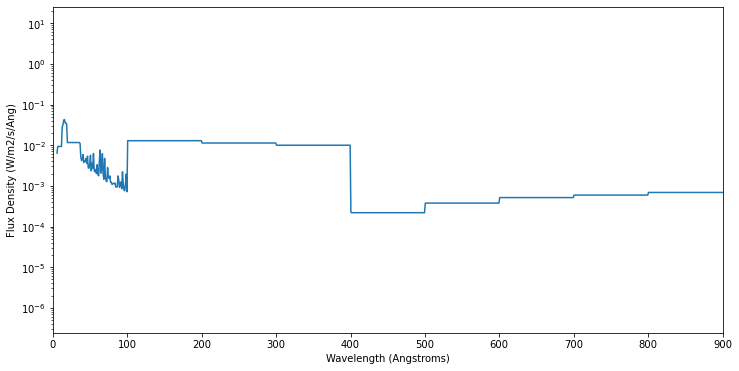

In [118]:
from astropy.io import fits
import matplotlib.pyplot as plt

fig = pl.figure(1,figsize=(12,6))

ax1 = pl.subplot(111)

#spec = fits.getdata('TOI654/hlsp_muscles_multi_multi_gj176_broadband_v22_const-res-sed.fits',1)
spec = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits',1)



#plt.plot(spec['WAVELENGTH'],( spec['FLUX'] * (  (9.4 * 3.0857 * 1e+16) ** 2  ) )  / (0.01915 *  1.496e+11) ** 2)

#今の単位は/cm2なので、(でも引き消されたのか..)
plt.plot( spec['WAVELENGTH'],( spec_flux_W_m2) )
plt.xlabel('Wavelength (Angstroms)')
plt.ylabel('Flux Density (W/m2/s/Ang)')


ax1.set_xlim(0, 900)
ax1.set_yscale('log')
#ax1.set_xscale('log')

#ax1.set_ylim(0, 5e-15)


plt.show()


outputfile = './TOI654/SED_gj176.dat'
d = np.column_stack((spec['WAVELENGTH'], spec_flux_W_m2))     #np.savetxt 複数配列の保存方法


np.savetxt(outputfile, d, delimiter =" ", fmt ='% s')

In [112]:
#spec_integ = np.nansum(spec_flux_W_m2)
#print(spec_integ)

126421.19249268163


In [117]:
spec_integ = np.nansum(spec_flux_W_m2_cut)
print(spec_integ)

4.119047840381908


In [108]:
#fits = fits.getdata('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits')

import numpy
import astropy.io.fits

hdu = astropy.io.fits.open('TOI654/gj176/hlsp_muscles_multi_multi_gj176_broadband_v22_adapt-const-res-sed.fits')[0]

print()

TypeError: Image data of dtype object cannot be converted to float

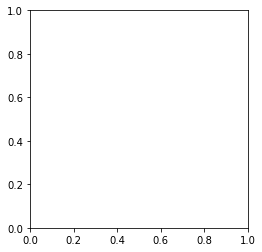

In [109]:
plt.imshow(hdu.data)
plt.show()

## p-winds Installation

In [61]:
!git clone https://github.com/ladsantos/p-winds.git && cd p-winds


Cloning into 'p-winds'...
remote: Enumerating objects: 1727, done.
remote: Counting objects: 100% (240/240), done.
remote: Compressing objects: 100% (138/138), done.
remote: Total 1727 (delta 168), reused 157 (delta 102), pack-reused 1487
Receiving objects: 100% (1727/1727), 15.77 MiB | 3.82 MiB/s, done.
Resolving deltas: 100% (1229/1229), done.


In [71]:
!git clone https://github.com/ladsantos/p-winds.git && cd p-winds/
!python setup.py install


fatal: destination path 'p-winds' already exists and is not an empty directory.
python: can't open file 'setup.py': [Errno 2] No such file or directory


In [73]:
!pytest tests


============================= test session starts ==============================
platform darwin -- Python 3.8.8, pytest-7.1.3, pluggy-0.13.1
rootdir: /Users/jam/Desktop/Research Room/Jupyter
plugins: anyio-2.2.0
collected 0 items                                                              

============================ no tests ran in 0.03s =============================
ERROR: file or directory not found: tests



In [77]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import astropy.constants as c
import astropy.units as u
from astropy.convolution import convolve
from scipy.optimize import minimize
from p_winds import parker, hydrogen, helium, transit, lines, tools

# Uncomment the next line if you have a MacBook with retina screen
# %config InlineBackend.figure_format = 'retina'
pylab.rcParams['figure.figsize'] = 9.0,6.5
pylab.rcParams['font.size'] = 18

ImportError: cannot import name 'lines' from 'p_winds' (/Applications/anaconda3/lib/python3.8/site-packages/p_winds/__init__.py)

In [74]:
!pip install p-winds


[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: pip install --upgrade pip


In [75]:
pip install --upgrade pip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 2.1 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: pip
    Found existing installation: pip 22.2.2
    Uninstalling pip-22.2.2:
      Successfully uninstalled pip-22.2.2
Note: you may need to restart the kernel to use updated packages.


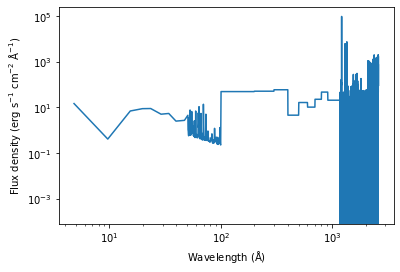

In [76]:
data_url = 'https://gist.githubusercontent.com/ladsantos/c7d1aae1ecc755bae9f1c8ef1545cf8d/raw/cb444d9b4ff9853672dab80a4aab583975557449/HAT-P-11_spec.dat'
spec = np.loadtxt(data_url, skiprows=1)
host_spectrum = {'wavelength': spec[:, 0], 'flux_lambda': spec[:, 1],
                 'wavelength_unit': u.angstrom,
                 'flux_unit': u.erg / u.s / u.cm ** 2 / u.angstrom}

plt.loglog(host_spectrum['wavelength'], host_spectrum['flux_lambda'])
plt.xlabel(r'Wavelength (${\rm \AA}$)')
plt.ylabel(r'Flux density (erg s$^{-1}$ cm$^{-2}$ ${\rm \AA}^{-1}$)')
plt.show()

In [79]:
data_url = 'https://gist.githubusercontent.com/ladsantos/c7d1aae1ecc755bae9f1c8ef1545cf8d/raw/cb444d9b4ff9853672dab80a4aab583975557449/'
spec = np.loadtxt(data_url, skiprows=1)
host_spectrum = {'wavelength': spec[:, 0], 'flux_lambda': spec[:, 1],
                 'wavelength_unit': u.angstrom,
                 'flux_unit': u.erg / u.s / u.cm ** 2 / u.angstrom}

plt.loglog(host_spectrum['wavelength'], host_spectrum['flux_lambda'])
plt.xlabel(r'Wavelength (${\rm \AA}$)')
plt.ylabel(r'Flux density (erg s$^{-1}$ cm$^{-2}$ ${\rm \AA}^{-1}$)')
plt.show()

OSError: https://gist.githubusercontent.com/ladsantos/c7d1aae1ecc755bae9f1c8ef1545cf8d/raw/cb444d9b4ff9853672dab80a4aab583975557449/GJ-176_spec.dat not found.